In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

import astropy.constants as cs
import os
import astropy.io.fits as pyfits

import hstscan.pipeline as pipe
import hstscan.reduction as r
import hstscan.data as data
from hstscan.data import view_frame_image as view
import tqdm
import glob
import csv

# Setup for light-curve reduction

### 1) Download data
https://archive.stsci.edu/hst/search.php

\_ima files for all data

\_drz and \_flt files for the direct images (taken with Filters instead of Grism)

Get HST ephemeris data at https://ssd.jpl.nasa.gov/horizons.cgi?s_tset=1#top

In [2]:
# data_dir: directory where the _ima files are stored
Dir = '/Users/bob/Documents/PhD/WASP-80/'
data_dir = Dir + 'HSTdata/'
output_dir = Dir + 'output/'

conf_file_red = Dir + 'transmission_reduction.conf'
conf_file_ext = Dir + 'transmission_extraction.conf'

#Define a table of custom knots. A row for each subexposure. 
#If you haven't created this yet, please run the remainder of this code to find out the best knots.
#Then create your own table with *interior* knots in ascending order
custom_knots_long1 = []
custom_knots_long2 = []
custom_knots_short1 = []
custom_knots_short2 = []
if os.path.isfile(Dir + 'custom_knots_long.csv'):
    with open(Dir + 'custom_knots_long1.csv', 'rb') as csvfile:
        spamreader = csv.reader(csvfile, delimiter=',')
        for row in spamreader:
            row = np.array(row)
            custom_knots_long1.append(row[row != ''].astype(float))
    with open(Dir + 'custom_knots_long2.csv', 'rb') as csvfile:
        spamreader = csv.reader(csvfile, delimiter=',')
        for row in spamreader:
            row = np.array(row)
            custom_knots_long2.append(row[row != ''].astype(float))
    with open(Dir + 'custom_knots_short1.csv', 'rb') as csvfile:
        spamreader = csv.reader(csvfile, delimiter=',')
        for row in spamreader:
            row = np.array(row)
            custom_knots_short1.append(row[row != ''].astype(float))
    with open(Dir + 'custom_knots_short2.csv', 'rb') as csvfile:
        spamreader = csv.reader(csvfile, delimiter=',')
        for row in spamreader:
            row = np.array(row)
            custom_knots_short2.append(row[row != ''].astype(float))
    noknots=False
else:
    noknots=True

### 2) Produce visit information lists

At this point it makes sense to re-name the visit files to more appropriate names, e.g. visit_26.lis -> transit.lis

### 3) Define a list of reference files

These reference files are used to calculate the absolute wavelength solution. They are typically the first grism exposures of each visit. Each visit should have at least one reference exposure.

In [3]:
ref_Images = ['idn201bgq_ima.fits', 'idn202j6q_ima.fits', 'idn203s4q_ima.fits', 'idn204zyq_ima.fits', 'idn205o6q_ima.fits']

### 4) Fit direct image positions to produce position catalogues

Writing to: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn202j5q_flt_1.cat
/Users/bob/Documents/PhD/WASP-80/HSTdata/idn202j5q_drz.fits
Shape (242, 271)


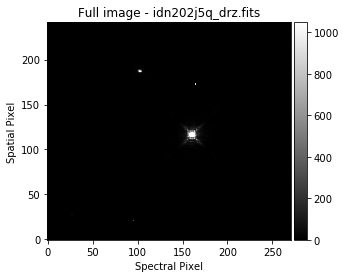

Name          Value      Min      Max   Stderr     Vary     Expr Brute_Step
amplitude  1.171e+05        0      inf    91.68     True     None     None
x_mean        160.9        0      242 0.0006141     True     None     None
x_stddev     0.7095        0      inf 0.000505     True     None     None
y_mean        116.4        0      242 0.0006924     True     None     None
y_stddev     0.8615        0      inf 0.0007274     True     None     None


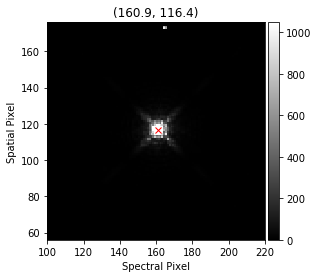

Writing to: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn204zxq_flt_1.cat
/Users/bob/Documents/PhD/WASP-80/HSTdata/idn204zxq_drz.fits
Shape (242, 271)


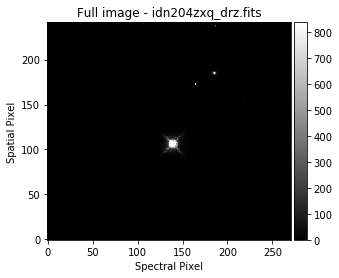

Name          Value      Min      Max   Stderr     Vary     Expr Brute_Step
amplitude  8.448e+04        0      inf    40.06     True     None     None
x_mean          139        0      242 0.0004843     True     None     None
x_stddev      1.018        0      inf 0.000481     True     None     None
y_mean        106.2        0      242 0.0004309     True     None     None
y_stddev     0.9052        0      inf 0.0004291     True     None     None


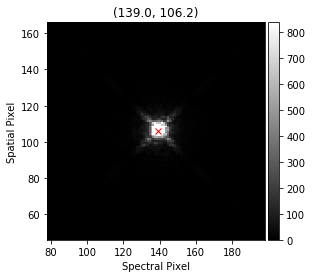

Writing to: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bfq_flt_1.cat
/Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bfq_drz.fits
Shape (242, 271)


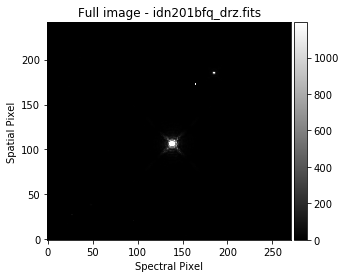

Name          Value      Min      Max   Stderr     Vary     Expr Brute_Step
amplitude  1.326e+05        0      inf    72.31     True     None     None
x_mean        138.7        0      242 0.0004204     True     None     None
x_stddev     0.7945        0      inf 0.000443     True     None     None
y_mean        106.3        0      242 0.0004311     True     None     None
y_stddev     0.8107        0      inf 0.0004397     True     None     None


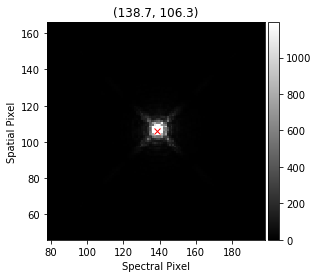

Writing to: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn205o5q_flt_1.cat
/Users/bob/Documents/PhD/WASP-80/HSTdata/idn205o5q_drz.fits
Shape (242, 271)


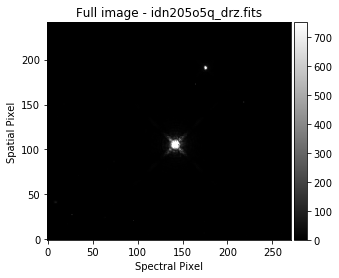

Name          Value      Min      Max   Stderr     Vary     Expr Brute_Step
amplitude  9.301e+04        0      inf    57.36     True     None     None
x_mean        142.3        0      242 0.0005786     True     None     None
x_stddev     0.9566        0      inf 0.0005838     True     None     None
y_mean        105.4        0      242 0.0005229     True     None     None
y_stddev     0.8703        0      inf 0.0005514     True     None     None


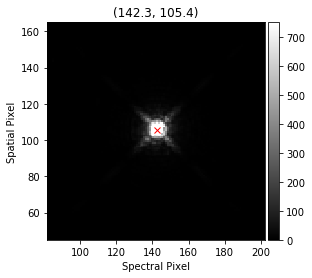

Writing to: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn203s3q_flt_1.cat
/Users/bob/Documents/PhD/WASP-80/HSTdata/idn203s3q_drz.fits
Shape (242, 271)


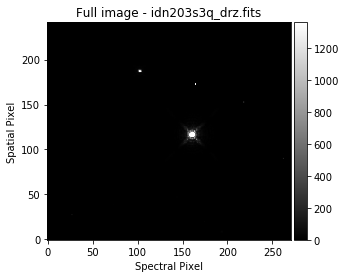

Name          Value      Min      Max   Stderr     Vary     Expr Brute_Step
amplitude  1.481e+05        0      inf    136.2     True     None     None
x_mean        160.9        0      242 0.0006866     True     None     None
x_stddev     0.6691        0      inf 0.0005218     True     None     None
y_mean        116.6        0      242 0.0006657     True     None     None
y_stddev     0.7409        0      inf 0.0007827     True     None     None


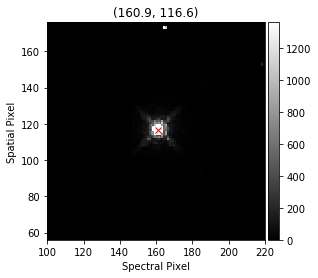

In [4]:
reload(pipe)
# gridsize: coarseness of initial search for source
# nstars: number of stars for which positions should be measured (in order of brightness)
# use_ima: use _ima files instead of _flt in case of problems
pipe.create_orbit_cats_gauss(data_dir=data_dir, conf_file=conf_file_red, gridsize=60, use_ima=False, nstars=1)

Now have everything you need to reduce an exposure and produce spectra

# Config file parameters

## Red

### Parameters to define yourself
 - source_dir
 - save_dir
 - scan_rate
 - bg_x,y,w,h
 - flat_file_g141
 - conf_file_g141
 - tai_utc_file
 - ref_exp
 - stellar_spectrum (PHOENIX model. TBF @ http://phoenix.astro.physik.uni-goettingen.de/?page_id=15) from https://arxiv.org/pdf/1303.5632.pdf
     You could also use a .txt file with one column of wavelengths in Angstrom and one of Flux in erg/s/cm^2/A. This file should have a one-line-header. This is useful if you want to use an ATLAS spectrum.
 - stellar_wavelengths (PHOENIX model wavelength definition)
 
### Leave
These you are unlikely to want to change, although their effects are important
 - scanned = True
 - units = True
 - read_noise = 20
 - skip_start = 1
 - skip_end = 0
 - bg = True
 - bg_area = True
 - cr_local = True
 - dispersion = True
 - flat_field = True
 - ff_min = 0.5
 - contam_thresh = 0.01
 - nysig = 5
 - disp_coef = 'wilkins'
 - calc_abs_xshift = True.   #Whether to calculate the wavelength solution from the grism transmission fct.
 
### Cosmic Rays
You may want to experiment with cosmic ray removal parameters, can turn off cosmic ray removal for a first run
 - cr_tol = 15 (try to lower without removing spectrum)
 - cr_x,y (consider tweaking if CR removal too agressive/weak)
 - cr_thresh = 50 (can raise)

### Data quality flags
Lookup flags in data handbook. 4: Bad detector pixel, 32: IR unstable pixel.

Leave as is unless there are problems.
 - dq_flags = [4,32]
 - dq_replace = None
 - dq_mean_width = 1
 
### Wavelength Solution
For now, disable the Tsiaras wavelength solution and use the simple interpolation.
May want to tweak drift_width and rowtol, parameters for smoothing the drift within an exposure.

E.g. define
 - exp_shift = False
 - tsiaras = False
 - exp_drift = True
 - drift_width = 4
 - drift_rowtol = 1.1


### Plots
Leave on while still tweaking
 - debug = True
 - pdf = True
 - logger = True
 - bg_plot = True
 - cr_plot = True
 
### Tweak to position extraction box
Depending on the observations, need to account/remove different effects to center the spectrum in the extraction box. Have not figured out a universal solution.

 - remove_scan
 - postarg_yguess
 - default_scan
 
 
### Ignore
These are either no longer used, in development, or were for specific data sets/modes.
 - system
 - nlincorr
 - psf_h (these are for bg removal with masks)
 - mask_h
 - psf_w
 - n_masks
 - neg_masks
 - cr_replace
 - cr_master
 - cr_mname
 - ref_exp
 - ref_wv0
 - ref_wv1
 - pre_shift_ff
 - peak
 - x_shift_ext
 - grid_y
 - grid_lam
 - two_scans 
 - interp_kind
 - object_ind

## Ext

### Parameters to define yourself
 - save_dir
 - box_h (ensure large enough to capture whole spectrum)
 - ref_exp
 
### Plots
- debug = True
- logger = True
- pdf = True
- oe_debug = False (its very slow, turn on only if focusing on optimal extraction)

### Leave
 - save_extension = '_spec.txt'
 - calc_var = True
 - extraction_box = True
 - shift_spectra = True
 - shift_wv0 = 1.14
 - shift_wv1 = 1.6
 - peak = False
 - opt_ext = True
 - exp_shift = True
 
### Optimal Extraction

#### Tweak
- fit_tol
- order
- step (only works if func_type is not spline, custom_spline or split_spline and method is lsq
- k_col/row

#### Leave
- s = 0
- v_0 = 400
- q = 1
- s_clip = None
- s_cosmic = None
- func_type = 'spline'
- method = 'lsq'
- remove_bg = True
- object_ind = 0
- fit_dq = True
 
### Ignore
- save_sub
- mask_neg
- ignore_blobx
- blob_thresh
- skip_fit
- top_half

# Run data reduction on one exposure

Check 

 - Do the subexposures agree, smoothly across the whole wavelength range?
 
 - How many optimal extraction fits fail near the peak of the spectrum?
 
 - Check the fits, are they overfitting or underfitting clearly? Safer to overfit.

In [5]:
noknots

False

In [6]:
#Define the center pixel of each subexposure in y-direction. You can also run with the custom_knots=None argument to find out what these should be.
ypix_F_1 = [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix_R_1 = [22, 36, 49, 62, 76, 89, 103, 116, 130, 143, 156, 170, 183]
ypix_F_2 = [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix_R_2 = [33, 46, 60, 73, 87, 100, 114, 127, 140, 153, 167, 180, 193]
ypix_F_3 = [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix_R_3 = [33, 47, 60, 73, 87, 100, 114, 127, 140, 154, 166, 180]
ypix_F_4 = [168, 155, 142,128,115, 101, 88, 75, 61, 48, 35, 21]
ypix_R_4 = [21, 35, 48, 61, 75, 88, 101, 115, 128, 142, 155, 168]
ypix_F_5 = [166, 153, 140,126,113, 99, 86, 73, 59, 46, 33, 21]
ypix_R_5 = [21, 33, 46, 59, 73, 86, 99, 113, 126, 140, 153, 166]

idn201bgq
########################################
############Started Reduction##########
########################################
Data reduction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201daq_ima.fits
For configuration, see pipeline conf file: /Users/bob/Documents/PhD/WASP-80/transmission_reduction.conf


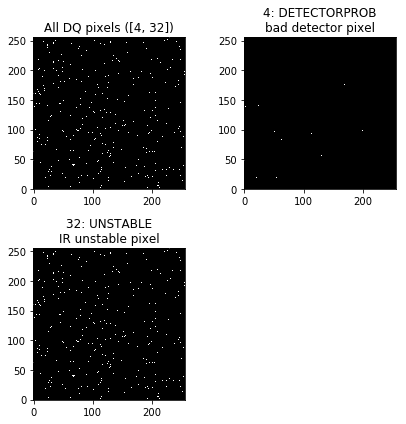

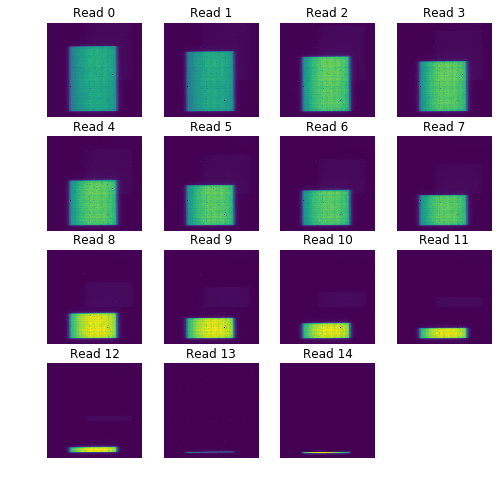

/Users/bob/opt/anaconda3/envs/hstscan/lib/python2.7/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/bob/opt/anaconda3/envs/hstscan/lib/python2.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


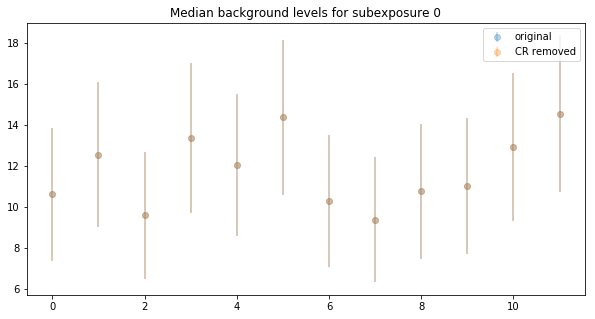

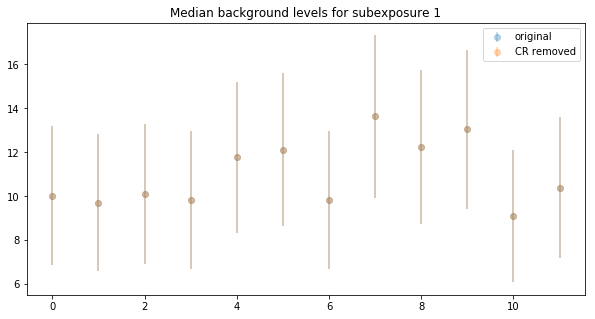

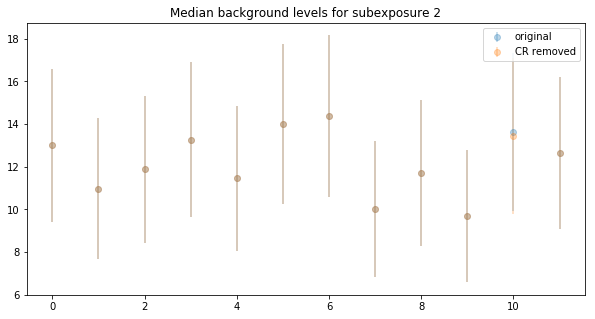

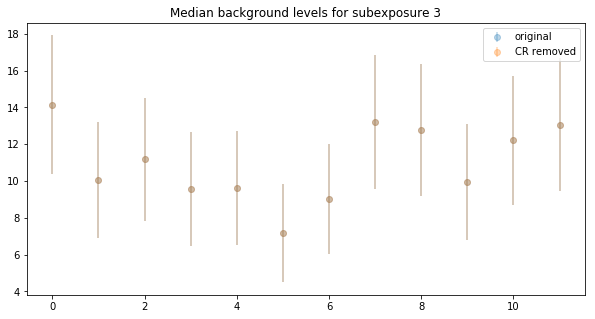

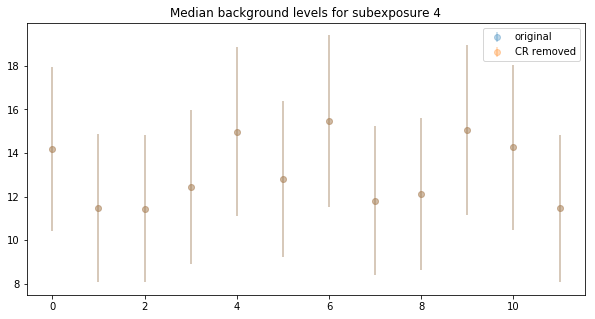

...

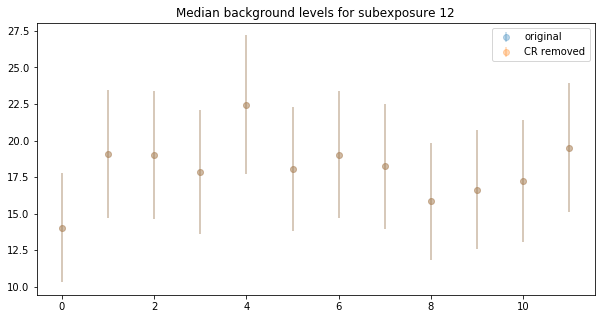

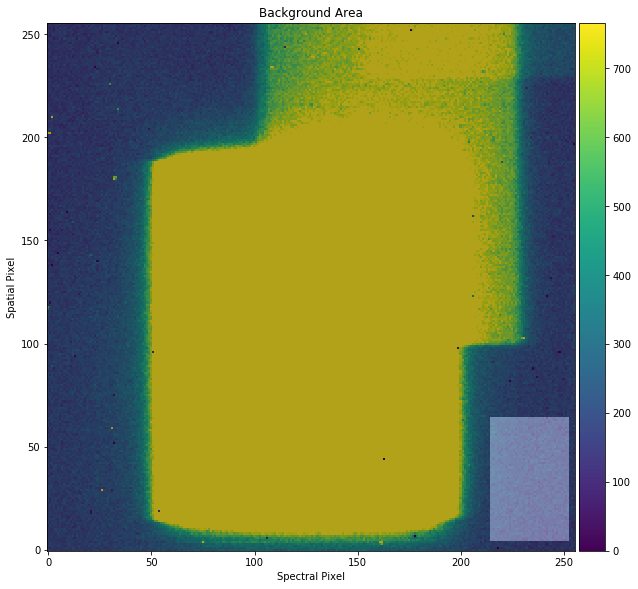

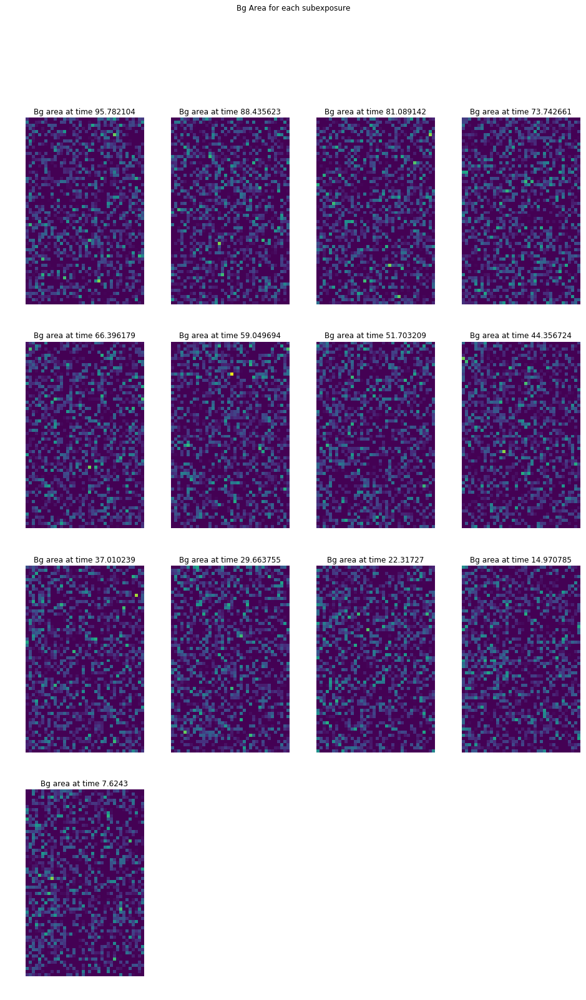

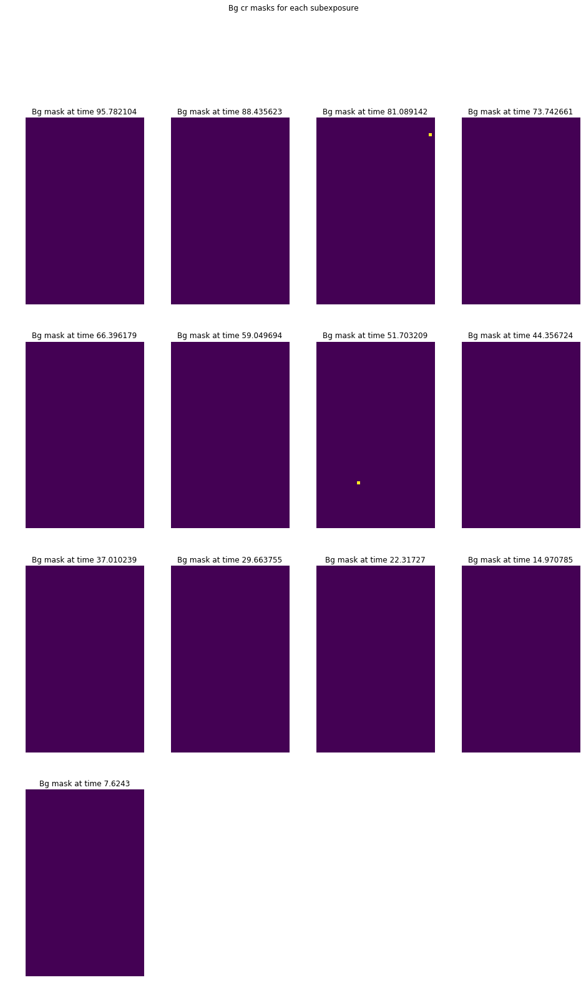

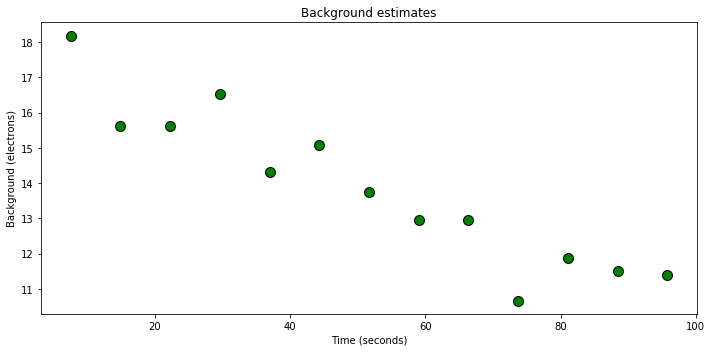

Forward scan
Catalogue used: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bfq_flt_1.cat
Direct Image name: idn201bfq
catalogue /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bfq_flt_1.cat
Catalogue file: idn201bfq_ima.fits
########################
Direct image location of (138.685597286,106.279065053)
Initial xpix is 17 and shift_in_x: -121.295619318
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 75.05 pix
FWHM of this subexposure is  13.434098302807627


/Users/bob/opt/anaconda3/envs/hstscan/lib/python2.7/site-packages/scipy/optimize/minpack.py:787: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


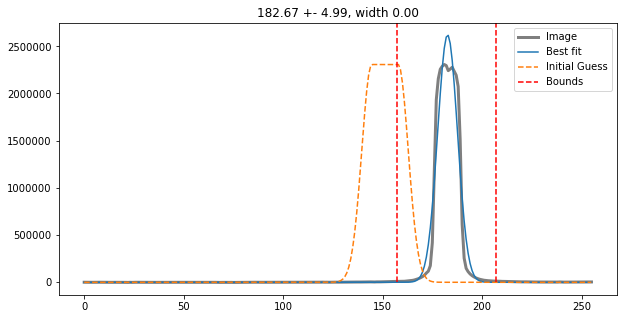

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.365084490935374


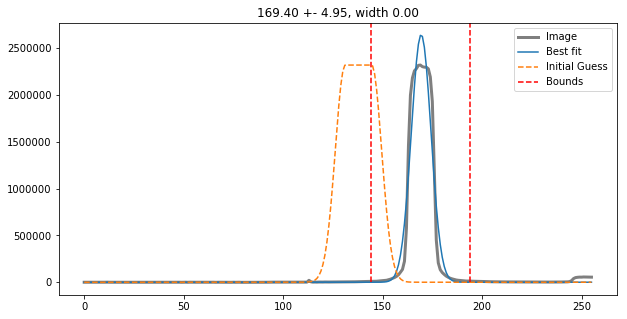

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.321714771175209


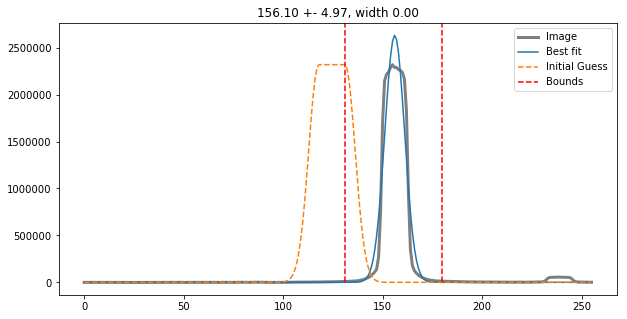

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.289658937932614


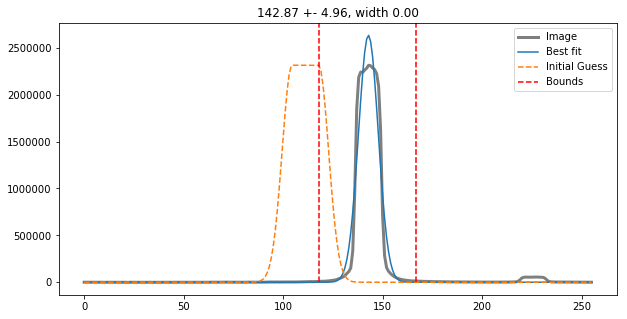

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.597256319474837


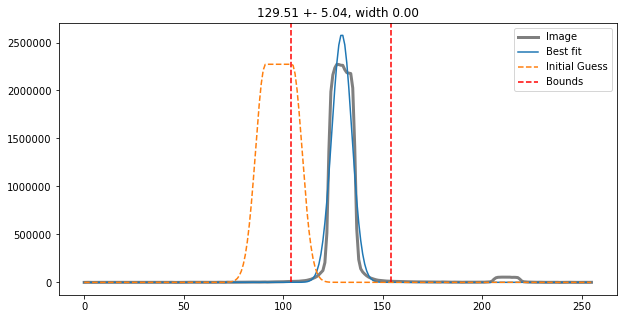

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.381707607425142


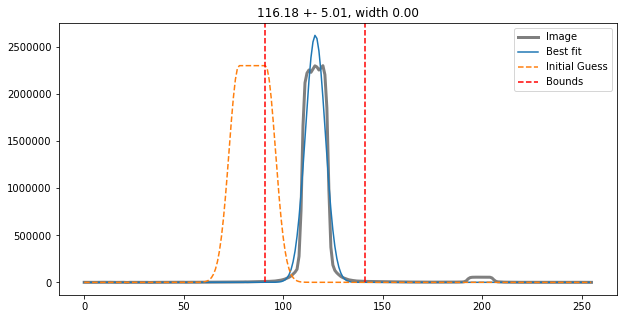

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.449470889897498


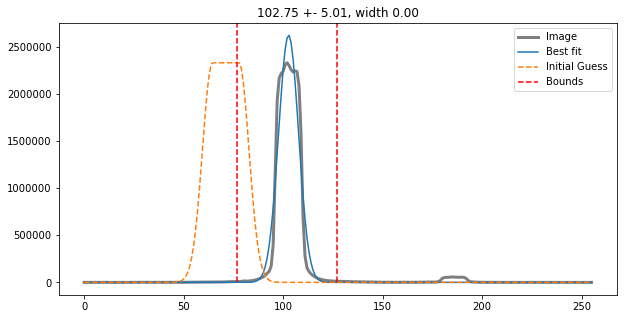

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.444940759450404


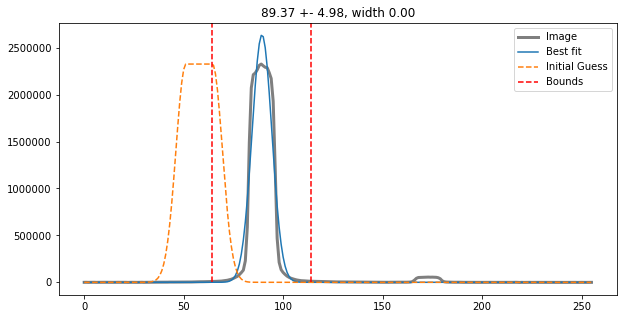

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.523925943162311


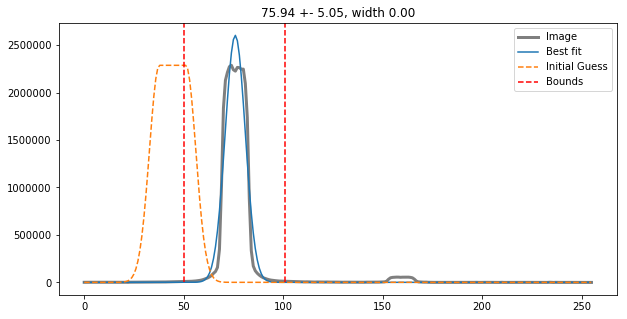

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.550485534812331


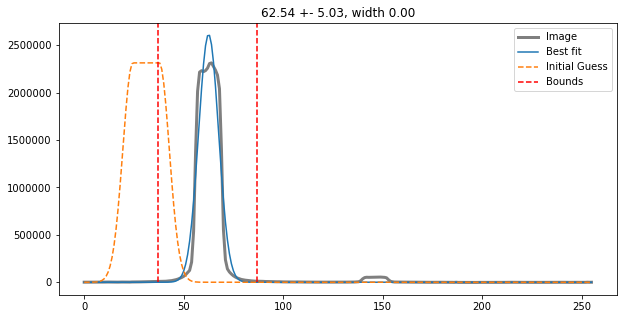

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.575287459127544


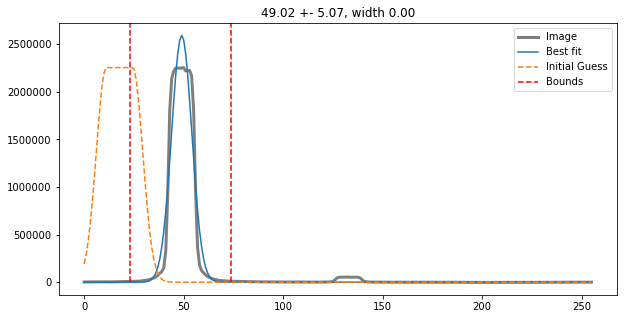

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.50647660406623


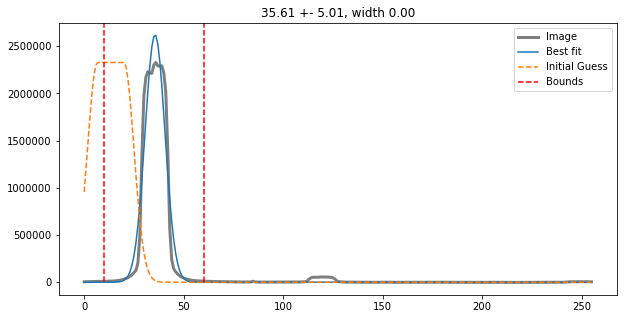

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]
120.0 1
FWHM of this subexposure is  13.492139103025712


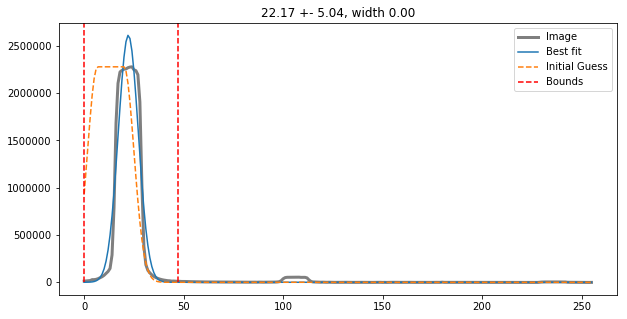

SHIFTINX -121.295619318
waveschange [0.73190543 0.73656254 0.74121965 0.74587677]


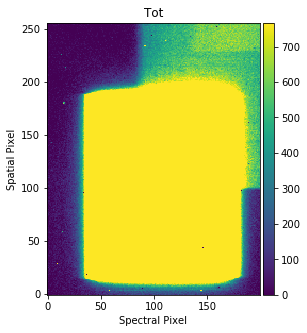

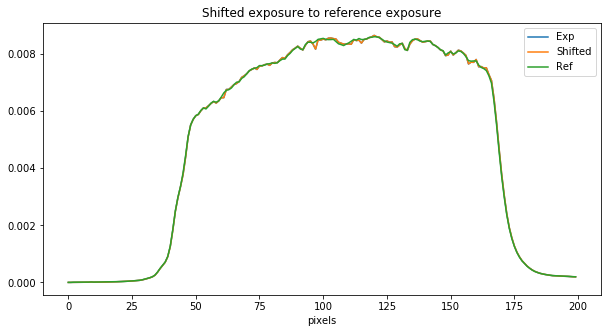

shifttoref -0.022272336248548186
The final xpix is 17
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 75.05 pix
FWHM of this subexposure is  13.434098302807627


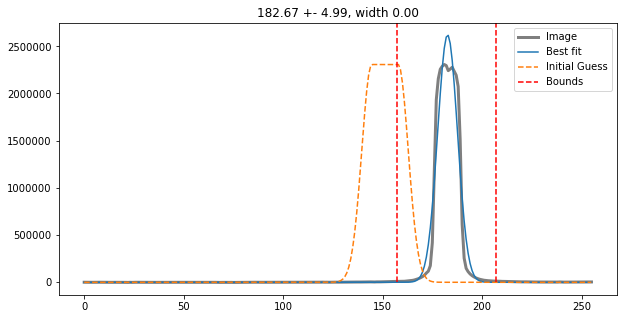

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.365084490935374


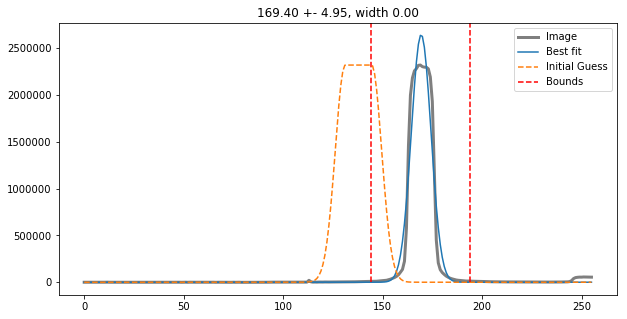

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.321714771175209


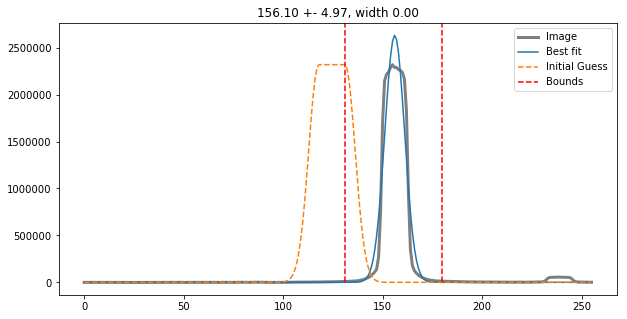

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.289658937932614


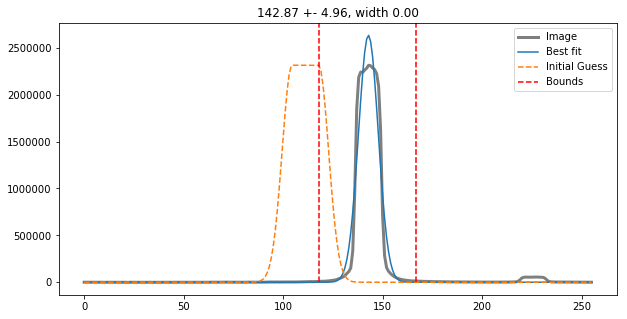

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.597256319474837


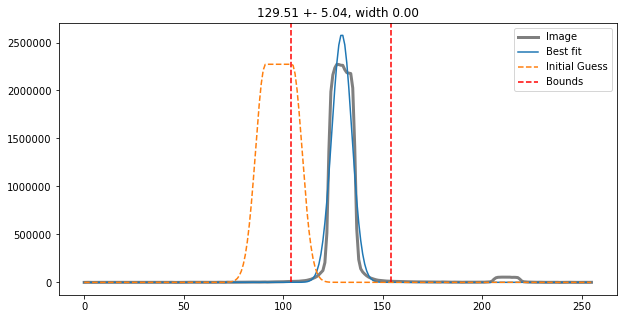

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.381707607425142


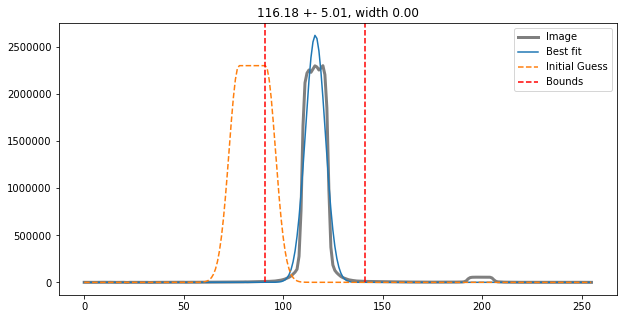

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.449470889897498


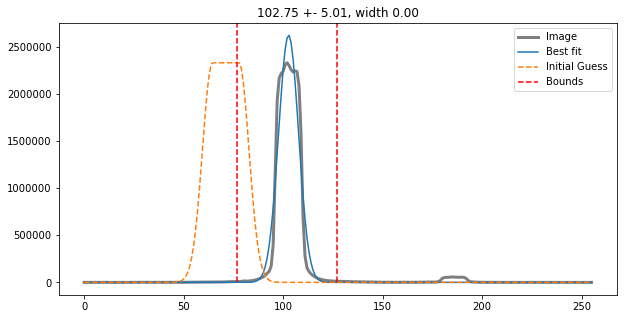

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.444940759450404


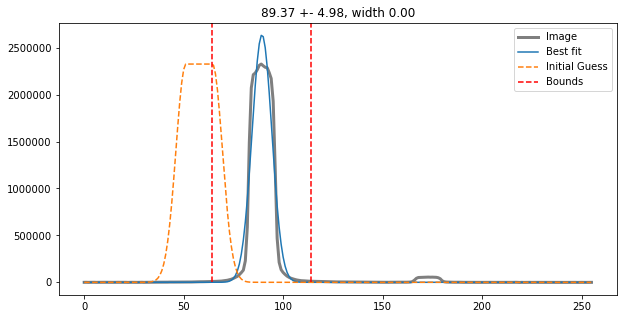

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.523925943162311


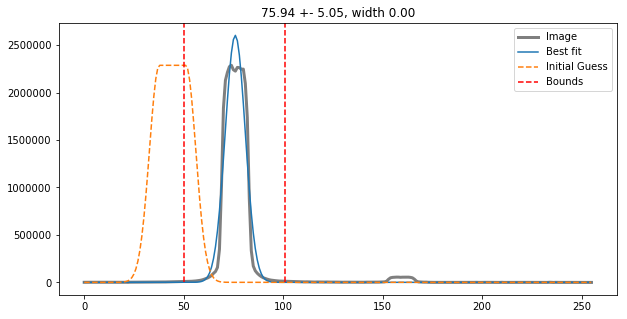

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.550485534812331


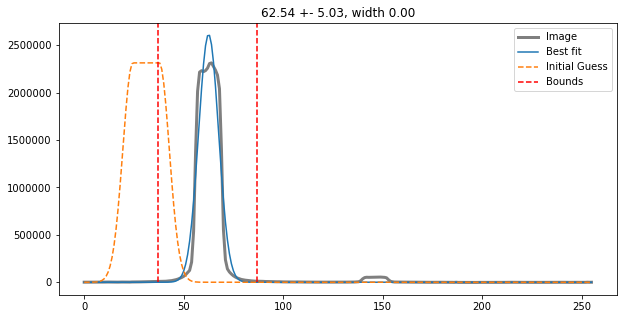

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.575287459127544


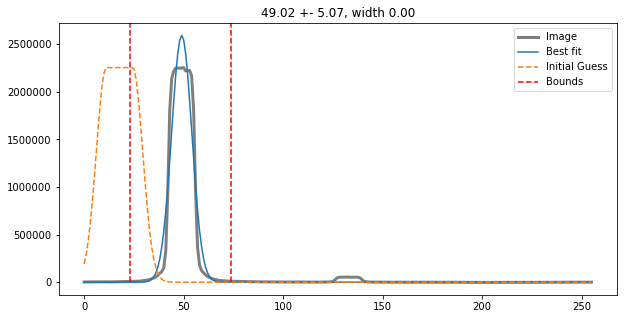

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.50647660406623


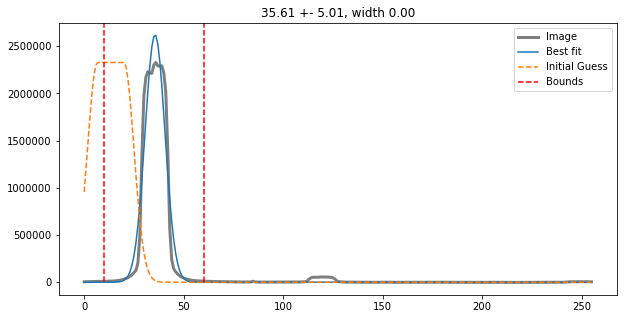

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]
120.0 1
FWHM of this subexposure is  13.492139103025712


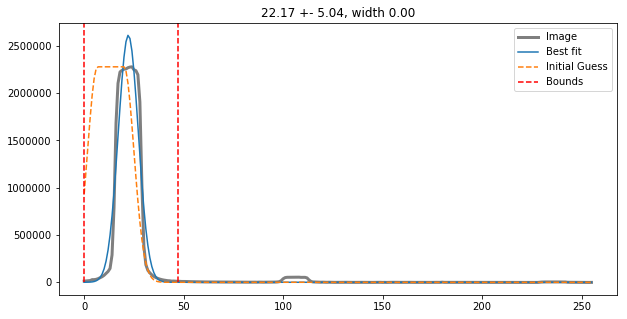

SHIFTINX -0.02227233624854805
waveschange [1.35836552 1.3630234  1.3676813  1.37233921]


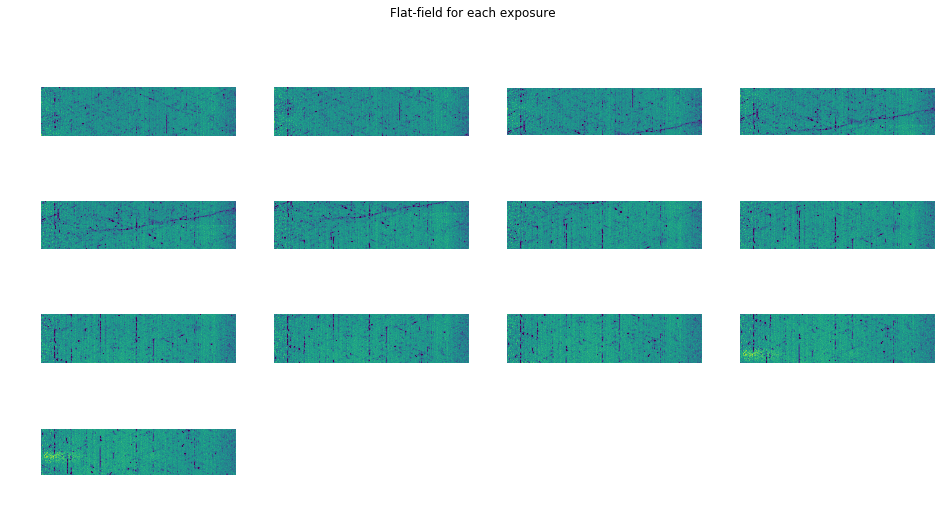

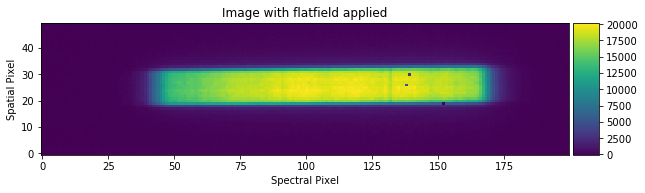

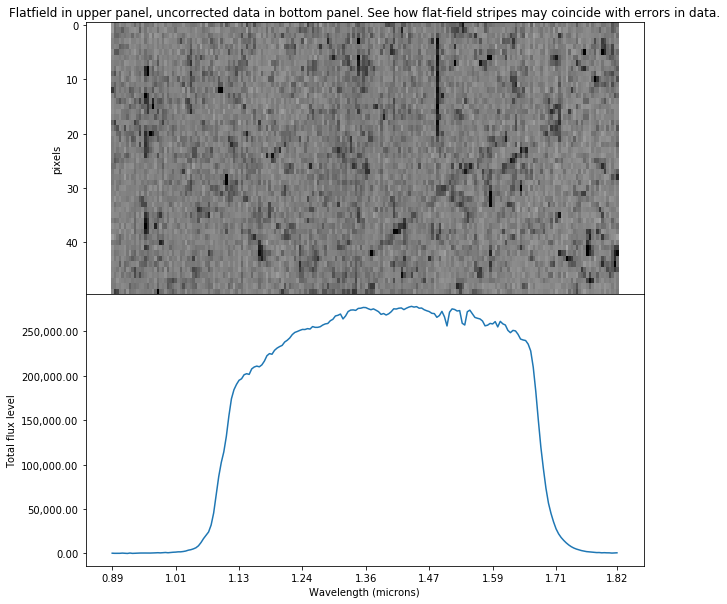

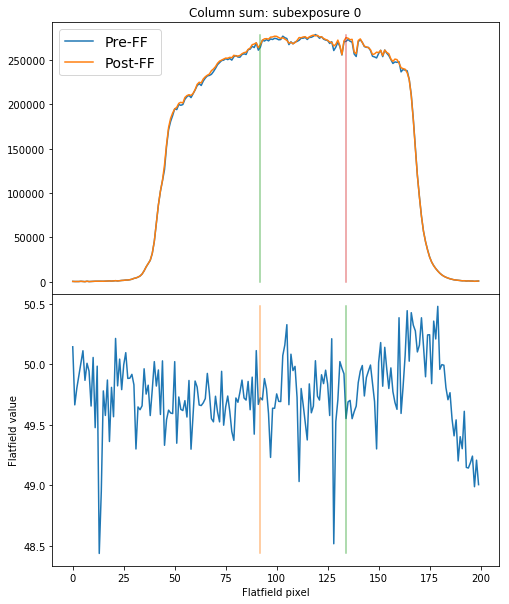

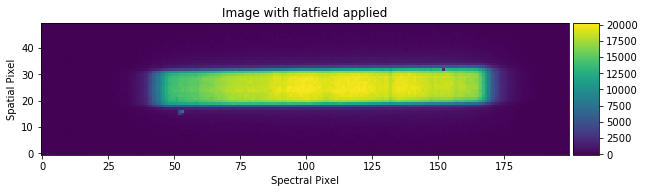

...

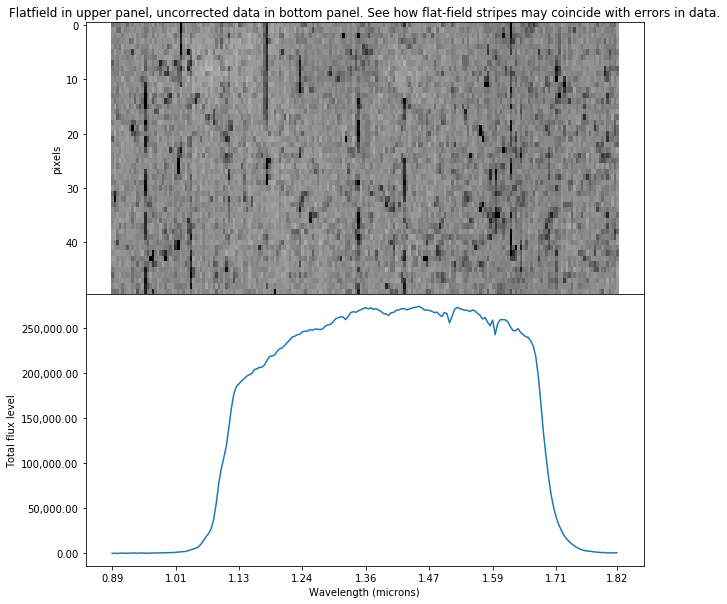

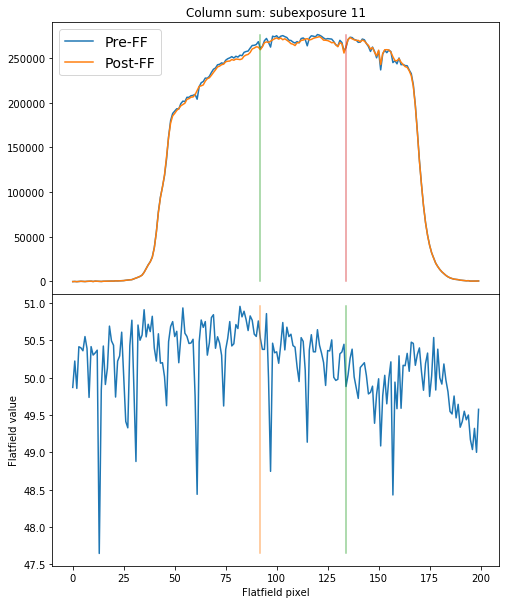

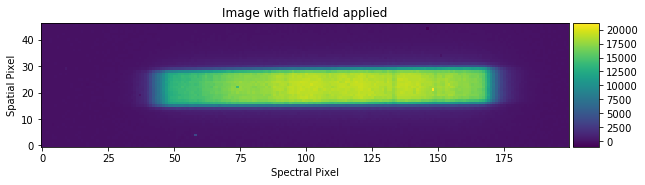

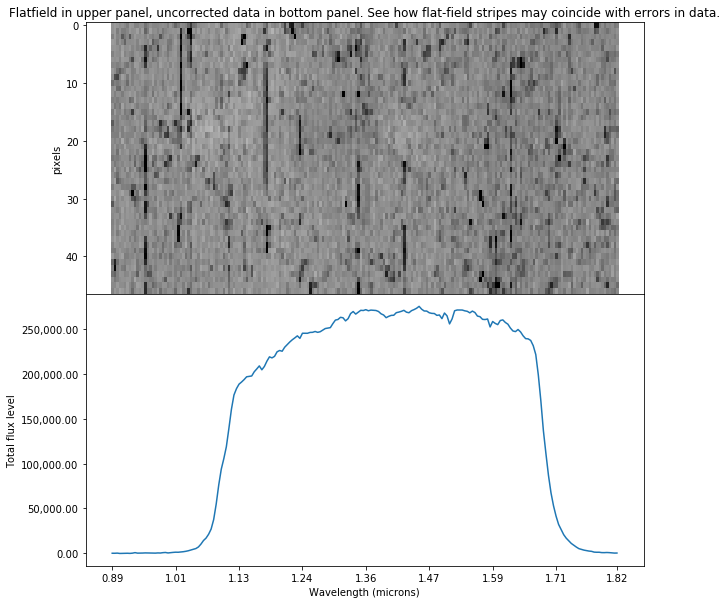

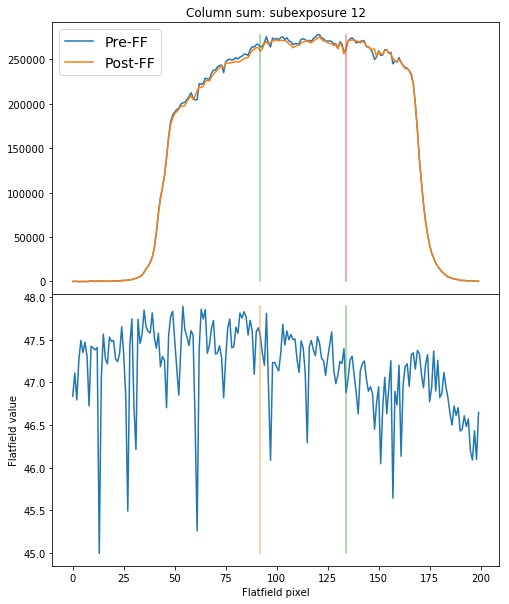

/Users/bob/opt/anaconda3/envs/hstscan/lib/python2.7/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


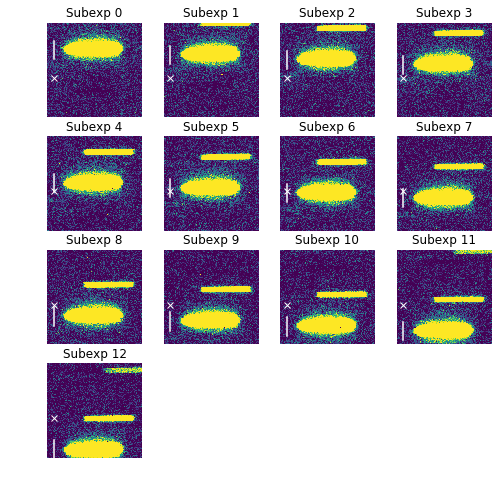

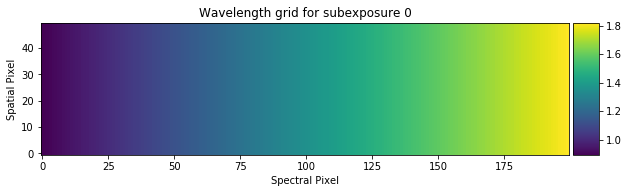

nr_CRs, Lows 10 0
nr_CRs, Lows 12 1
nr_CRs, Lows 8 0
nr_CRs, Lows 5 0
nr_CRs, Lows 9 0
nr_CRs, Lows 20 1
nr_CRs, Lows 16 2
nr_CRs, Lows 6 0
nr_CRs, Lows 10 0
nr_CRs, Lows 10 0
nr_CRs, Lows 15 0
nr_CRs, Lows 12 0
nr_CRs, Lows 13 0


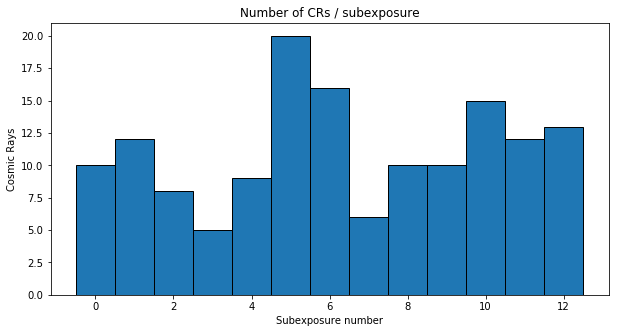

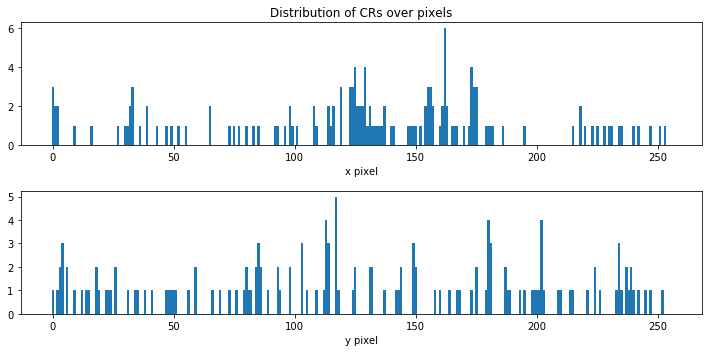

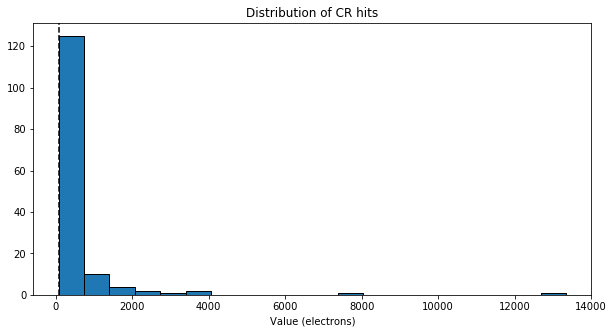

This should have a median energy of 1000 electrons
Nr. of DQs, CRs and CRs minus DQs 10023, 146 and 144
Percentage of pixels affected by CRs:0.2197265625 %, which should be ~0.37248596% if there is no South Atlantic anomaly.


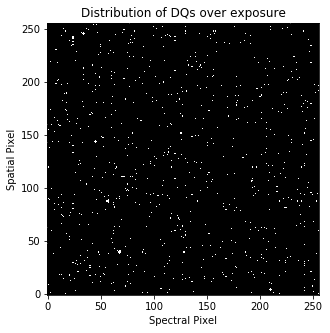

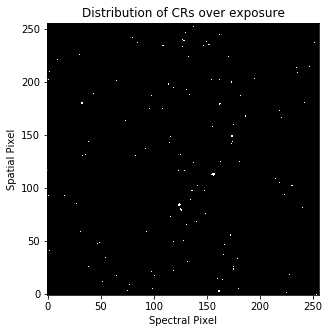

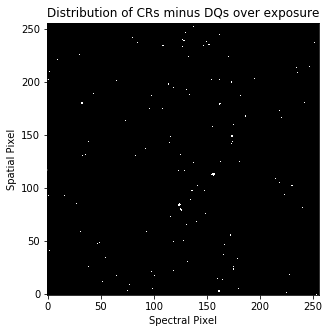

hstscan/pipeline.py:952: RuntimeWarning: invalid value encountered in log10
  p.plot(wgrid_u, np.log10(tot_flux), color='g')
hstscan/pipeline.py:954: RuntimeWarning: invalid value encountered in log10
  p.plot([w1, w1], [min(np.log10(tot_flux)) * 0.9, max(np.log10(tot_flux)) * 1.1], '--', color='maroon')
hstscan/pipeline.py:955: RuntimeWarning: invalid value encountered in log10
  p.plot([w2, w2], [min(np.log10(tot_flux)) * 0.9, max(np.log10(tot_flux)) * 1.1], '--', color='maroon')


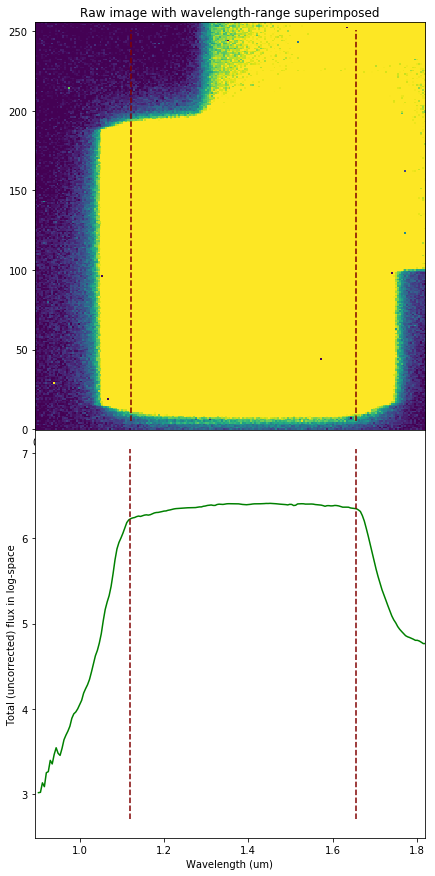

95.782104
95.782104 95.782104
Reduction took 23.81s
########################################
###########Finished Reduction###########
########################################
########################################
############Started Extraction##########
########################################
Spectral extraction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201daq_ima.fits
For configuration, see conf file: /Users/bob/Documents/PhD/WASP-80/transmission_extraction.conf
Forward scan
Extracting from subexposure 1
Extracting spectrum with a 38 high extraction box
nr. of CRs 781
Spectrum located at pixel 117 in spatial direction
subexp 182.6721976613346 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 183 for exposure 0
0 13


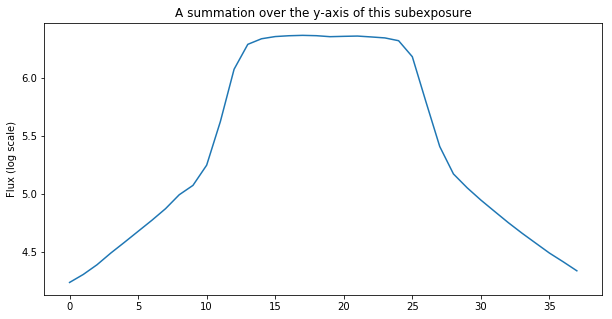

The difference between the two edges (for a 5-pixel bin for all subexps is): 3797.285611979167
This value may not be larger than  2066.1052570799325  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Using flux for variance estimate
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


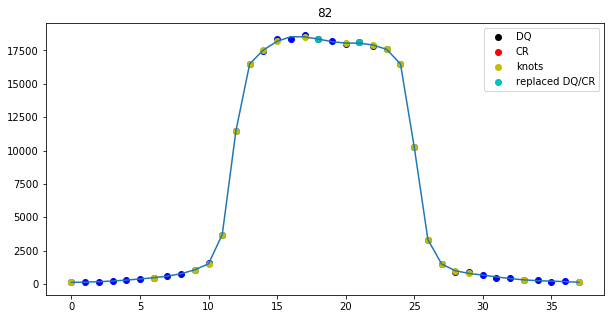

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


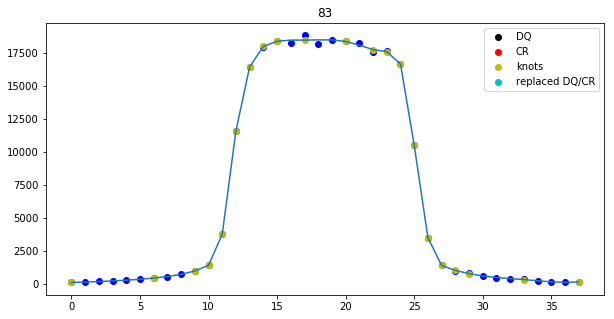

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


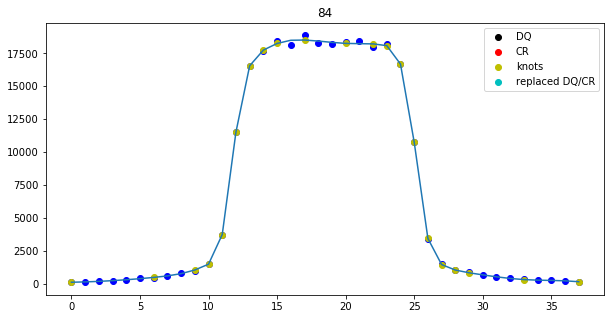

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


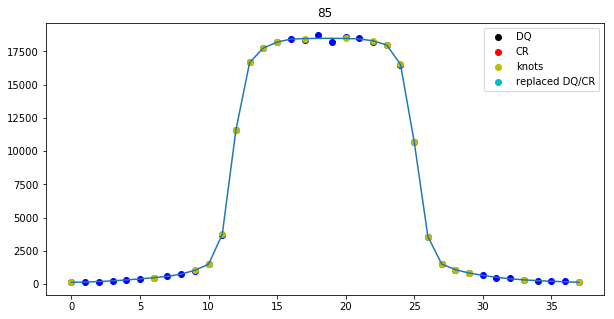

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


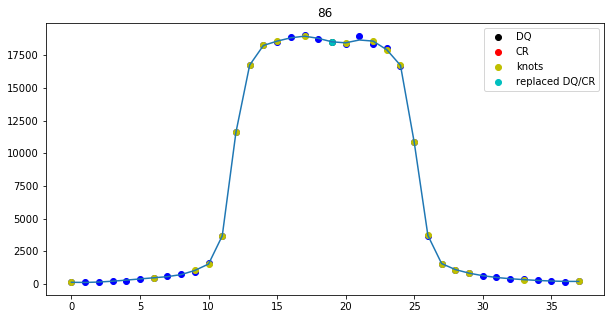

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 2
nr. of CRs 794
Spectrum located at pixel 117 in spatial direction
subexp 169.3970804145454 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 170 for exposure 1
1 13


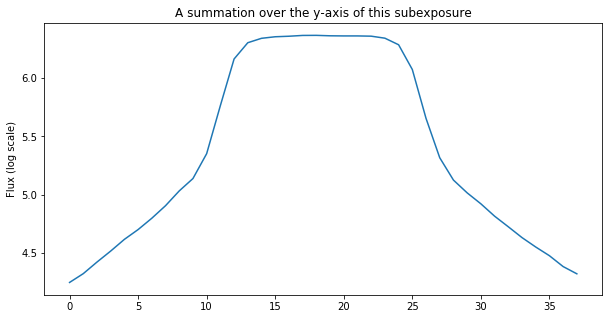

The difference between the two edges (for a 5-pixel bin for all subexps is): 2825.5119140625
This value may not be larger than  2067.323035554273  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


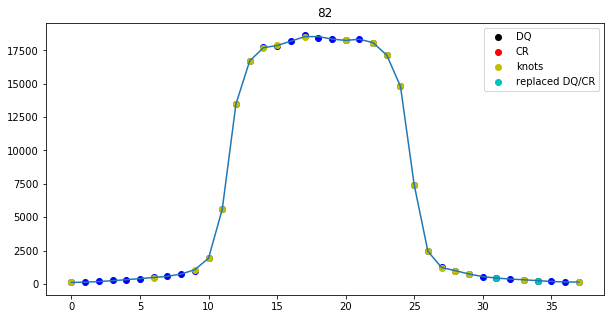

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


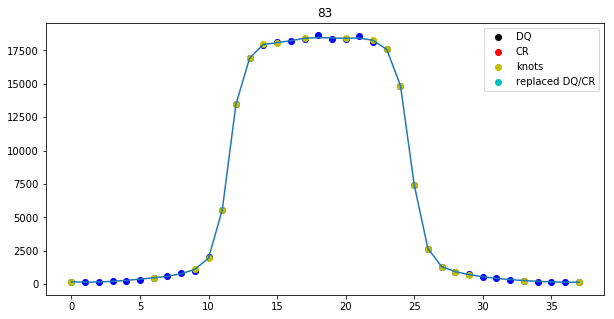

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


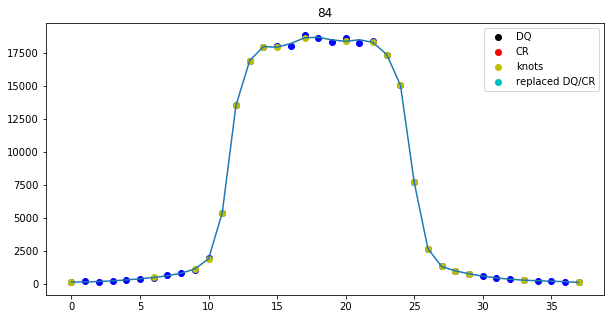

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


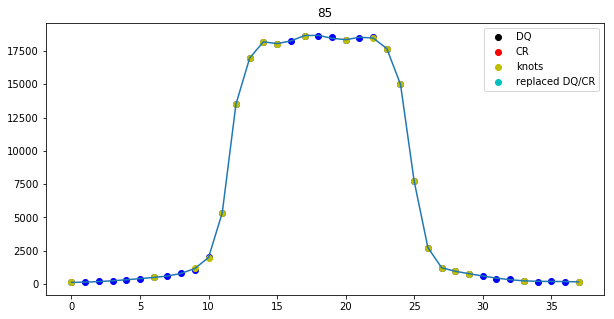

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


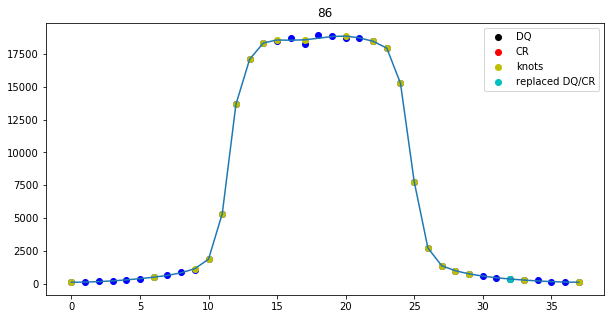

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 3
nr. of CRs 791
Spectrum located at pixel 117 in spatial direction
subexp 156.1000405674624 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 156 for exposure 2
2 13


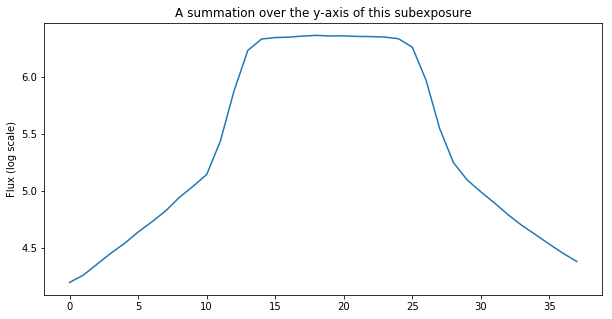

The difference between the two edges (for a 5-pixel bin for all subexps is): 5442.008626302083
This value may not be larger than  2066.166885805694  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


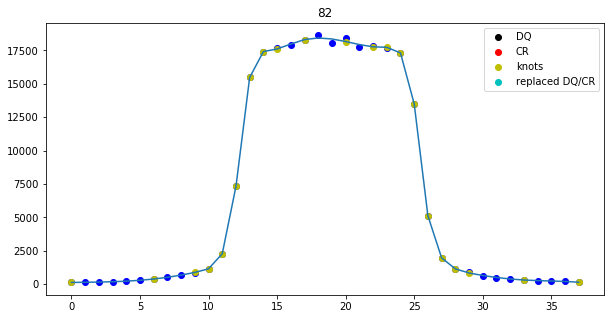

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


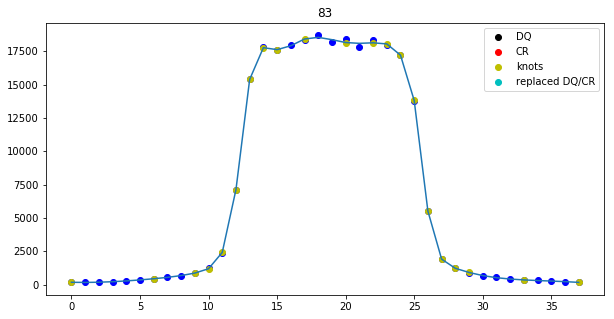

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


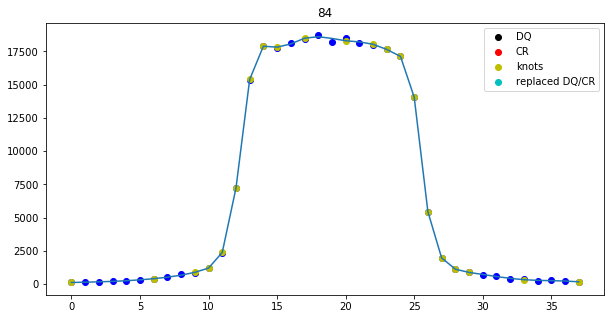

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


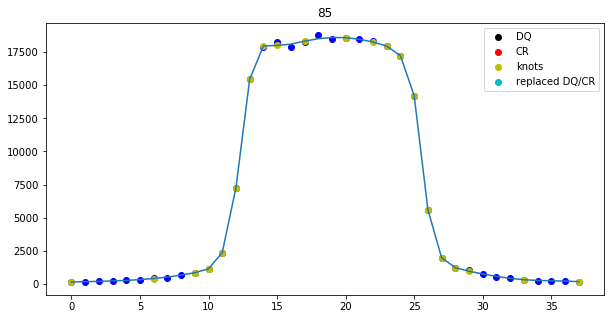

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


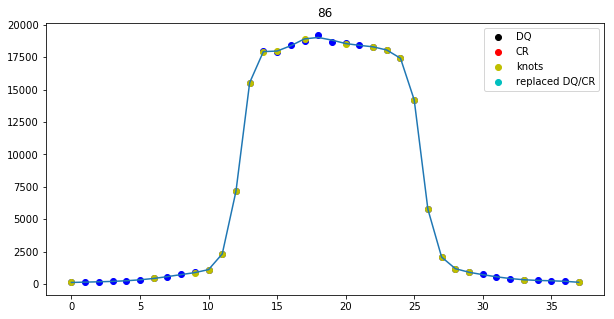

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 4
nr. of CRs 784
Spectrum located at pixel 117 in spatial direction
subexp 142.86747770218759 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 143 for exposure 3
3 13


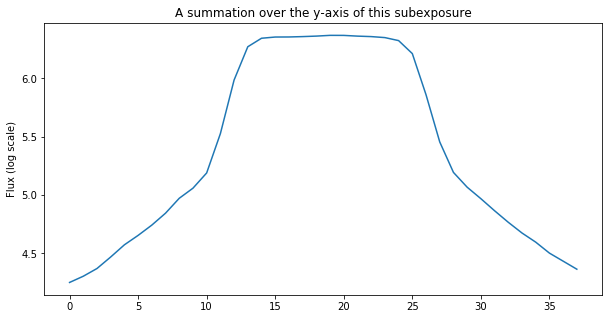

The difference between the two edges (for a 5-pixel bin for all subexps is): 4033.0197916666666
This value may not be larger than  2065.7253124911517  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


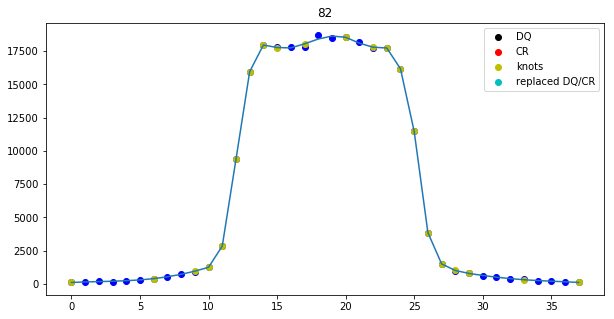

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


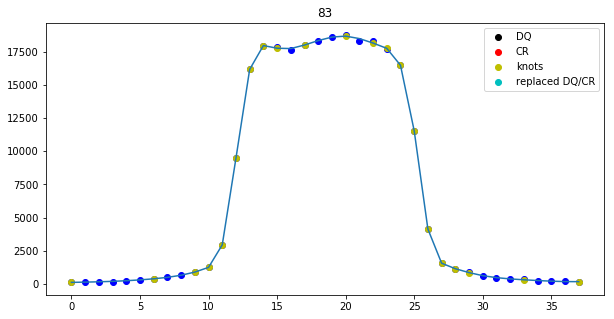

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


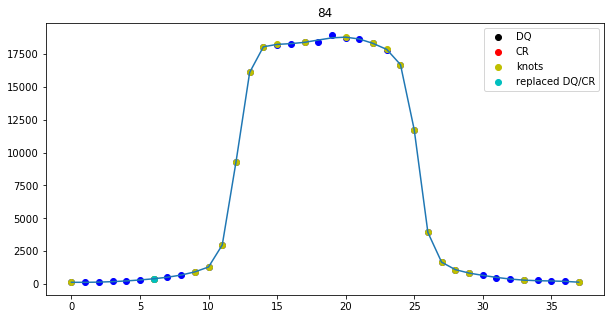

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


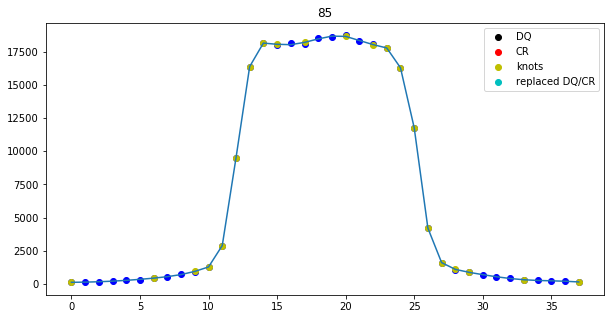

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


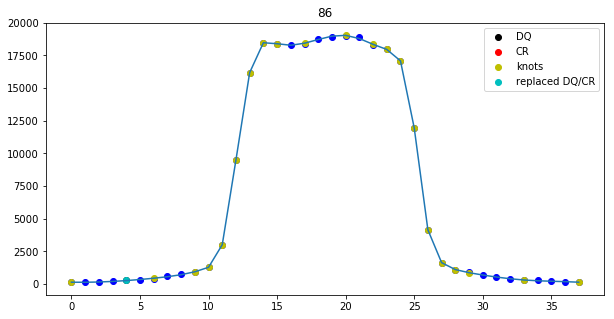

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 5
nr. of CRs 785
Spectrum located at pixel 117 in spatial direction
subexp 129.50752216304727 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 130 for exposure 4
4 13


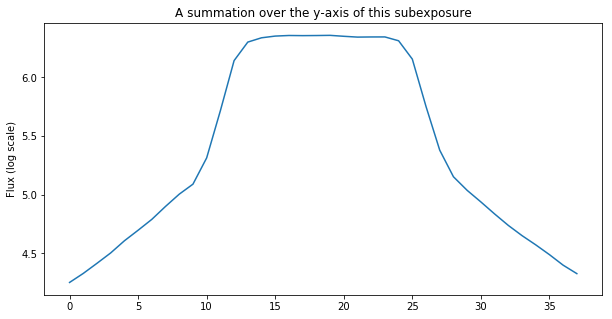

The difference between the two edges (for a 5-pixel bin for all subexps is): 3130.289973958333
This value may not be larger than  2064.984455147302  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


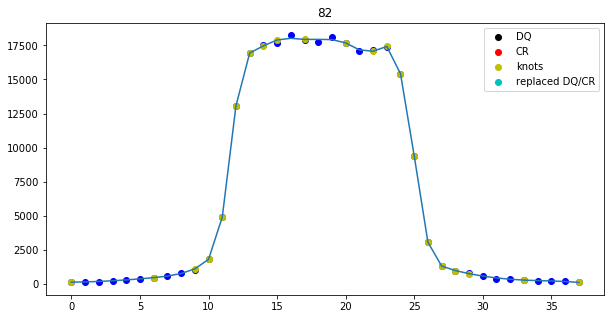

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


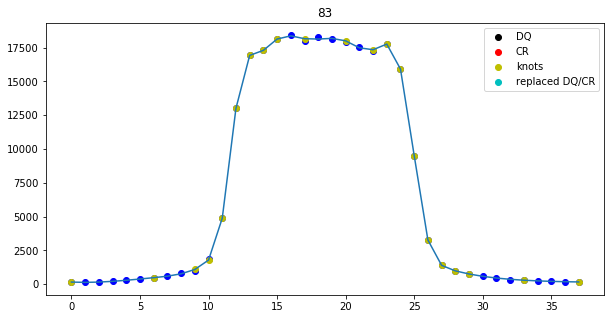

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


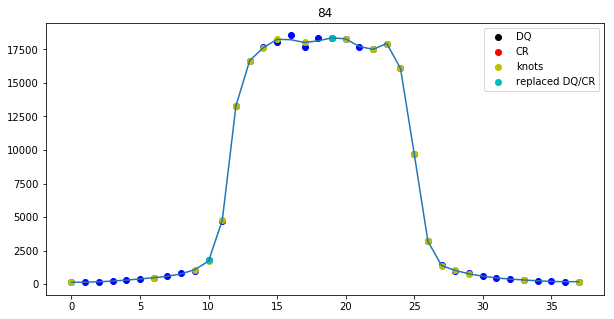

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


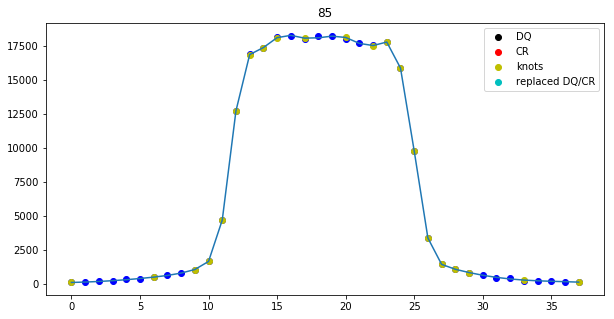

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


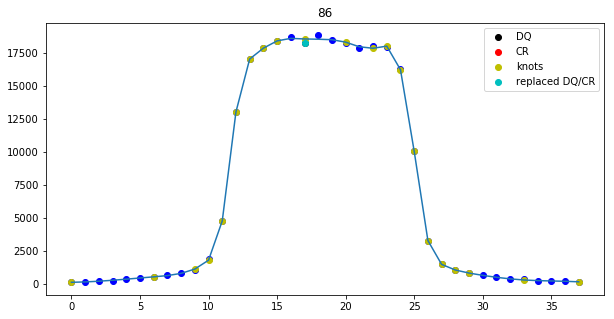

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 6
nr. of CRs 801
Spectrum located at pixel 117 in spatial direction
subexp 116.18008800664951 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 116 for exposure 5
5 13


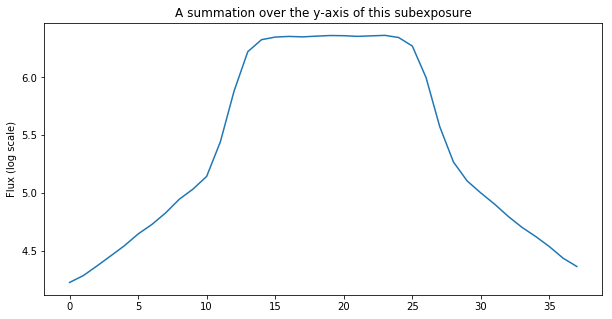

The difference between the two edges (for a 5-pixel bin for all subexps is): 4540.3033203125
This value may not be larger than  2067.548371058502  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


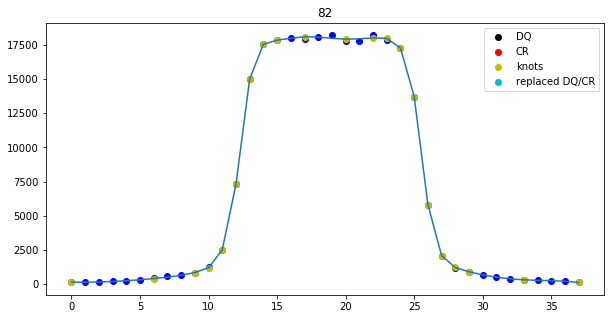

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


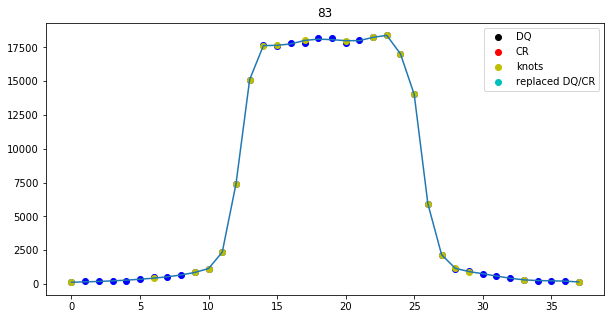

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


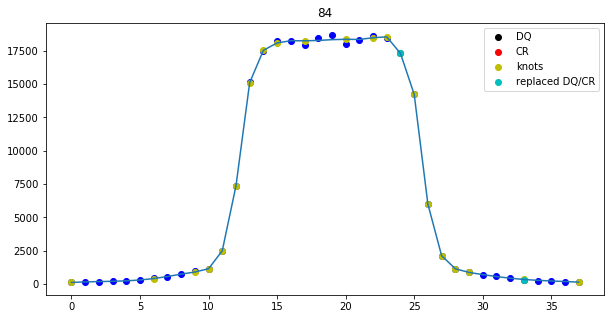

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


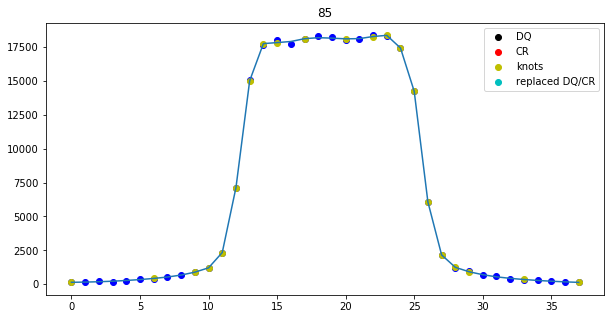

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


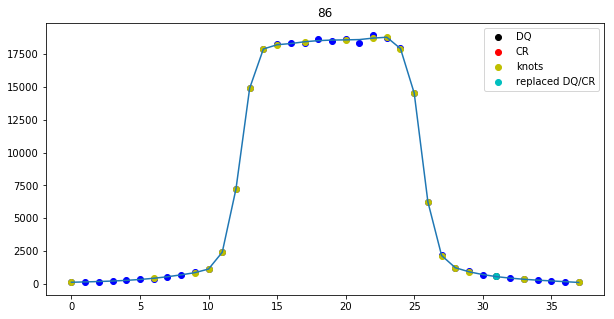

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 7
nr. of CRs 809
Spectrum located at pixel 117 in spatial direction
subexp 102.75194315117746 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 103 for exposure 6
6 13


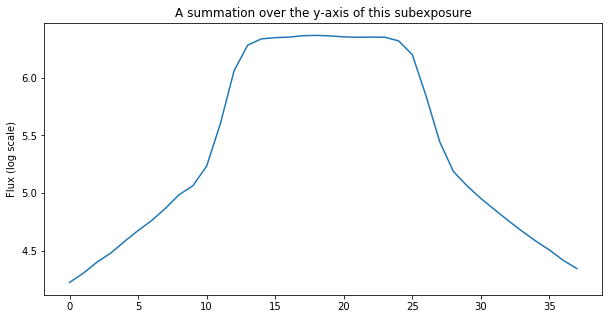

The difference between the two edges (for a 5-pixel bin for all subexps is): 4073.097200520833
This value may not be larger than  2063.902064859991  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


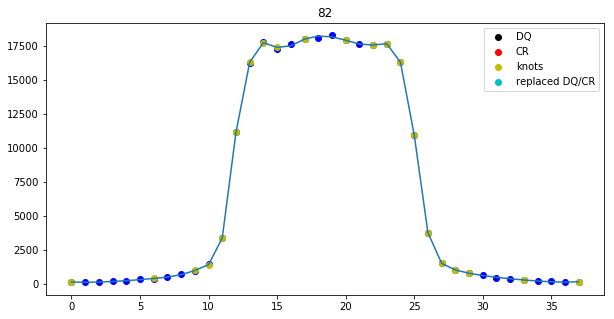

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


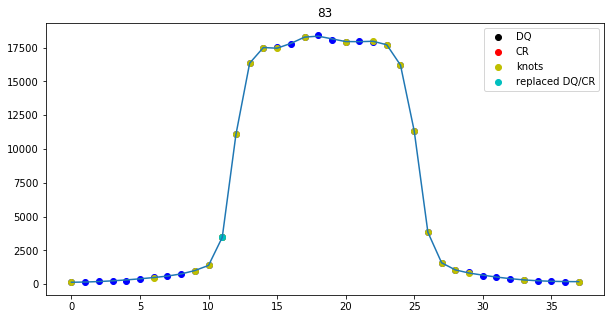

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


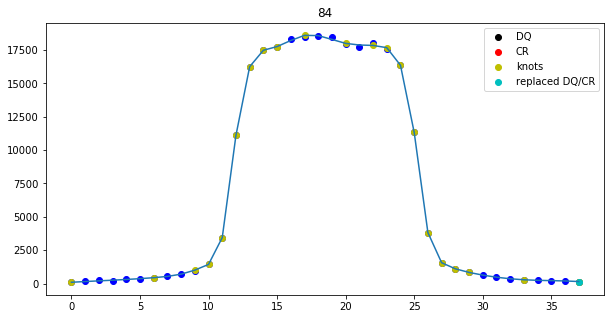

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


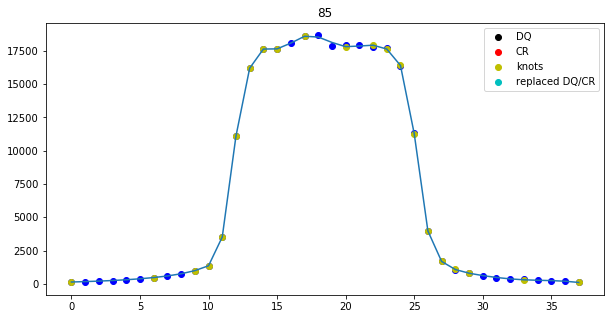

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


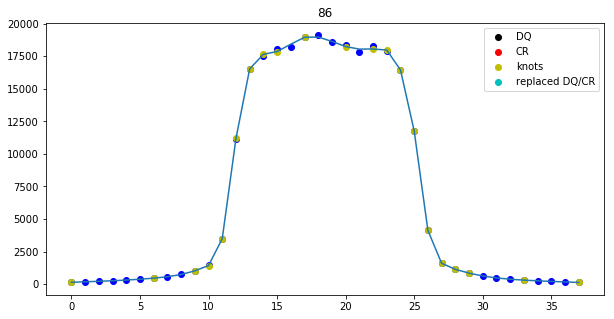

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 8
nr. of CRs 793
Spectrum located at pixel 117 in spatial direction
subexp 89.36785438348655 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 89 for exposure 7
7 13


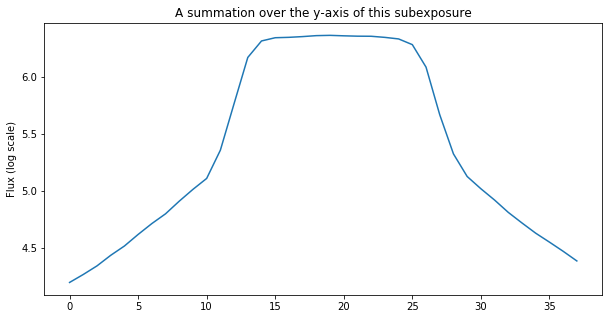

The difference between the two edges (for a 5-pixel bin for all subexps is): 6002.115657552084
This value may not be larger than  2066.0098095927165  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


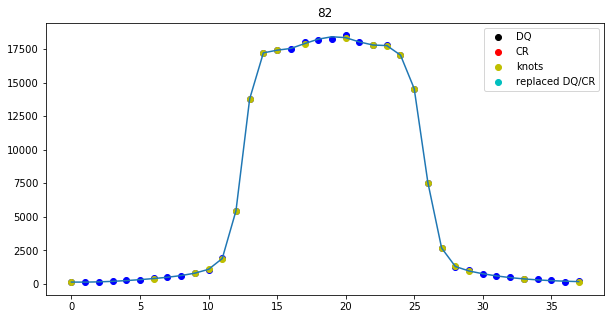

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


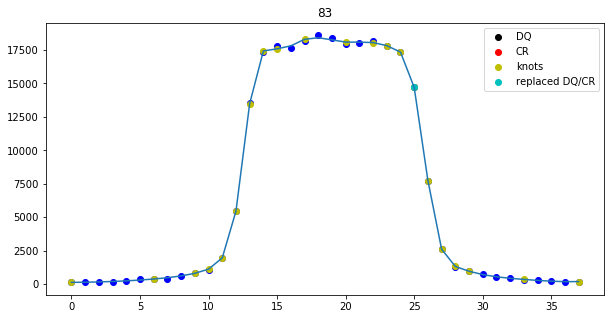

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


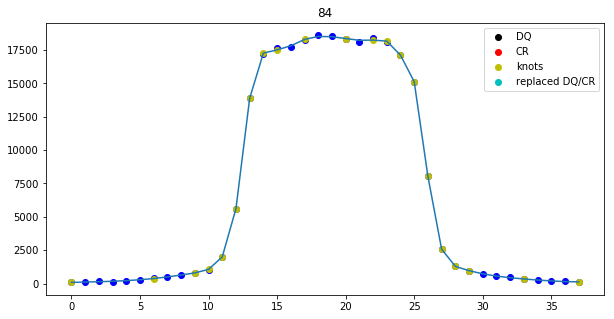

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


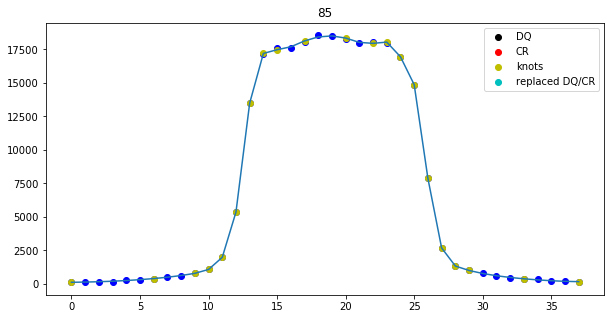

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


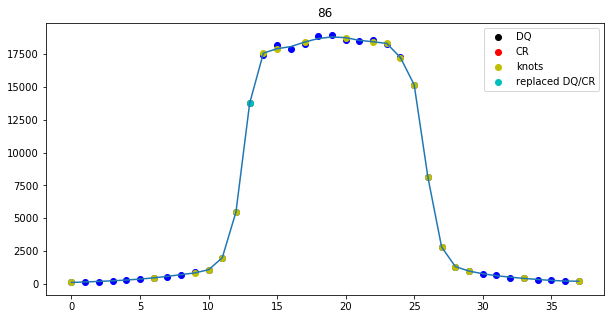

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 9
nr. of CRs 787
Spectrum located at pixel 117 in spatial direction
subexp 75.94082874781236 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 76 for exposure 8
8 13


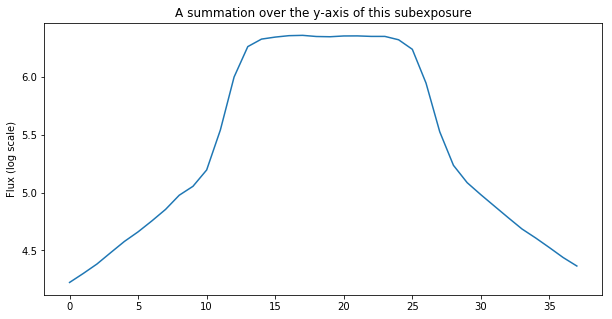

The difference between the two edges (for a 5-pixel bin for all subexps is): 4651.502408854167
This value may not be larger than  2064.790481703491  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


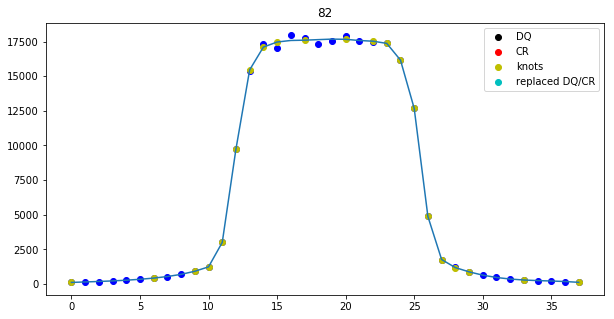

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


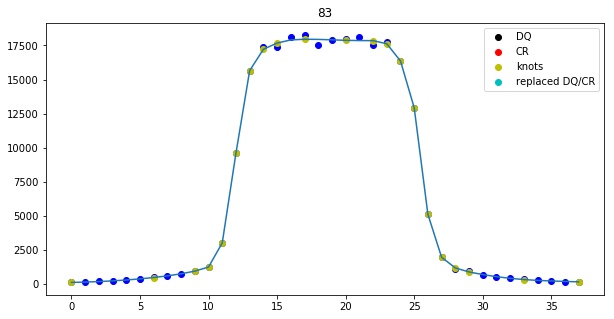

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


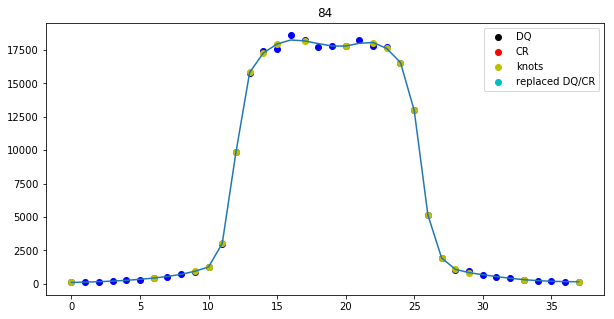

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


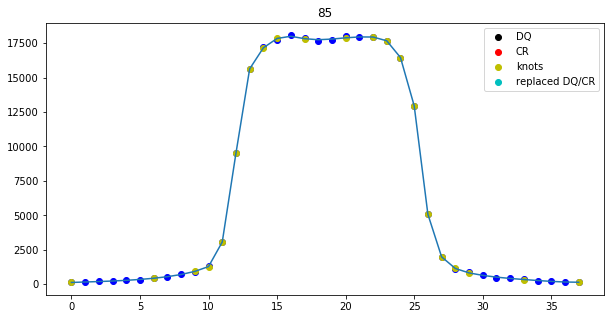

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


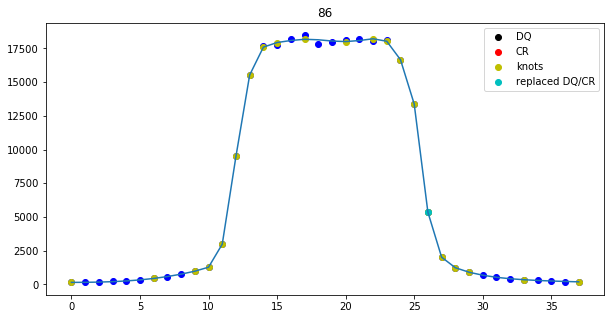

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 10
nr. of CRs 791
Spectrum located at pixel 117 in spatial direction
subexp 62.54080087824445 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 62 for exposure 9
9 13


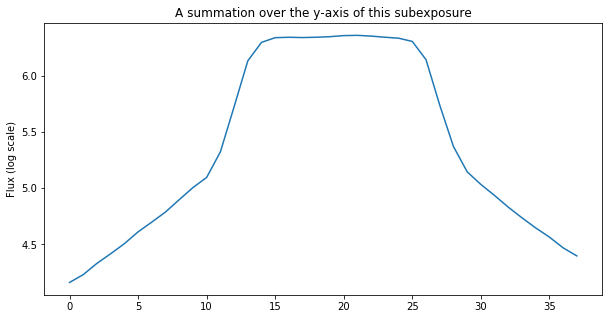

The difference between the two edges (for a 5-pixel bin for all subexps is): 6488.841243489584
This value may not be larger than  2062.167209515271  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


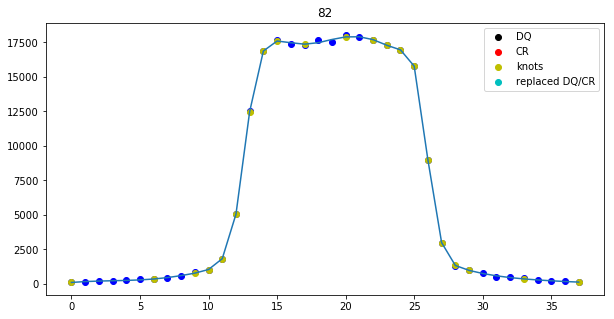

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


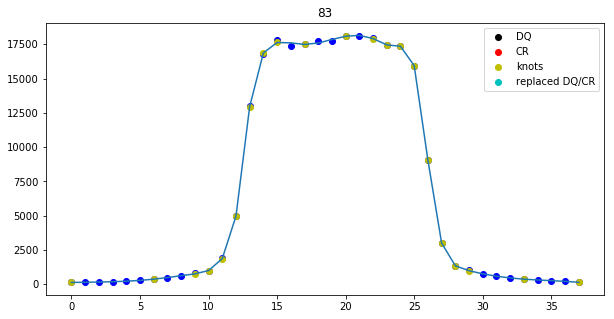

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


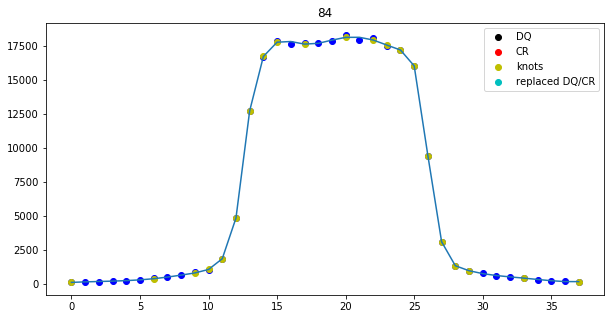

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


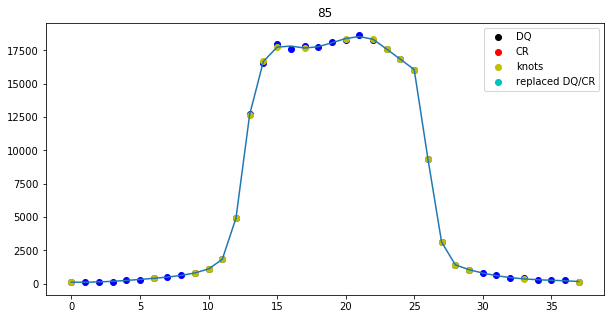

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


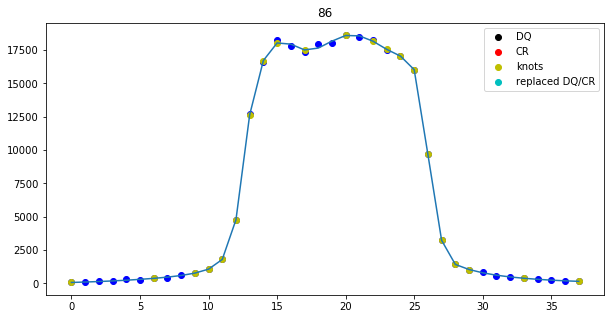

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 5, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 11
nr. of CRs 796
Spectrum located at pixel 117 in spatial direction
subexp 49.02431558793411 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 49 for exposure 10
10 13


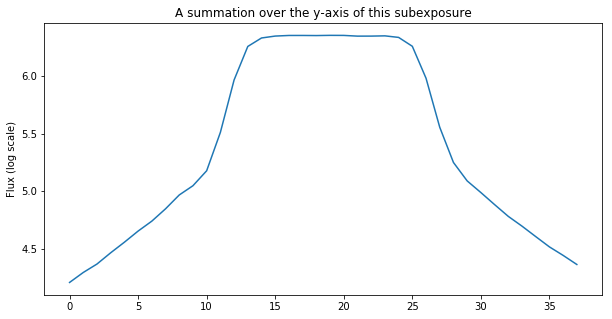

The difference between the two edges (for a 5-pixel bin for all subexps is): 5027.536295572917
This value may not be larger than  2061.4558609552296  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


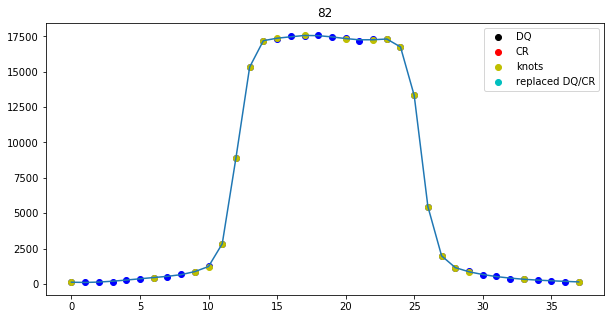

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


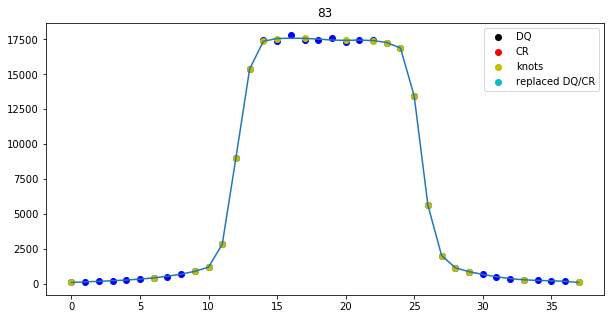

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


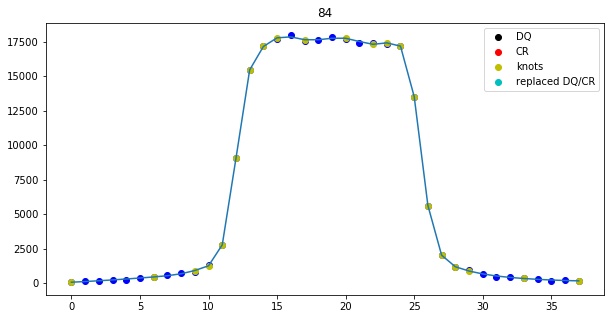

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


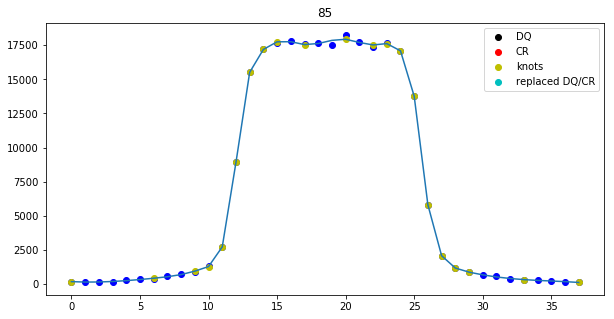

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


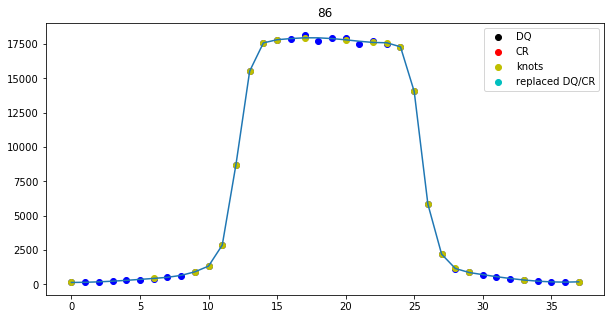

Optimal extraction fitting failed for columns: [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 12
nr. of CRs 798
Spectrum located at pixel 117 in spatial direction
subexp 35.608210213347014 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 36 for exposure 11
11 13


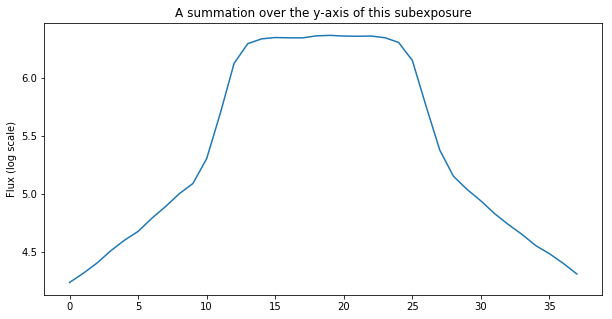

The difference between the two edges (for a 5-pixel bin for all subexps is): 3483.526888020833
This value may not be larger than  2060.302890353746  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


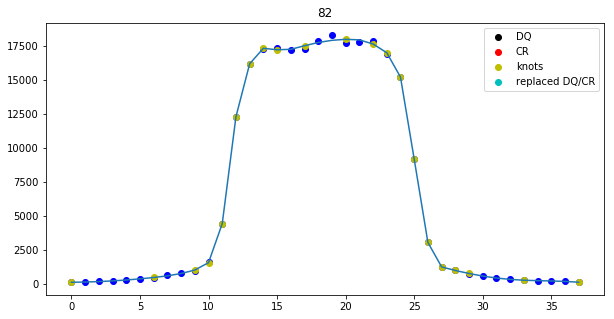

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


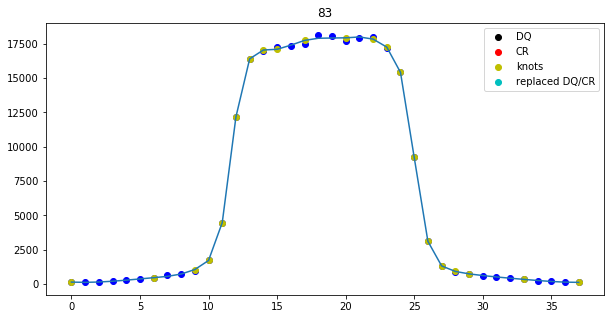

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


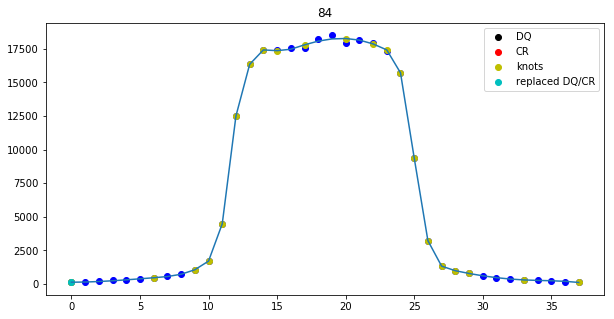

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


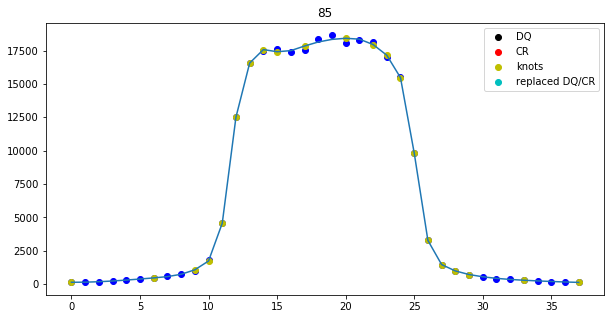

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


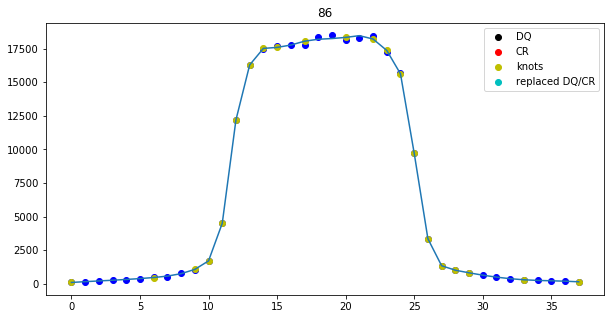

Optimal extraction fitting failed for columns: [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 13
nr. of CRs 796
Spectrum located at pixel 117 in spatial direction
subexp 22.173315595680993 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 22 for exposure 12
12 13


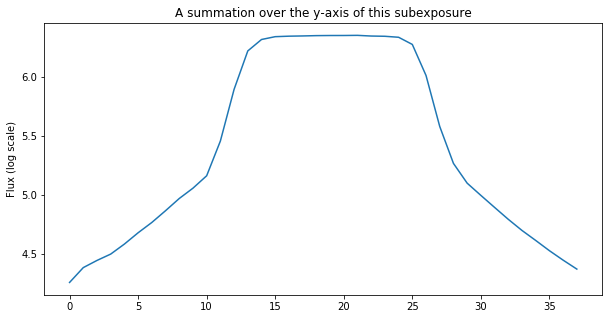

The difference between the two edges (for a 5-pixel bin for all subexps is): 4258.2236328125
This value may not be larger than  2060.458136758263  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


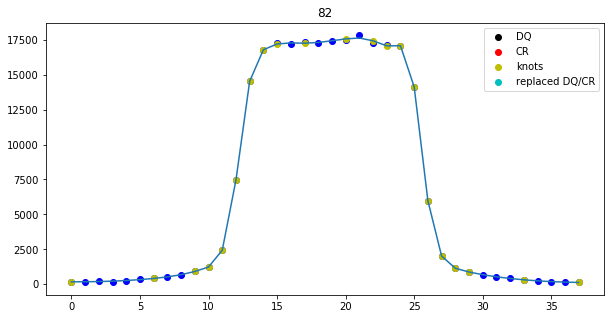

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


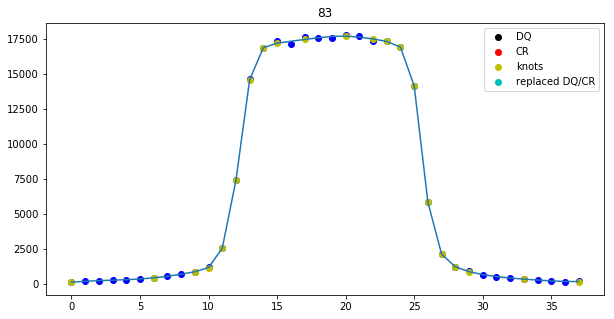

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


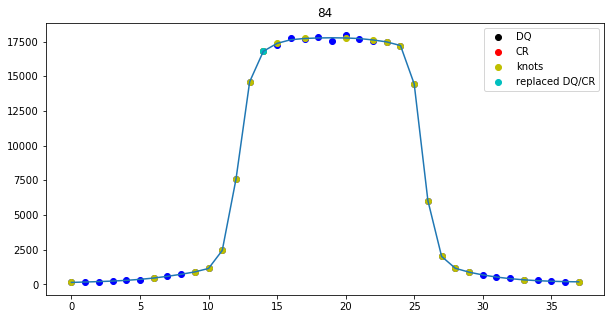

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


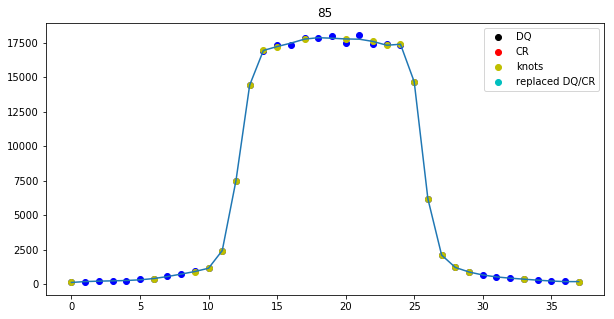

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


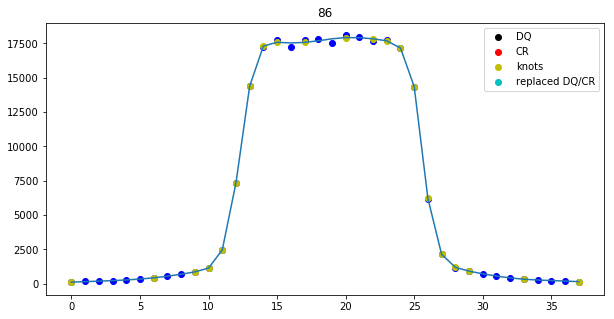

Optimal extraction fitting failed for columns: [0, 5, 6, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE


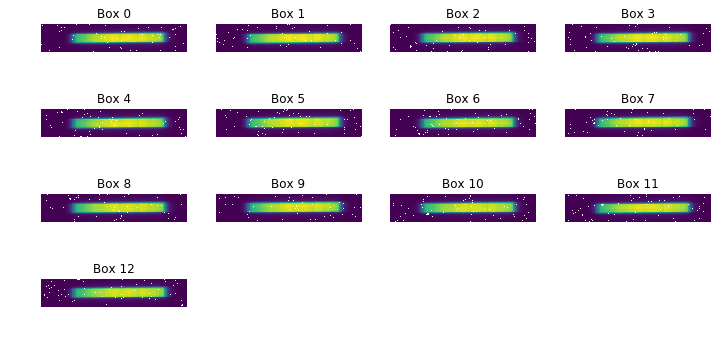

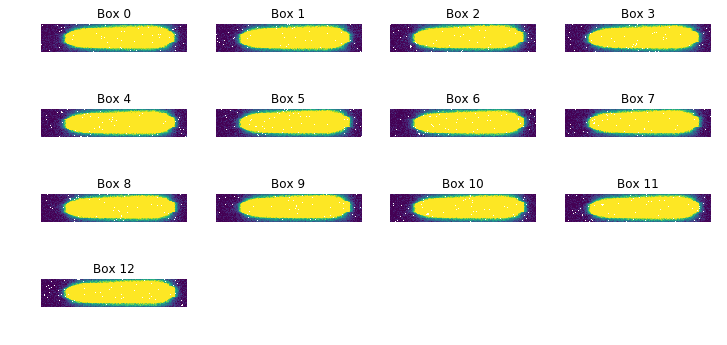

[ 0.00000000e+00  2.22044605e-16  2.22044605e-16  0.00000000e+00
 -1.11022302e-16  1.11022302e-16  3.33066907e-16 -1.11022302e-16
  3.33066907e-16 -1.11022302e-16  0.00000000e+00  2.22044605e-16
  1.11022302e-16  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.22044605e-16  0.00000000e+00 -1.11022302e-16  1.11022302e-16
  0.00000000e+00 -2.22044605e-16  1.11022302e-16  1.11022302e-16
 -2.22044605e-16 -2.22044605e-16  0.00000000e+00  0.00000000e+00
 -2.22044605e-16 -2.22044605e-16  2.22044605e-16 -4.44089210e-16
 -2.22044605e-16  4.44089210e-16  2.22044605e-16 -2.22044605e-16
  2.22044605e-16  2.22044605e-16  2.22044605e-16 -2.22044605e-16
  0.00000000e+00 -4.44089210e-16  2.22044605e-16  0.00000000e+00
 -2.22044605e-16  0.00000000e+00 -2.22044605e-16  0.00000000e+00
  2.22044605e-16  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -4.44089210e-16 -4.44089210e-16  0.00000000e+00 -2.22044605e-16
  0.00000000e+00 -2.22044605e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00  2.22044

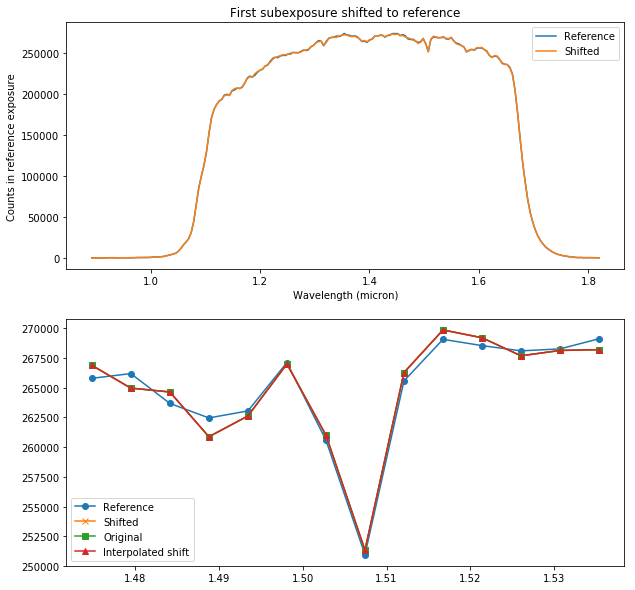

Shifted subexposure nr. 1 with -0.0414819629678 pixels and shrunk 0.0640488750463 percent.
Shifted subexposure nr. 2 with -0.135764415115 pixels and shrunk 0.133205151525 percent.
Shifted subexposure nr. 3 with -0.261473788855 pixels and shrunk 0.197004090817 percent.
Shifted subexposure nr. 4 with -0.406114990254 pixels and shrunk 0.282301036412 percent.
Shifted subexposure nr. 5 with -0.552476190469 pixels and shrunk 0.359232363298 percent.
Shifted subexposure nr. 6 with -0.683278494585 pixels and shrunk 0.436757717523 percent.
Shifted subexposure nr. 7 with -0.850236243252 pixels and shrunk 0.520906718203 percent.
Shifted subexposure nr. 8 with -0.858228004547 pixels and shrunk 0.557517212794 percent.
Shifted subexposure nr. 9 with -0.976458818097 pixels and shrunk 0.623467813804 percent.
Shifted subexposure nr. 10 with -1.05119244035 pixels and shrunk 0.701999709104 percent.
Shifted subexposure nr. 11 with -1.12225573991 pixels and shrunk 0.752737015269 percent.
Shifted subexposure

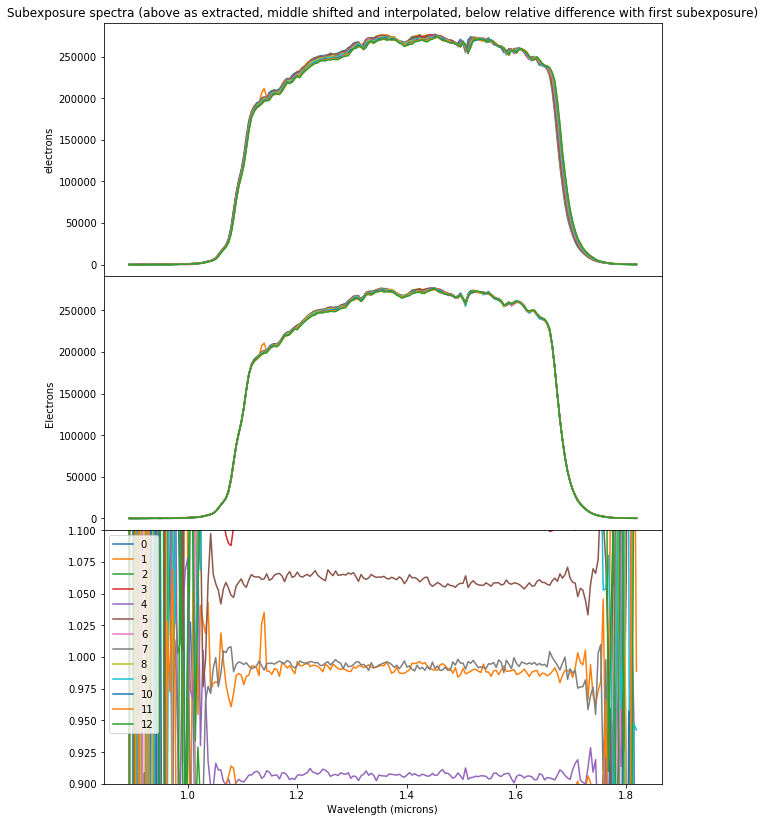

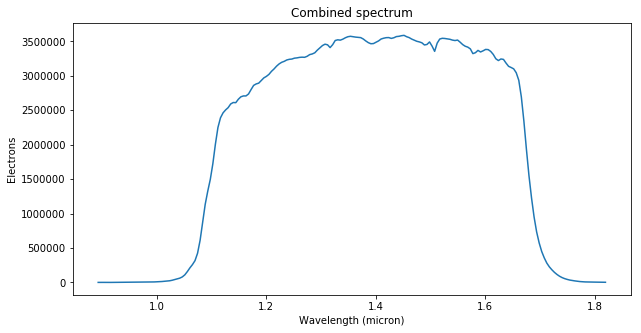

Extraction took 13.61s
########################################
###########Finished Extraction##########
########################################


In [7]:
#fname = 'idn201bgq_ima.fits'  #First visit
fname = 'idn201daq_ima.fits'  #First visit
#fname = 'idn202j6q_ima.fits'  #Second visit
#fname = 'idn202ltq_ima.fits'  #Second visit
#fname = 'idn202j7q_ima.fits'  #Second visit
#fname = 'idn203s4q_ima.fits'  #Third visit
#fname = 'idn203tlq_ima.fits'  #Third visit
#fname = 'idn204zyq_ima.fits'  #Fourth visit
#fname = 'idn205o6q_ima.fits'  #Fifth visit
#fname = 'idn205qoq_ima.fits'  #Fifth visit
#fname = 'idn203tgq_ima.fits'    #sumting went rong
#fname = 'idn205o8q_ima.fits'
#fname = 'idn203thq_ima.fits'    #sumting went rong

reload(pipe)
visit = int(fname.split('idn20')[1][0])
TestFile = pyfits.open(data_dir + fname)
if visit == 1:
    #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
    Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
    Ref_exp = ref_Images[0].split('_ima.fits')[0]
    ypix_F = ypix_F_1
    ypix_R = ypix_R_1
    custom_knots = custom_knots_long1
if visit == 2:
    #Bg_x, Bg_y, Bg_w, Bg_h = (5, 25, 40, 40)
    Bg_x, Bg_y, Bg_w, Bg_h = (5, 5, 38, 60)
    Ref_exp = ref_Images[1].split('_ima.fits')[0]
    ypix_F = ypix_F_2
    ypix_R = ypix_R_2
    custom_knots = custom_knots_long2
if visit == 3:
    #Bg_x, Bg_y, Bg_w, Bg_h = (5, 25, 40, 40)
    Bg_x, Bg_y, Bg_w, Bg_h = (5, 5, 38, 60)
    Ref_exp = ref_Images[2].split('_ima.fits')[0]
    ypix_F = ypix_F_3
    ypix_R = ypix_R_3
    custom_knots = custom_knots_short1
if visit == 4:
    #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
    Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
    Ref_exp = ref_Images[3].split('_ima.fits')[0]
    ypix_F = ypix_F_4
    ypix_R = ypix_R_4
    custom_knots = custom_knots_short2
if visit == 5:
    #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
    Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
    Ref_exp = ref_Images[4].split('_ima.fits')[0]
    ypix_F = ypix_F_5
    ypix_R = ypix_R_5
    custom_knots = custom_knots_short2

Save_sub = False
    
print Ref_exp
    
    
exp = pipe.reduce_exposure(fname, pdf=False, logger=False, debug=True,
                           skip_start=1,
                           bg_x = Bg_x, bg_y = Bg_y, bg_w = Bg_w, bg_h = Bg_h,
                           tsiaras=False,  
                           ref_exp = Ref_exp,
                           conf_file=conf_file_red, \
                           source_dir=data_dir, write = False)
if noknots:
    exp_spectrum, variance, interp_spectra, variances = \
                    pipe.extract_spectra(exp, pdf=False, logger=False, debug=True,
                    conf_file=conf_file_ext,
                                         order=3, fit_tol=0.03,
                                         outliers_to_average=True,
                    save_dir=output_dir, save_sub=Save_sub, write=False)
else:
        exp_spectrum, variance, interp_spectra, variances = \
                    pipe.extract_spectra(exp, pdf=False, logger=False, debug=True,
                    conf_file=conf_file_ext,
                    custom_knots_F=custom_knots, custom_knots_R=custom_knots[::-1], ypix_F=ypix_F, ypix_R=ypix_R,
                    save_dir=output_dir, save_sub=Save_sub, write=False)

# Taking multiple images...

In [8]:
Images = glob.glob(data_dir + '*20*_ima.fits')
Images = np.sort([image.replace(data_dir, '') for image in Images])
Images = [str(I) for I in Images]


In [9]:
Direct_images = []
with open(data_dir + 'visit_driz.lis') as g:
    for line in g:
        Direct_images.append(line.replace('\n',''))
for image in Direct_images:
    imagename = image.replace('_drz', '_ima')
    if imagename in Images:
        Images.remove(imagename)

In [10]:
Images

['idn201bgq_ima.fits',
 'idn201bhq_ima.fits',
 'idn201biq_ima.fits',
 'idn201bjq_ima.fits',
 'idn201blq_ima.fits',
 'idn201bmq_ima.fits',
 'idn201bnq_ima.fits',
 'idn201bpq_ima.fits',
 'idn201bqq_ima.fits',
 'idn201brq_ima.fits',
 'idn201buq_ima.fits',
 'idn201bvq_ima.fits',
 'idn201bwq_ima.fits',
 'idn201byq_ima.fits',
 'idn201c2q_ima.fits',
 'idn201c4q_ima.fits',
 'idn201c6q_ima.fits',
 'idn201c7q_ima.fits',
 'idn201cgq_ima.fits',
 'idn201ciq_ima.fits',
 'idn201cjq_ima.fits',
 'idn201clq_ima.fits',
 'idn201cnq_ima.fits',
 'idn201coq_ima.fits',
 'idn201cpq_ima.fits',
 'idn201crq_ima.fits',
 'idn201csq_ima.fits',
 'idn201ctq_ima.fits',
 'idn201cvq_ima.fits',
 'idn201cwq_ima.fits',
 'idn201cxq_ima.fits',
 'idn201d0q_ima.fits',
 'idn201d1q_ima.fits',
 'idn201d2q_ima.fits',
 'idn201d5q_ima.fits',
 'idn201d9q_ima.fits',
 'idn201daq_ima.fits',
 'idn201dkq_ima.fits',
 'idn201dlq_ima.fits',
 'idn201dmq_ima.fits',
 'idn201doq_ima.fits',
 'idn201dpq_ima.fits',
 'idn201dqq_ima.fits',
 'idn201dsq

First do the reference exposures. They should be the first spectrum of each visit.

In [11]:
visit

5

In [12]:
fname

'idn205qoq_ima.fits'

########################################
############Started Reduction##########
########################################
Data reduction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bgq_ima.fits
For configuration, see pipeline conf file: /Users/bob/Documents/PhD/WASP-80/transmission_reduction.conf
Forward scan
Catalogue used: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bfq_flt_1.cat
Direct Image name: idn201bfq
catalogue /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bfq_flt_1.cat
Catalogue file: idn201bfq_ima.fits
########################
Direct image location of (138.685597286,106.279065053)
FWHM of this subexposure is  13.260411774828697


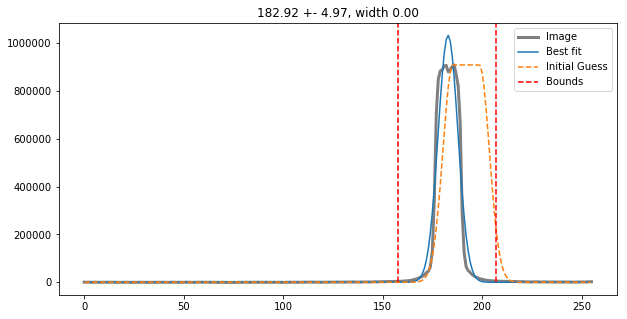

using a PHOENIX stellar model
amplitude and displacement on first order: -15.894706555609591 -121.29561931811975


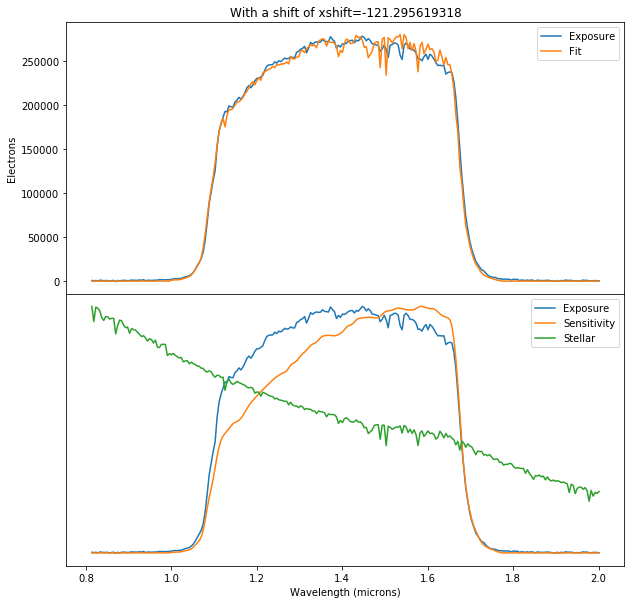

Applied an xshift of -121.295619318 pix from a comparison to a stellar spectrum
Initial xpix is 17 and shift_in_x: -121.295619318
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 75.05 pix
FWHM of this subexposure is  13.339917606655035


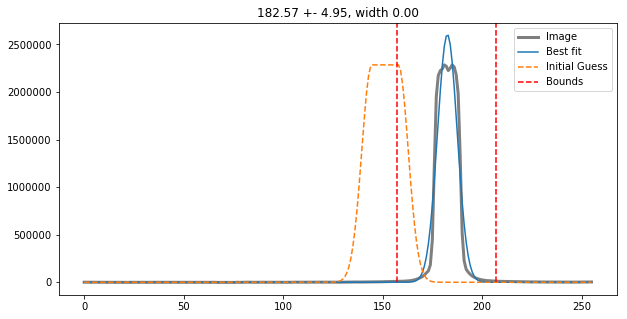

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.384428486316722


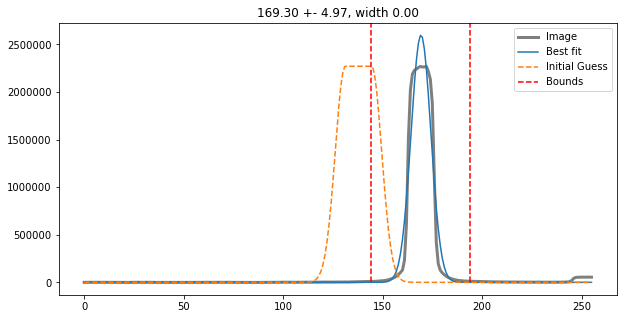

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.235871348192347


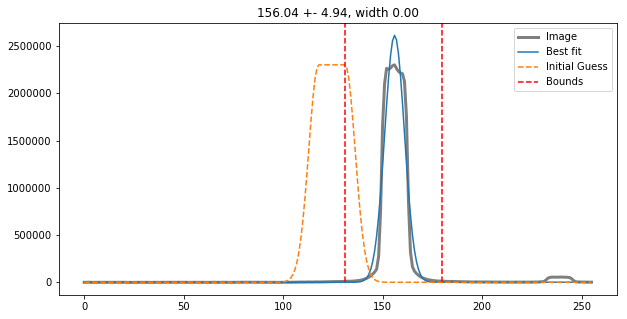

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.400499962559138


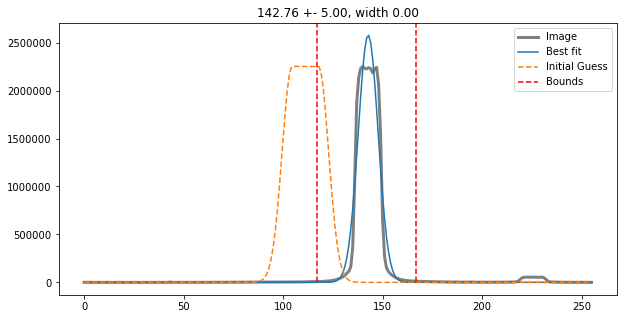

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.45126609746994


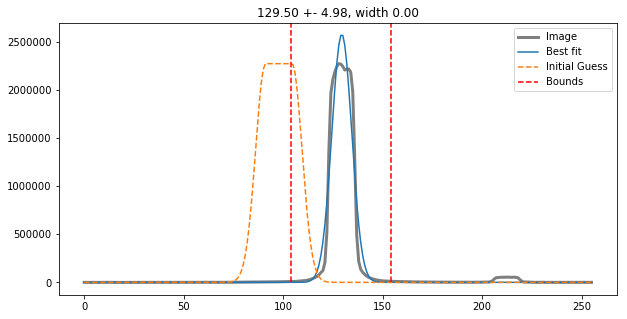

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.447369505029926


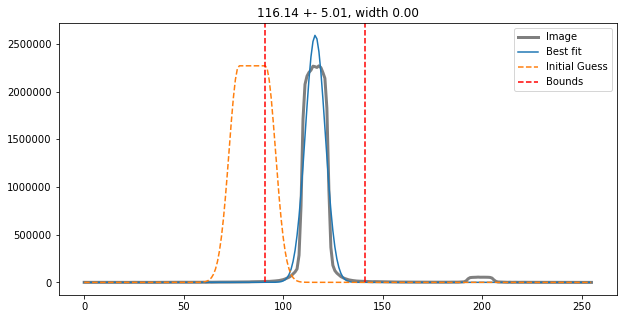

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.530620089047133


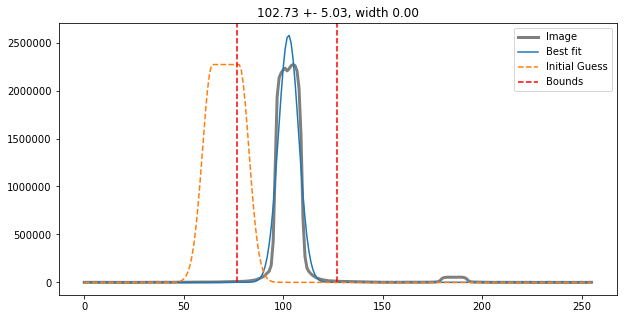

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.458332063189516


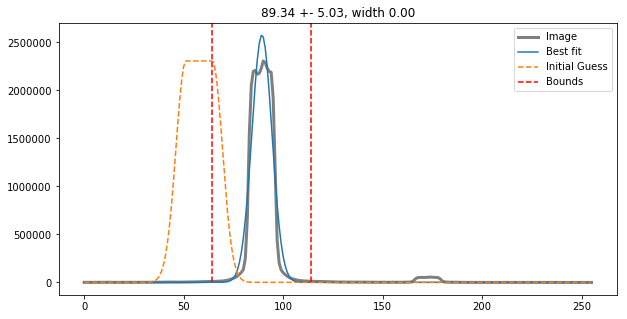

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.45785614534961


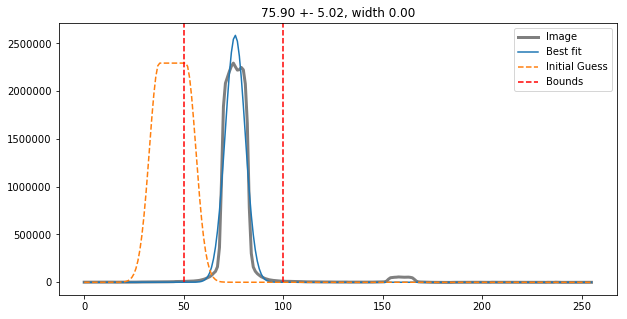

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.495034177832252


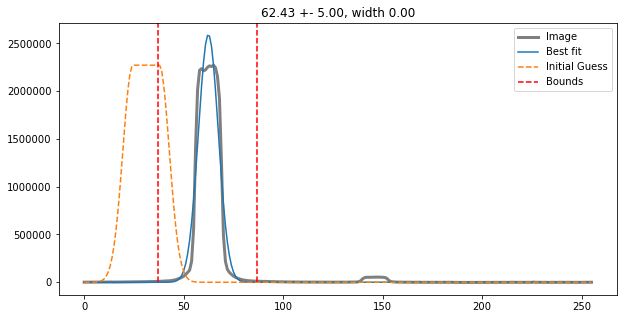

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.452295138154462


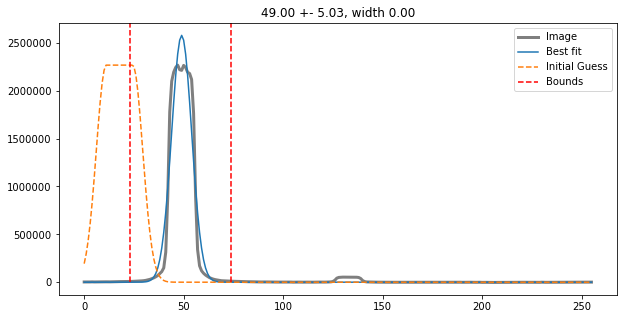

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.62763759241755


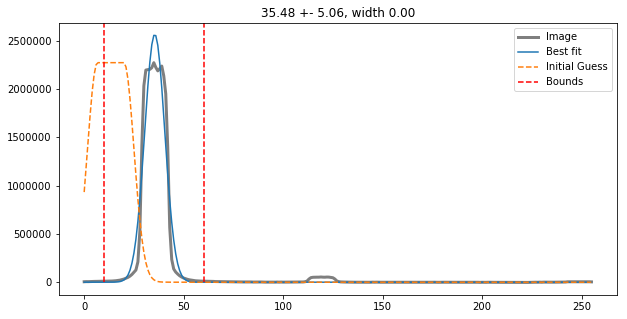

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.381215631506613


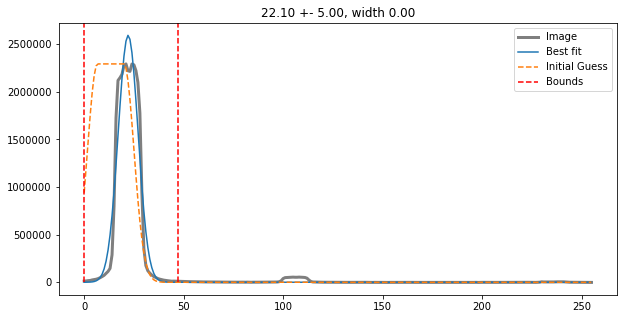

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
The final xpix is 17
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 75.05 pix
FWHM of this subexposure is  13.339917606655035


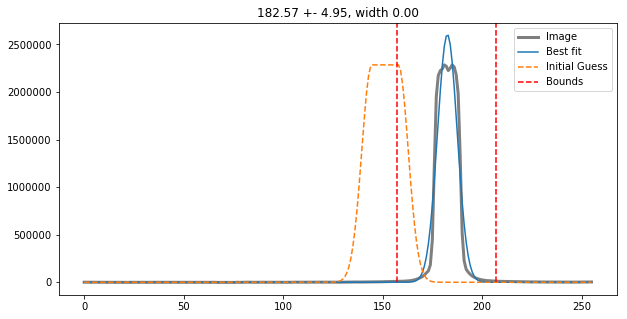

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.384428486316722


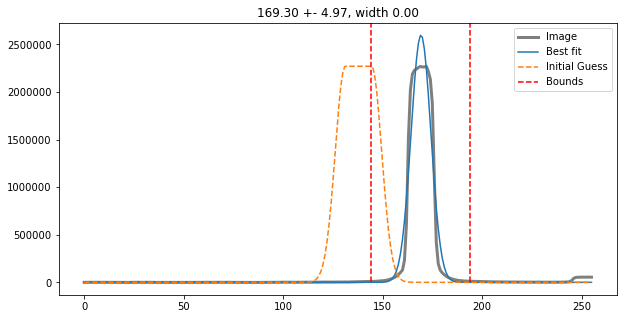

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.235871348192347


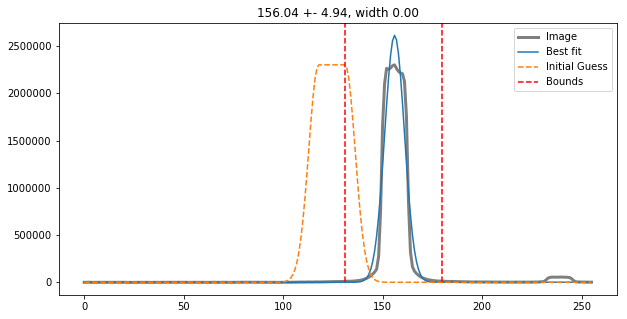

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.400499962559138


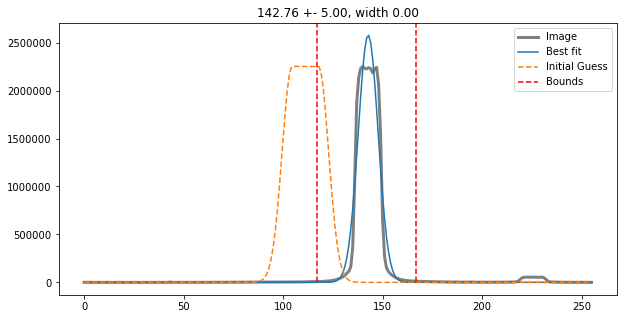

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.45126609746994


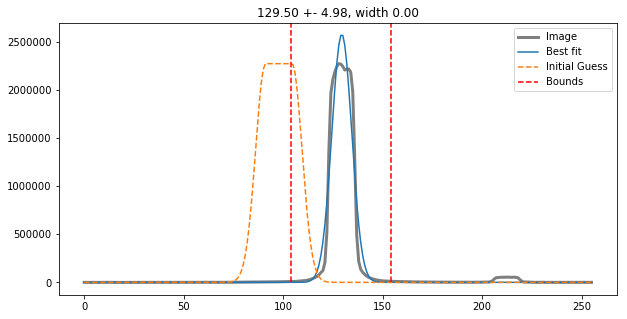

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.447369505029926


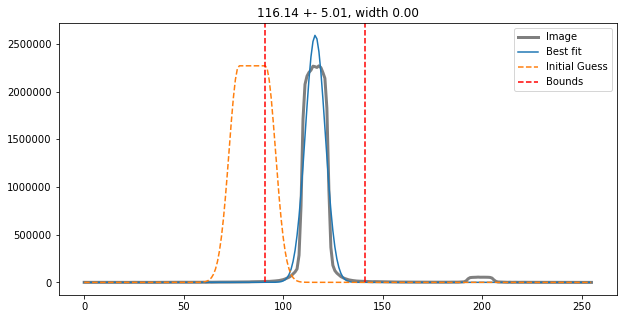

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.530620089047133


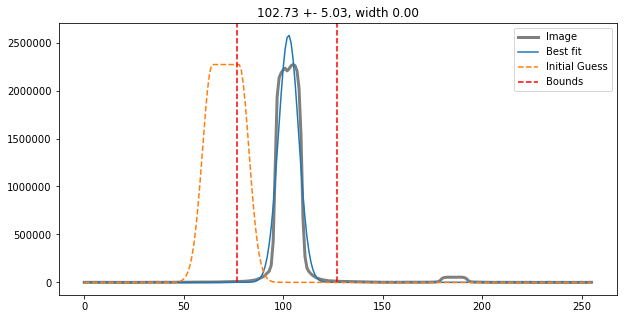

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.458332063189516


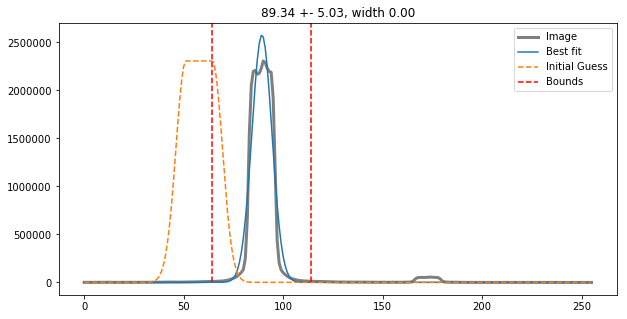

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.45785614534961


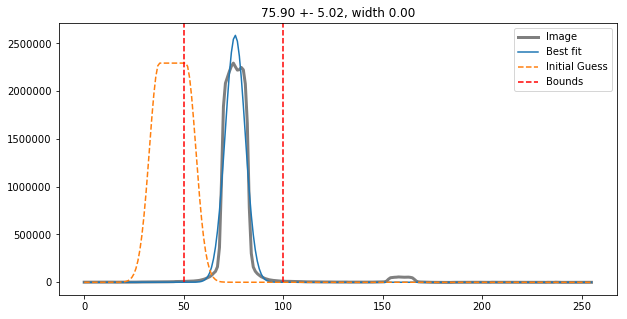

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.495034177832252


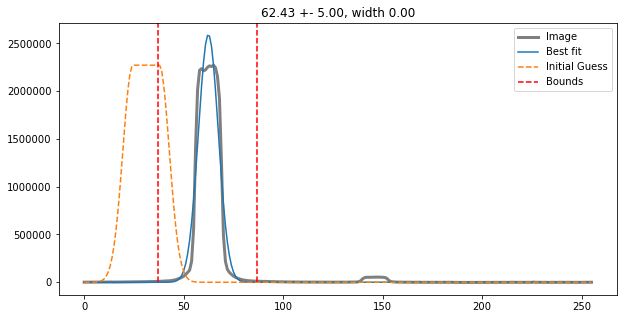

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.452295138154462


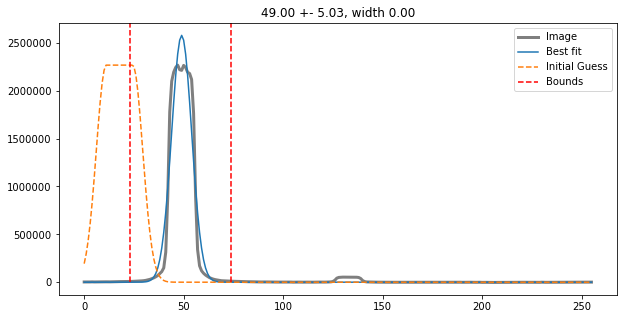

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.62763759241755


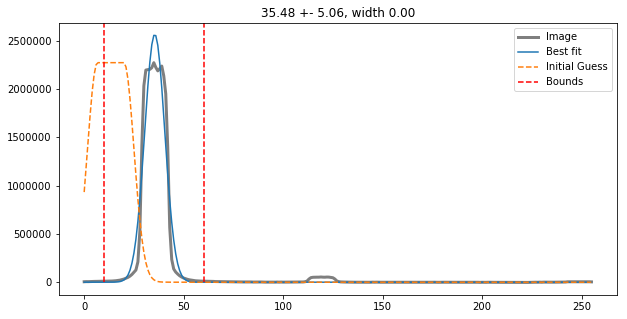

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.381215631506613


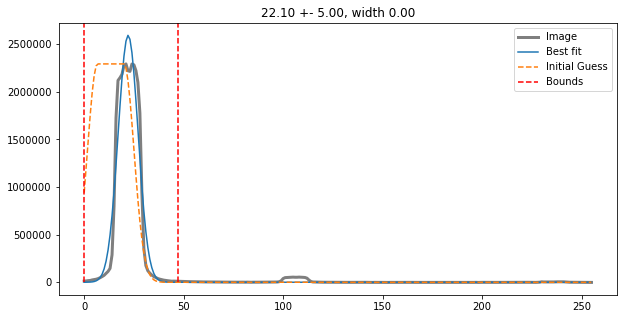

SHIFTINX -121.29561931811975
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
nr_CRs, Lows 9 0
nr_CRs, Lows 11 0
nr_CRs, Lows 9 0
nr_CRs, Lows 14 0
nr_CRs, Lows 8 0
nr_CRs, Lows 11 1
nr_CRs, Lows 5 0
nr_CRs, Lows 9 0
nr_CRs, Lows 11 0
nr_CRs, Lows 11 1
nr_CRs, Lows 5 0
nr_CRs, Lows 8 0
nr_CRs, Lows 9 1
95.782104
95.782104 95.782104
Saving reduced file to /Users/bob/Documents/PhD/WASP-80/output/
Saving reduced exposure to /Users/bob/Documents/PhD/WASP-80/output/idn201bgq_red.fits...
Reduction took 11.08s
########################################
###########Finished Reduction###########
########################################
########################################
############Started Extraction##########
########################################
Spectral extraction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn201bgq_ima.fits
For configuration, see conf file: /Users/bob/Documents/PhD/WASP-80/transmission_extraction.conf
Forward scan
Extracting from 

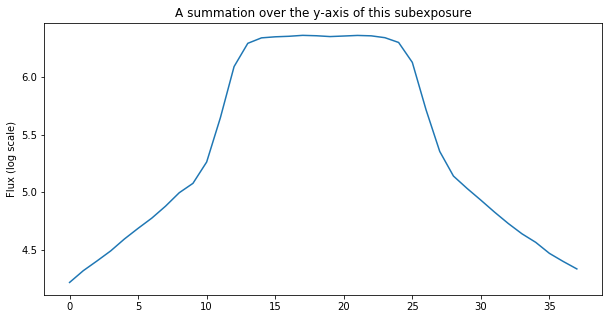

The difference between the two edges (for a 5-pixel bin for all subexps is): 3723.5233072916667
This value may not be larger than  2051.2801206401173  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Using flux for variance estimate
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


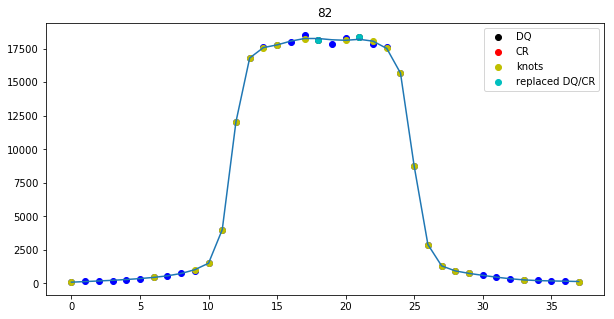

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


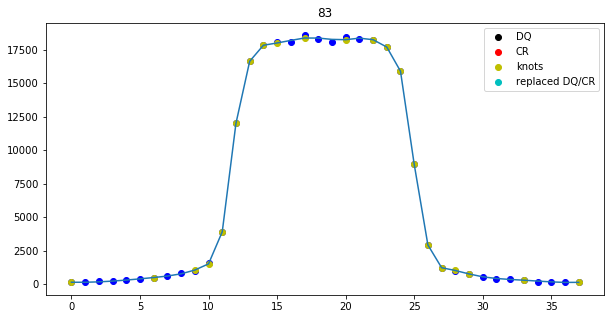

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


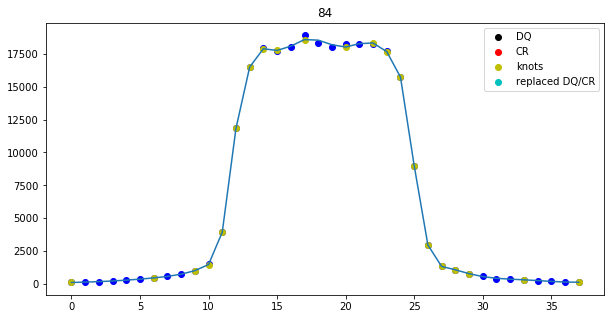

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


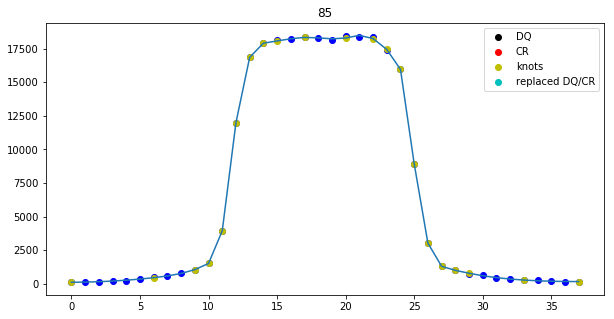

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


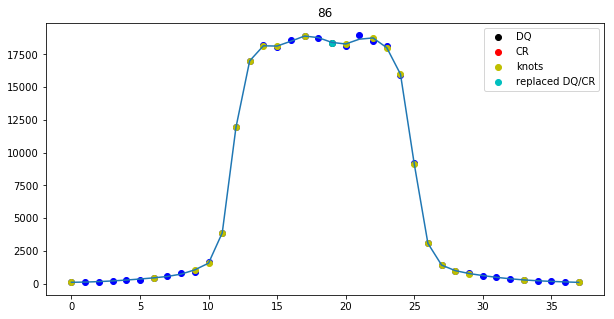

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 2
nr. of CRs 791
Spectrum located at pixel 117 in spatial direction
subexp 169.30093887694466 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 170 for exposure 1
1 13


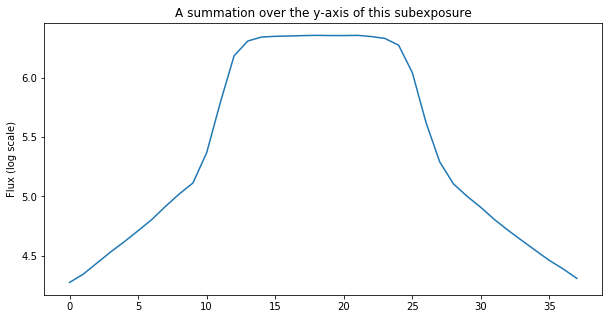

The difference between the two edges (for a 5-pixel bin for all subexps is): 2451.4546875
This value may not be larger than  2052.2893883011075  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


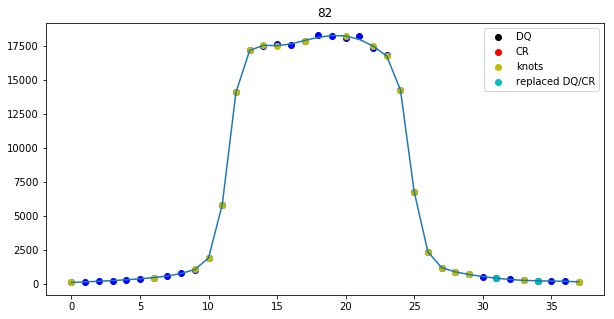

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


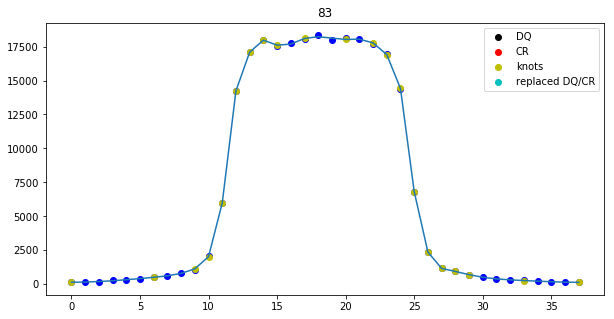

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


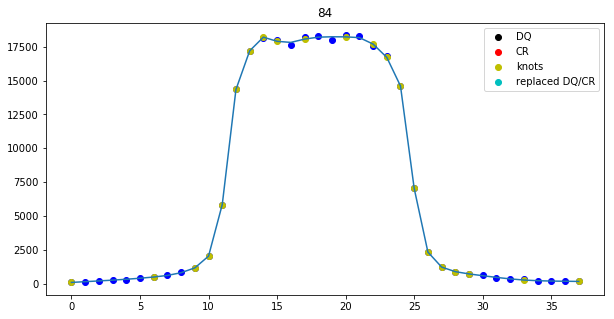

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


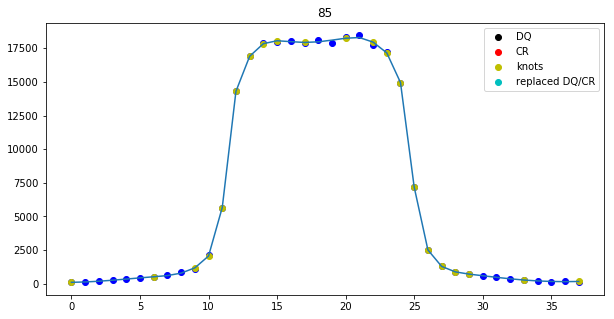

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


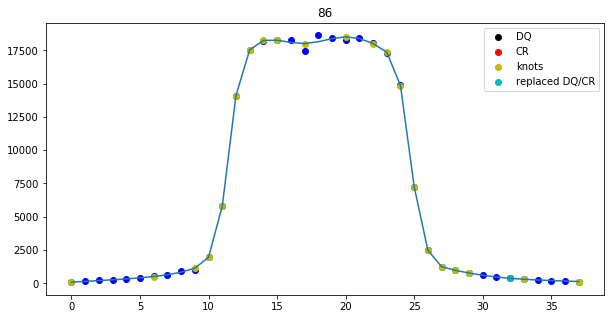

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 3
nr. of CRs 791
Spectrum located at pixel 117 in spatial direction
subexp 156.0398686684774 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 156 for exposure 2
2 13


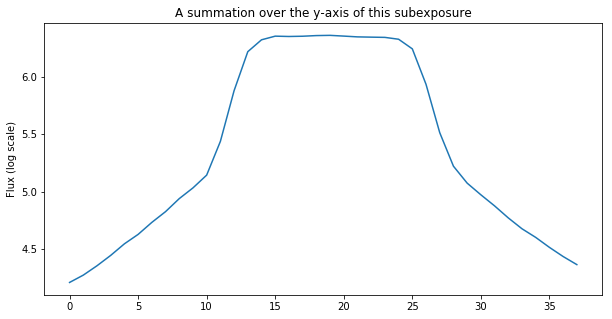

The difference between the two edges (for a 5-pixel bin for all subexps is): 4769.0626953125
This value may not be larger than  2051.889925572682  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


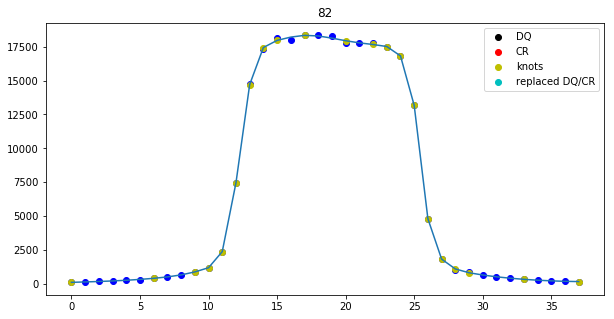

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


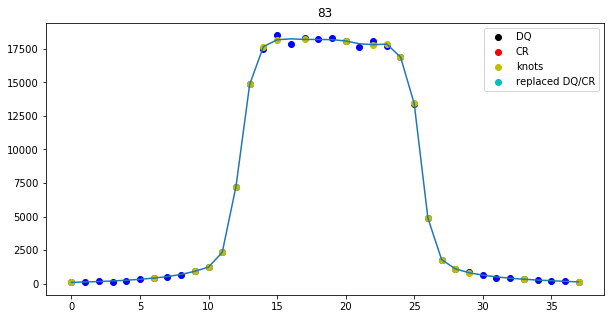

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


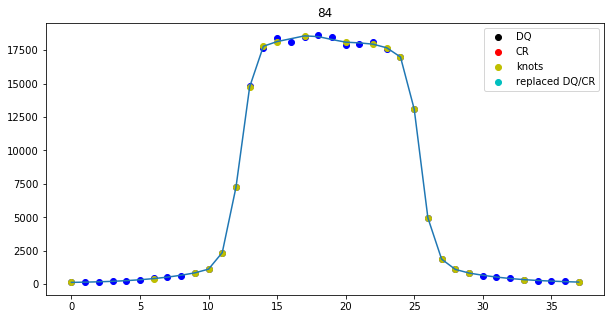

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


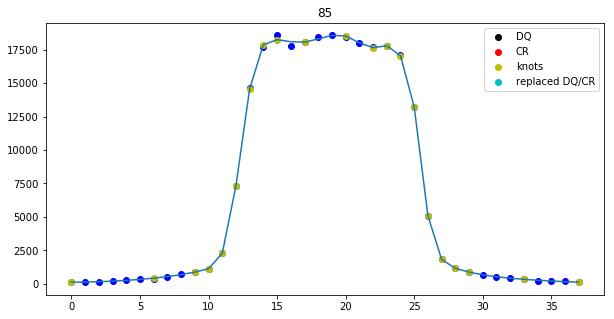

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


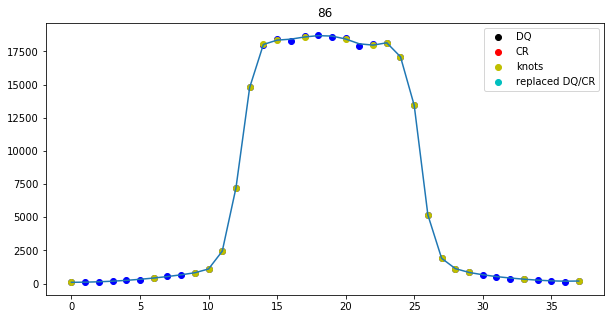

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 4
nr. of CRs 794
Spectrum located at pixel 117 in spatial direction
subexp 142.76464229881546 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 143 for exposure 3
3 13


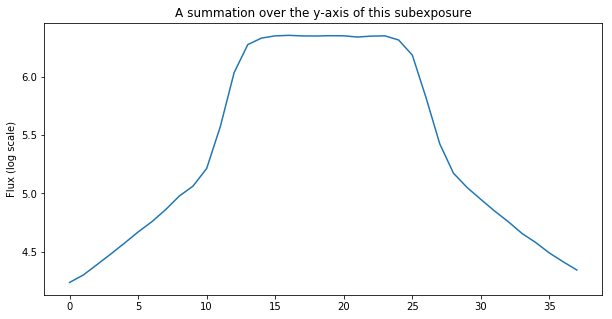

The difference between the two edges (for a 5-pixel bin for all subexps is): 3758.8518229166666
This value may not be larger than  2051.6151036033375  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


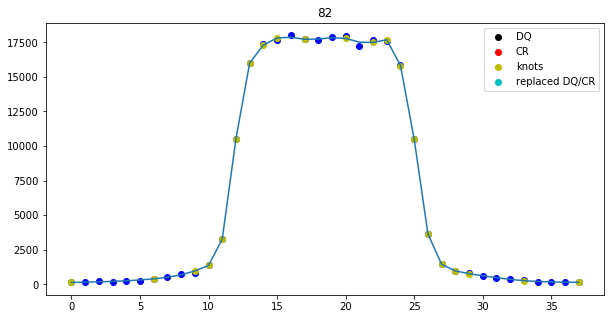

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


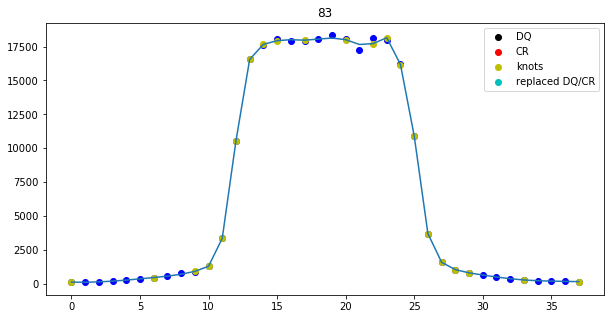

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


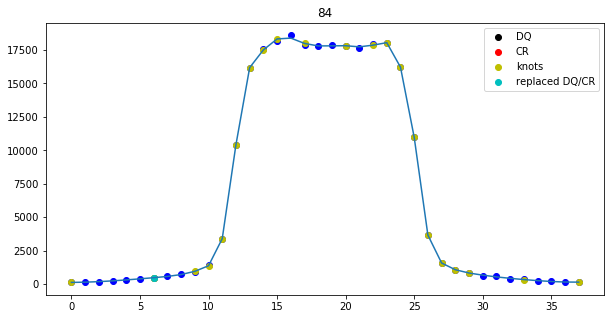

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


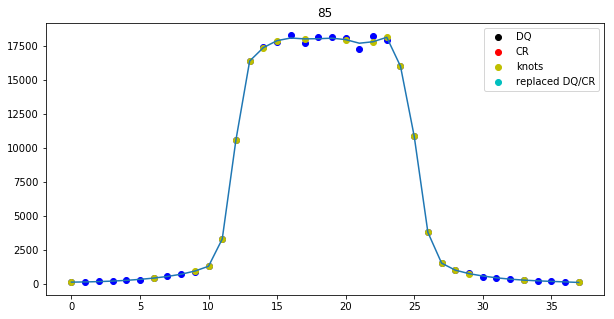

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


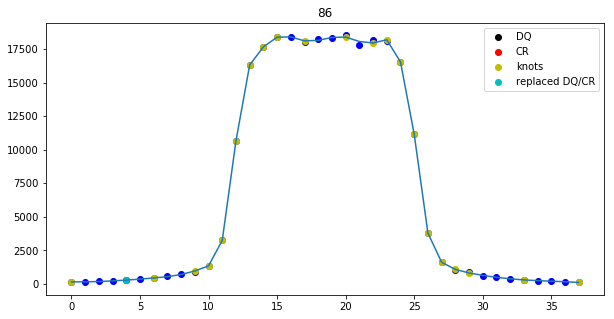

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 5
nr. of CRs 793
Spectrum located at pixel 117 in spatial direction
subexp 129.4951617179001 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 130 for exposure 4
4 13


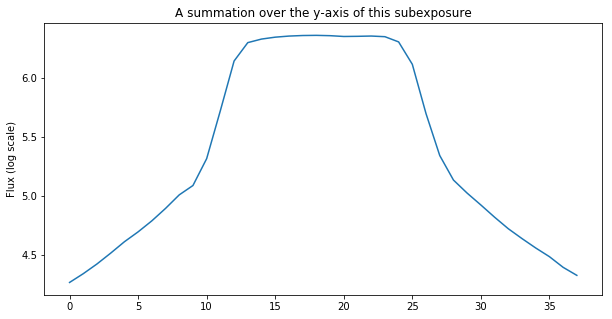

The difference between the two edges (for a 5-pixel bin for all subexps is): 2740.943359375
This value may not be larger than  2051.3313400488637  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


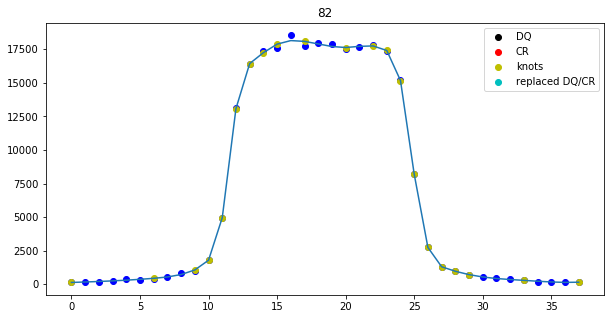

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


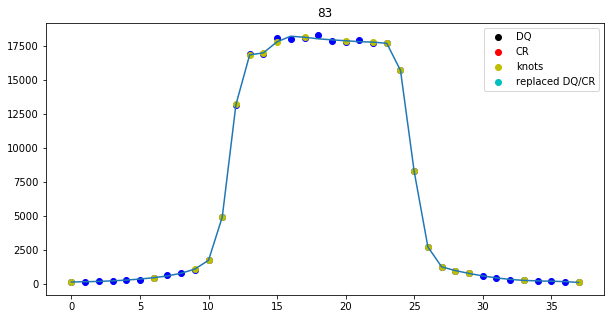

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


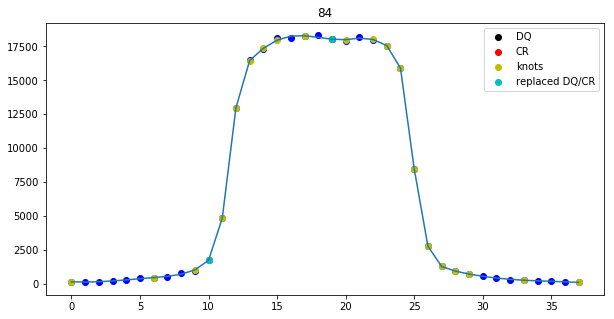

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


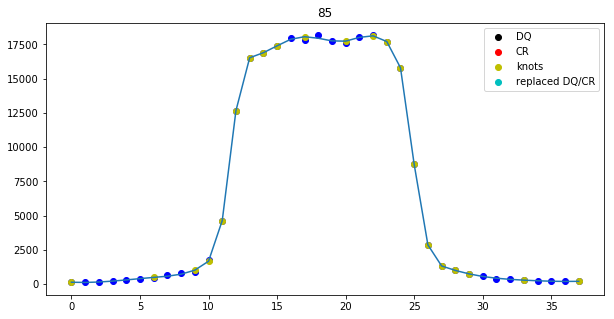

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


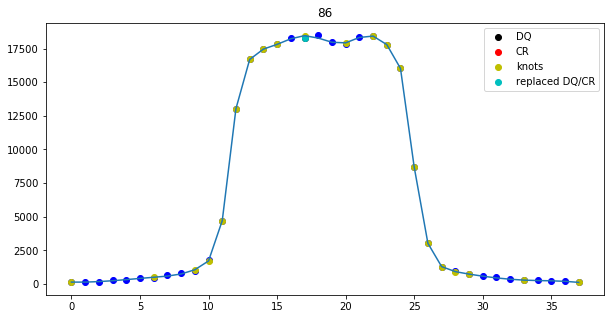

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 6
nr. of CRs 791
Spectrum located at pixel 117 in spatial direction
subexp 116.13871013211529 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 116 for exposure 5
5 13


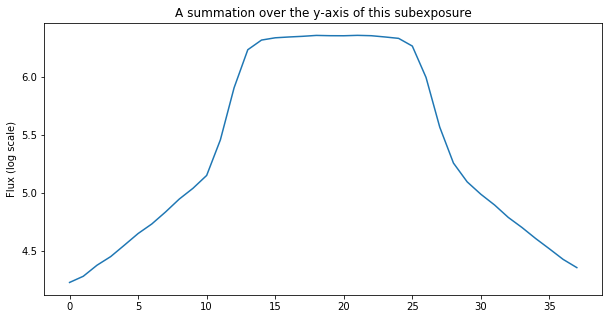

The difference between the two edges (for a 5-pixel bin for all subexps is): 4227.054947916667
This value may not be larger than  2053.8247896708876  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


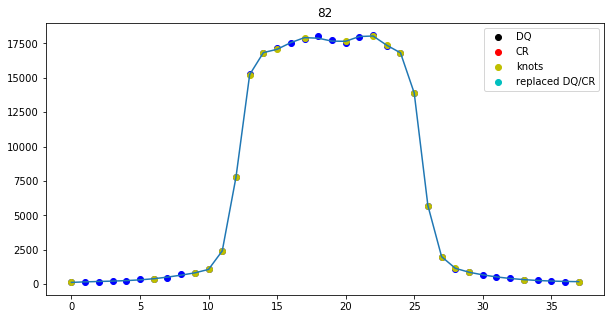

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


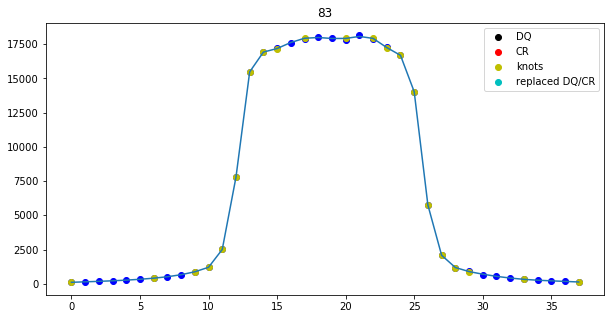

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


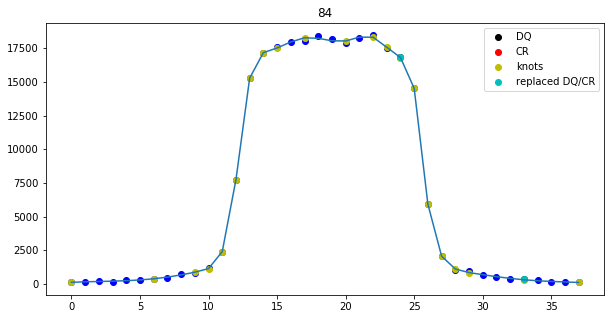

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


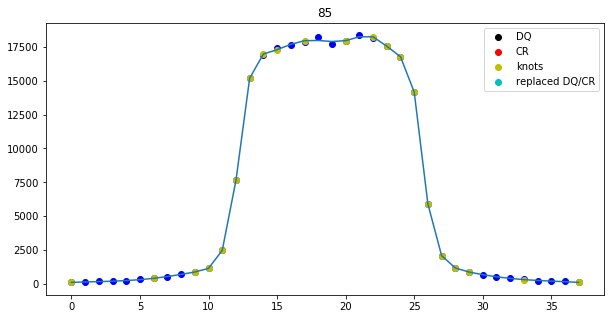

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


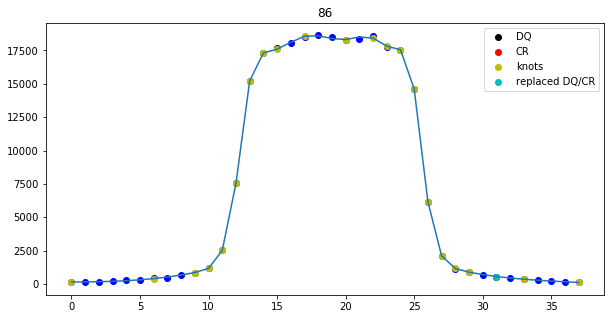

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 7
nr. of CRs 787
Spectrum located at pixel 117 in spatial direction
subexp 102.73126792094743 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 103 for exposure 6
6 13


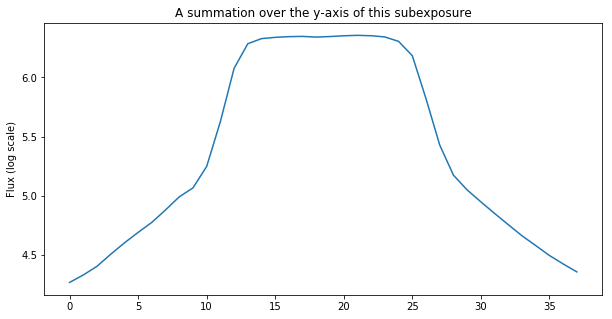

The difference between the two edges (for a 5-pixel bin for all subexps is): 3465.2591796875
This value may not be larger than  2051.240860227454  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


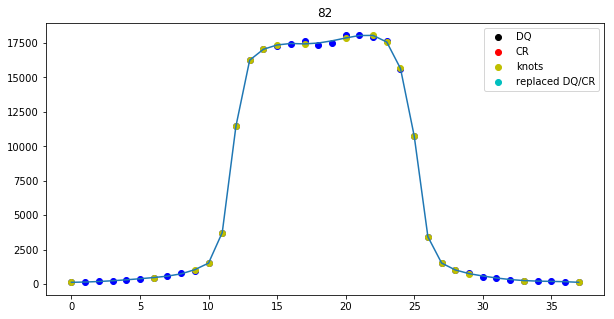

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


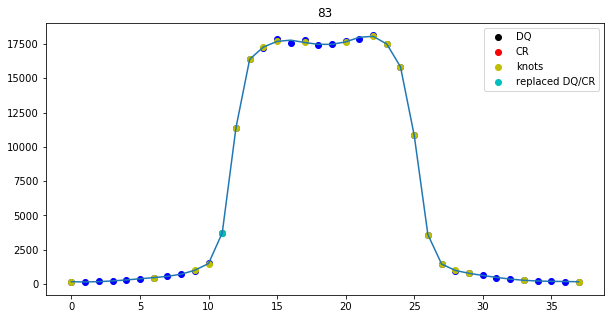

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


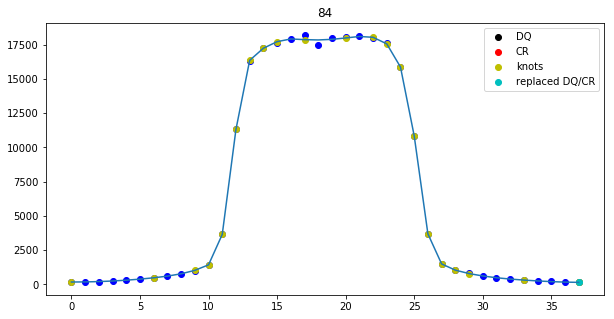

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


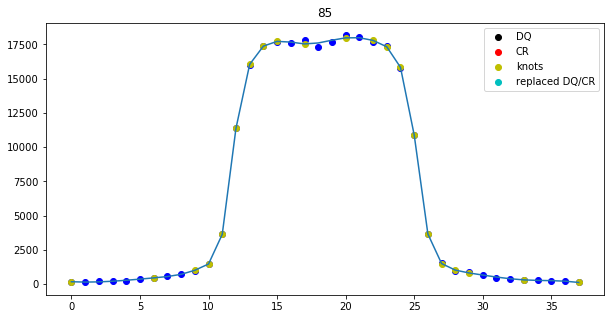

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


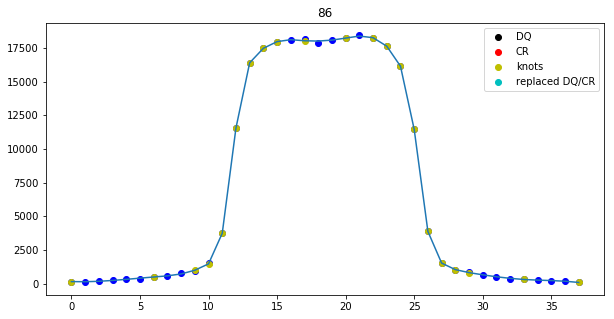

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 8
nr. of CRs 785
Spectrum located at pixel 117 in spatial direction
subexp 89.34254658122674 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 89 for exposure 7
7 13


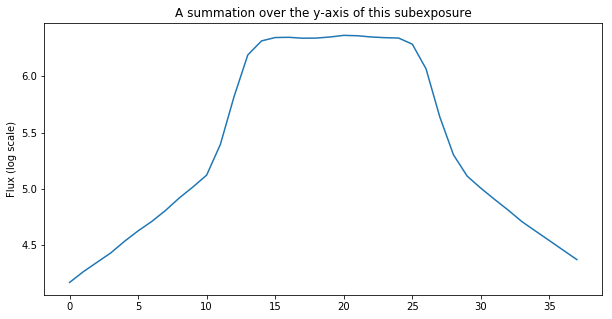

The difference between the two edges (for a 5-pixel bin for all subexps is): 5996.6740234375
This value may not be larger than  2052.083169204731  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


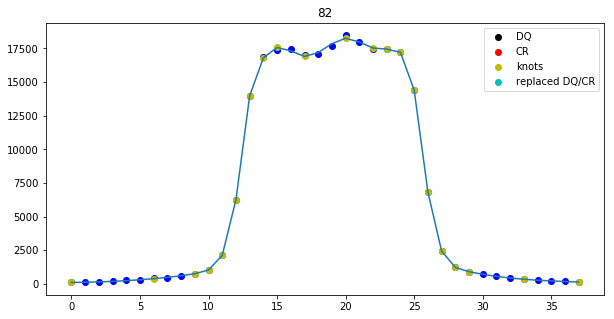

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


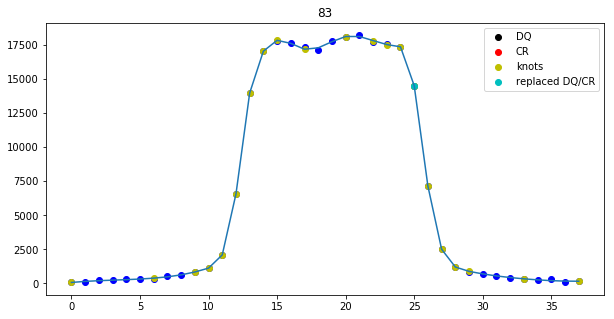

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


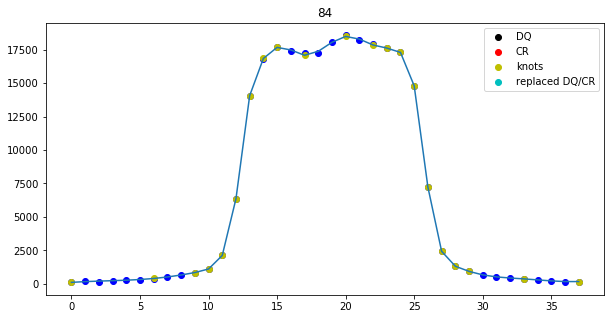

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


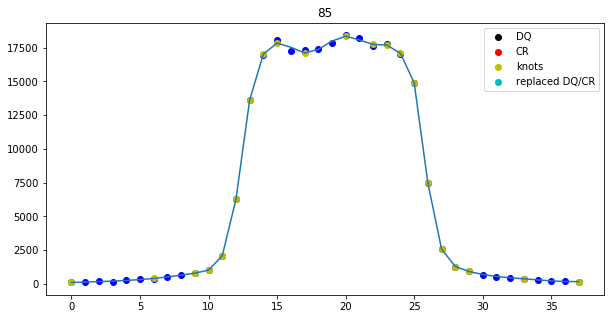

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


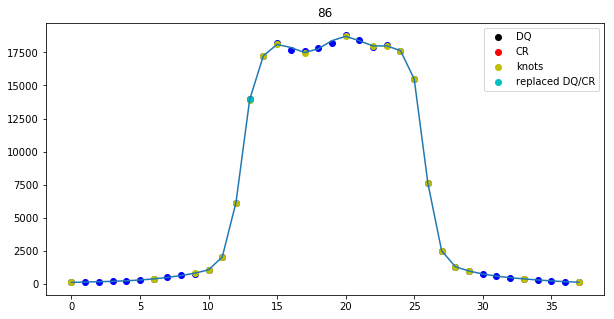

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 9
nr. of CRs 791
Spectrum located at pixel 117 in spatial direction
subexp 75.89746204025153 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 76 for exposure 8
8 13


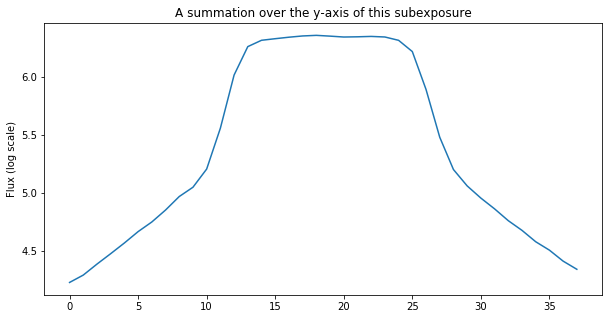

The difference between the two edges (for a 5-pixel bin for all subexps is): 3881.723828125
This value may not be larger than  2050.6885347772018  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


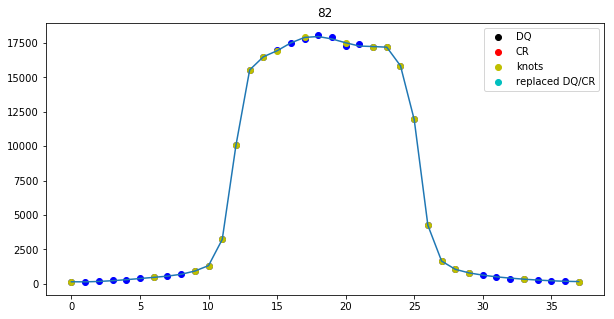

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


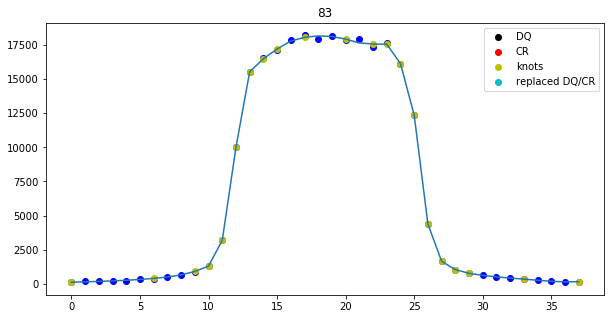

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


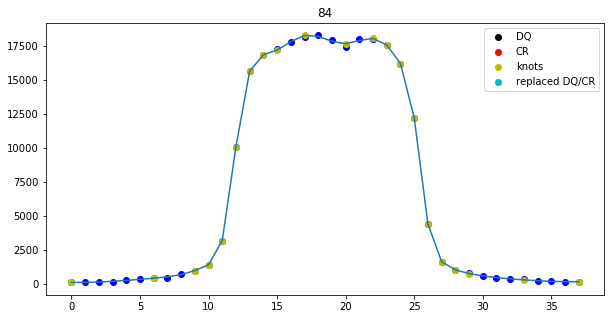

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


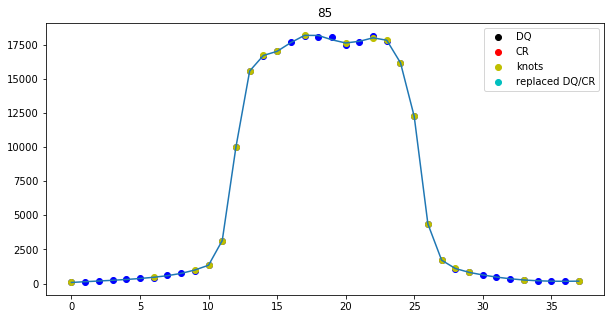

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


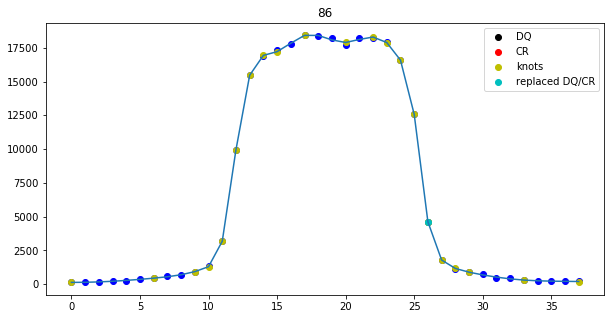

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 10
nr. of CRs 794
Spectrum located at pixel 117 in spatial direction
subexp 62.42732578042809 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 62 for exposure 9
9 13


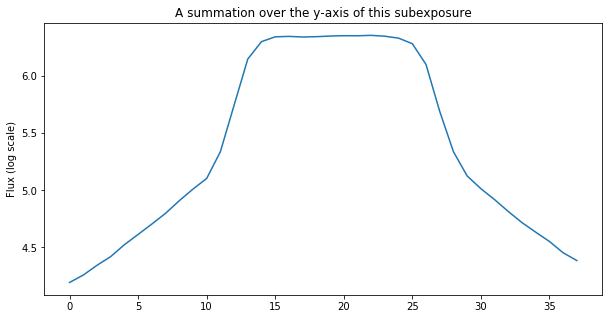

The difference between the two edges (for a 5-pixel bin for all subexps is): 5549.5095703125
This value may not be larger than  2048.858804310341  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


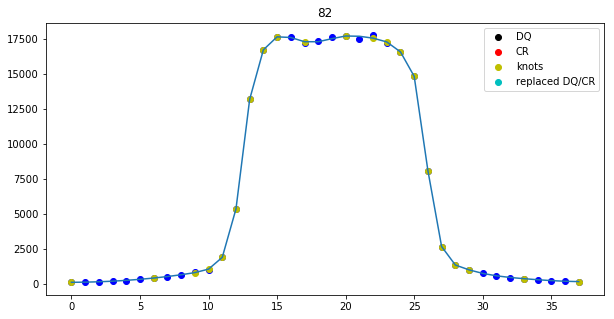

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


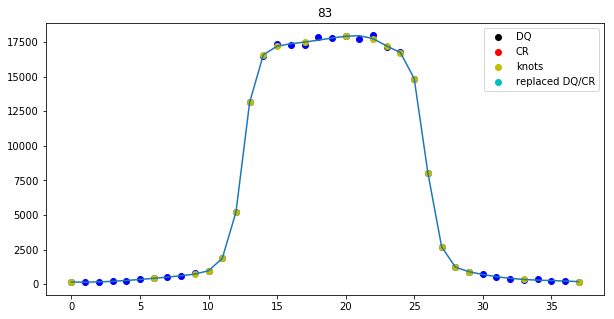

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


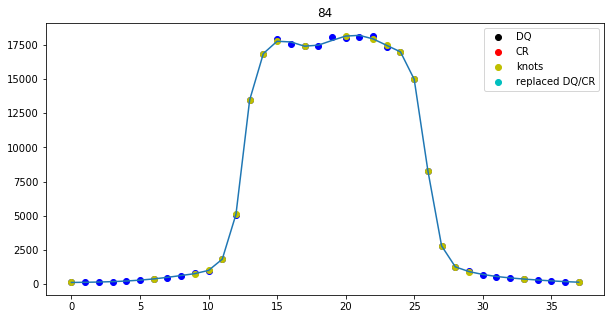

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


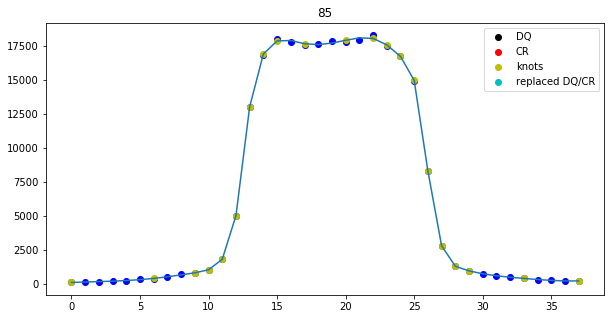

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


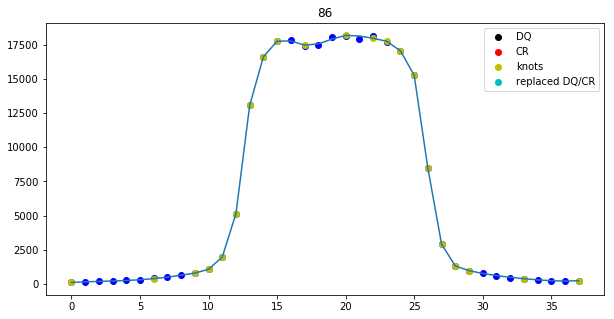

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 11
nr. of CRs 787
Spectrum located at pixel 117 in spatial direction
subexp 48.99873044829655 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 49 for exposure 10
10 13


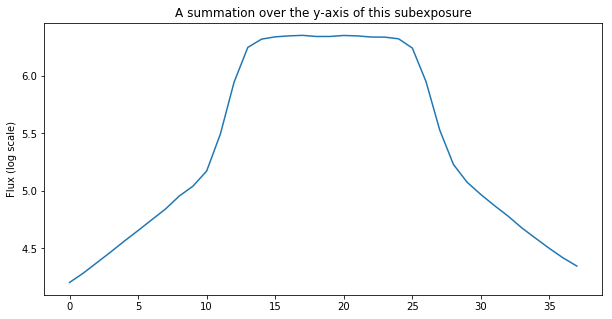

The difference between the two edges (for a 5-pixel bin for all subexps is): 4390.9658203125
This value may not be larger than  2047.246866729397  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


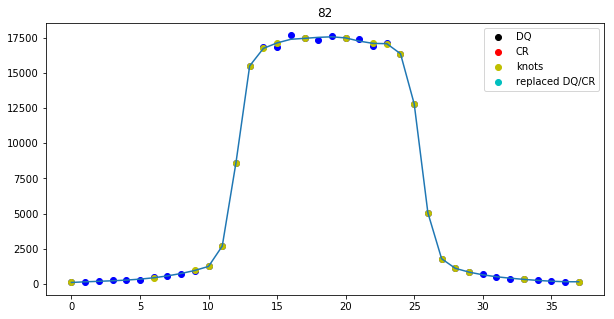

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


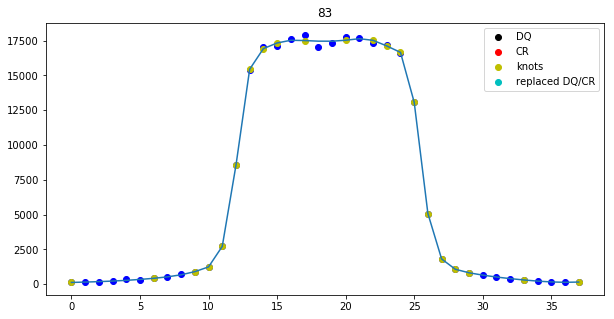

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


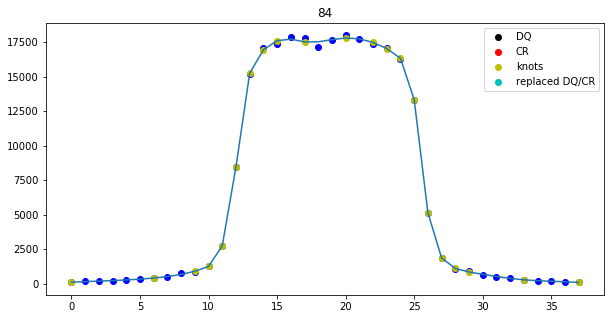

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


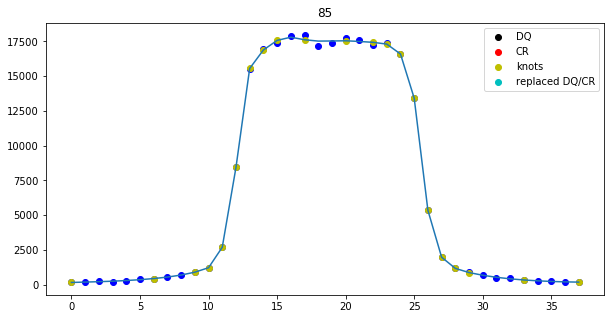

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


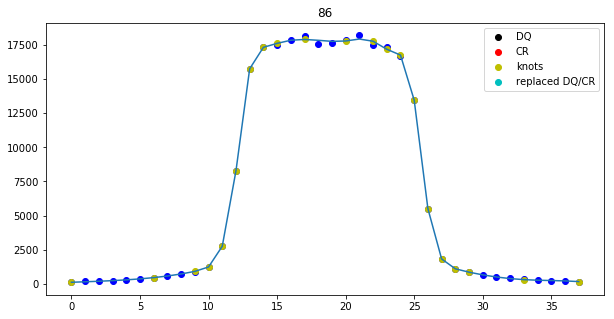

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 12
nr. of CRs 784
Spectrum located at pixel 117 in spatial direction
subexp 35.47518909416251 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 36 for exposure 11
11 13


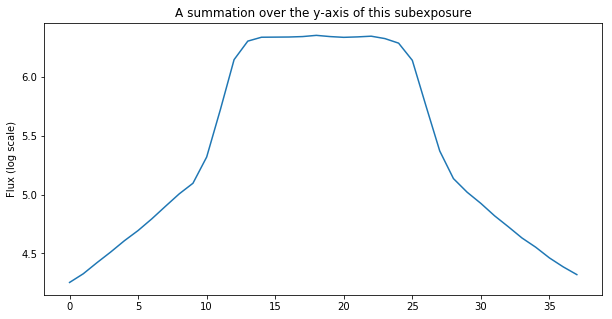

The difference between the two edges (for a 5-pixel bin for all subexps is): 2780.3834635416665
This value may not be larger than  2046.3689468584757  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


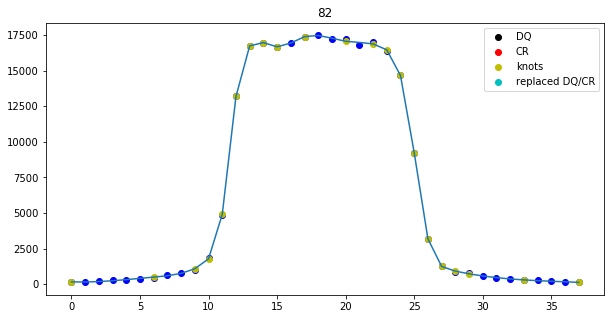

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


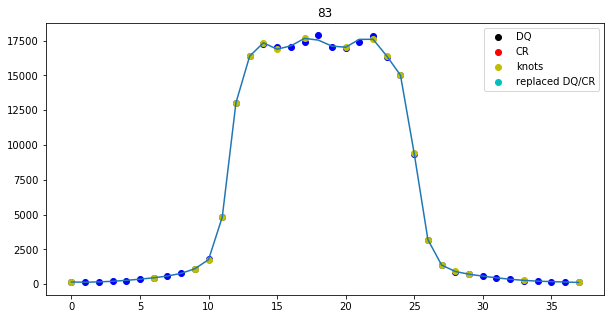

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


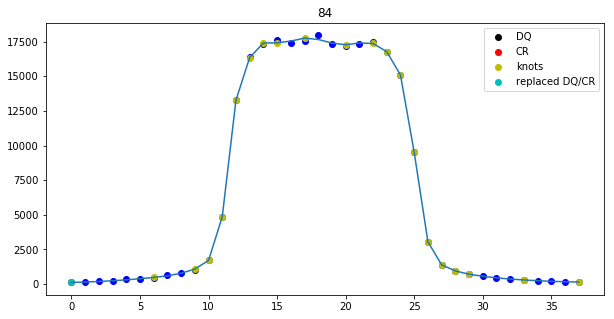

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


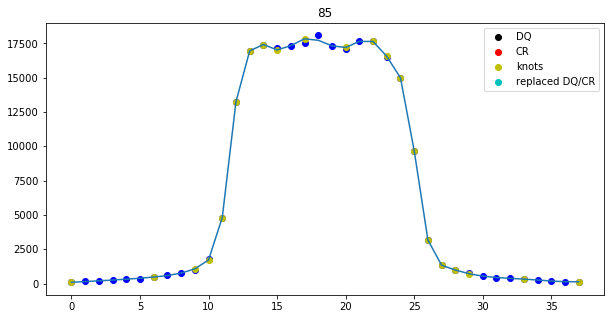

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


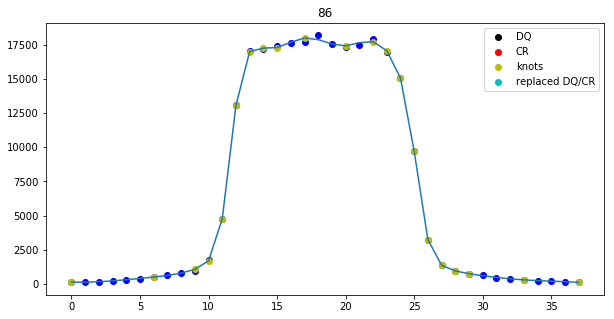

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 13
nr. of CRs 789
Spectrum located at pixel 117 in spatial direction
subexp 22.095917962951226 [183, 170, 156, 143, 130, 116, 103, 89, 76, 62, 49, 36, 22]
ypix is 22 for exposure 12
12 13


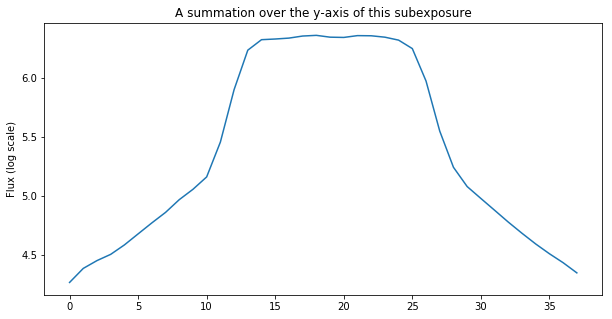

The difference between the two edges (for a 5-pixel bin for all subexps is): 3751.7830729166667
This value may not be larger than  2046.787271147965  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


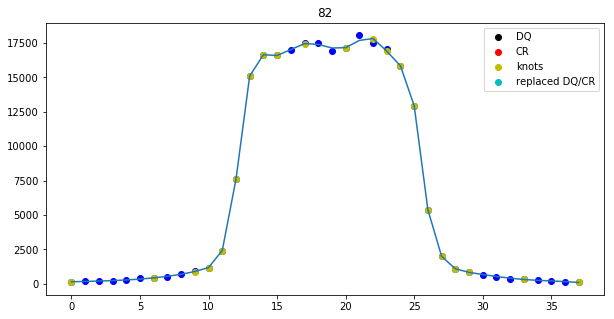

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


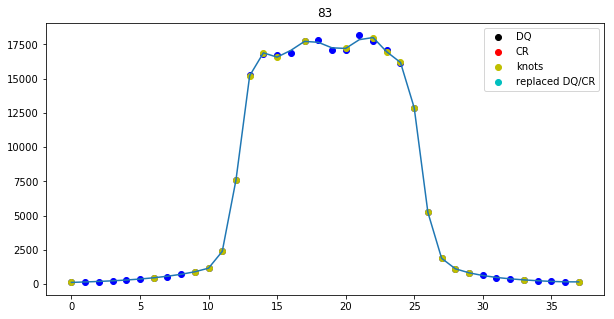

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


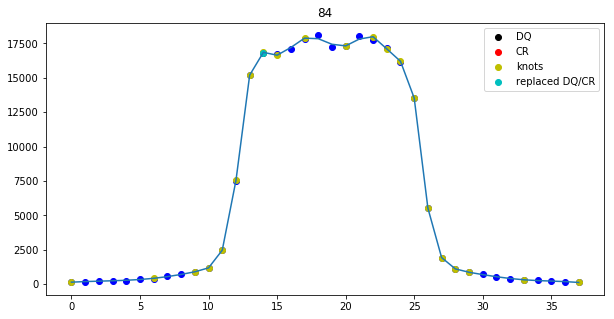

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


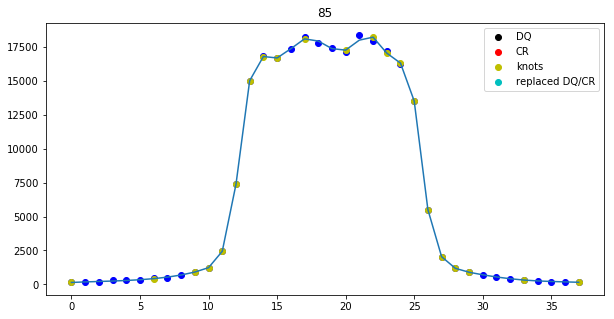

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


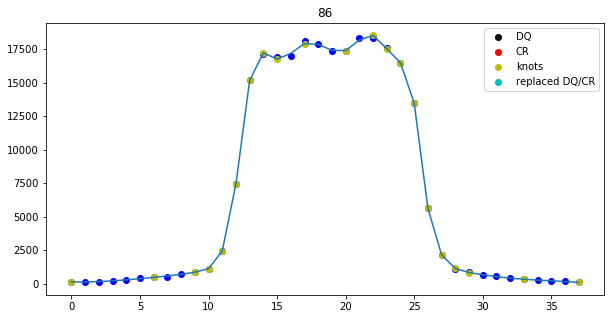

Optimal extraction fitting failed for columns: [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE


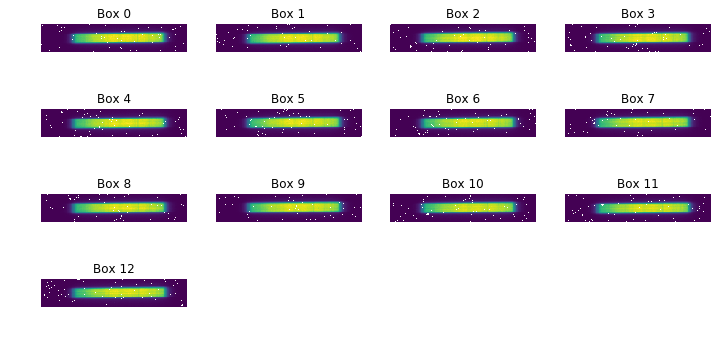

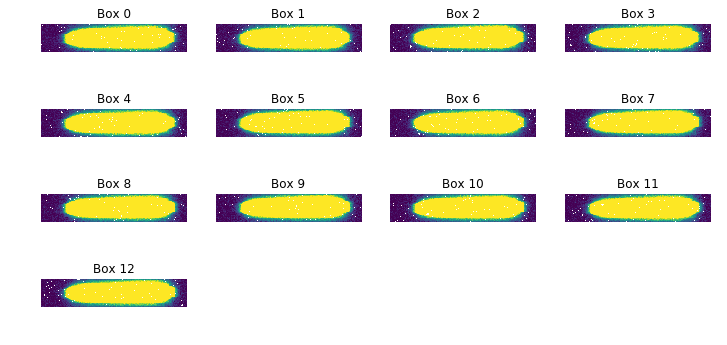

Shifted subexposure nr. 1 with -0.0239068358908 pixels and shrunk 0.0501627919331 percent.
Shifted subexposure nr. 2 with -0.12284344782 pixels and shrunk 0.108305058763 percent.
Shifted subexposure nr. 3 with -0.184778885975 pixels and shrunk 0.170489871099 percent.
Shifted subexposure nr. 4 with -0.418173457632 pixels and shrunk 0.264333174582 percent.
Shifted subexposure nr. 5 with -0.547142579312 pixels and shrunk 0.33092221359 percent.
Shifted subexposure nr. 6 with -0.667824886465 pixels and shrunk 0.409282237702 percent.
Shifted subexposure nr. 7 with -0.87037279393 pixels and shrunk 0.502293612024 percent.
Shifted subexposure nr. 8 with -0.890091275423 pixels and shrunk 0.546226469247 percent.
Shifted subexposure nr. 9 with -0.956701308639 pixels and shrunk 0.610661418094 percent.
Shifted subexposure nr. 10 with -1.08400387163 pixels and shrunk 0.685644430041 percent.
Shifted subexposure nr. 11 with -1.1021925637 pixels and shrunk 0.741467388355 percent.
Shifted subexposure nr.

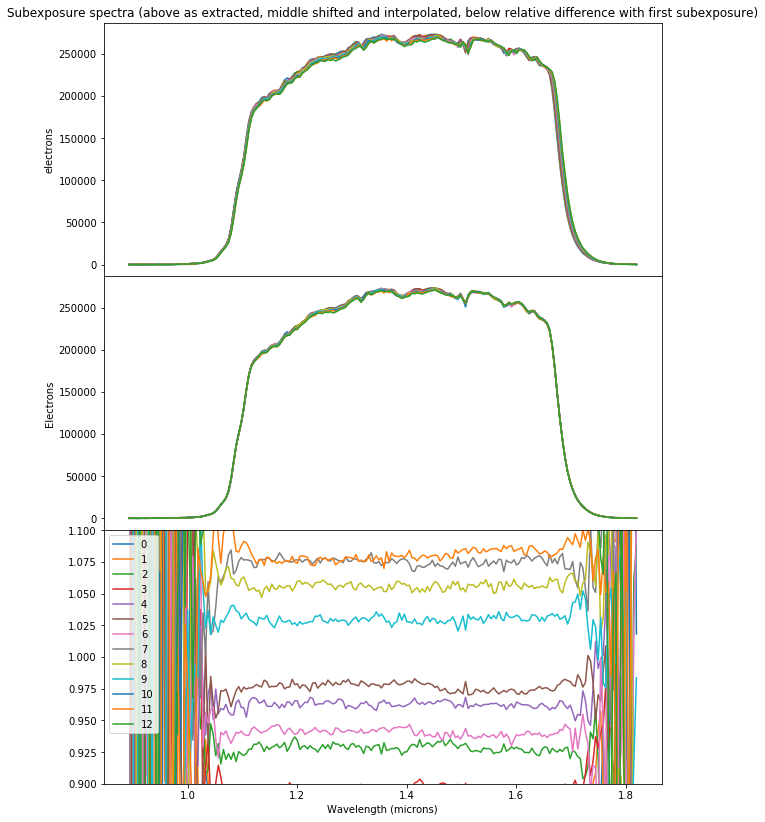

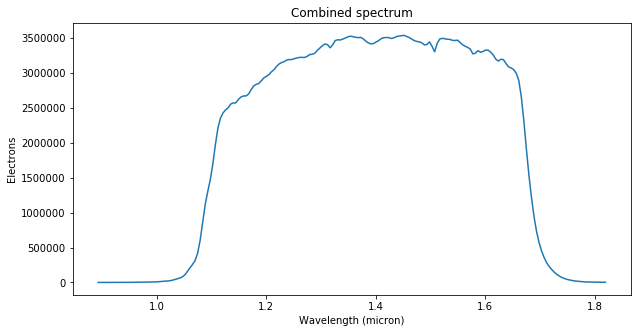

Saving spectrum to /Users/bob/Documents/PhD/WASP-80/output/idn201bgq_spec.txt
reduced 2458651.6539903856
Saving subexposure spectra to /Users/bob/Documents/PhD/WASP-80/output/idn201bgq_subs_spec.txt
Extraction took 13.66s
########################################
###########Finished Extraction##########
########################################
########################################
############Started Reduction##########
########################################
Data reduction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn202j6q_ima.fits
For configuration, see pipeline conf file: /Users/bob/Documents/PhD/WASP-80/transmission_reduction.conf
Forward scan
Catalogue used: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn202j5q_flt_1.cat
Direct Image name: idn202j5q
catalogue /Users/bob/Documents/PhD/WASP-80/HSTdata/idn202j5q_flt_1.cat
Catalogue file: idn202j5q_ima.fits
########################
Direct image location of (160.896348504,116.392125627)
FWHM of this subex

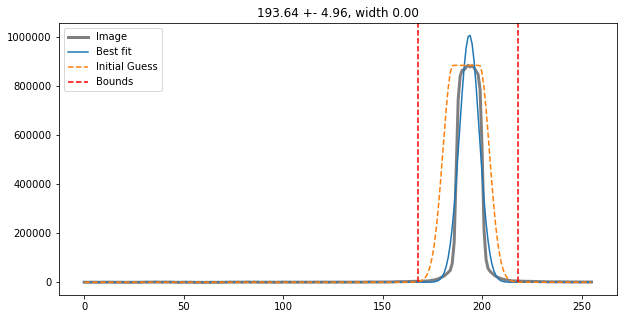

using a PHOENIX stellar model
amplitude and displacement on first order: -15.890220717426217 -123.50633208172542


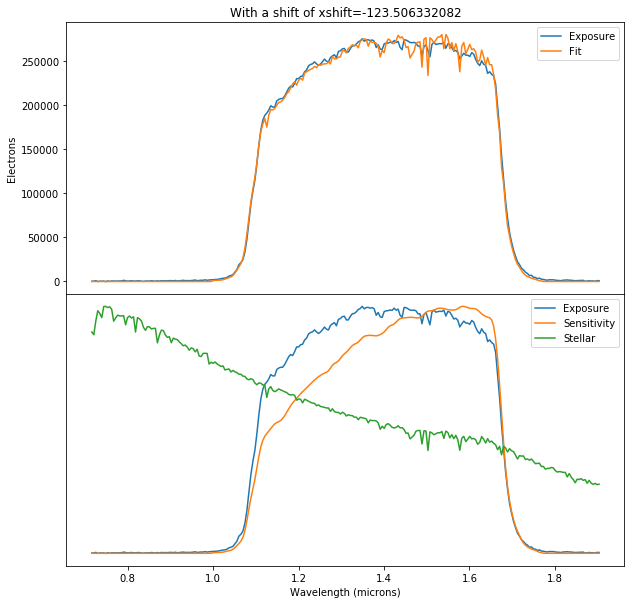

Applied an xshift of -123.506332082 pix from a comparison to a stellar spectrum
Initial xpix is 37 and shift_in_x: -123.506332082
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 75.05 pix
FWHM of this subexposure is  13.290178718451472


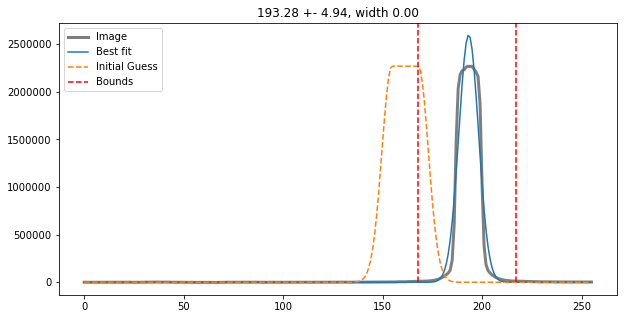

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.30211737263491


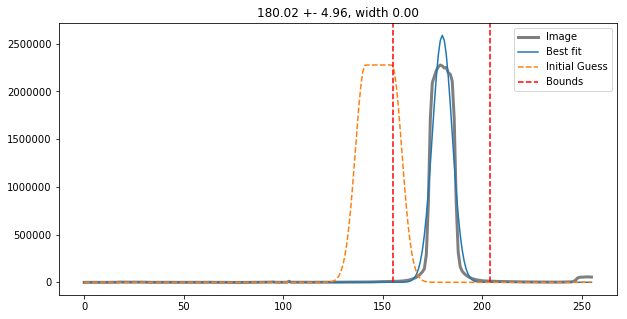

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.36935652792144


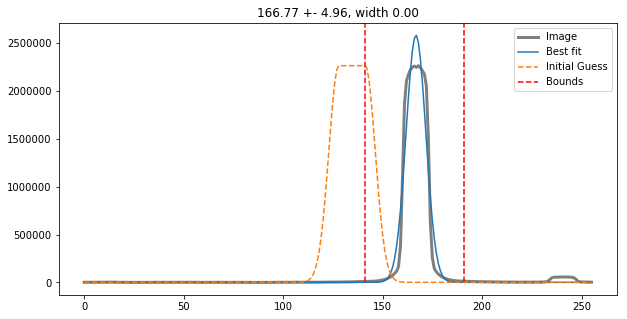

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.378558713375952


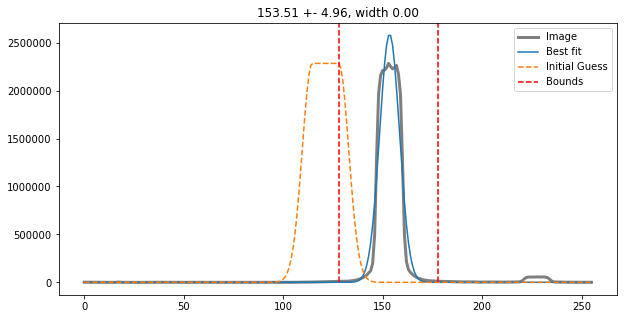

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.355565746772697


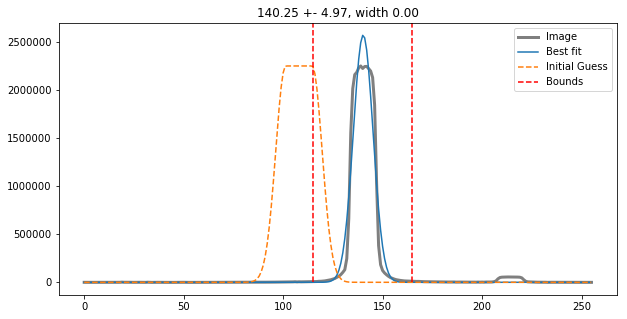

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.361206898000546


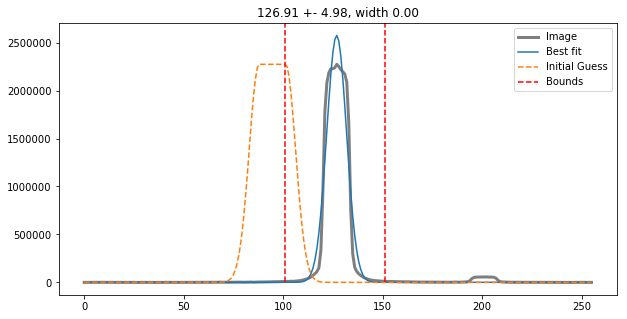

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.53474694804649


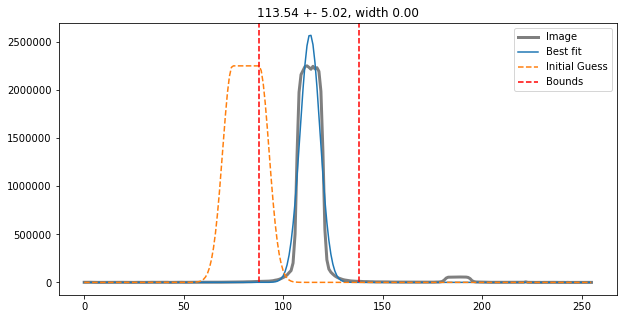

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.475015073806532


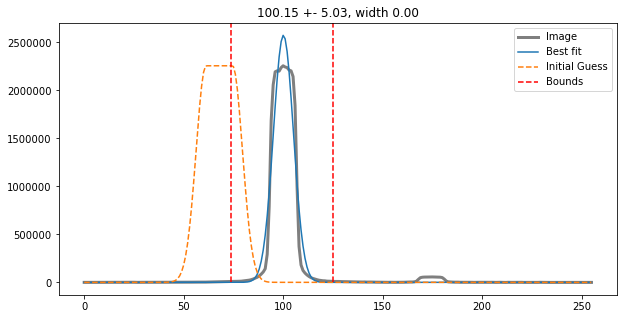

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.54752946764711


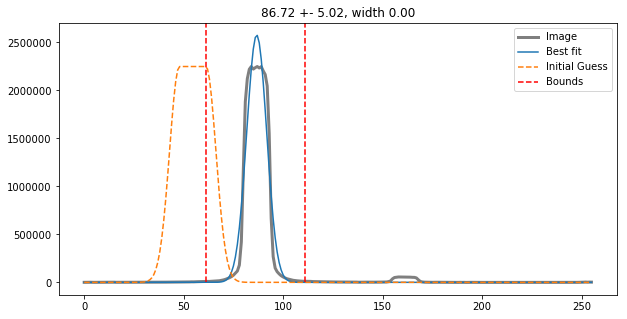

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.477095458093757


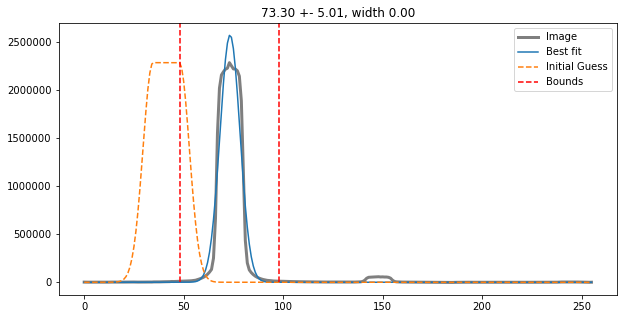

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.490375297405436


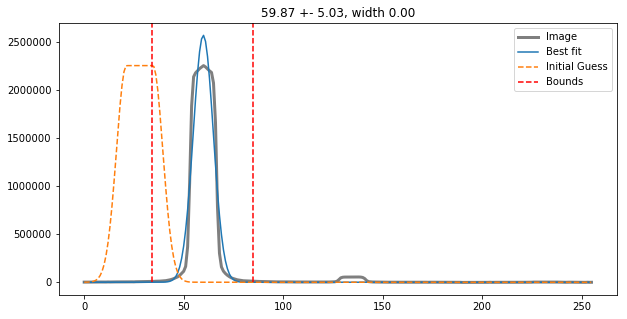

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.548179875190662


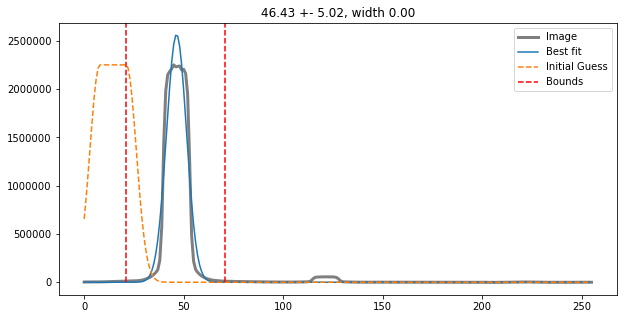

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.540700252007781


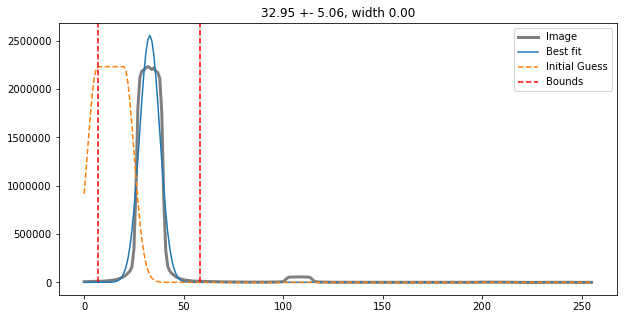

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
The final xpix is 37
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 75.05 pix
FWHM of this subexposure is  13.290178718451472


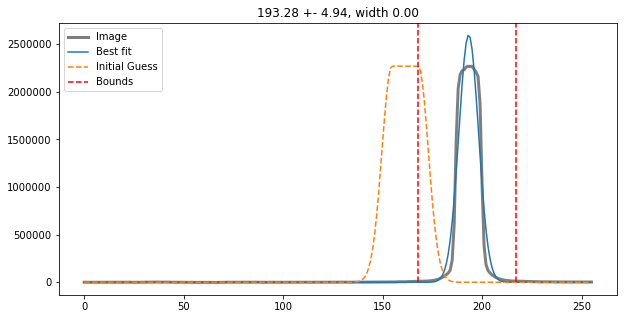

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.30211737263491


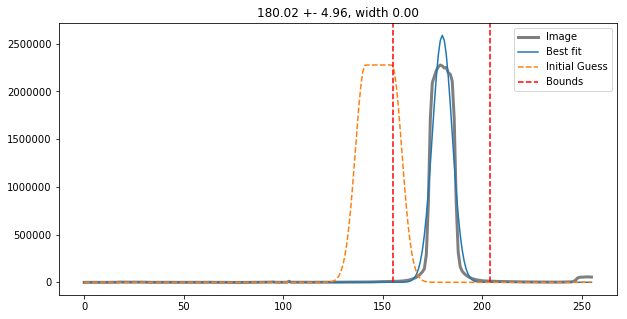

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.36935652792144


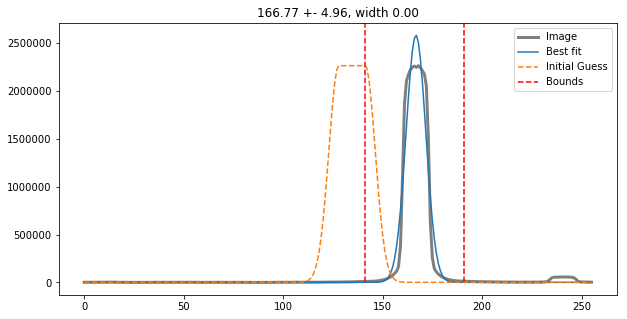

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.378558713375952


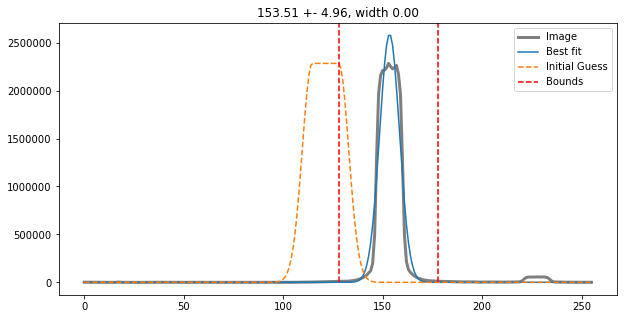

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.355565746772697


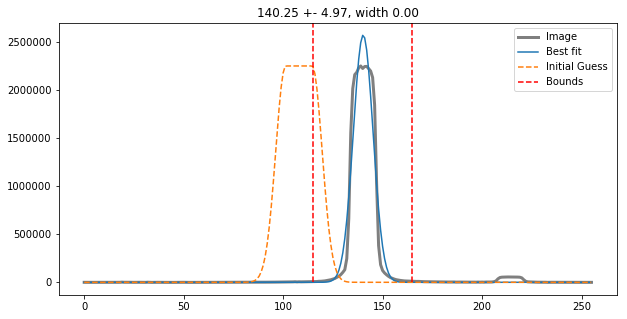

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.361206898000546


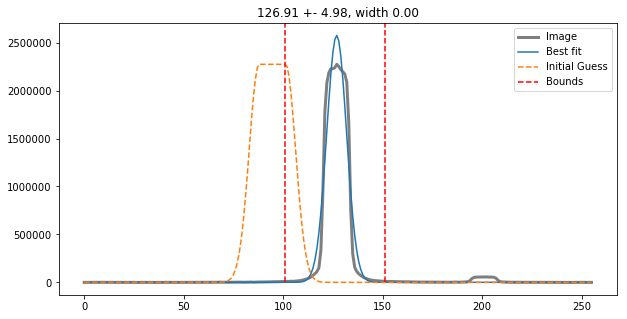

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.53474694804649


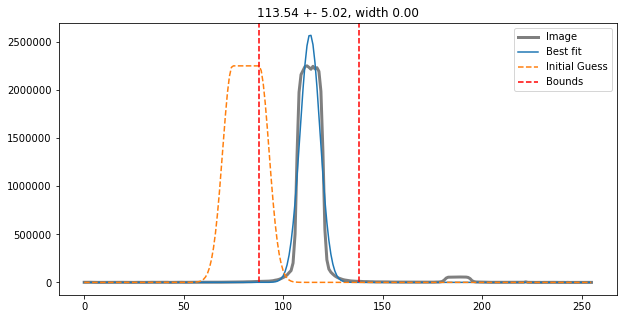

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.475015073806532


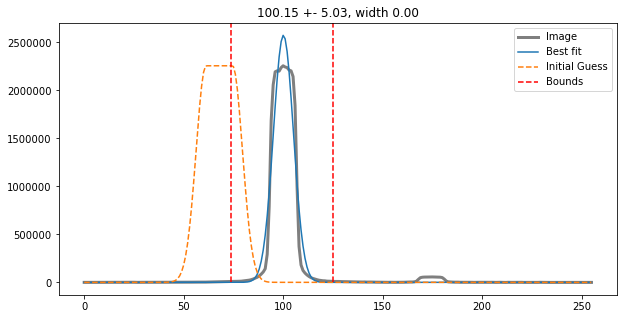

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.54752946764711


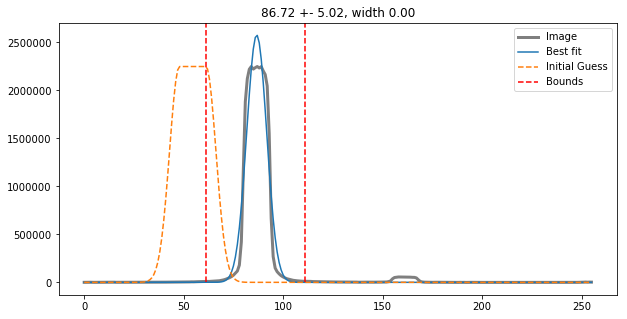

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.477095458093757


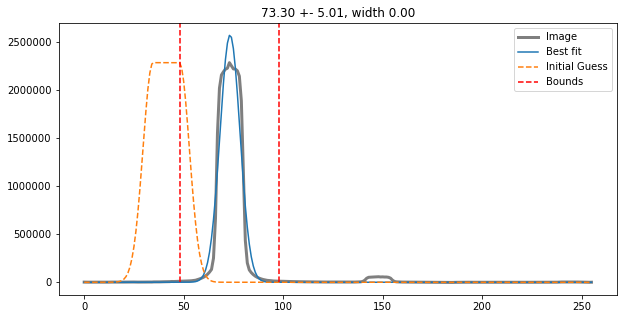

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.490375297405436


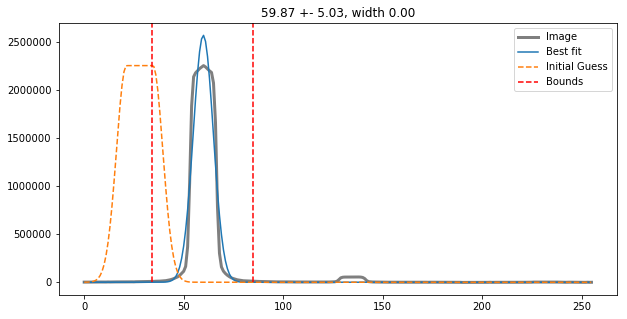

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.548179875190662


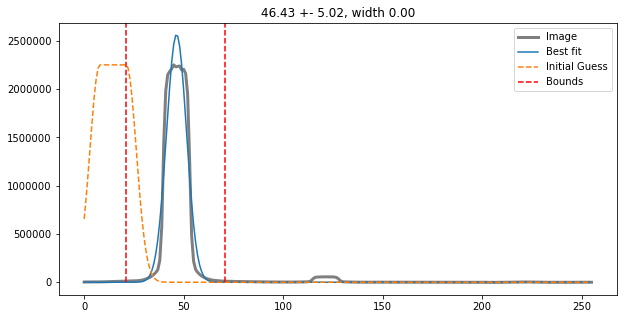

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.540700252007781


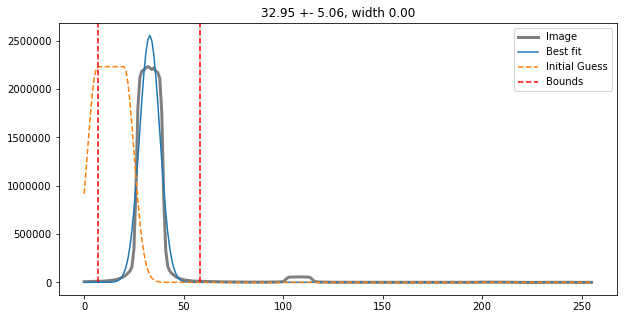

SHIFTINX -123.50633208172542
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
nr_CRs, Lows 10 1
nr_CRs, Lows 12 0
nr_CRs, Lows 3 0
nr_CRs, Lows 16 1
nr_CRs, Lows 17 0
nr_CRs, Lows 7 0
nr_CRs, Lows 14 0
nr_CRs, Lows 8 0
nr_CRs, Lows 6 0
nr_CRs, Lows 13 0
nr_CRs, Lows 9 0
nr_CRs, Lows 5 0
nr_CRs, Lows 8 0
95.782104
95.782104 95.782104
Saving reduced file to /Users/bob/Documents/PhD/WASP-80/output/
Saving reduced exposure to /Users/bob/Documents/PhD/WASP-80/output/idn202j6q_red.fits...
Reduction took 11.23s
########################################
###########Finished Reduction###########
########################################
########################################
############Started Extraction##########
########################################
Spectral extraction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn202j6q_ima.fits
For configuration, see conf file: /Users/bob/Documents/PhD/WASP-80/transmission_extraction.conf
Forward scan
Extracting from

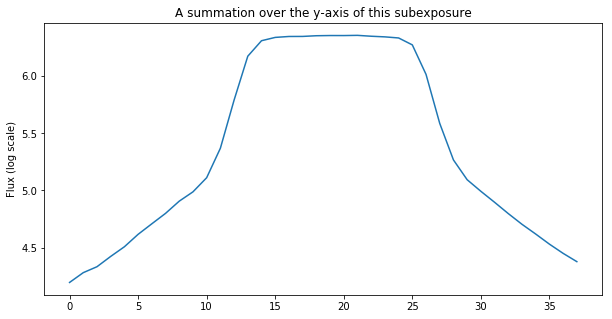

The difference between the two edges (for a 5-pixel bin for all subexps is): 5406.982682291667
This value may not be larger than  2045.280029726981  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Using flux for variance estimate
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


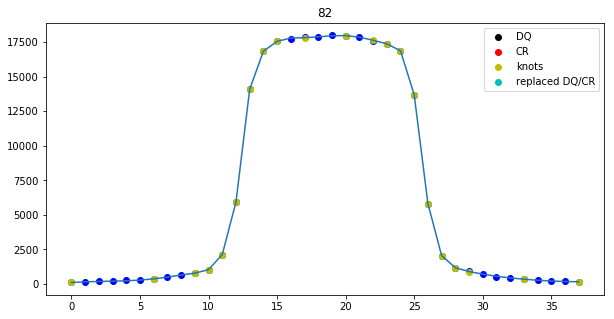

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


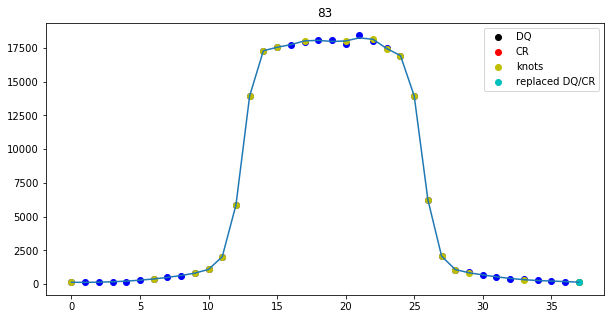

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


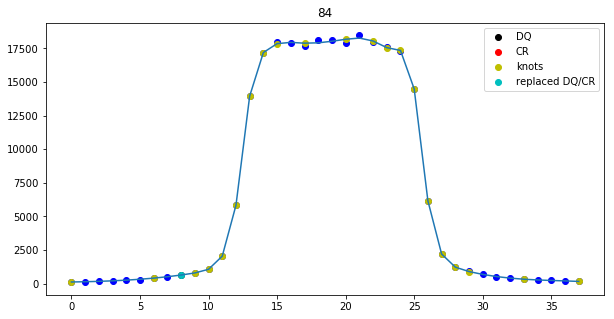

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


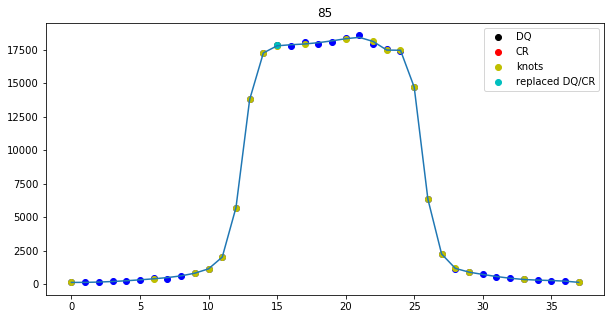

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


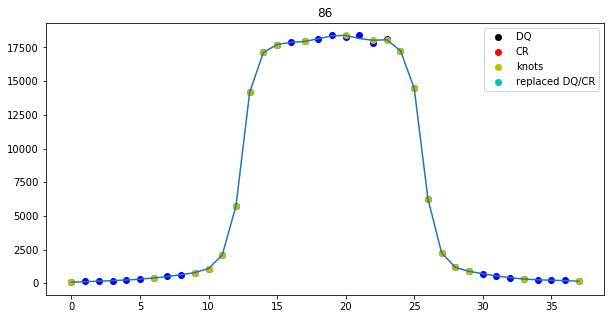

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 2
nr. of CRs 793
Spectrum located at pixel 137 in spatial direction
subexp 180.0194288340379 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 180 for exposure 1
1 13


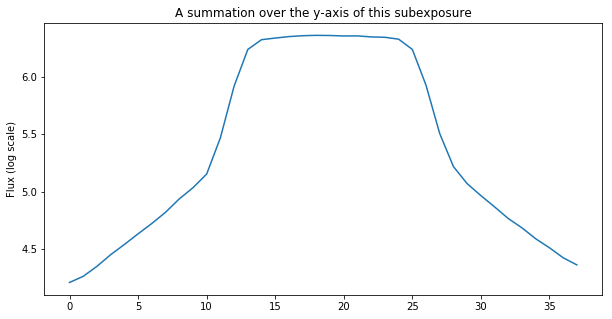

The difference between the two edges (for a 5-pixel bin for all subexps is): 4507.797395833333
This value may not be larger than  2044.420243818118  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


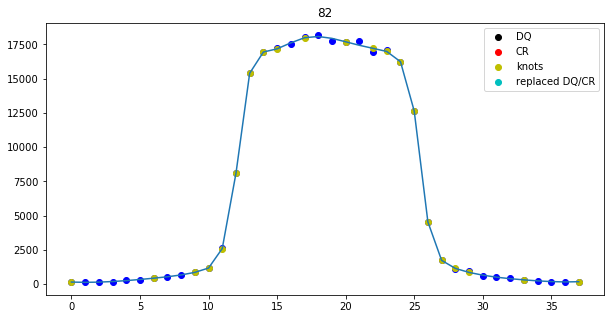

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


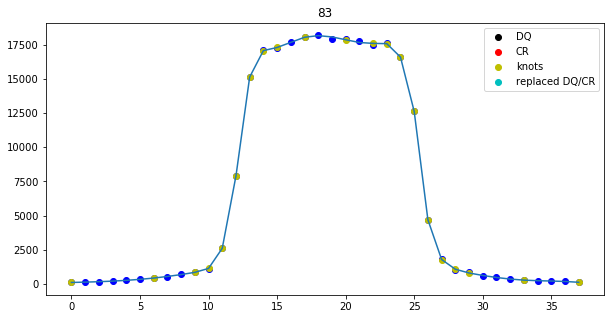

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


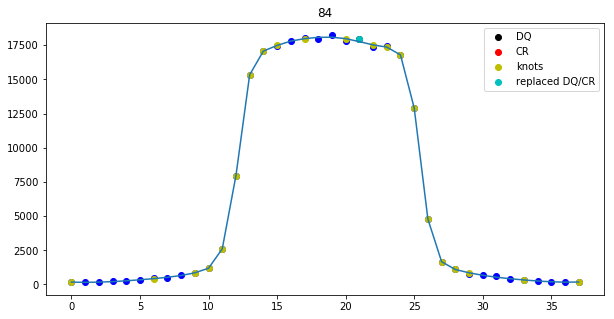

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


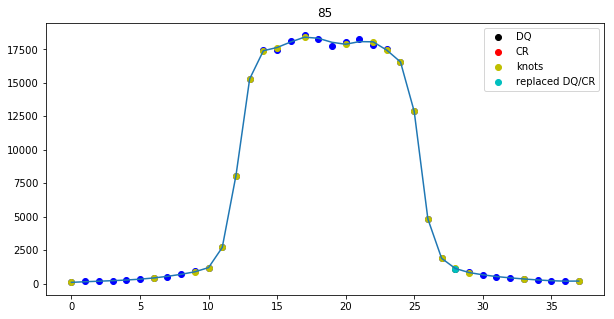

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


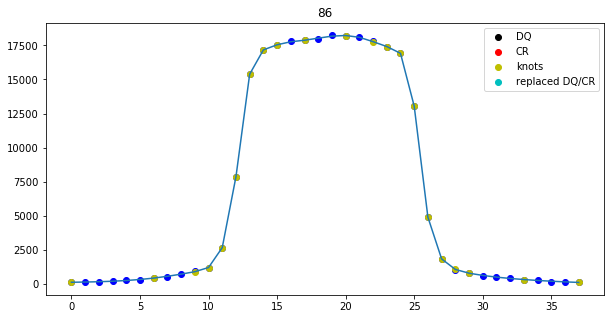

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 3
nr. of CRs 786
Spectrum located at pixel 137 in spatial direction
subexp 166.76822916532703 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 167 for exposure 2
2 13


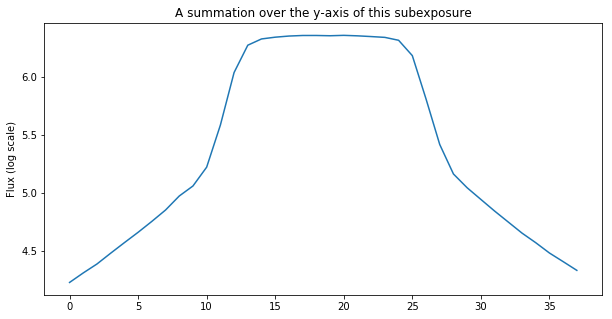

The difference between the two edges (for a 5-pixel bin for all subexps is): 3742.749088541667
This value may not be larger than  2044.8429442543177  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


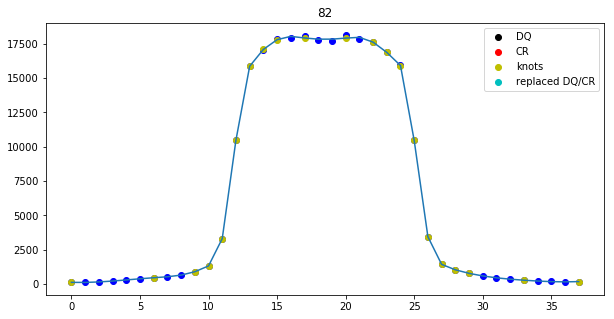

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


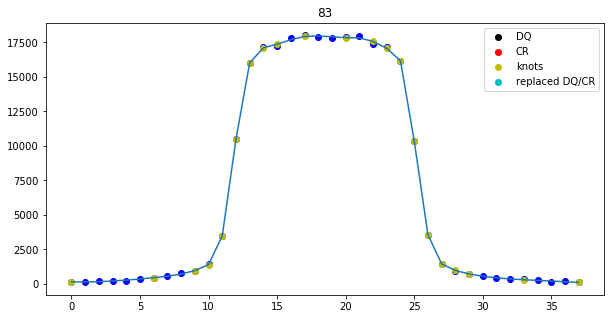

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


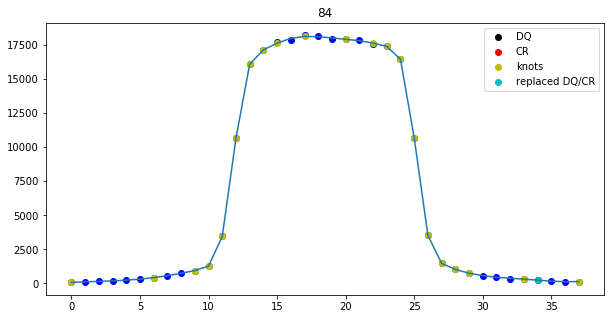

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


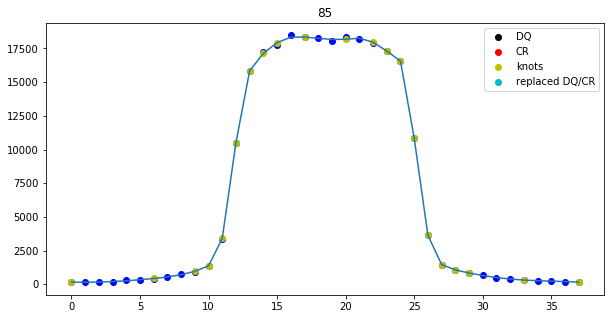

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


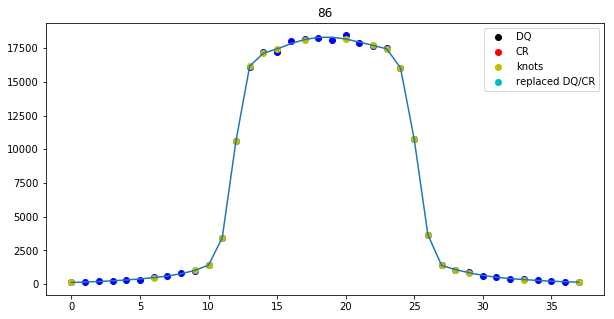

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 4
nr. of CRs 790
Spectrum located at pixel 137 in spatial direction
subexp 153.51173957159784 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 153 for exposure 3
3 13


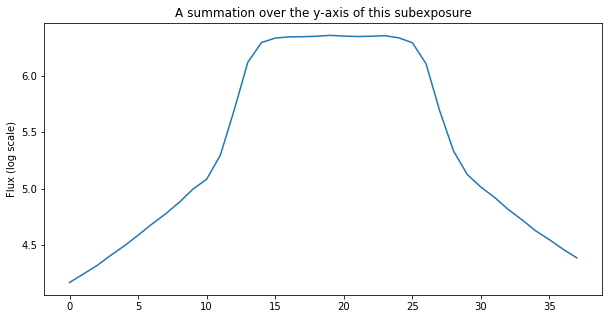

The difference between the two edges (for a 5-pixel bin for all subexps is): 6184.515559895834
This value may not be larger than  2045.7981001718294  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


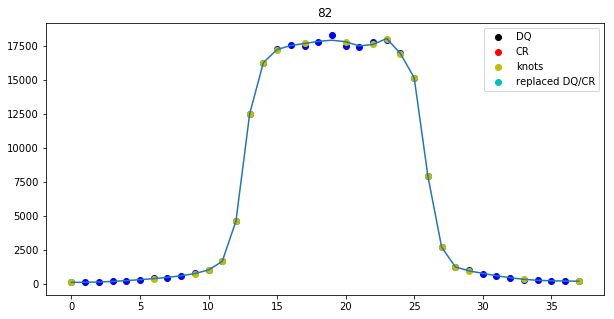

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


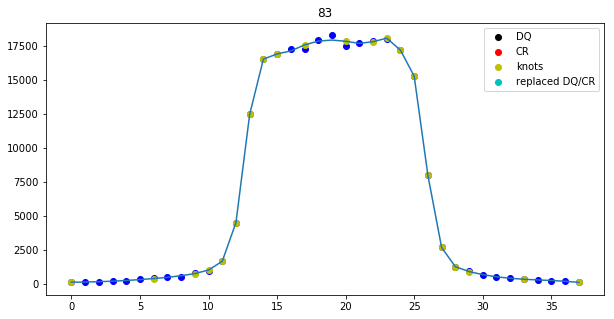

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


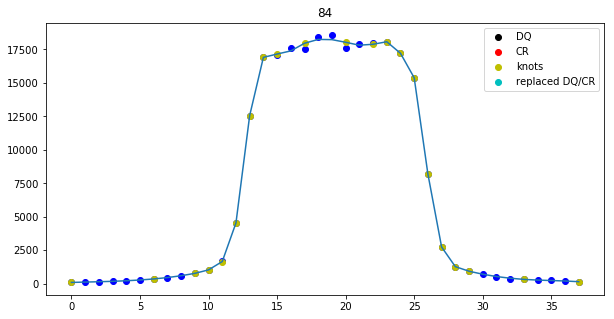

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


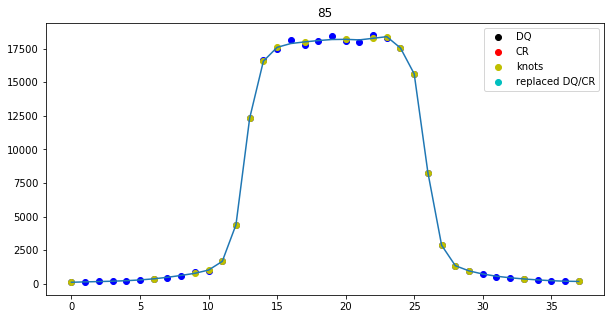

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


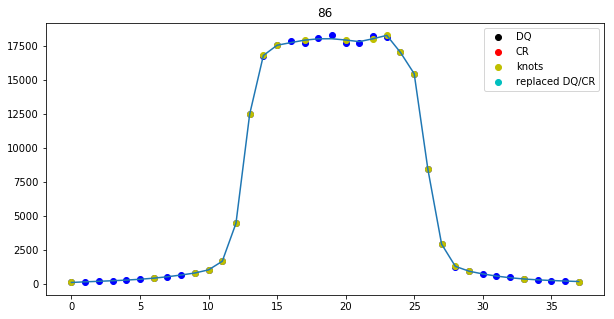

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 5
nr. of CRs 804
Spectrum located at pixel 137 in spatial direction
subexp 140.24827562012237 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 140 for exposure 4
4 13


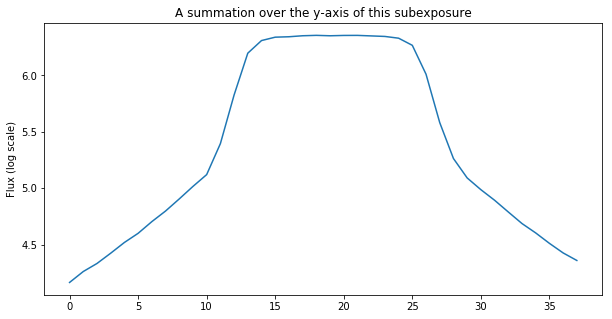

The difference between the two edges (for a 5-pixel bin for all subexps is): 5243.604166666667
This value may not be larger than  2044.0436394558703  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


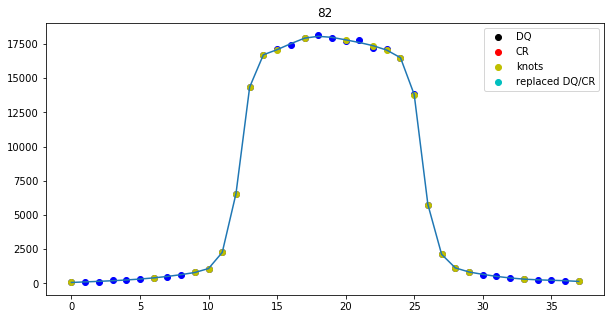

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


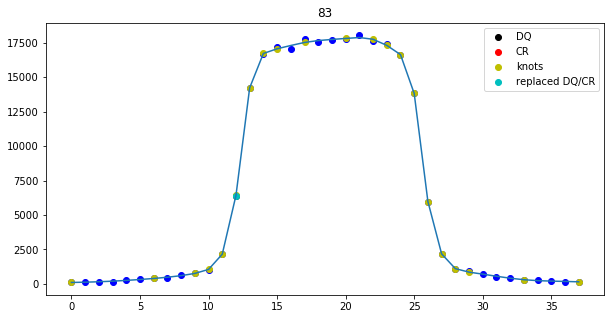

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


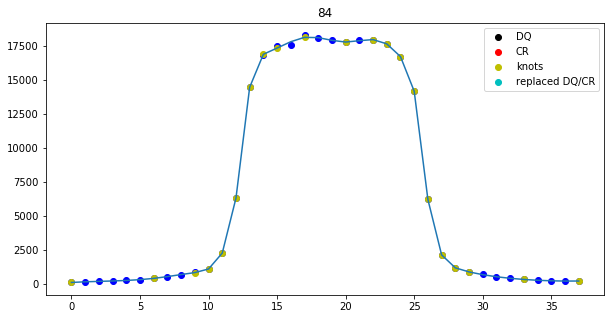

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


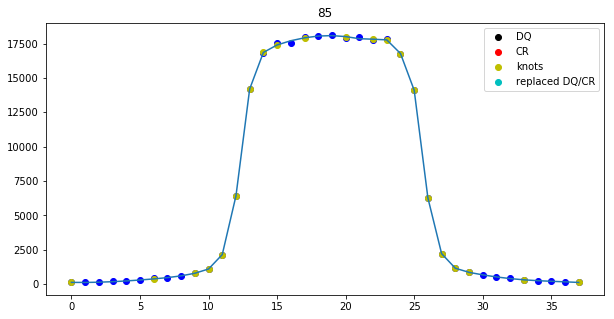

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


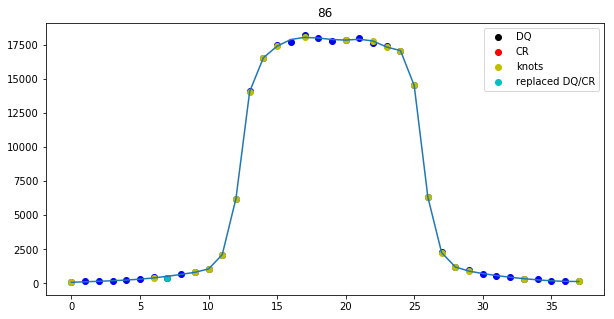

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 6
nr. of CRs 795
Spectrum located at pixel 137 in spatial direction
subexp 126.90810966568723 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 127 for exposure 5
5 13


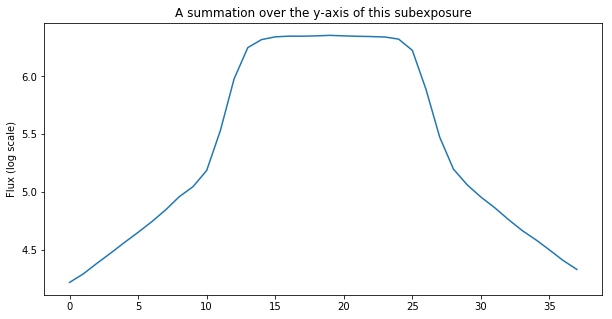

The difference between the two edges (for a 5-pixel bin for all subexps is): 3914.5759114583334
This value may not be larger than  2045.5607218233993  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


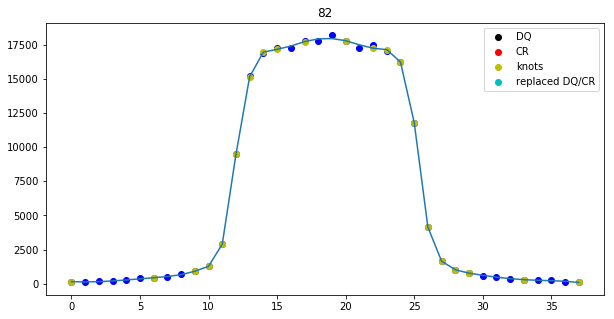

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


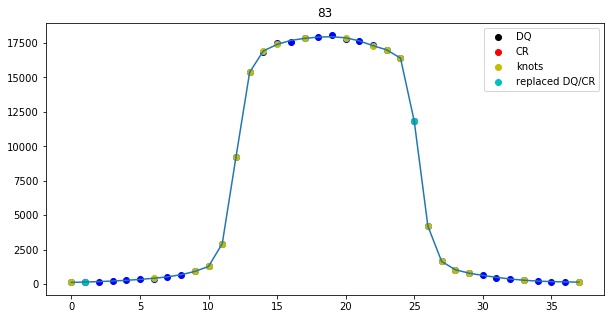

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


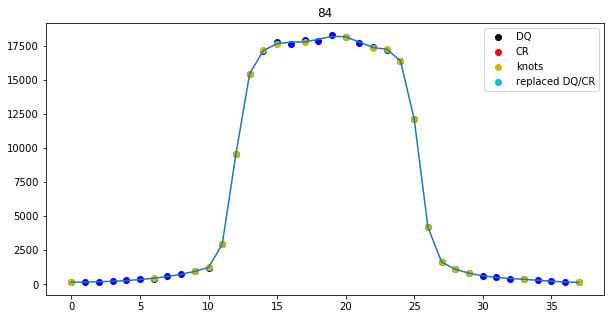

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


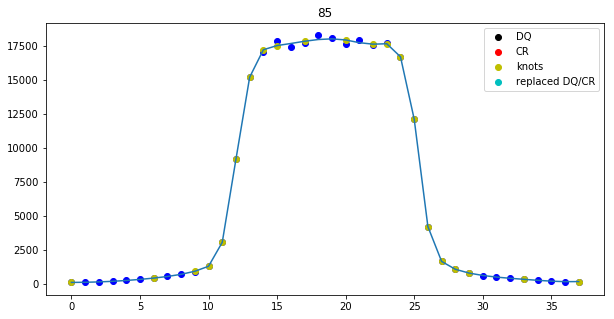

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


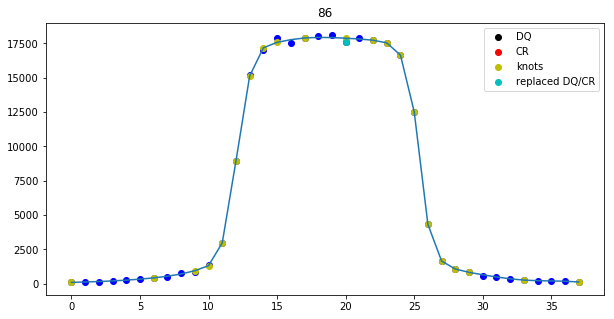

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 190, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 7
nr. of CRs 792
Spectrum located at pixel 137 in spatial direction
subexp 113.54225697442422 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 114 for exposure 6
6 13


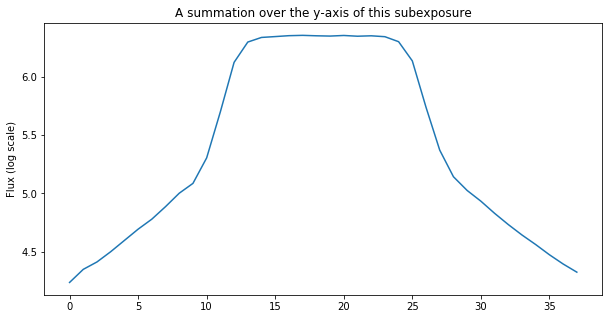

The difference between the two edges (for a 5-pixel bin for all subexps is): 3284.9544270833335
This value may not be larger than  2047.7882703053067  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


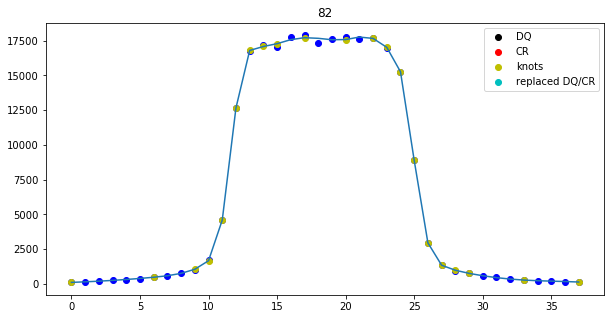

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


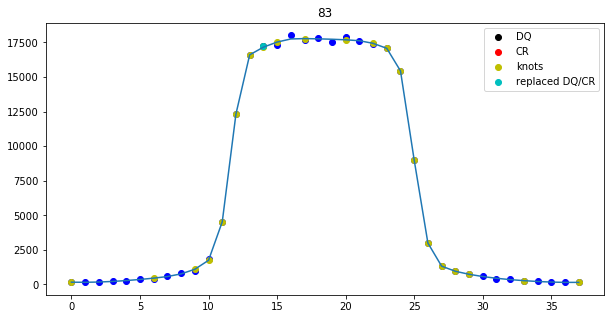

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


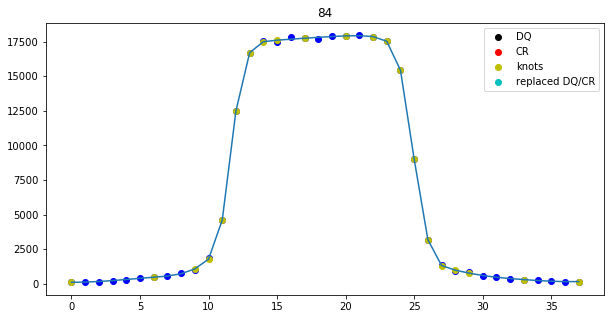

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


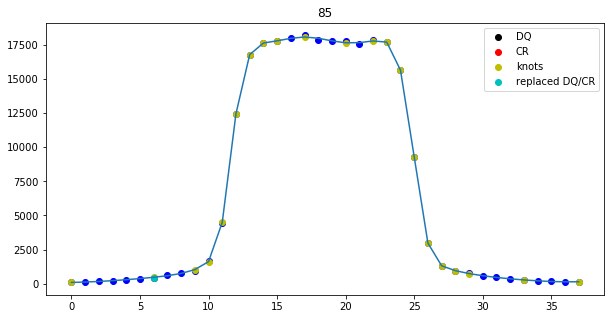

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


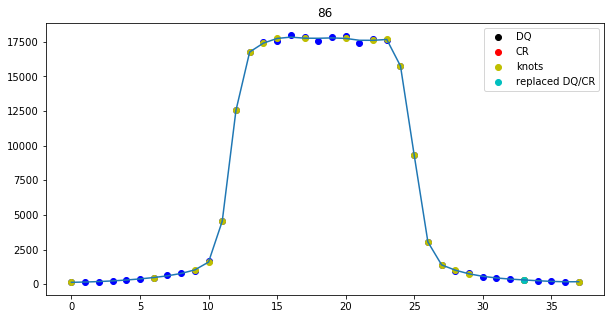

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 8
nr. of CRs 793
Spectrum located at pixel 137 in spatial direction
subexp 100.15017476853066 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 100 for exposure 7
7 13


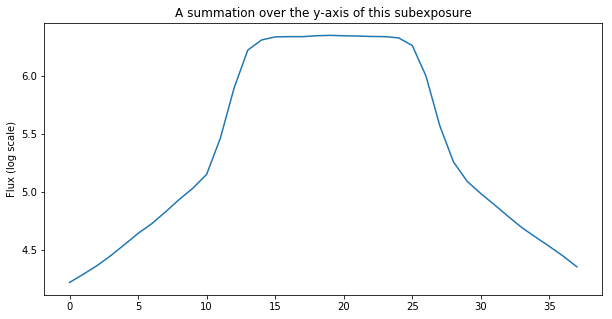

The difference between the two edges (for a 5-pixel bin for all subexps is): 4915.45234375
This value may not be larger than  2045.9085023529278  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


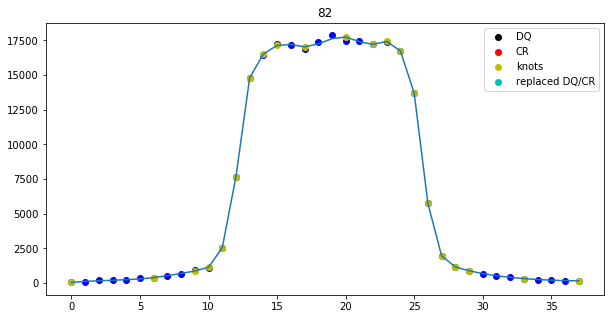

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


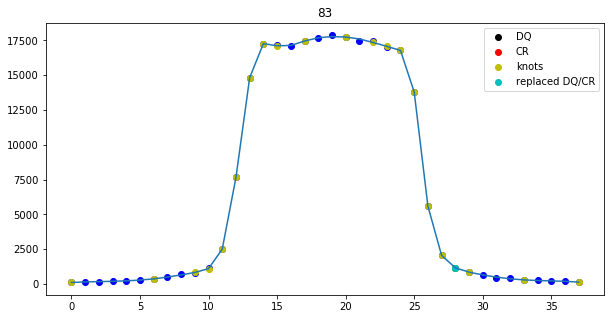

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


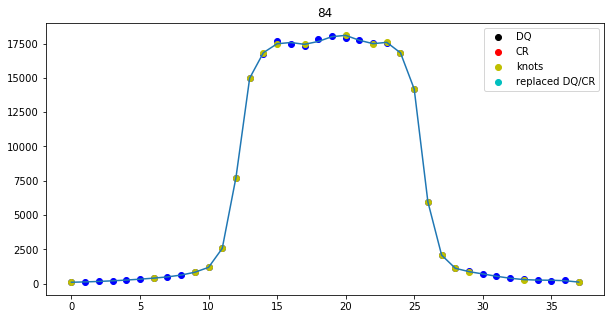

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


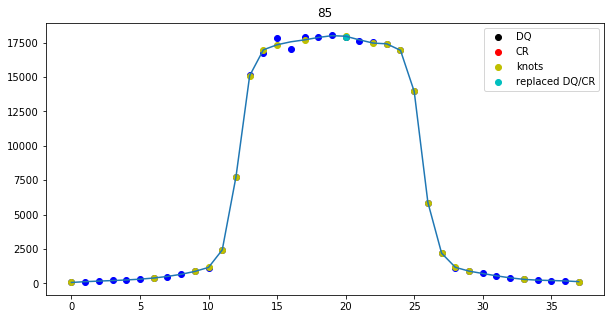

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


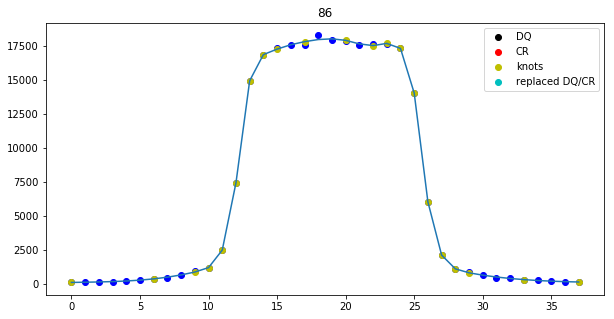

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 9
nr. of CRs 785
Spectrum located at pixel 137 in spatial direction
subexp 86.72102183709978 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 87 for exposure 8
8 13


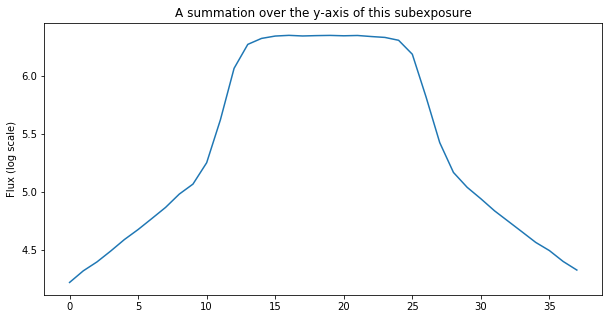

The difference between the two edges (for a 5-pixel bin for all subexps is): 3738.535091145833
This value may not be larger than  2047.465685508144  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


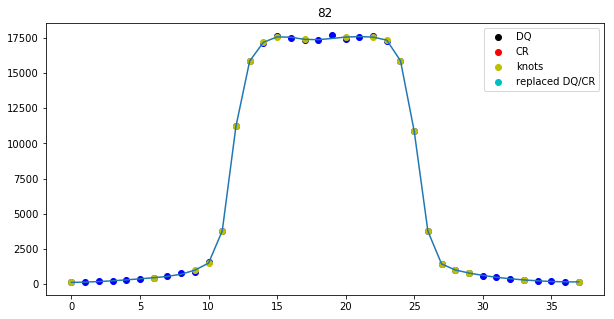

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


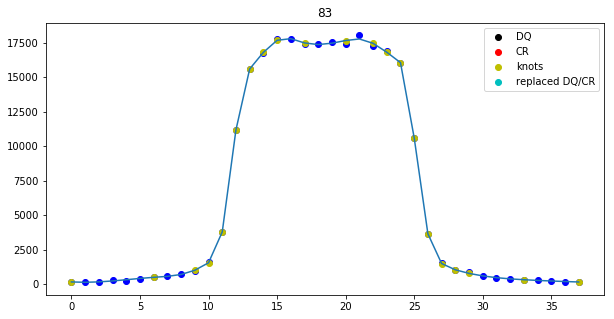

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


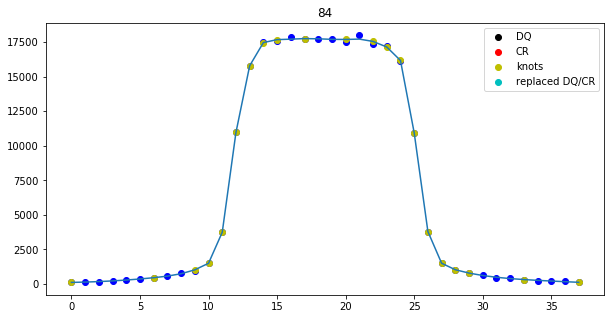

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


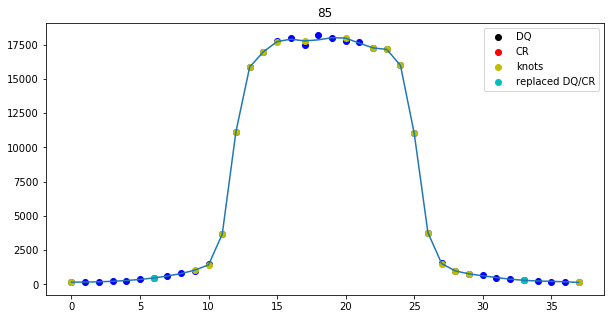

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


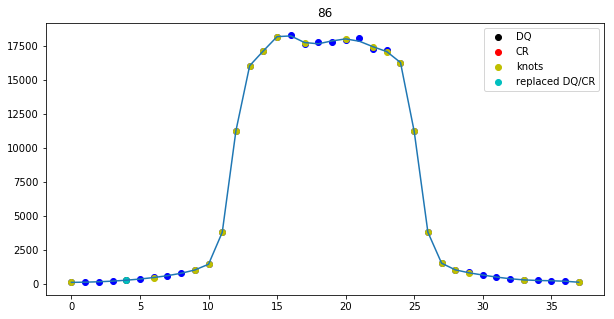

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 10
nr. of CRs 790
Spectrum located at pixel 137 in spatial direction
subexp 73.30469307601939 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 73 for exposure 9
9 13


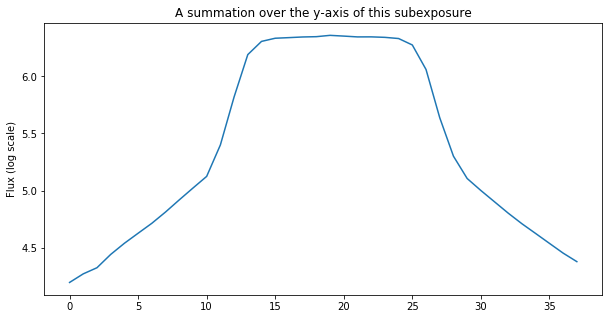

The difference between the two edges (for a 5-pixel bin for all subexps is): 5486.268717447917
This value may not be larger than  2046.057021036641  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


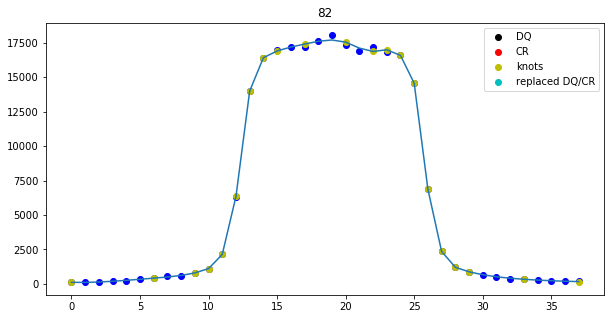

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


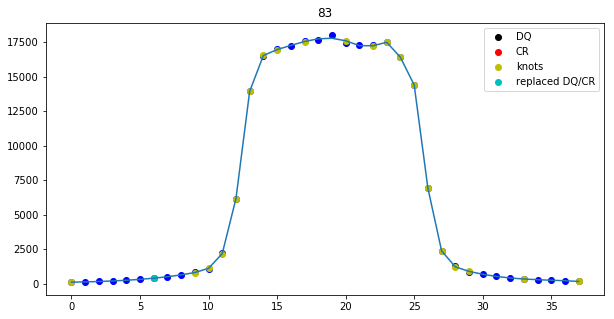

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


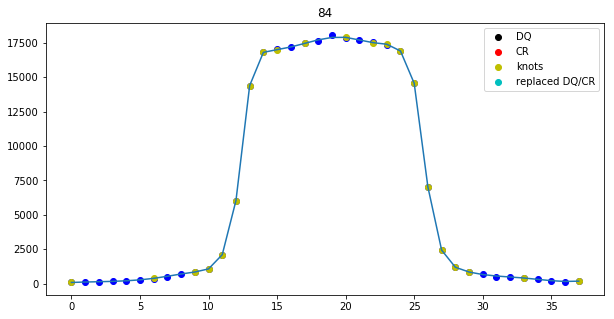

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


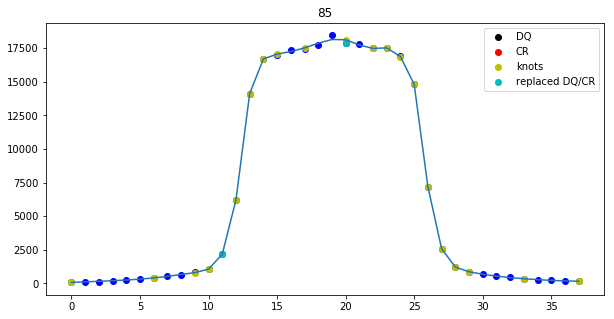

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


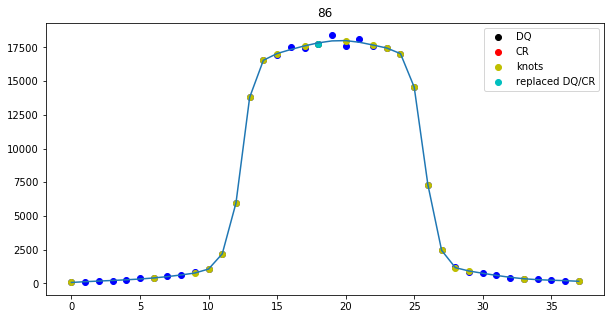

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 11
nr. of CRs 793
Spectrum located at pixel 137 in spatial direction
subexp 59.87027020570164 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 60 for exposure 10
10 13


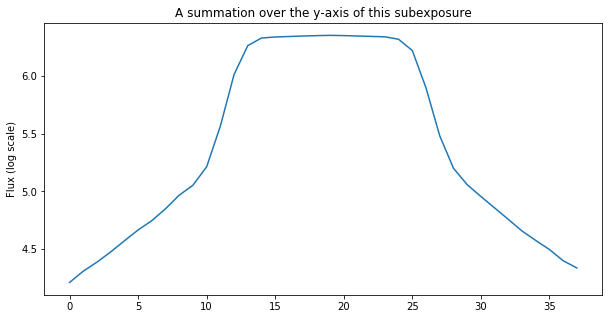

The difference between the two edges (for a 5-pixel bin for all subexps is): 3836.415950520833
This value may not be larger than  2045.3828329516539  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


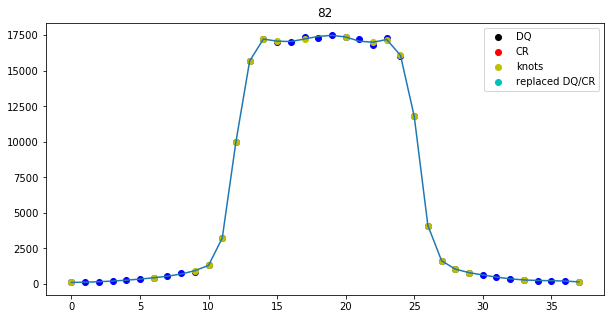

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


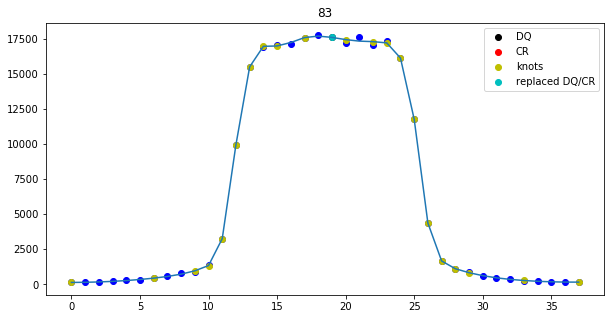

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


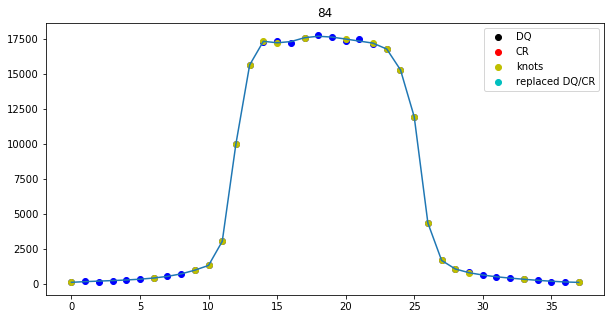

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


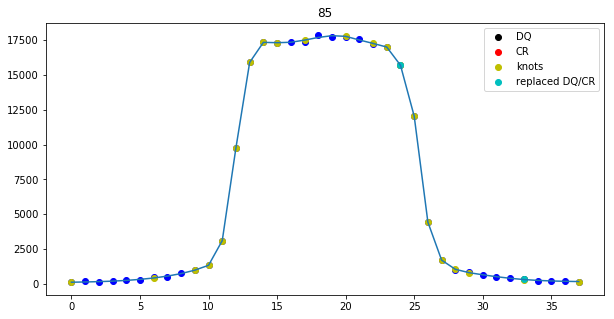

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


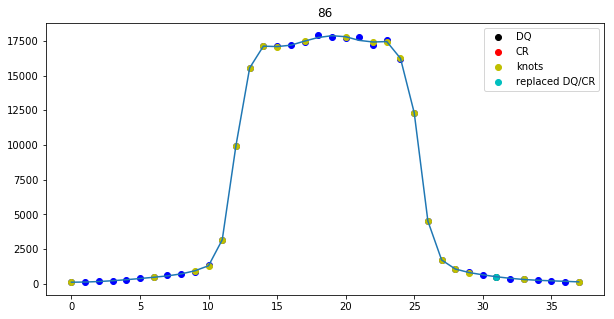

Optimal extraction fitting failed for columns: [0, 1, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 12
nr. of CRs 785
Spectrum located at pixel 137 in spatial direction
subexp 46.42922643166481 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 46 for exposure 11
11 13


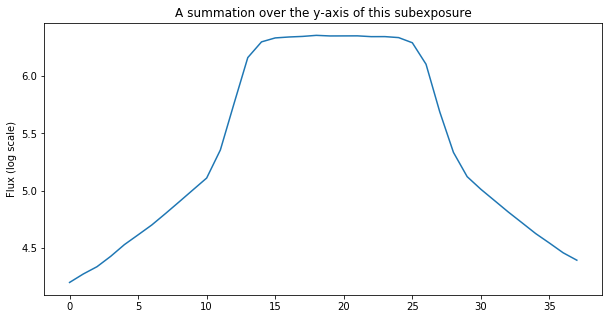

The difference between the two edges (for a 5-pixel bin for all subexps is): 5600.376302083333
This value may not be larger than  2044.6423648159107  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


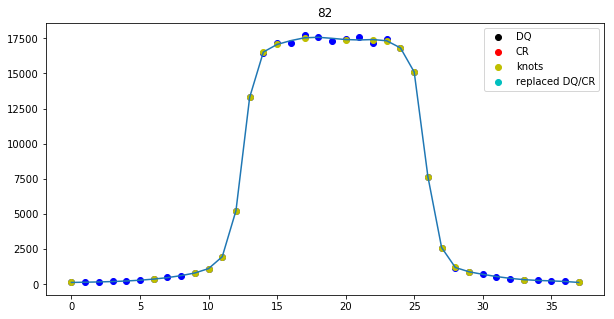

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


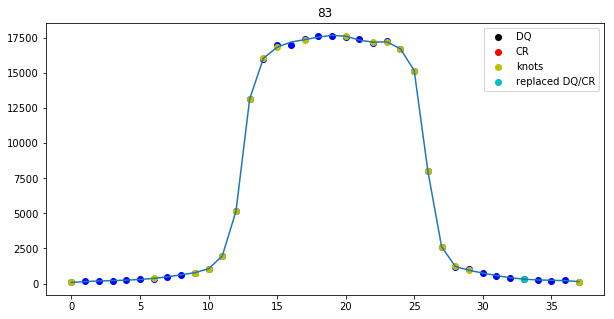

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


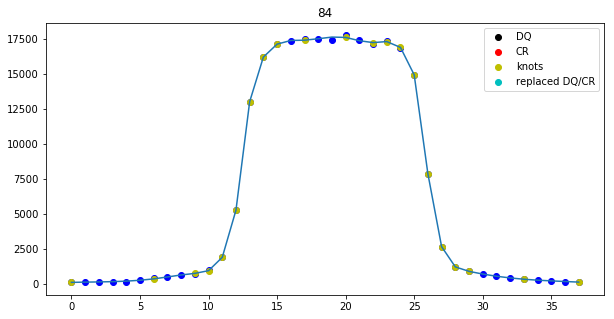

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


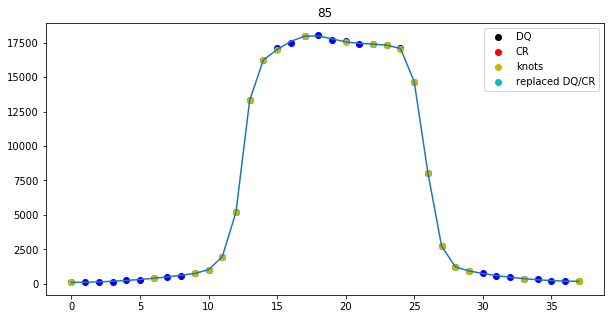

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


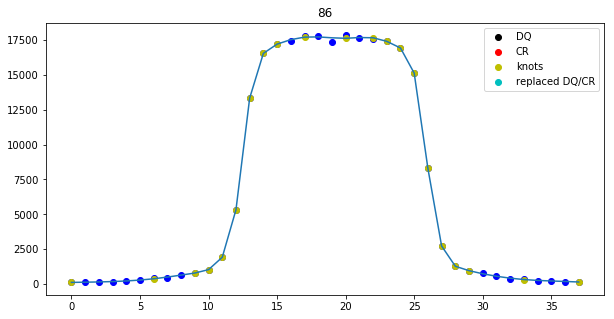

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 13
nr. of CRs 784
Spectrum located at pixel 137 in spatial direction
subexp 32.949692017462375 [193, 180, 167, 153, 140, 127, 114, 100, 87, 73, 60, 46, 33]
ypix is 33 for exposure 12
12 13


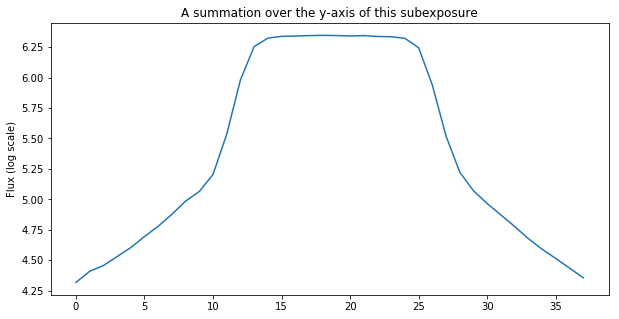

The difference between the two edges (for a 5-pixel bin for all subexps is): 2801.850390625
This value may not be larger than  2047.3441006989194  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


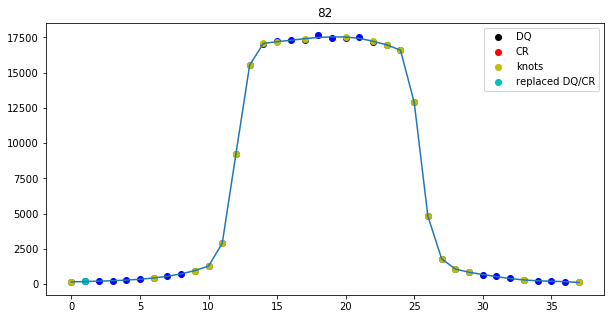

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


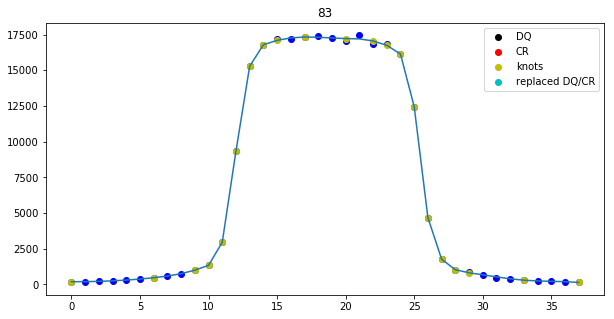

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


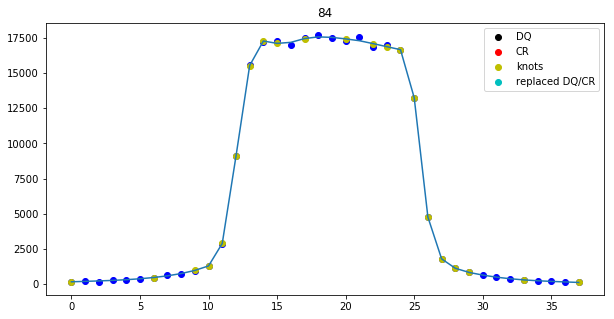

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


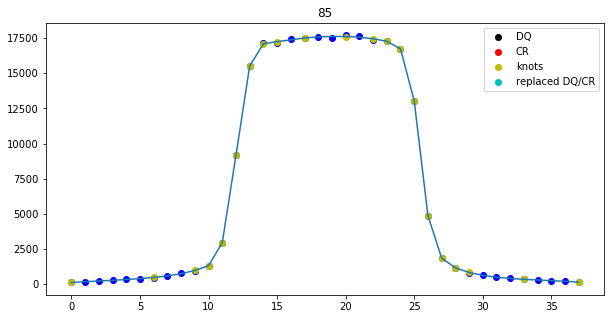

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


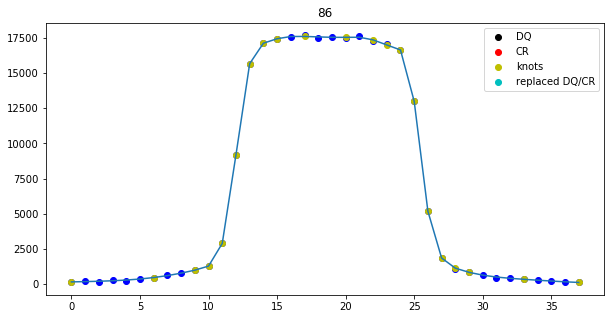

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE


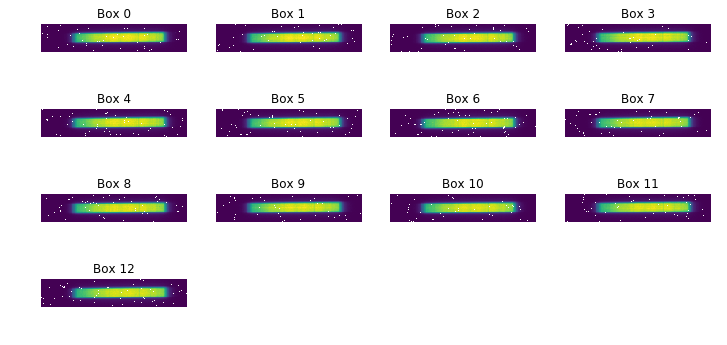

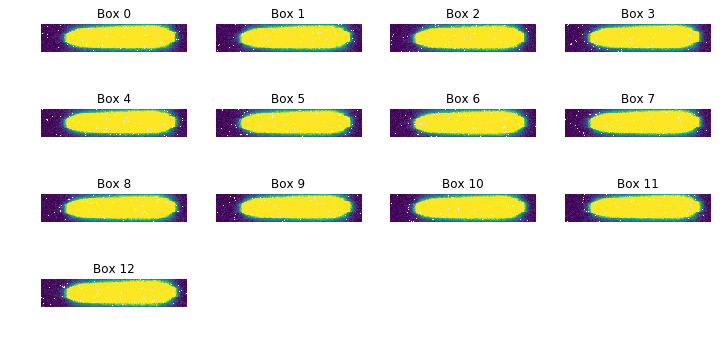

[ 0.00000000e+00  4.44089210e-16  2.22044605e-16  0.00000000e+00
 -1.11022302e-16  1.11022302e-16  3.33066907e-16 -1.11022302e-16
  3.33066907e-16 -1.11022302e-16  0.00000000e+00  2.22044605e-16
  3.33066907e-16  2.22044605e-16  0.00000000e+00  0.00000000e+00
 -2.22044605e-16  2.22044605e-16 -1.11022302e-16  1.11022302e-16
  0.00000000e+00 -2.22044605e-16  1.11022302e-16  1.11022302e-16
 -2.22044605e-16  0.00000000e+00  2.22044605e-16  2.22044605e-16
  0.00000000e+00  0.00000000e+00  4.44089210e-16 -4.44089210e-16
 -2.22044605e-16  4.44089210e-16  2.22044605e-16  0.00000000e+00
  2.22044605e-16  2.22044605e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00 -4.44089210e-16  2.22044605e-16  0.00000000e+00
 -2.22044605e-16  0.00000000e+00 -2.22044605e-16  0.00000000e+00
  2.22044605e-16  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -4.44089210e-16 -4.44089210e-16  2.22044605e-16 -2.22044605e-16
  2.22044605e-16 -2.22044605e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00  2.22044

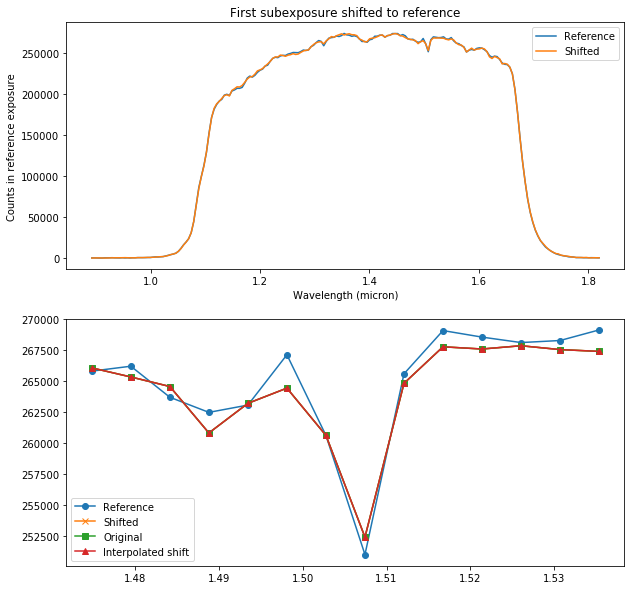

Shifted subexposure nr. 1 with 0.84949188701 pixels and shrunk 0.0507466722862 percent.
Shifted subexposure nr. 2 with 0.746905078141 pixels and shrunk 0.123114557873 percent.
Shifted subexposure nr. 3 with 0.698747467453 pixels and shrunk 0.172198190621 percent.
Shifted subexposure nr. 4 with 0.561114051049 pixels and shrunk 0.257379871707 percent.
Shifted subexposure nr. 5 with 0.462151145068 pixels and shrunk 0.319584983654 percent.
Shifted subexposure nr. 6 with 0.270641504466 pixels and shrunk 0.409477645727 percent.
Shifted subexposure nr. 7 with 0.172959391636 pixels and shrunk 0.477065799125 percent.
Shifted subexposure nr. 8 with 0.0941667498197 pixels and shrunk 0.536640795254 percent.
Shifted subexposure nr. 9 with 0.0383572150424 pixels and shrunk 0.600912926583 percent.
Shifted subexposure nr. 10 with -0.0444478623857 pixels and shrunk 0.662942680986 percent.
Shifted subexposure nr. 11 with -0.100436574264 pixels and shrunk 0.723072646068 percent.
Shifted subexposure nr. 1

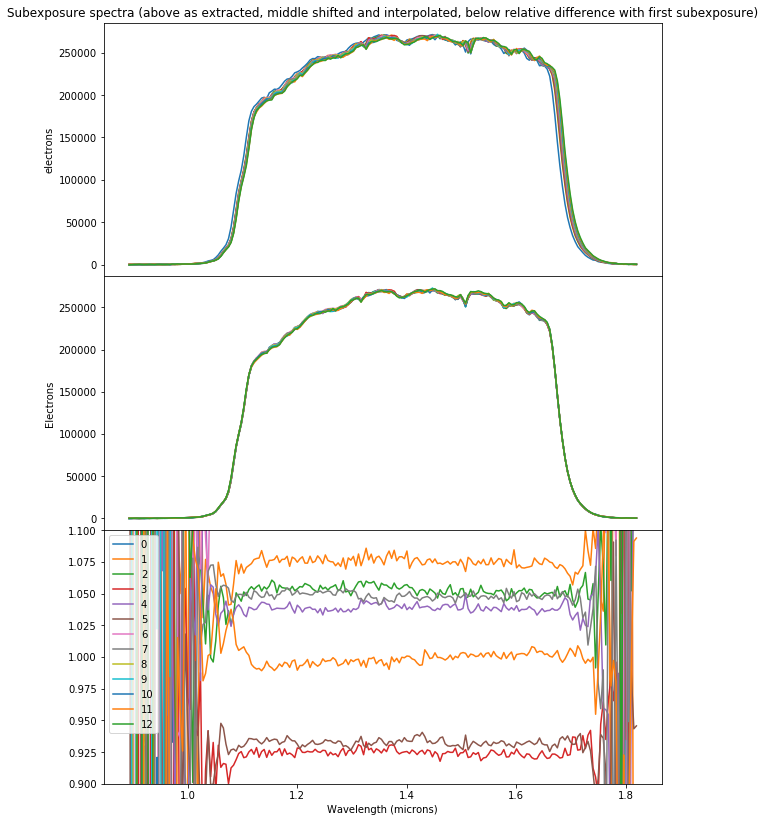

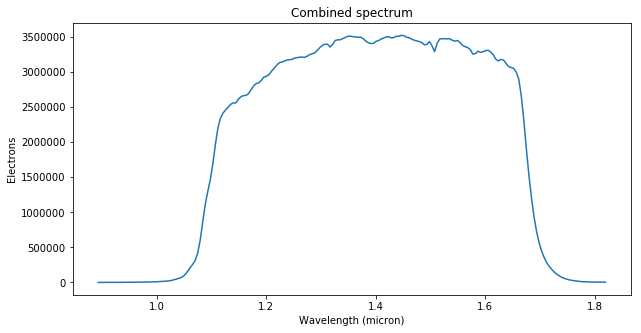

Saving spectrum to /Users/bob/Documents/PhD/WASP-80/output/idn202j6q_spec.txt
reduced 2458706.8741801106
Saving subexposure spectra to /Users/bob/Documents/PhD/WASP-80/output/idn202j6q_subs_spec.txt
Extraction took 14.36s
########################################
###########Finished Extraction##########
########################################
########################################
############Started Reduction##########
########################################
Data reduction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn203s4q_ima.fits
For configuration, see pipeline conf file: /Users/bob/Documents/PhD/WASP-80/transmission_reduction.conf
Forward scan
Catalogue used: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn203s3q_flt_1.cat
Direct Image name: idn203s3q
catalogue /Users/bob/Documents/PhD/WASP-80/HSTdata/idn203s3q_flt_1.cat
Catalogue file: idn203s3q_ima.fits
########################
Direct image location of (160.914886034,116.629686262)
FWHM of this subex

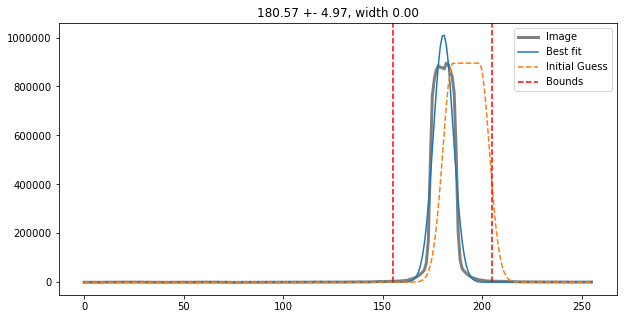

using a PHOENIX stellar model
amplitude and displacement on first order: -15.89384365312005 -123.52487915289285


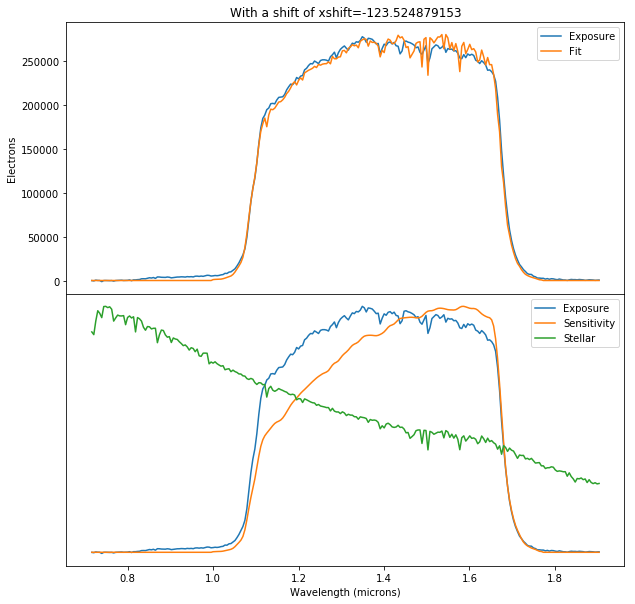

Applied an xshift of -123.524879153 pix from a comparison to a stellar spectrum
Initial xpix is 37 and shift_in_x: -123.524879153
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 62.34 pix
FWHM of this subexposure is  13.258340133141616


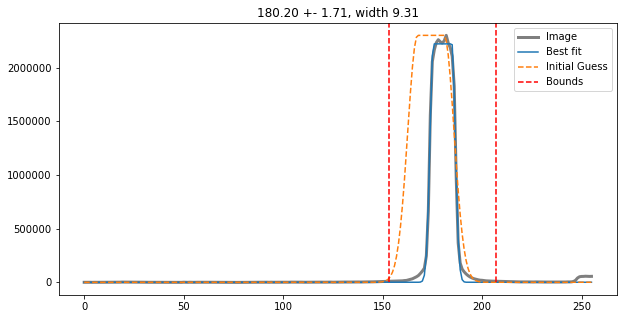

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.325055386241985


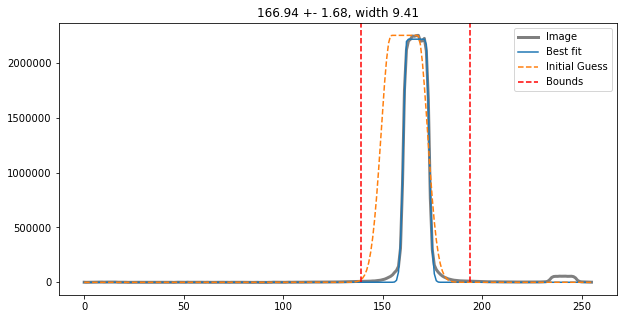

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.332826089311112


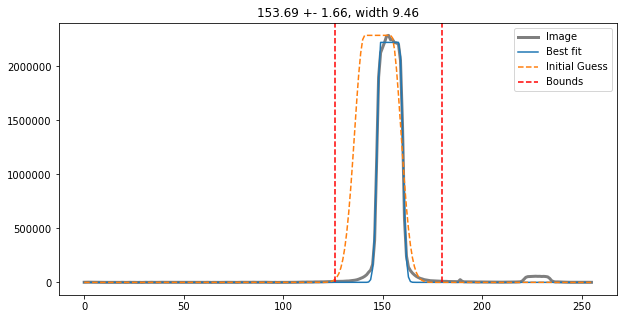

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.396353836018847


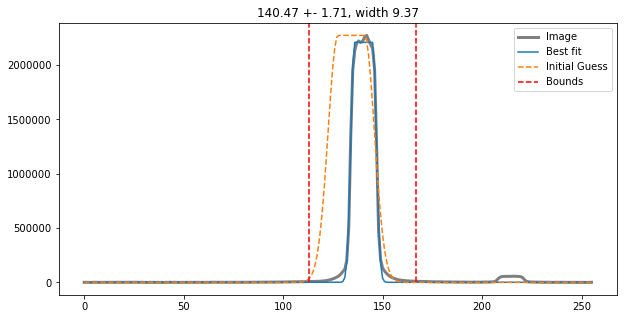

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.421379023118519


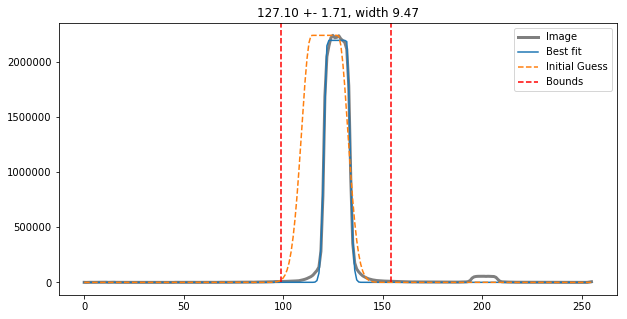

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.514429824769067


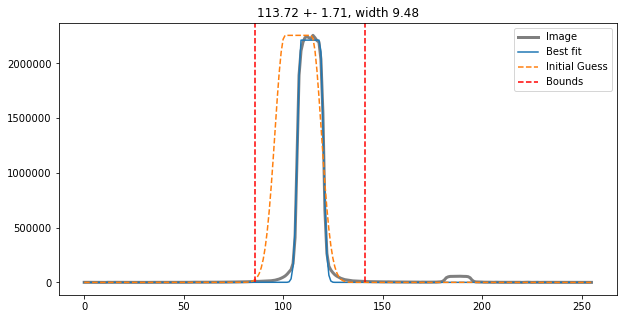

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.49807683800087


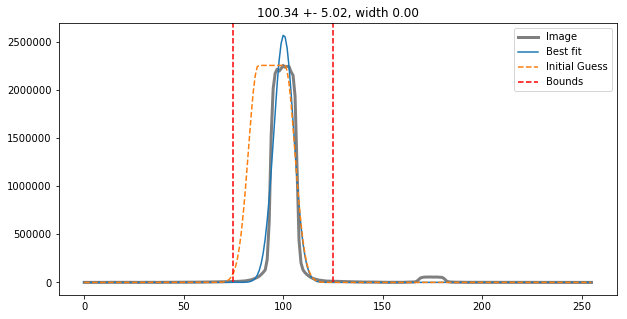

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.489552820887283


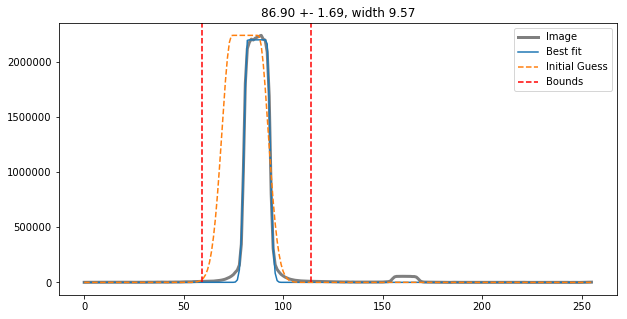

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.571401508133476


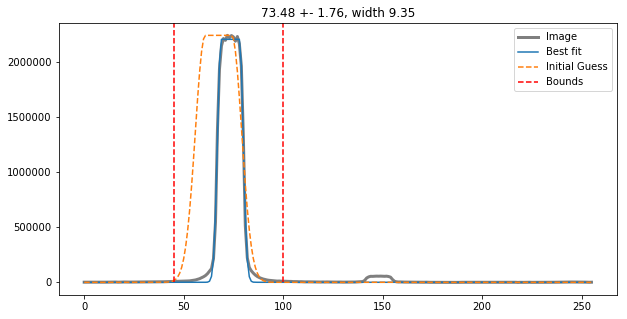

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.453135431405052


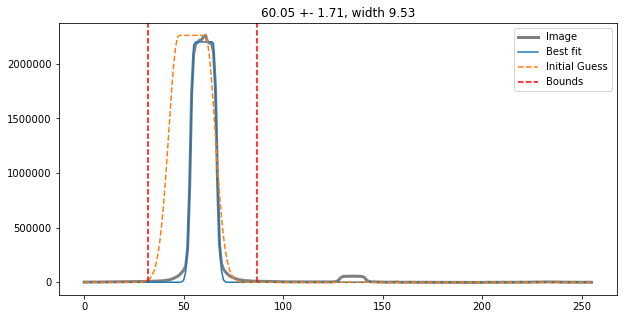

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.61578020458498


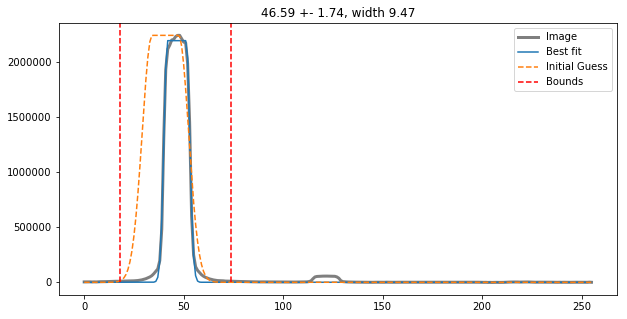

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.516042412239713


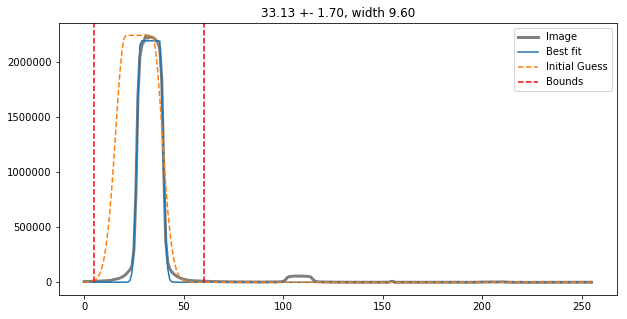

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
The final xpix is 37
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 62.34 pix
FWHM of this subexposure is  13.258340133141616


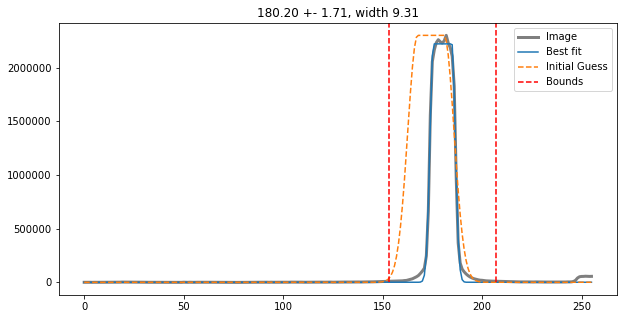

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.325055386241985


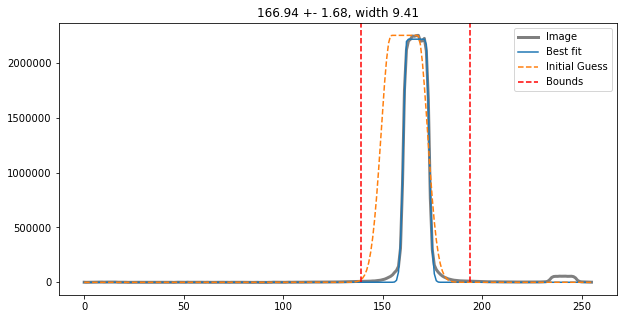

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.332826089311112


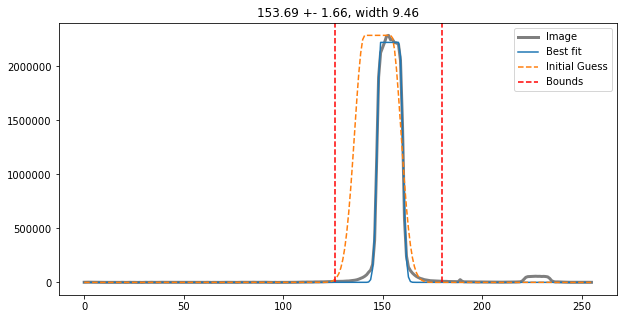

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.396353836018847


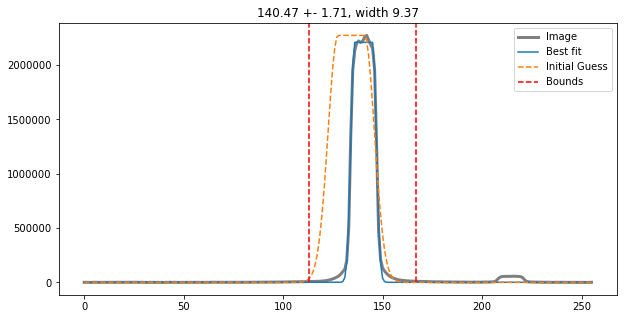

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.421379023118519


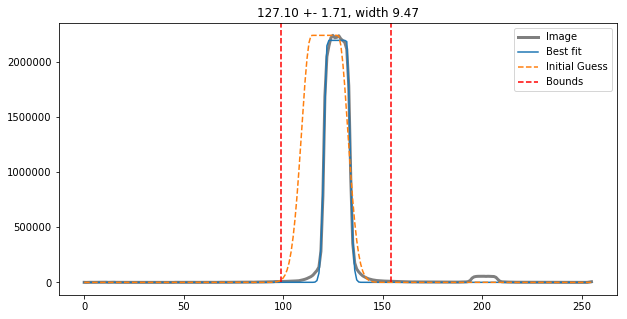

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.514429824769067


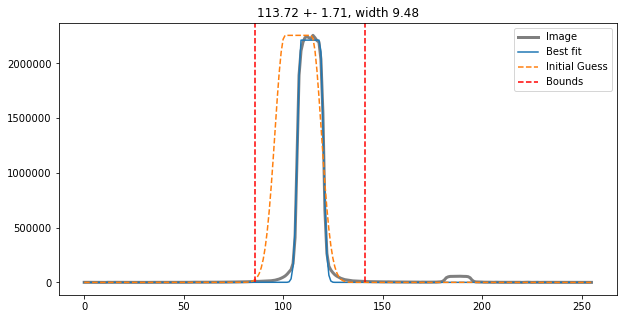

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.49807683800087


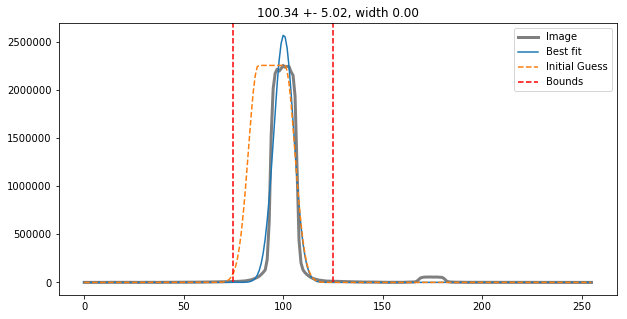

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.489552820887283


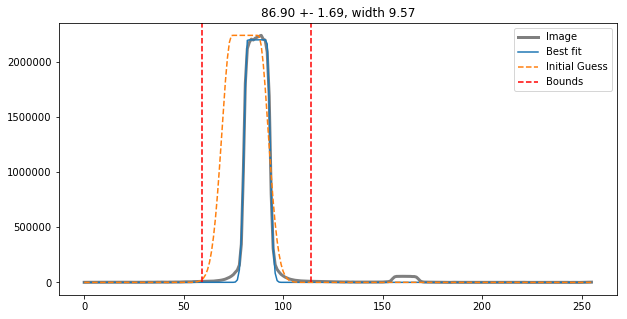

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.571401508133476


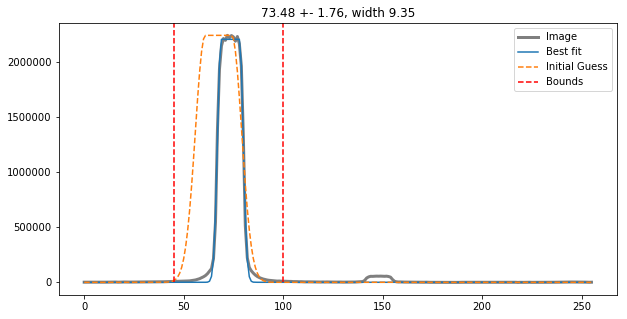

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.453135431405052


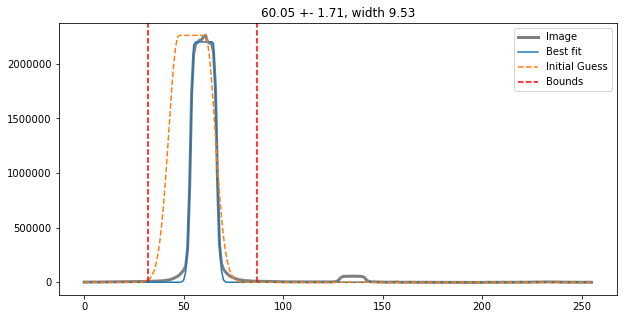

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.61578020458498


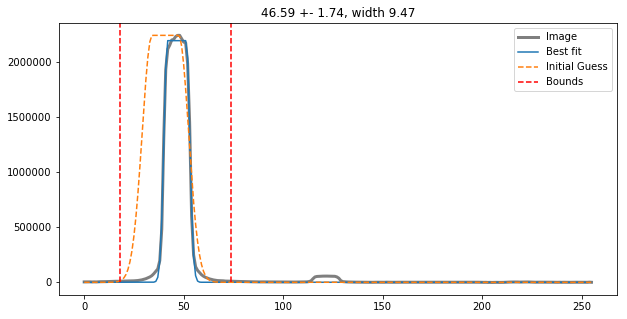

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.516042412239713


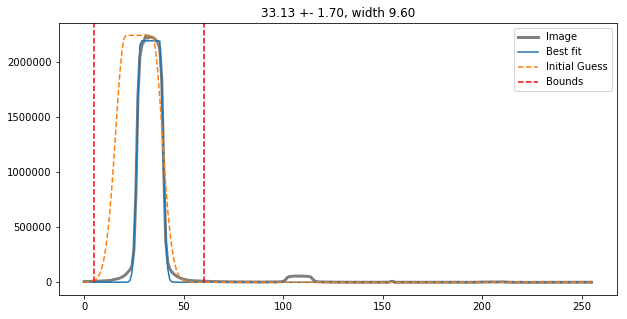

SHIFTINX -123.52487915289285
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
nr_CRs, Lows 5 0
nr_CRs, Lows 6 0
nr_CRs, Lows 21 1
nr_CRs, Lows 8 0
nr_CRs, Lows 12 0
nr_CRs, Lows 10 0
nr_CRs, Lows 6 0
nr_CRs, Lows 11 0
nr_CRs, Lows 8 0
nr_CRs, Lows 10 0
nr_CRs, Lows 13 0
nr_CRs, Lows 14 1
88.435623
88.435623 88.435623
Saving reduced file to /Users/bob/Documents/PhD/WASP-80/output/
Saving reduced exposure to /Users/bob/Documents/PhD/WASP-80/output/idn203s4q_red.fits...
Reduction took 12.31s
########################################
###########Finished Reduction###########
########################################
########################################
############Started Extraction##########
########################################
Spectral extraction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn203s4q_ima.fits
For configuration, see conf file: /Users/bob/Documents/PhD/WASP-80/transmission_extraction.conf
Forward scan
Extracting from subexposure 1
E

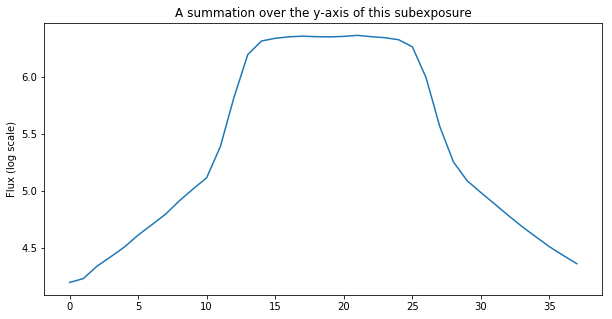

The difference between the two edges (for a 5-pixel bin for all subexps is): 4610.901953125
This value may not be larger than  2042.68476928445  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Using flux for variance estimate
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


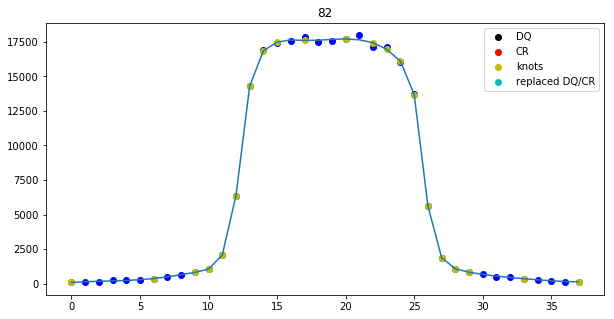

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


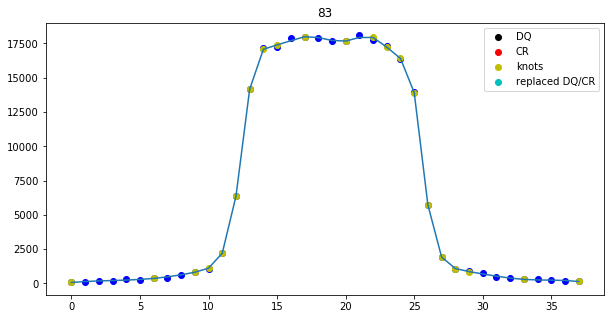

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


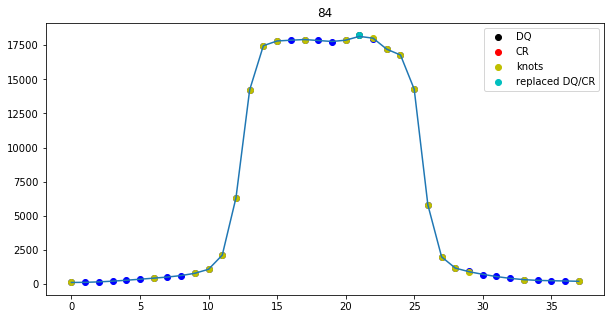

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


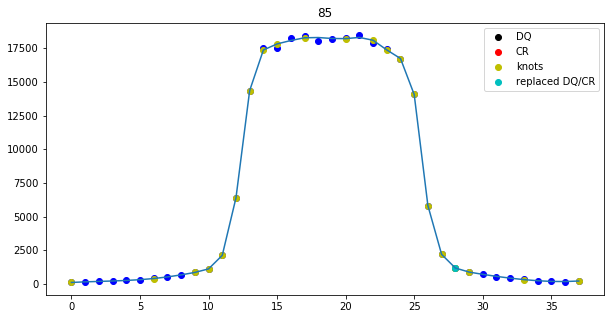

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


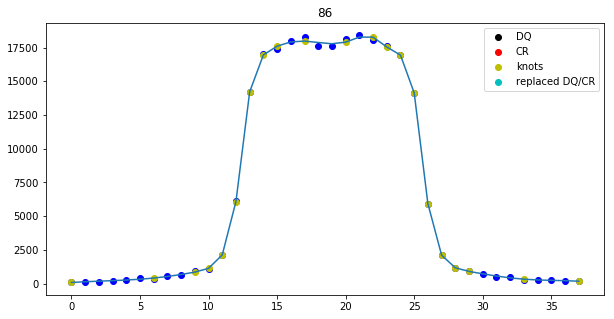

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 2
nr. of CRs 782
Spectrum located at pixel 137 in spatial direction
subexp 166.93609896333598 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 166 for exposure 1
1 12


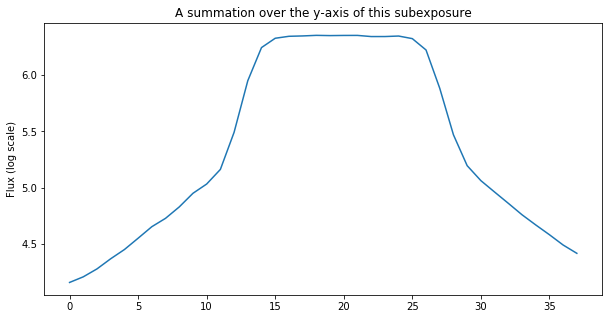

The difference between the two edges (for a 5-pixel bin for all subexps is): 6642.90546875
This value may not be larger than  2043.2087183316996  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


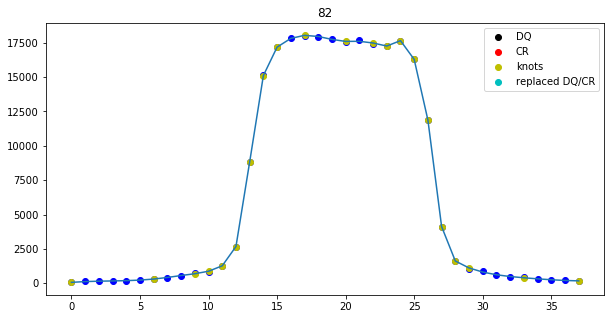

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


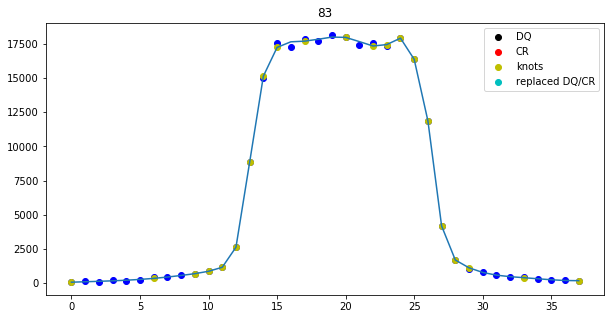

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


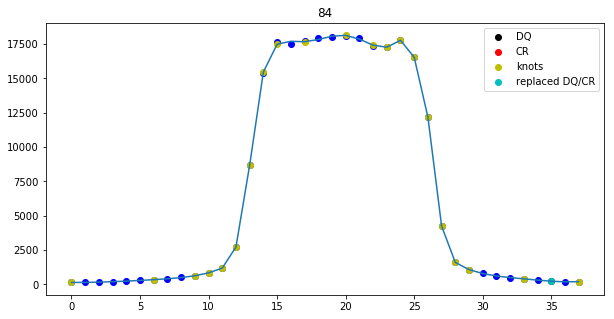

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


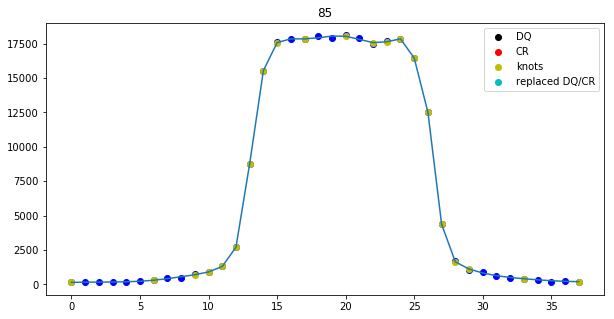

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


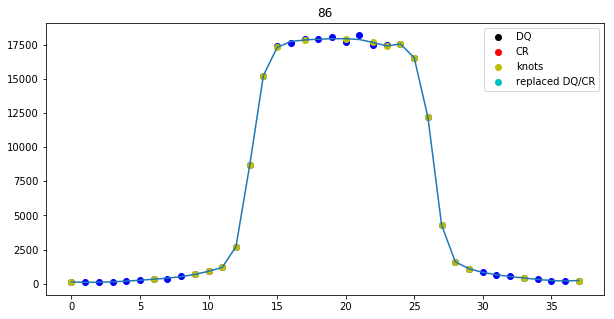

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 3
nr. of CRs 799
Spectrum located at pixel 137 in spatial direction
subexp 153.68934067726175 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 154 for exposure 2
2 12


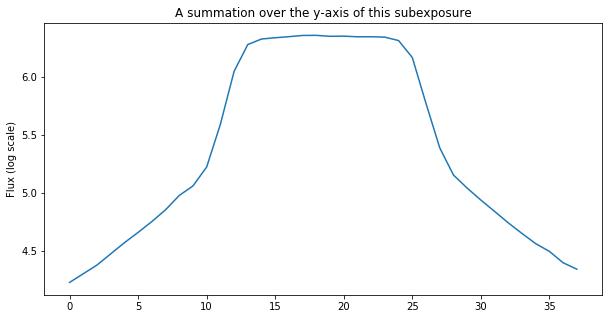

The difference between the two edges (for a 5-pixel bin for all subexps is): 3215.4109375
This value may not be larger than  2045.3699257917463  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


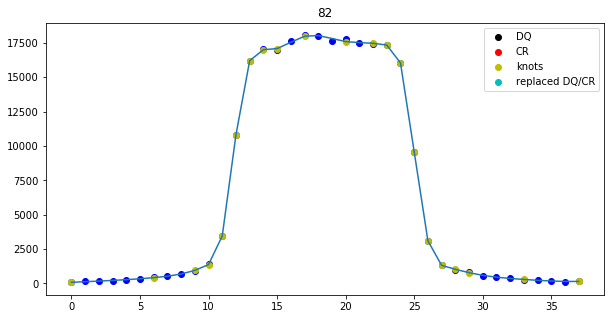

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


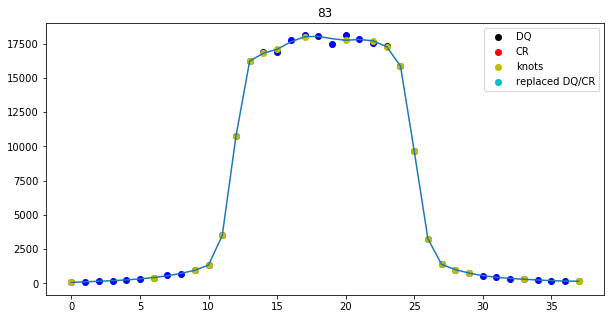

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


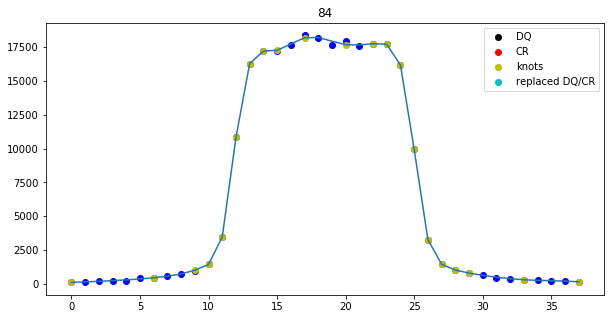

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


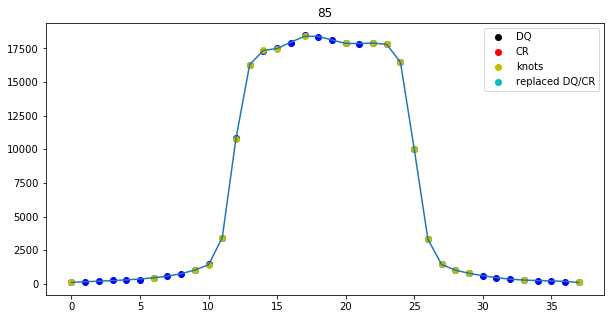

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


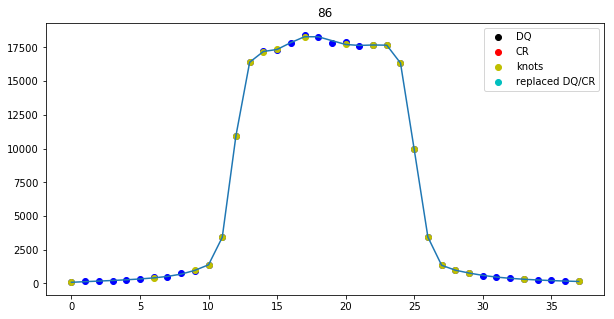

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 190, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 4
nr. of CRs 800
Spectrum located at pixel 137 in spatial direction
subexp 140.46594357266014 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 140 for exposure 3
3 12


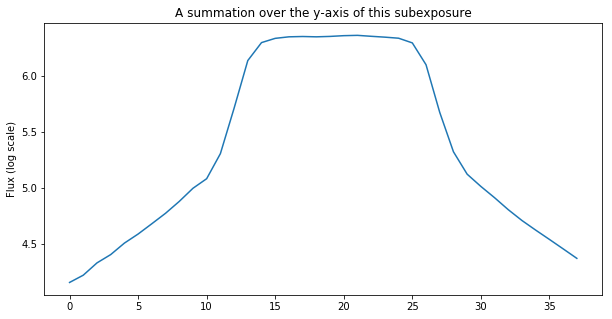

The difference between the two edges (for a 5-pixel bin for all subexps is): 5717.65859375
This value may not be larger than  2043.9628828984803  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


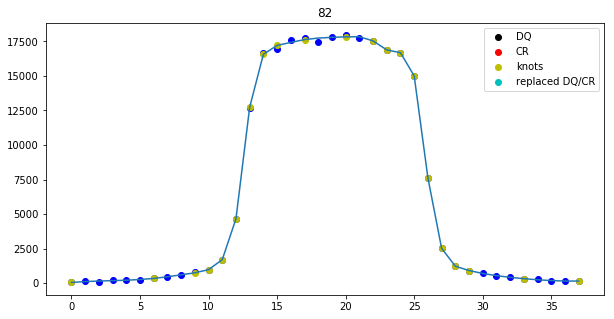

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


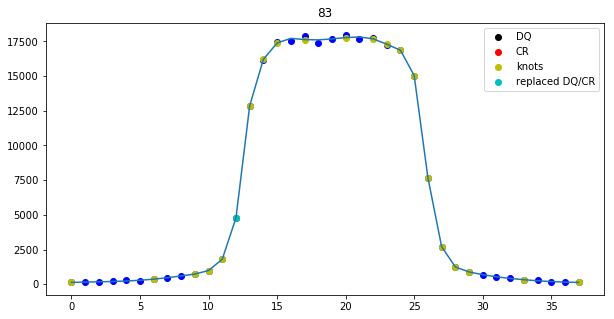

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


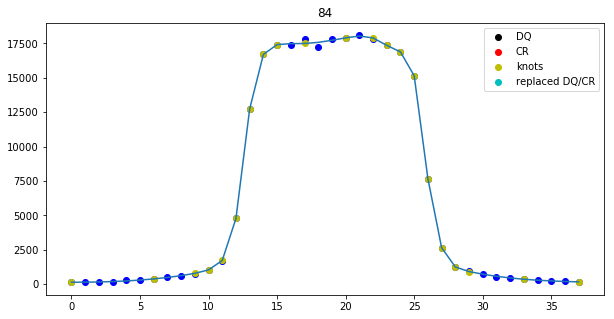

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


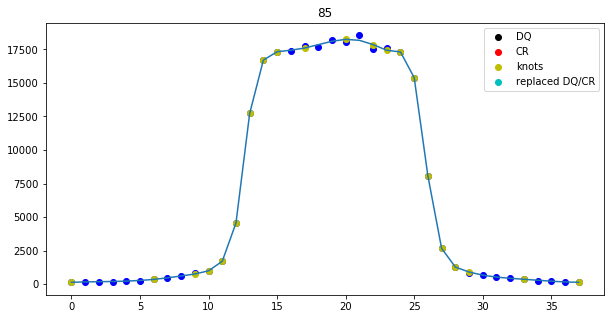

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


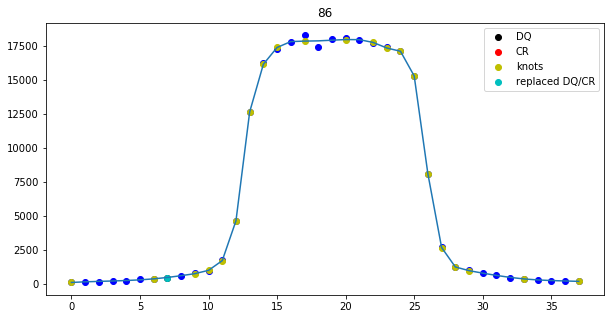

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 5
nr. of CRs 791
Spectrum located at pixel 137 in spatial direction
subexp 127.09690835450694 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 127 for exposure 4
4 12


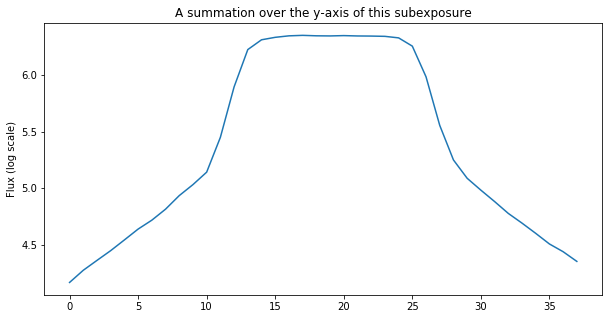

The difference between the two edges (for a 5-pixel bin for all subexps is): 5085.334375
This value may not be larger than  2043.1383702529793  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


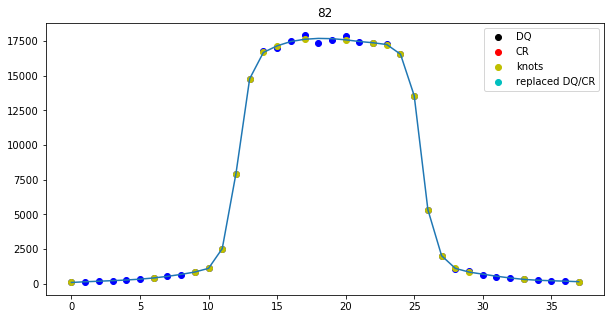

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


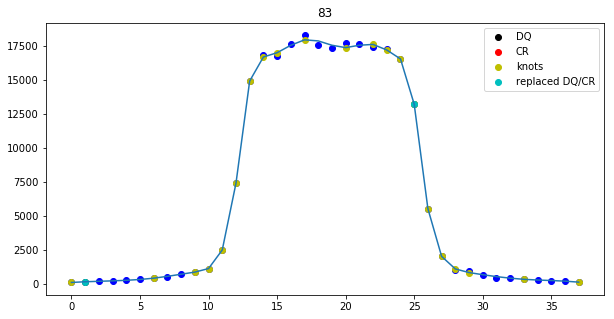

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


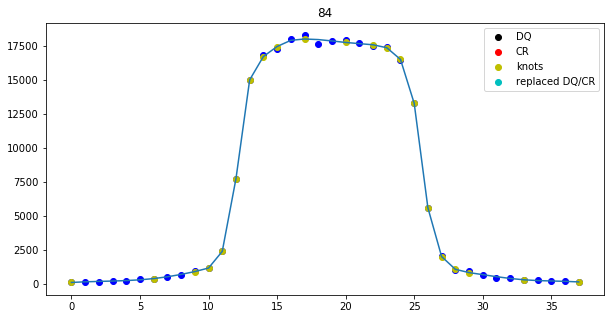

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


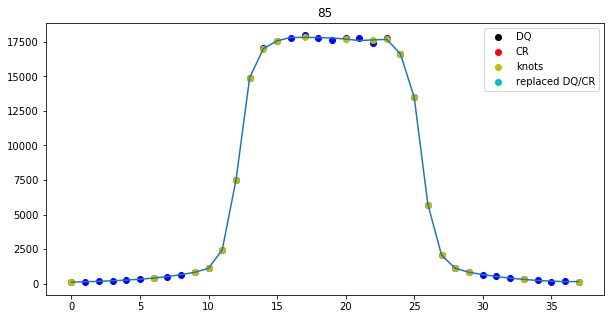

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


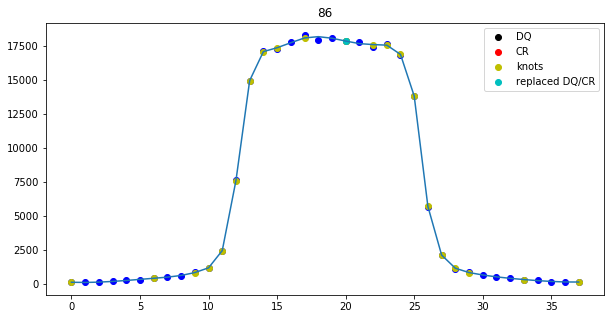

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 6
nr. of CRs 793
Spectrum located at pixel 137 in spatial direction
subexp 113.71806622011664 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 114 for exposure 5
5 12


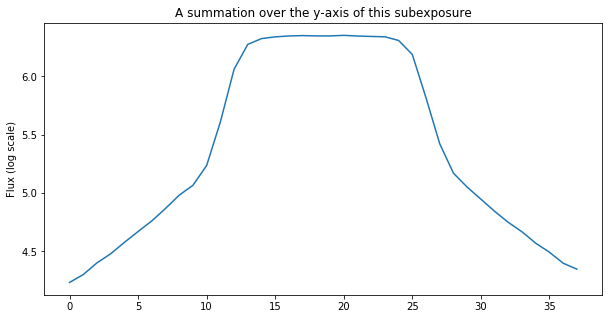

The difference between the two edges (for a 5-pixel bin for all subexps is): 3166.24296875
This value may not be larger than  2045.6781108799432  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


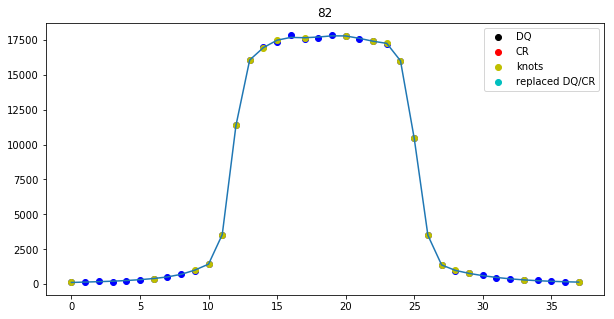

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


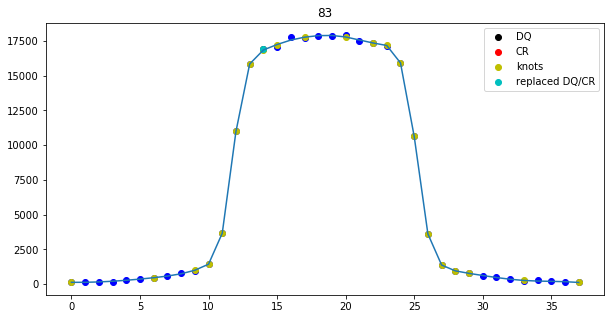

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


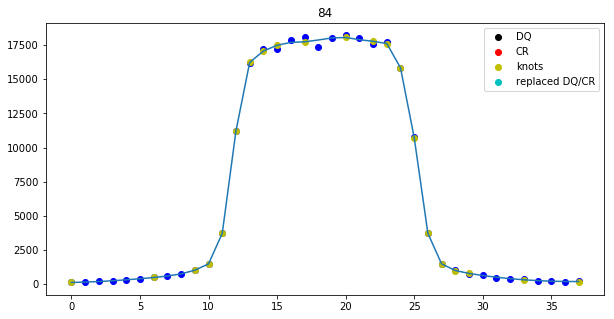

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


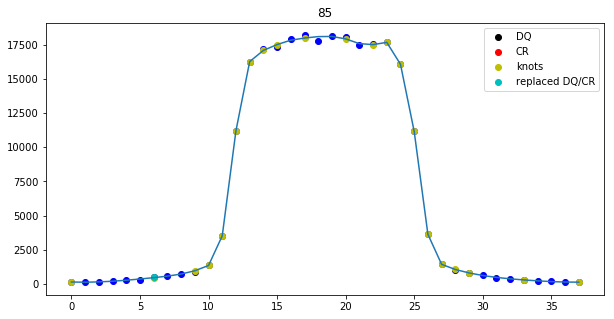

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


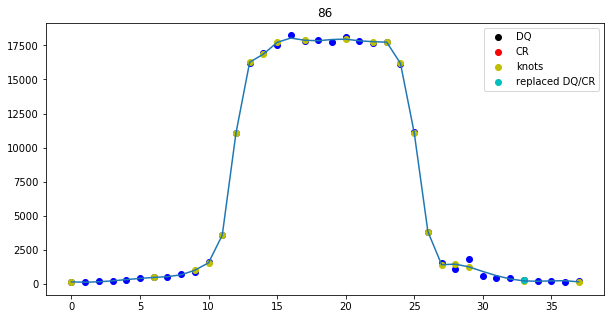

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 7
nr. of CRs 787
Spectrum located at pixel 137 in spatial direction
subexp 100.34233845046101 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 100 for exposure 6
6 12


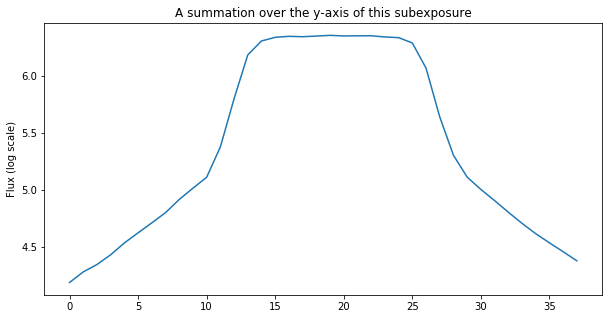

The difference between the two edges (for a 5-pixel bin for all subexps is): 5317.065625
This value may not be larger than  2043.1225122346432  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


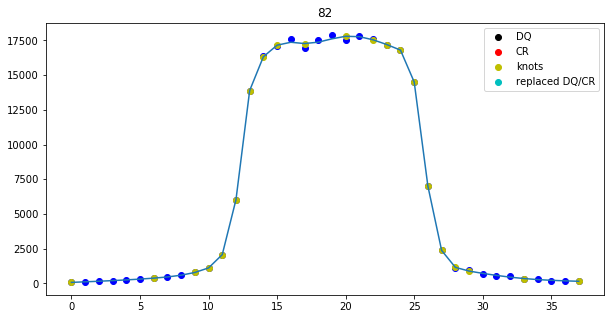

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


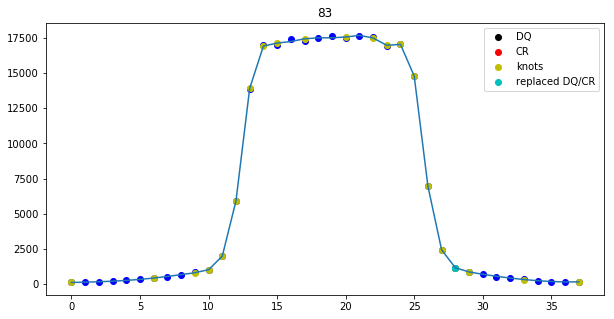

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


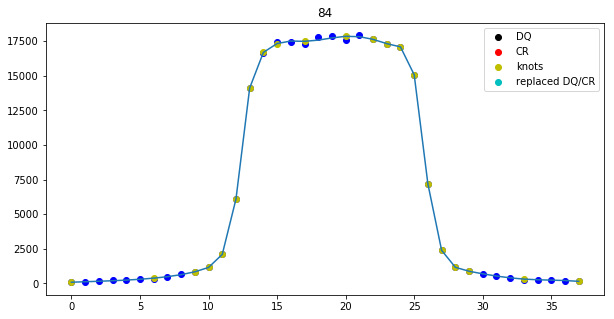

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


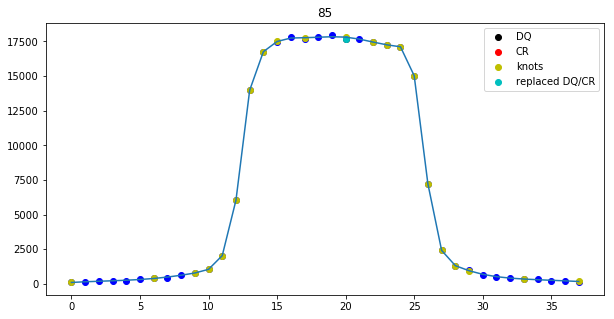

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


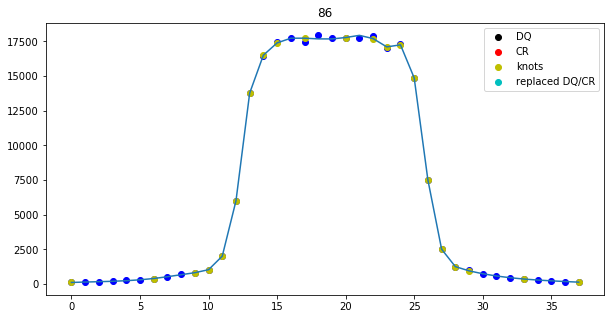

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 8
nr. of CRs 788
Spectrum located at pixel 137 in spatial direction
subexp 86.89792776799418 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 87 for exposure 7
7 12


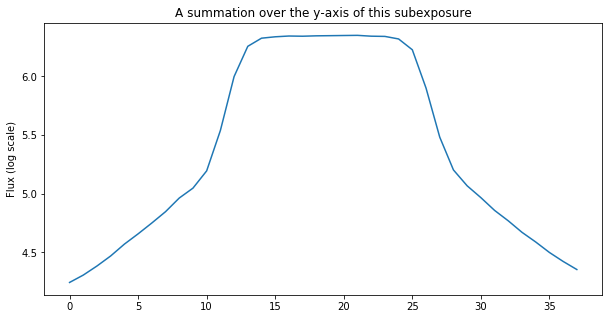

The difference between the two edges (for a 5-pixel bin for all subexps is): 3578.61640625
This value may not be larger than  2044.0092628622472  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


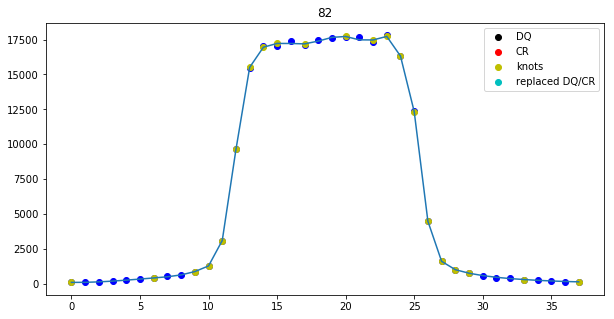

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


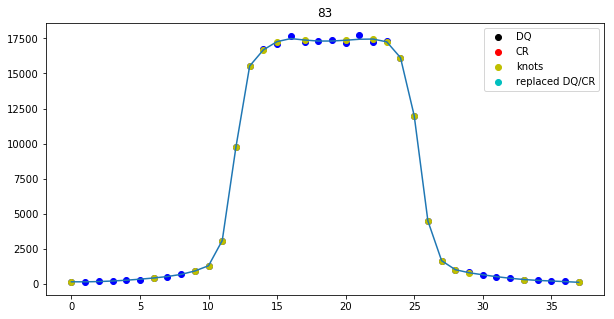

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


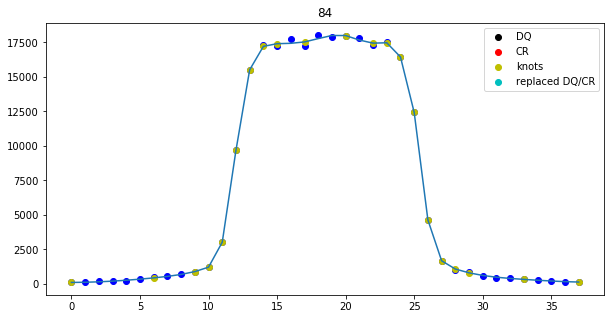

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


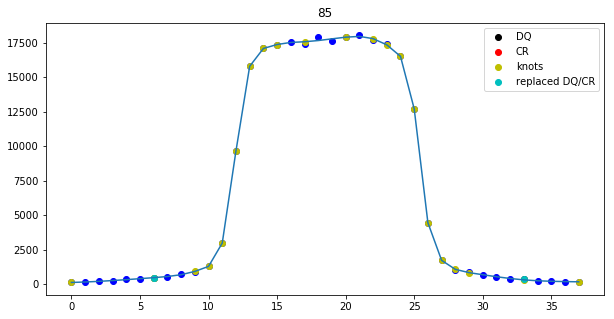

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


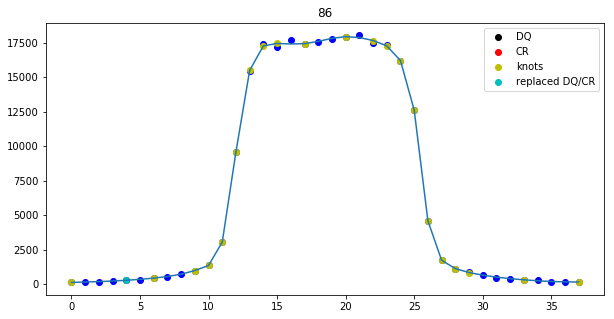

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 9
nr. of CRs 790
Spectrum located at pixel 137 in spatial direction
subexp 73.47939683045362 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 73 for exposure 8
8 12


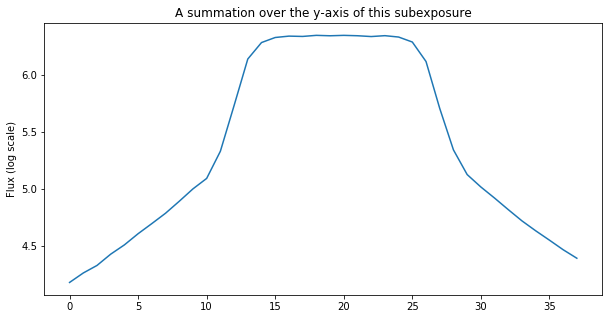

The difference between the two edges (for a 5-pixel bin for all subexps is): 5693.346484375
This value may not be larger than  2042.6407744224957  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


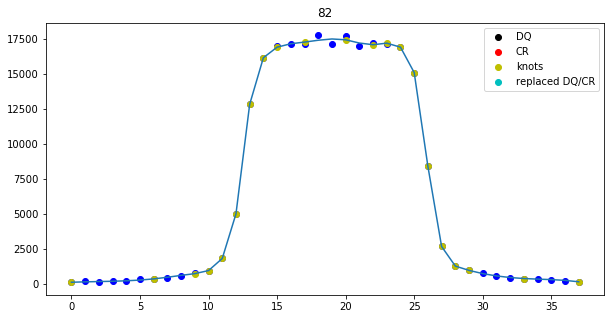

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


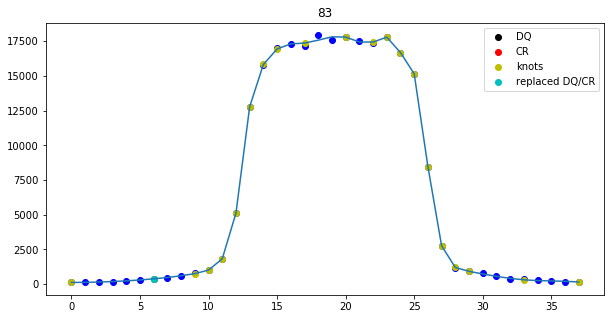

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


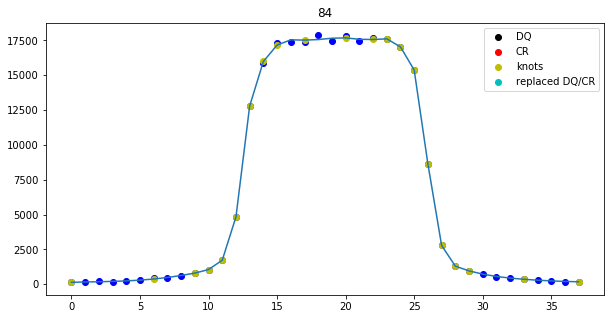

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


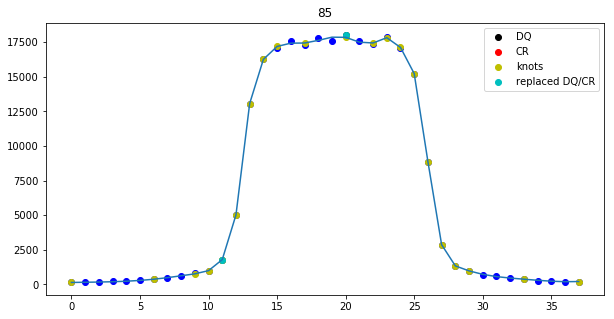

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


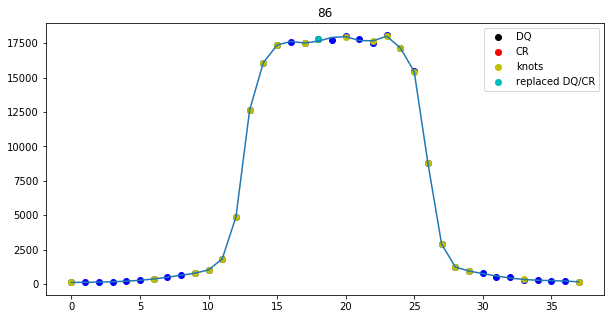

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 10
nr. of CRs 789
Spectrum located at pixel 137 in spatial direction
subexp 60.050226984819226 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 60 for exposure 9
9 12


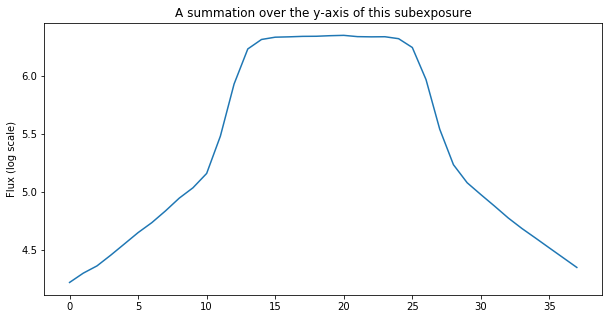

The difference between the two edges (for a 5-pixel bin for all subexps is): 4220.1796875
This value may not be larger than  2042.105188279977  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


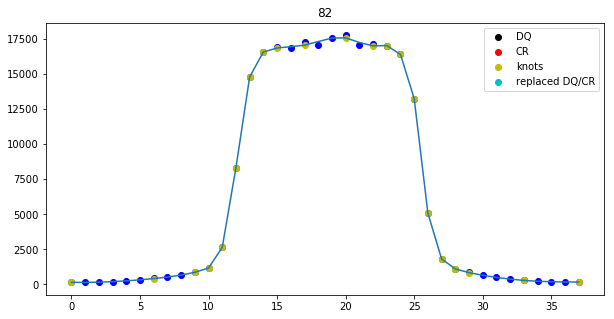

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


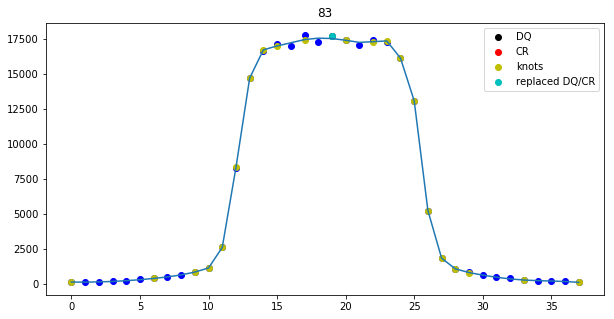

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


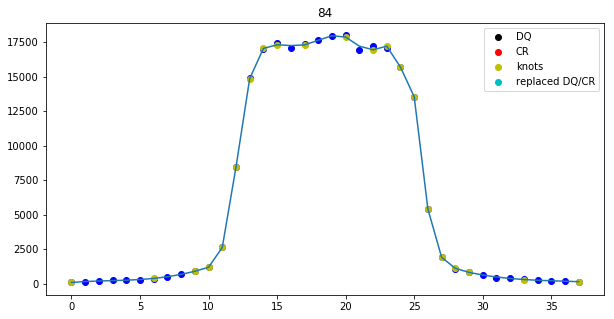

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


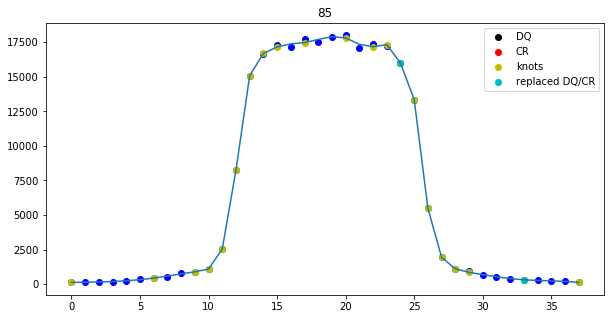

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


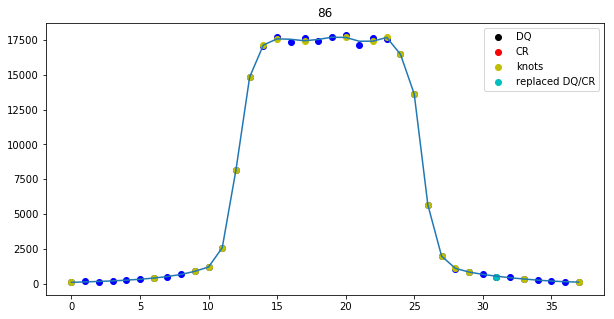

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 11
nr. of CRs 794
Spectrum located at pixel 137 in spatial direction
subexp 46.589230799059855 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 47 for exposure 10
10 12


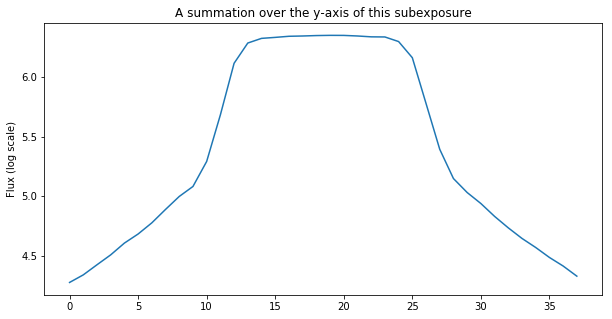

The difference between the two edges (for a 5-pixel bin for all subexps is): 2821.475
This value may not be larger than  2041.57488229063  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


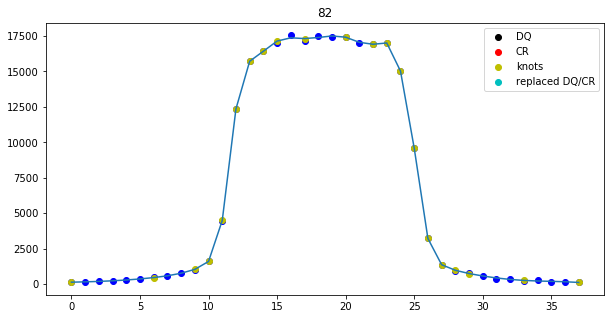

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


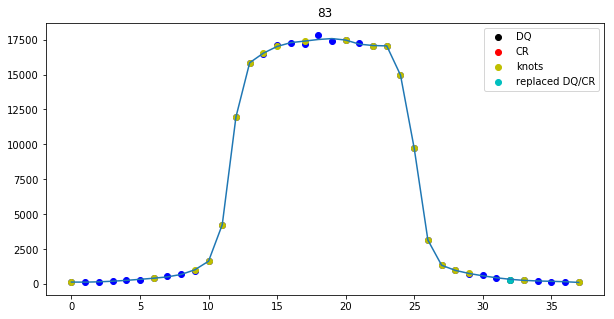

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


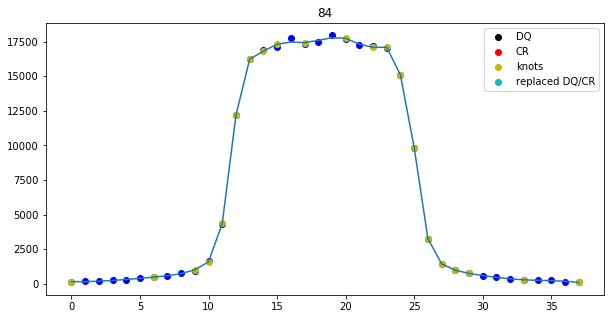

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


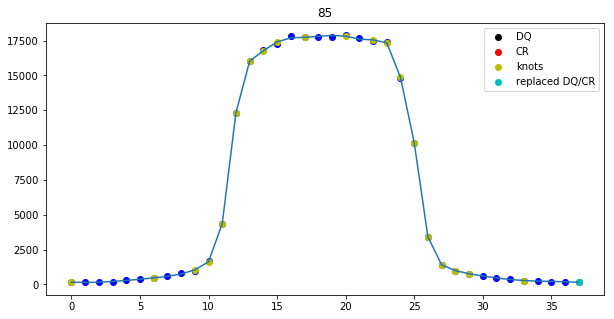

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


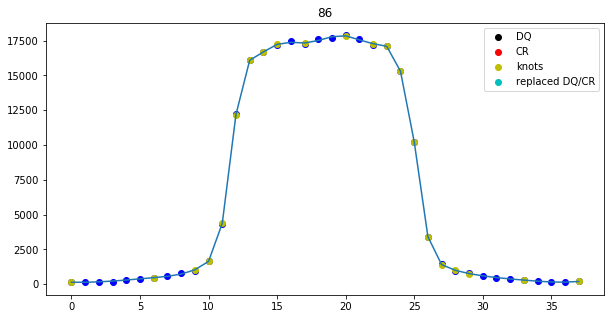

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 12
nr. of CRs 799
Spectrum located at pixel 137 in spatial direction
subexp 33.126630995461625 [180, 166, 154, 140, 127, 114, 100, 87, 73, 60, 47, 33]
ypix is 33 for exposure 11
11 12


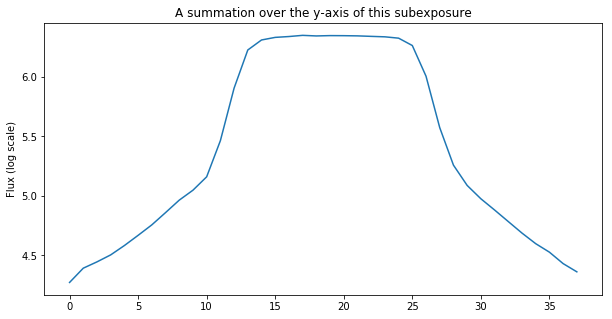

The difference between the two edges (for a 5-pixel bin for all subexps is): 3296.96796875
This value may not be larger than  2042.6920146381995  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


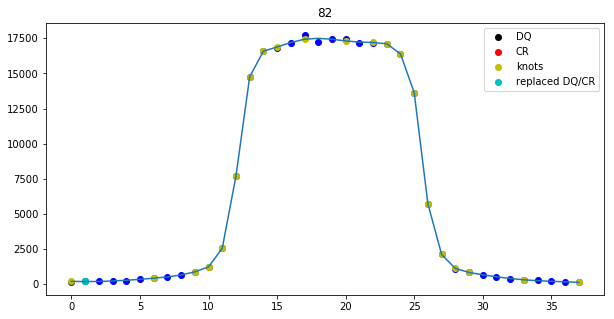

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


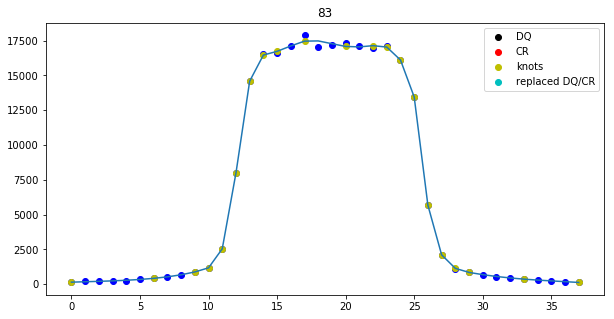

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


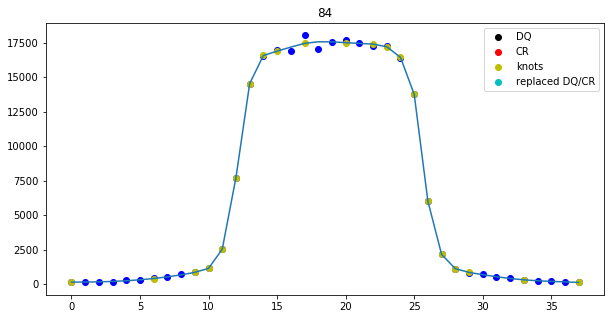

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


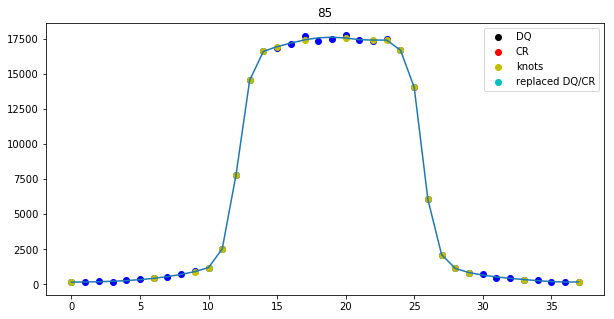

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


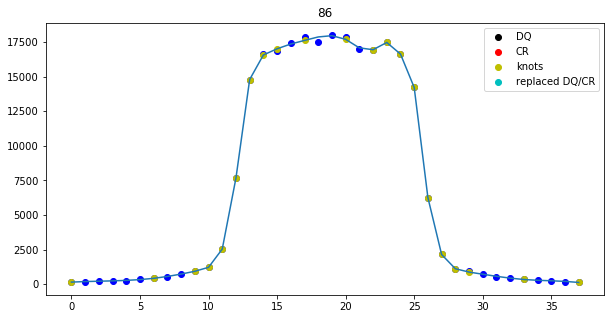

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE


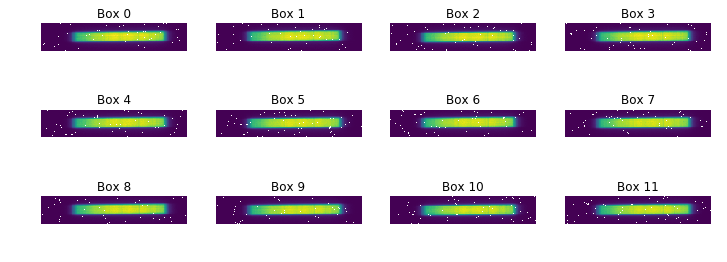

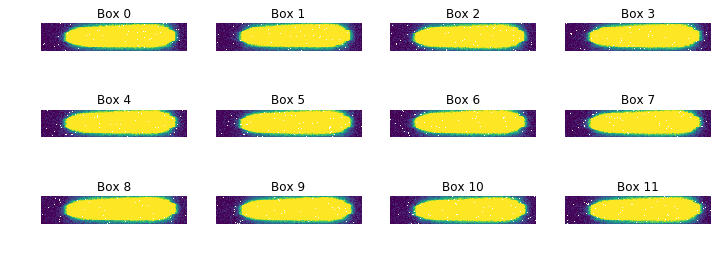

[ 0.00000000e+00  4.44089210e-16  2.22044605e-16  0.00000000e+00
 -1.11022302e-16  1.11022302e-16  3.33066907e-16 -1.11022302e-16
  3.33066907e-16 -1.11022302e-16  0.00000000e+00  2.22044605e-16
  3.33066907e-16  2.22044605e-16  0.00000000e+00  0.00000000e+00
 -2.22044605e-16  2.22044605e-16 -1.11022302e-16  1.11022302e-16
  0.00000000e+00 -2.22044605e-16  1.11022302e-16  1.11022302e-16
 -2.22044605e-16  0.00000000e+00  2.22044605e-16  2.22044605e-16
  0.00000000e+00  0.00000000e+00  4.44089210e-16 -4.44089210e-16
 -2.22044605e-16  4.44089210e-16  2.22044605e-16  0.00000000e+00
  2.22044605e-16  2.22044605e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00 -4.44089210e-16  2.22044605e-16  0.00000000e+00
 -2.22044605e-16  0.00000000e+00 -2.22044605e-16  0.00000000e+00
  2.22044605e-16  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -4.44089210e-16 -4.44089210e-16  2.22044605e-16 -2.22044605e-16
  2.22044605e-16 -2.22044605e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00  2.22044

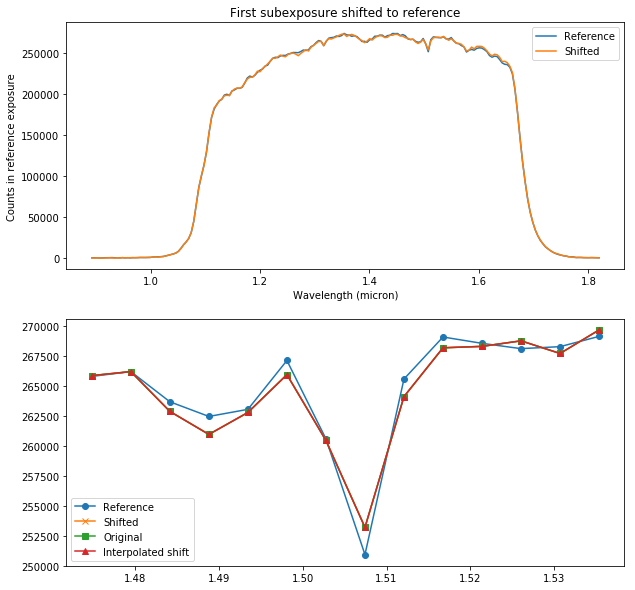

Shifted subexposure nr. 1 with 0.778569176794 pixels and shrunk 0.133994700236 percent.
Shifted subexposure nr. 2 with 0.74650973327 pixels and shrunk 0.177967969085 percent.
Shifted subexposure nr. 3 with 0.67441358566 pixels and shrunk 0.240028929579 percent.
Shifted subexposure nr. 4 with 0.497449639604 pixels and shrunk 0.316649413067 percent.
Shifted subexposure nr. 5 with 0.406355506915 pixels and shrunk 0.374887525529 percent.
Shifted subexposure nr. 6 with 0.276068730331 pixels and shrunk 0.447503289885 percent.
Shifted subexposure nr. 7 with 0.187336256121 pixels and shrunk 0.514619930549 percent.
Shifted subexposure nr. 8 with 0.0983589461223 pixels and shrunk 0.584615342736 percent.
Shifted subexposure nr. 9 with 0.0746787558708 pixels and shrunk 0.633811768711 percent.
Shifted subexposure nr. 10 with -0.0204953099561 pixels and shrunk 0.706627207393 percent.
Shifted subexposure nr. 11 with -0.105565442666 pixels and shrunk 0.767787694149 percent.


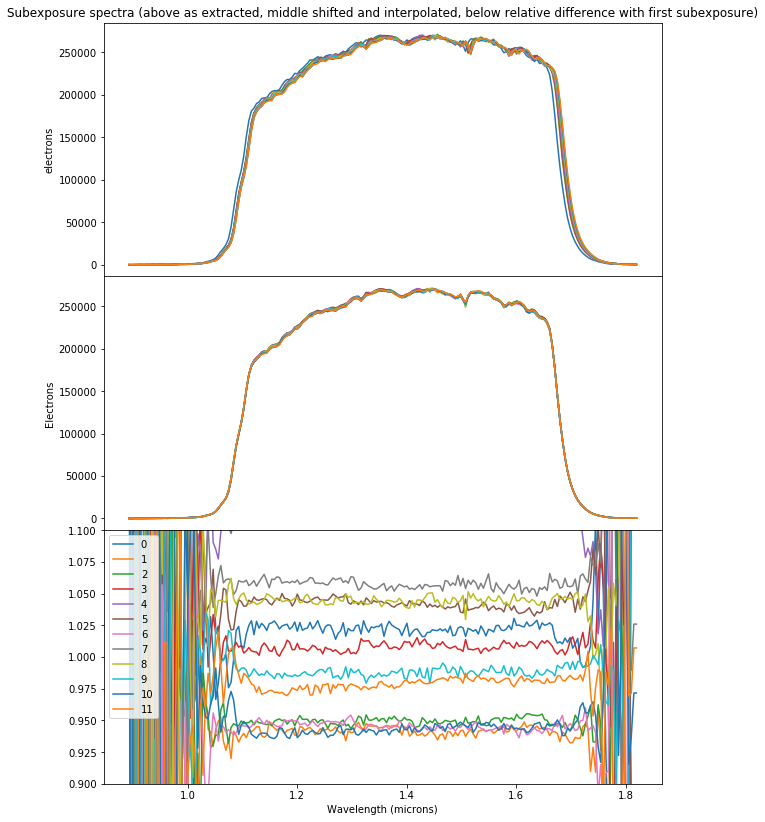

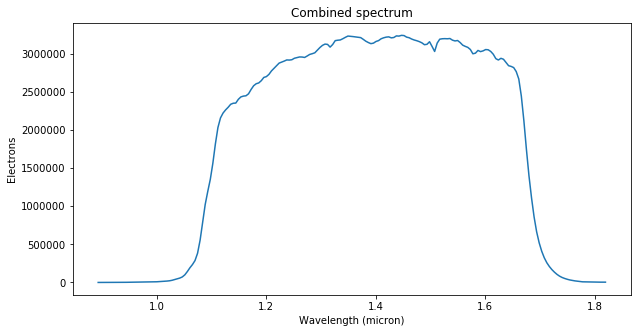

Saving spectrum to /Users/bob/Documents/PhD/WASP-80/output/idn203s4q_spec.txt
reduced 2458703.8281306657
Saving subexposure spectra to /Users/bob/Documents/PhD/WASP-80/output/idn203s4q_subs_spec.txt
Extraction took 14.31s
########################################
###########Finished Extraction##########
########################################
########################################
############Started Reduction##########
########################################
Data reduction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn204zyq_ima.fits
For configuration, see pipeline conf file: /Users/bob/Documents/PhD/WASP-80/transmission_reduction.conf
Forward scan
Catalogue used: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn204zxq_flt_1.cat
Direct Image name: idn204zxq
catalogue /Users/bob/Documents/PhD/WASP-80/HSTdata/idn204zxq_flt_1.cat
Catalogue file: idn204zxq_ima.fits
########################
Direct image location of (138.9945873,106.231649116)
FWHM of this subexpo

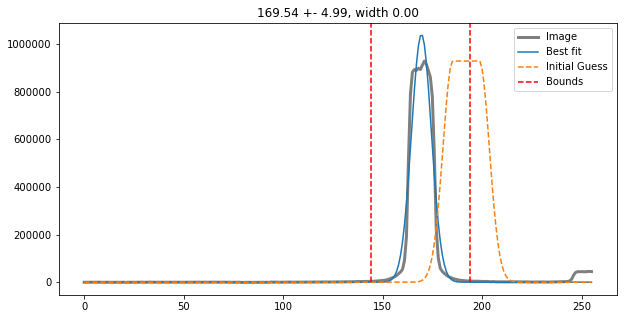

using a PHOENIX stellar model
amplitude and displacement on first order: -15.894192877112163 -121.60458132871156


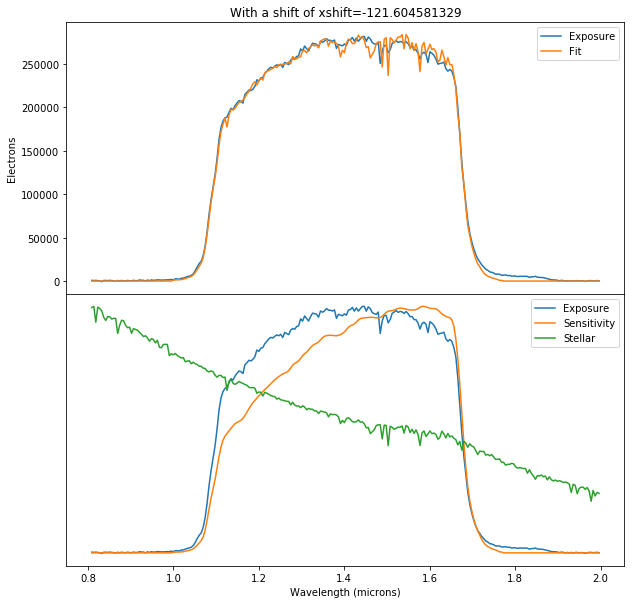

Applied an xshift of -121.604581329 pix from a comparison to a stellar spectrum
Initial xpix is 17 and shift_in_x: -121.604581329
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 62.34 pix
FWHM of this subexposure is  13.31279725068461


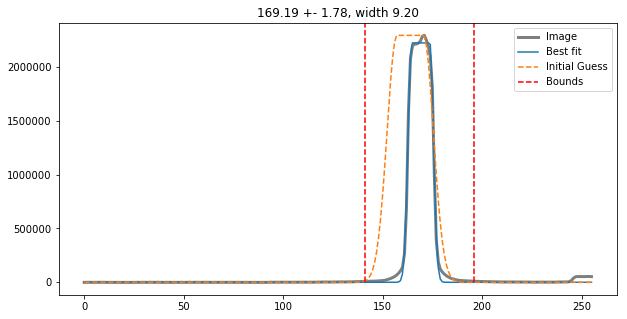

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.375233667852058


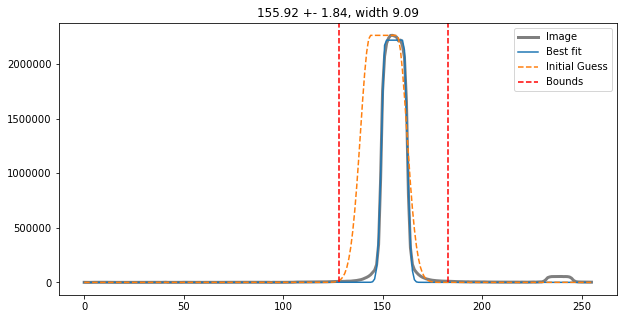

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.381198023199829


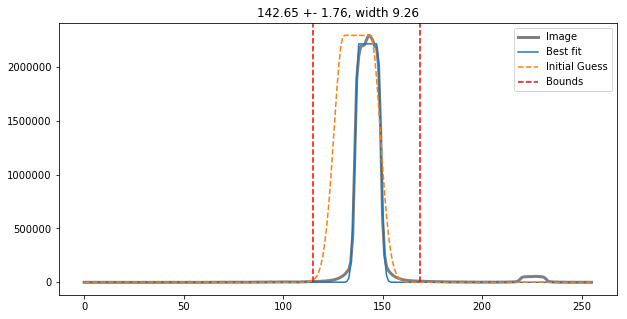

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.383198876390551


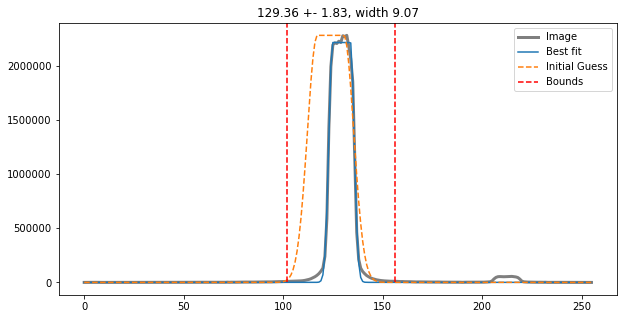

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.446018337677955


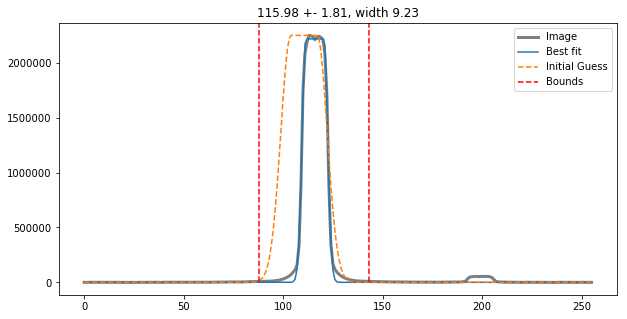

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.535343849786287


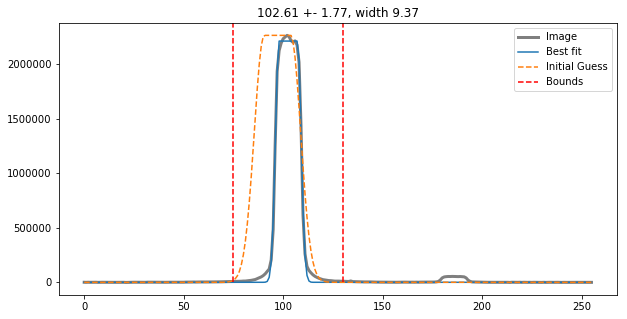

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.443871905798005


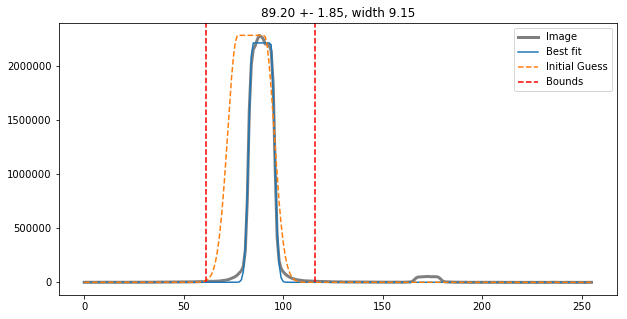

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.556227738678373


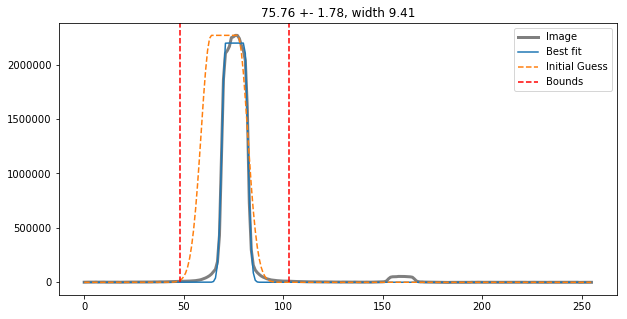

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.537631504873303


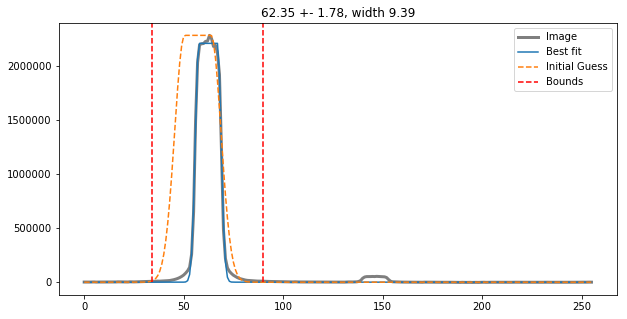

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.539678787604899


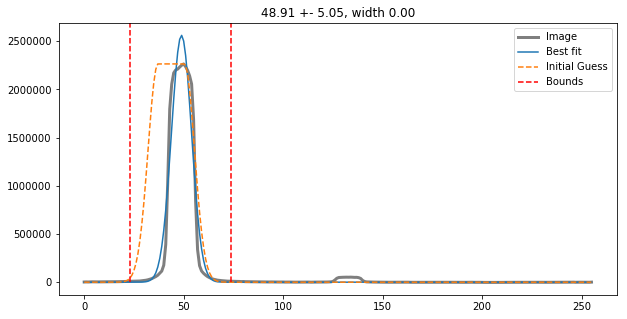

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.620717588673227


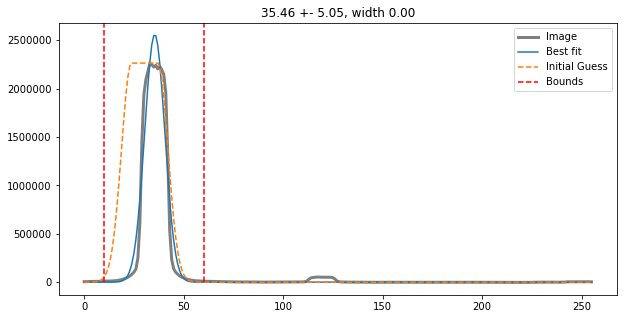

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.509010712539688


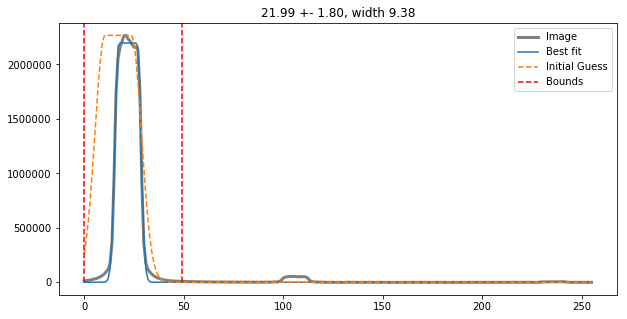

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
The final xpix is 17
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 62.34 pix
FWHM of this subexposure is  13.31279725068461


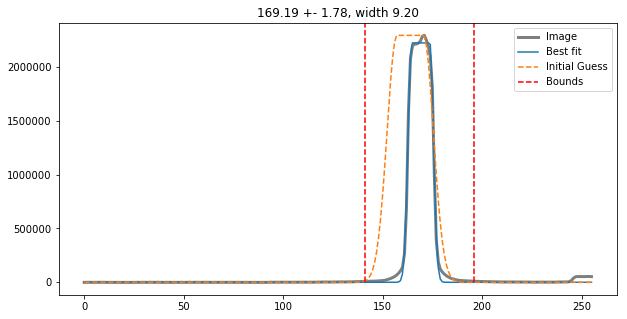

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.375233667852058


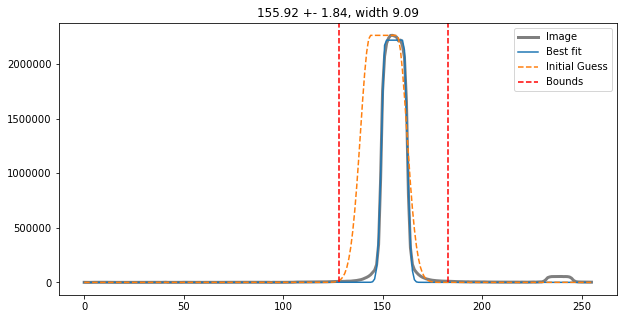

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.381198023199829


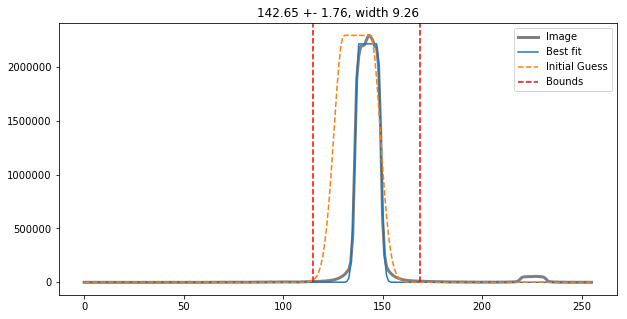

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.383198876390551


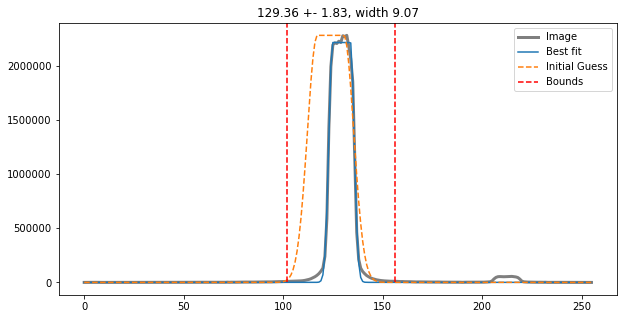

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.446018337677955


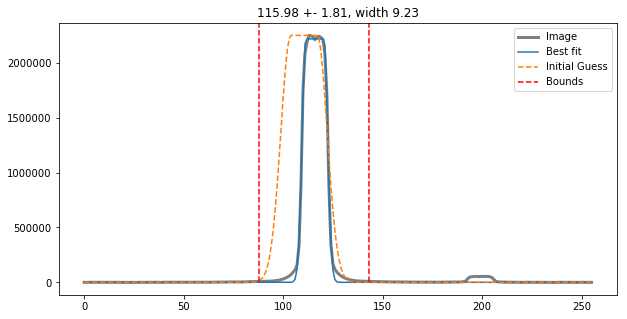

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.535343849786287


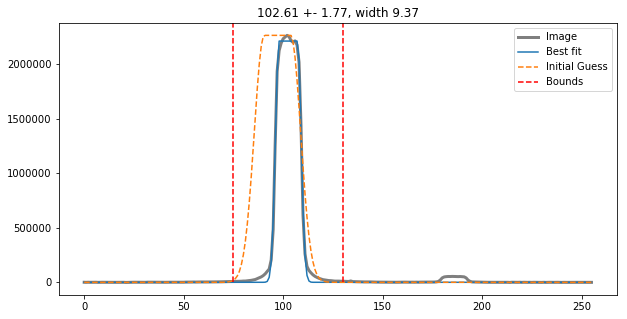

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.443871905798005


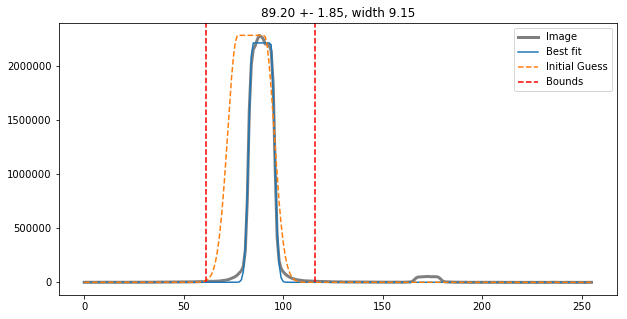

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.556227738678373


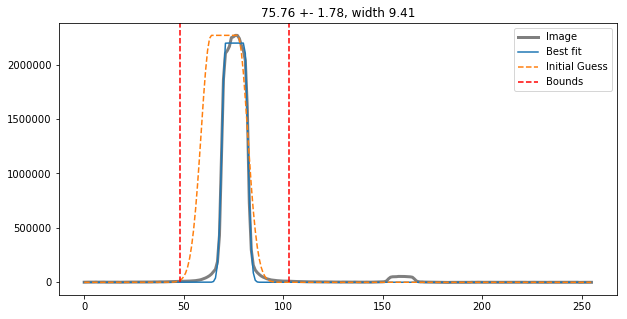

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.537631504873303


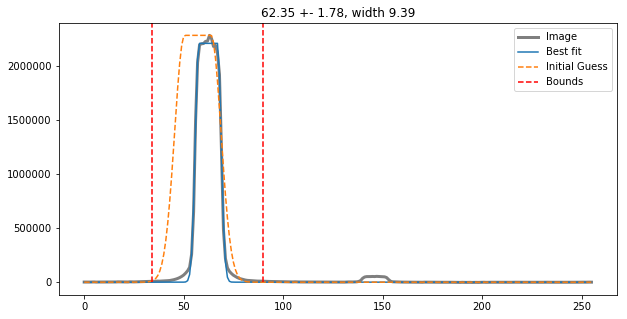

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.539678787604899


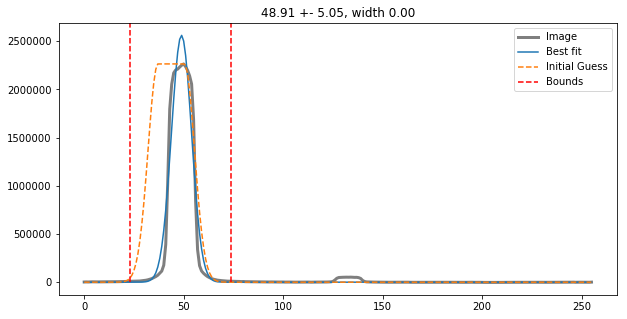

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.620717588673227


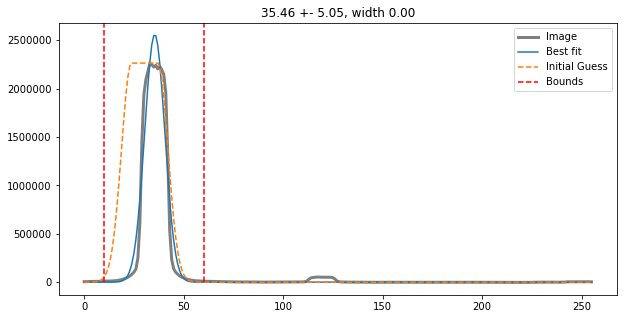

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.509010712539688


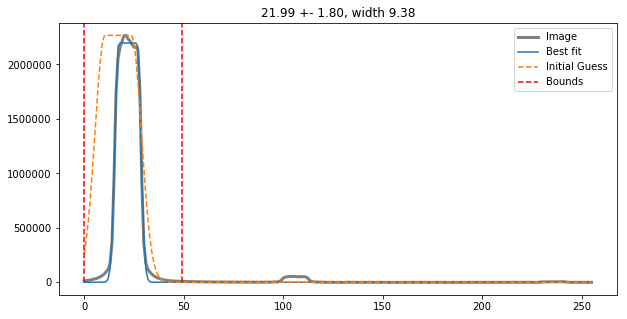

SHIFTINX -121.60458132871156
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
nr_CRs, Lows 6 0
nr_CRs, Lows 16 4
nr_CRs, Lows 7 0
nr_CRs, Lows 3 0
nr_CRs, Lows 5 0
nr_CRs, Lows 9 0
nr_CRs, Lows 6 0
nr_CRs, Lows 7 0
nr_CRs, Lows 5 0
nr_CRs, Lows 9 0
nr_CRs, Lows 8 1
nr_CRs, Lows 16 1
88.435623
88.435623 88.435623
Saving reduced file to /Users/bob/Documents/PhD/WASP-80/output/
Saving reduced exposure to /Users/bob/Documents/PhD/WASP-80/output/idn204zyq_red.fits...
Reduction took 11.15s
########################################
###########Finished Reduction###########
########################################
########################################
############Started Extraction##########
########################################
Spectral extraction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn204zyq_ima.fits
For configuration, see conf file: /Users/bob/Documents/PhD/WASP-80/transmission_extraction.conf
Forward scan
Extracting from subexposure 1
Extrac

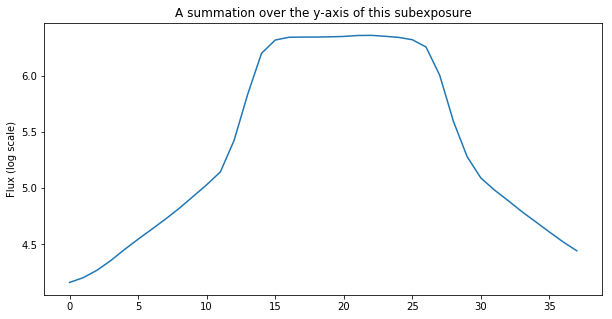

The difference between the two edges (for a 5-pixel bin for all subexps is): 7509.265625
This value may not be larger than  2048.6342116964984  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Using flux for variance estimate
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


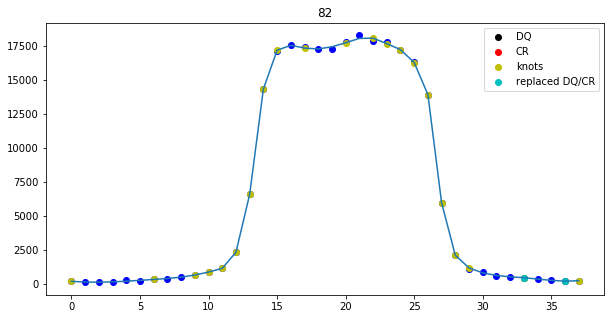

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


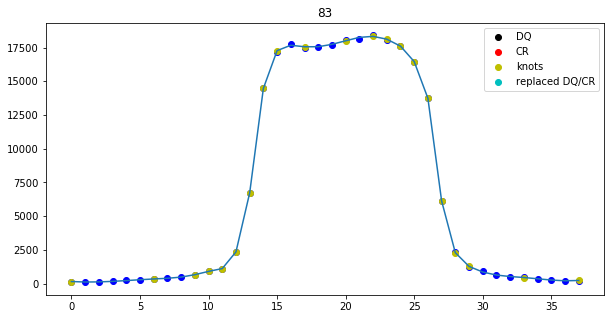

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


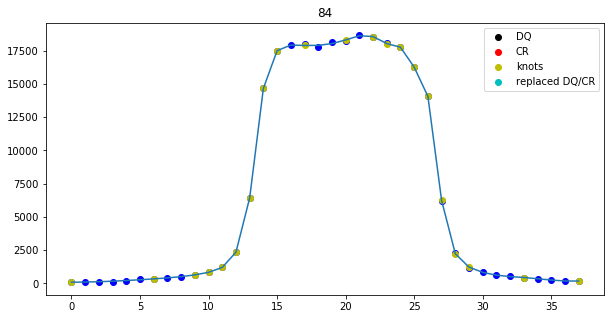

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


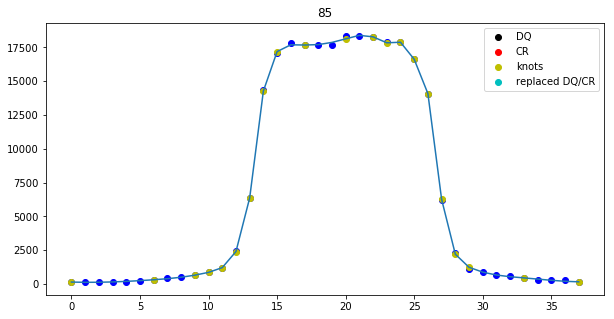

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


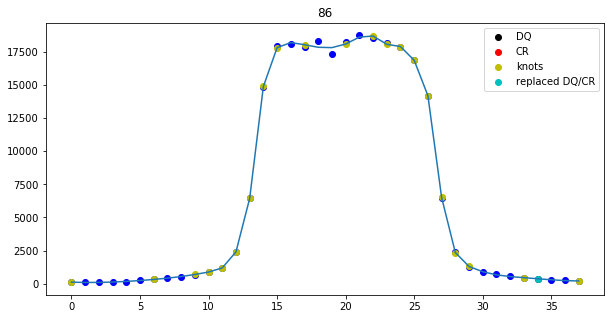

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 2
nr. of CRs 797
Spectrum located at pixel 117 in spatial direction
subexp 155.92251642847074 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 155 for exposure 1
1 12


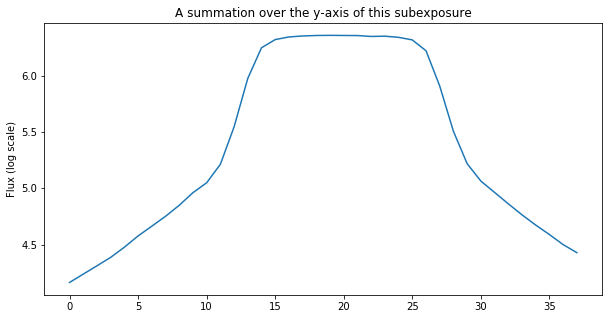

The difference between the two edges (for a 5-pixel bin for all subexps is): 6800.8828125
This value may not be larger than  2049.1778513995964  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


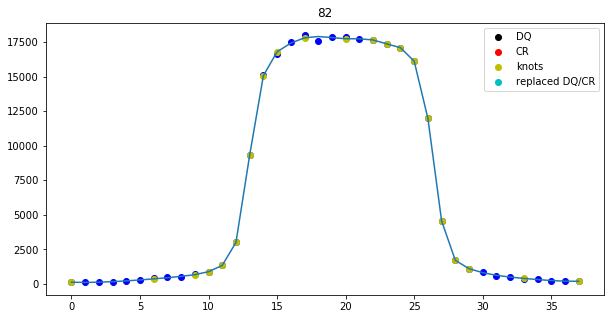

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


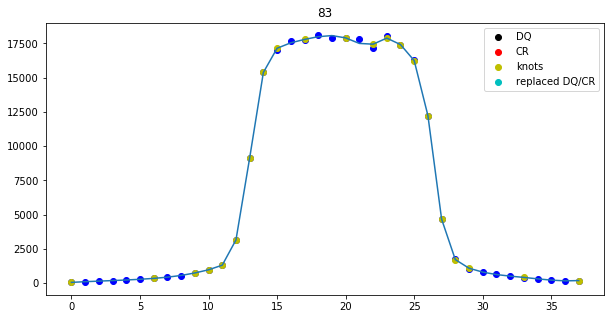

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


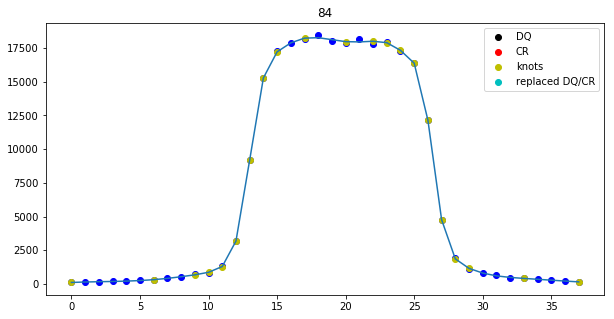

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


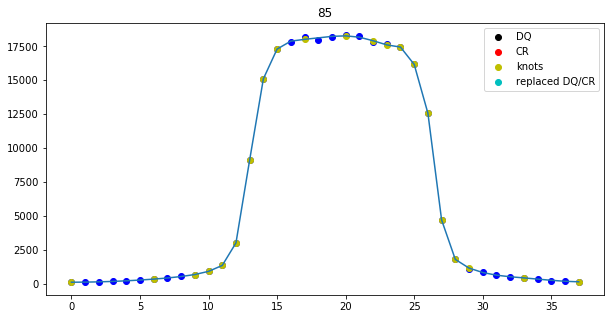

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


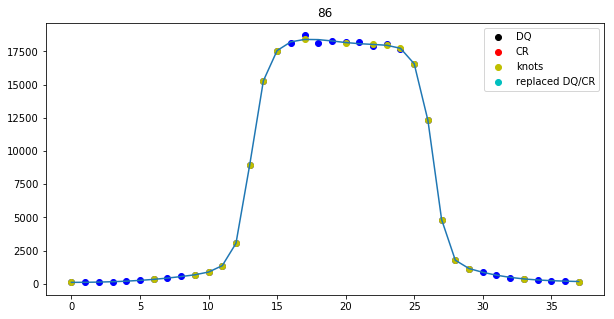

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 3
nr. of CRs 794
Spectrum located at pixel 117 in spatial direction
subexp 142.65106586946652 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 142 for exposure 2
2 12


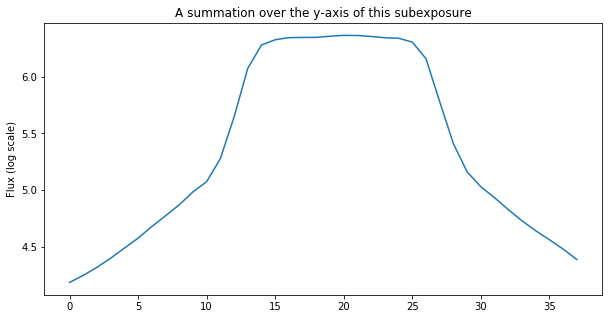

The difference between the two edges (for a 5-pixel bin for all subexps is): 5959.849609375
This value may not be larger than  2048.399765670754  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


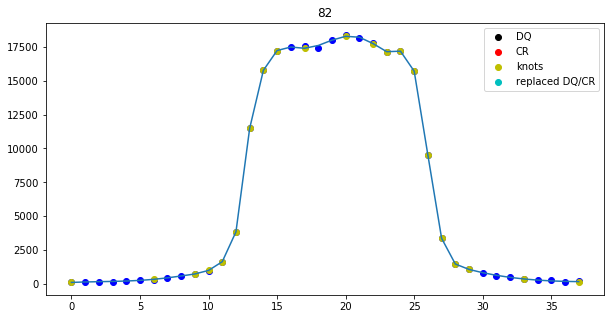

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


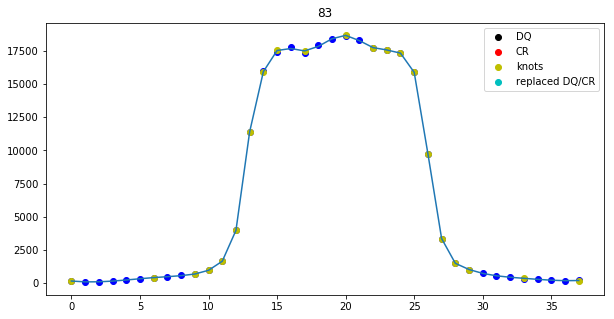

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


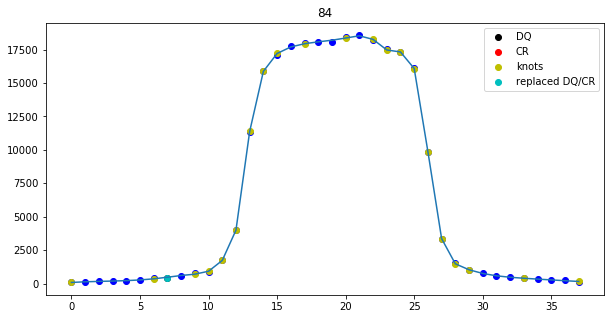

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


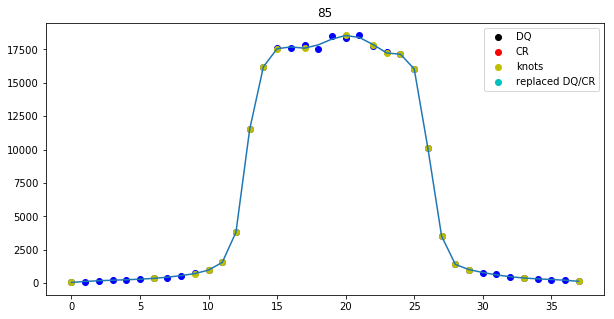

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


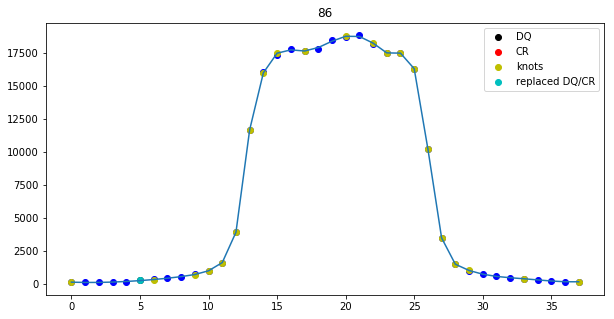

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 4
nr. of CRs 781
Spectrum located at pixel 117 in spatial direction
subexp 129.3557432060543 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 128 for exposure 3
3 12


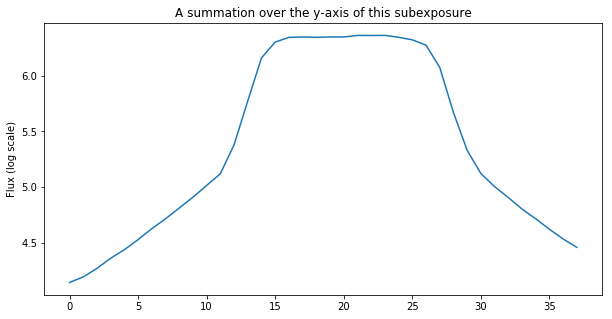

The difference between the two edges (for a 5-pixel bin for all subexps is): 8108.3859375
This value may not be larger than  2048.1907463254815  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


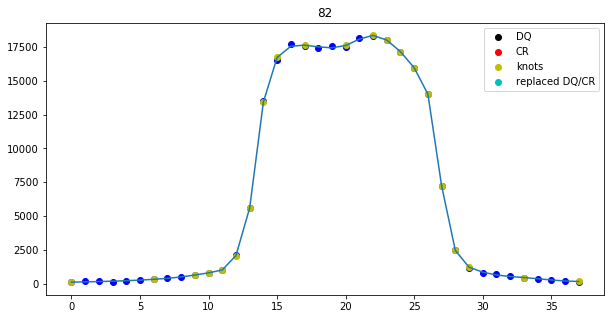

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


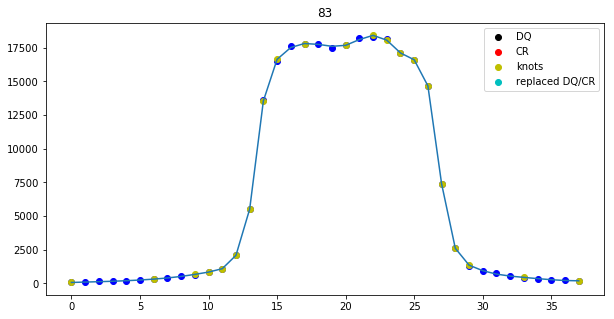

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


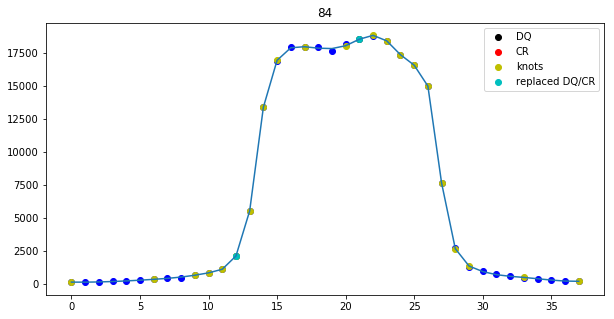

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


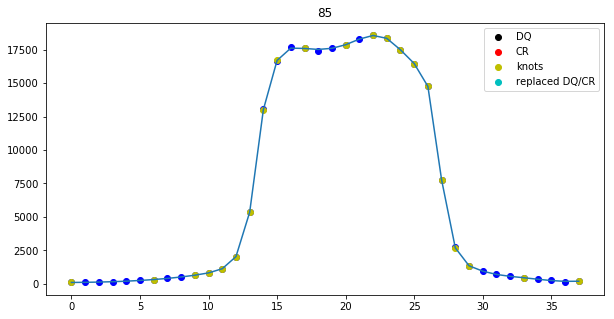

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


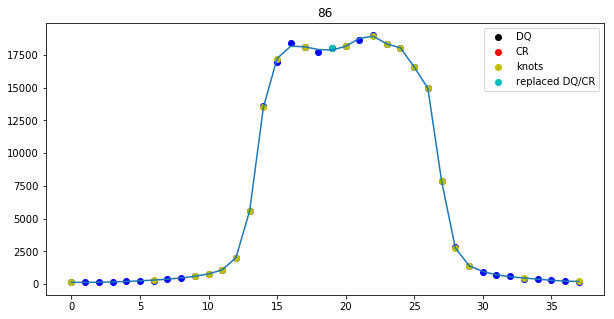

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 5
nr. of CRs 779
Spectrum located at pixel 117 in spatial direction
subexp 115.98402555301847 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 115 for exposure 4
4 12


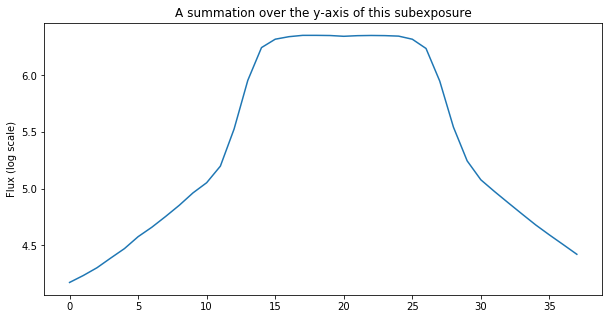

The difference between the two edges (for a 5-pixel bin for all subexps is): 6908.496875
This value may not be larger than  2051.174232807475  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


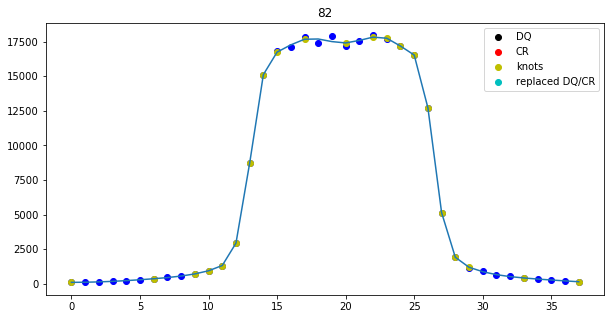

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


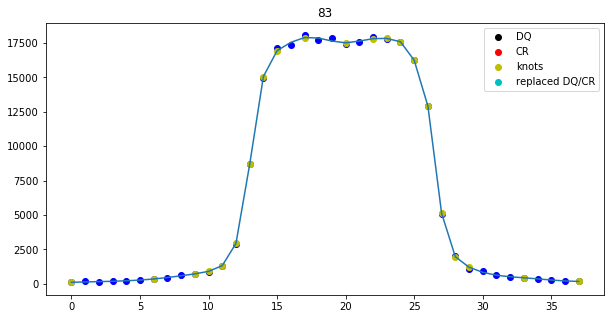

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


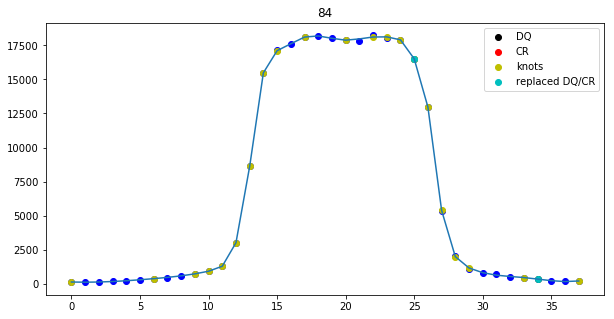

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


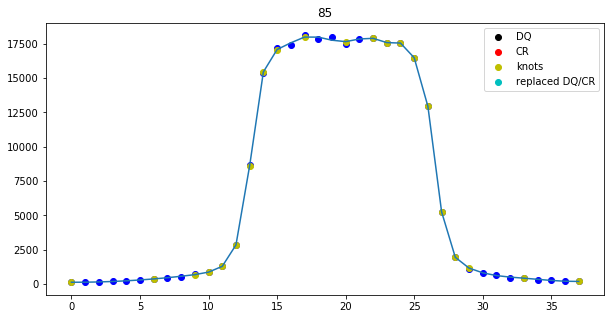

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


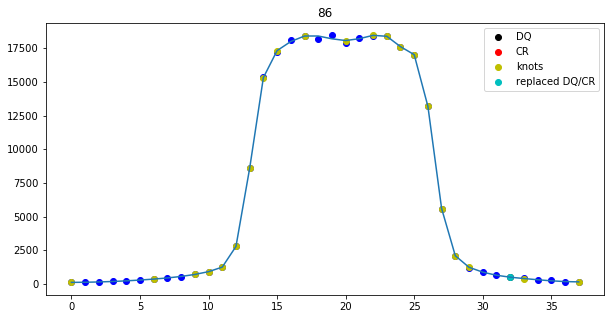

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 6
nr. of CRs 785
Spectrum located at pixel 117 in spatial direction
subexp 102.60627989348423 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 101 for exposure 5
5 12


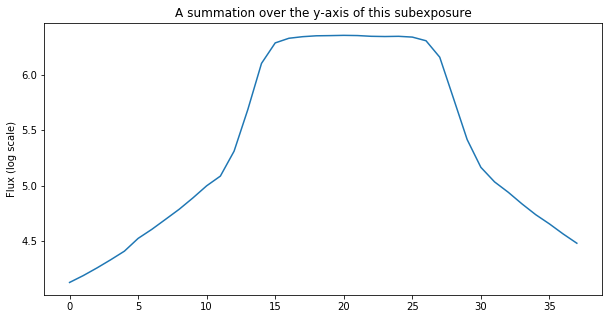

The difference between the two edges (for a 5-pixel bin for all subexps is): 9306.515625
This value may not be larger than  2047.2123485364189  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


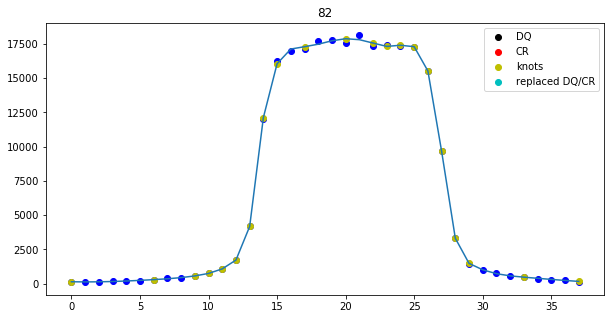

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


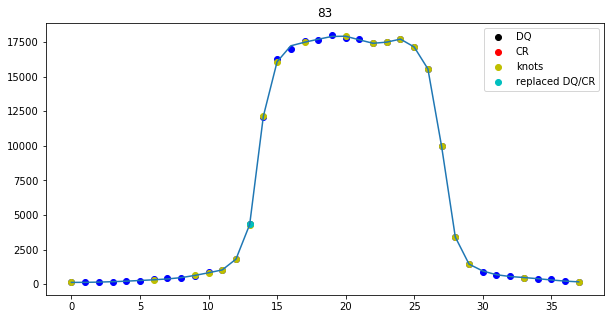

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


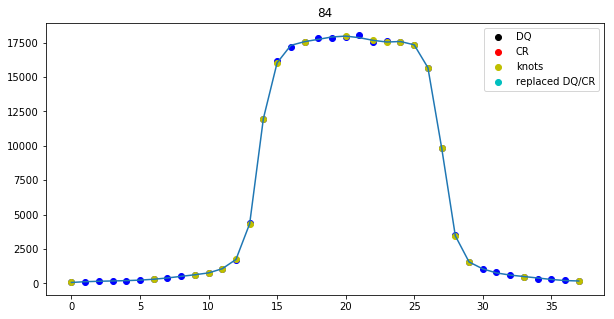

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


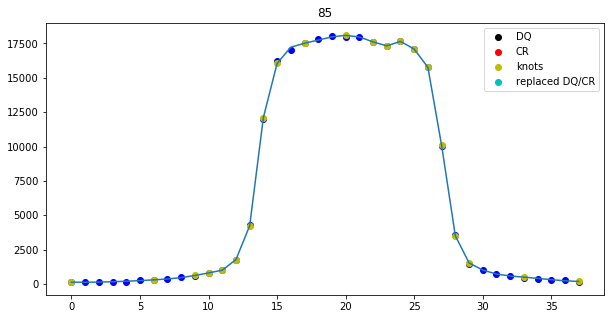

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


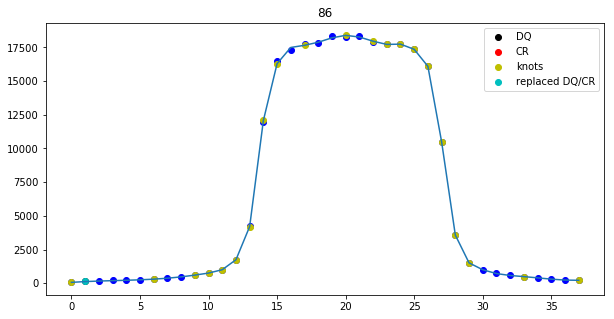

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 7
nr. of CRs 786
Spectrum located at pixel 117 in spatial direction
subexp 89.19505286997105 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 88 for exposure 6
6 12


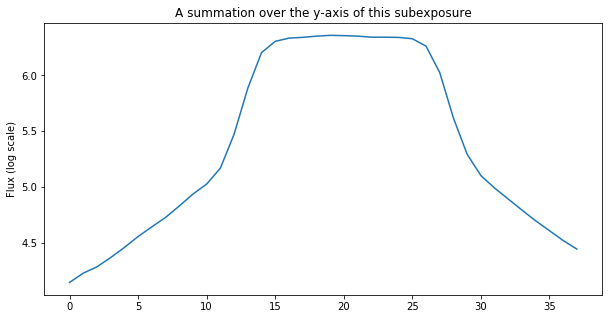

The difference between the two edges (for a 5-pixel bin for all subexps is): 7660.6265625
This value may not be larger than  2049.009191454901  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


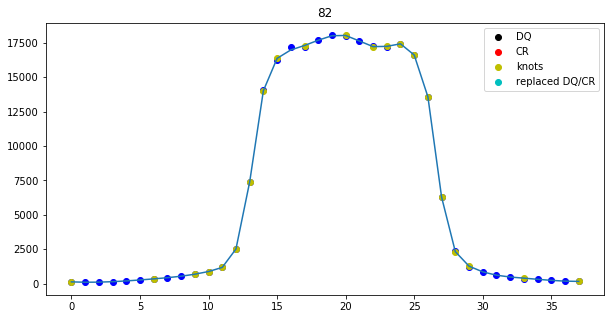

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


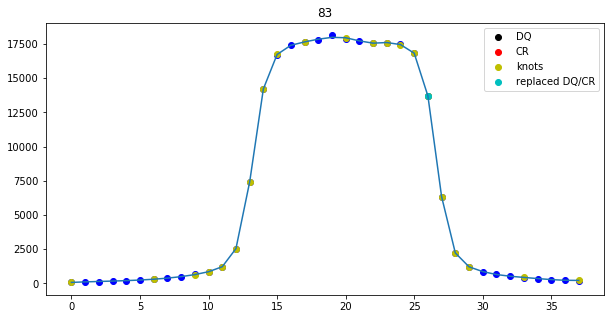

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


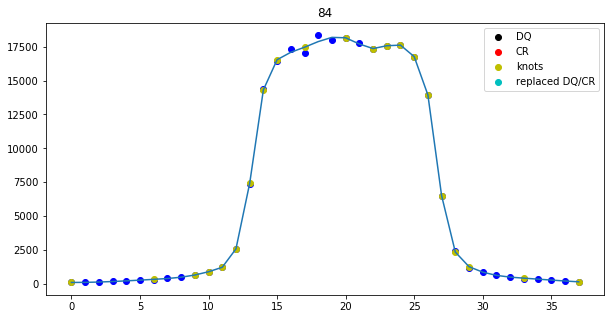

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


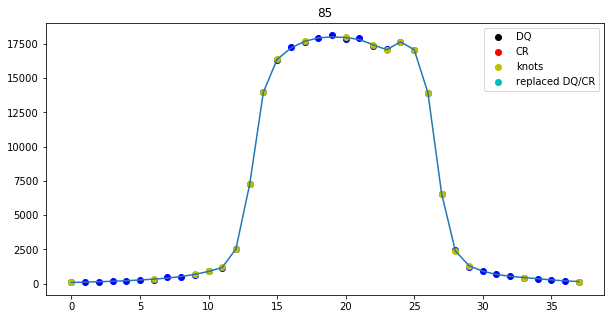

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


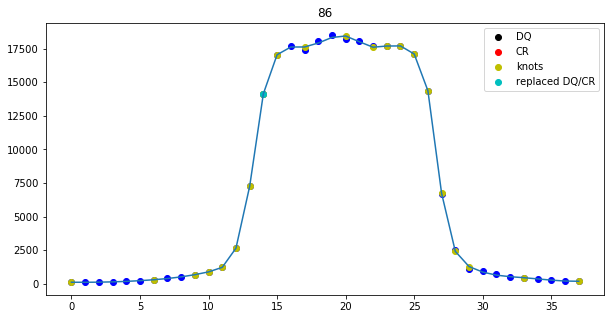

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 8
nr. of CRs 784
Spectrum located at pixel 117 in spatial direction
subexp 75.76422982169495 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 75 for exposure 7
7 12


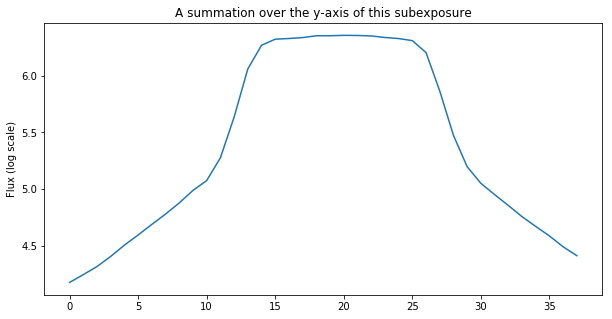

The difference between the two edges (for a 5-pixel bin for all subexps is): 6377.507421875
This value may not be larger than  2048.081248388354  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


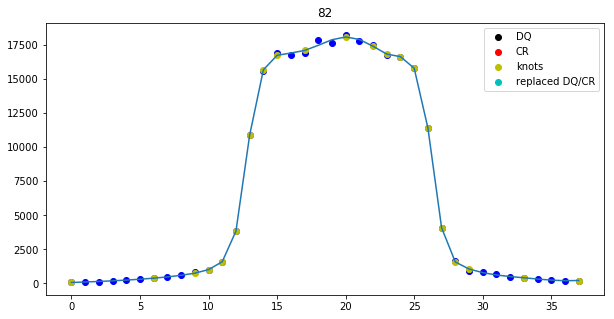

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


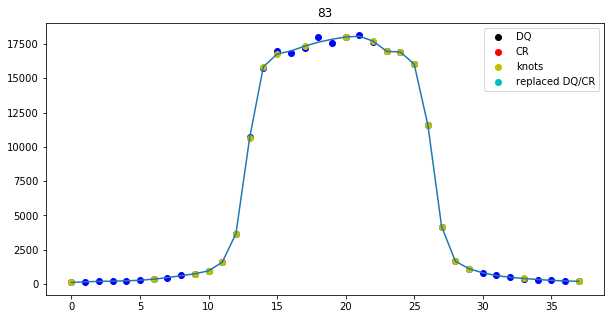

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


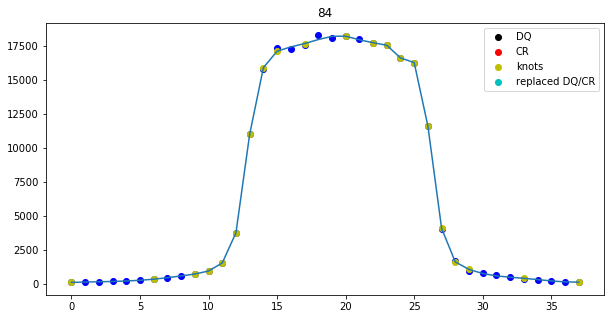

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


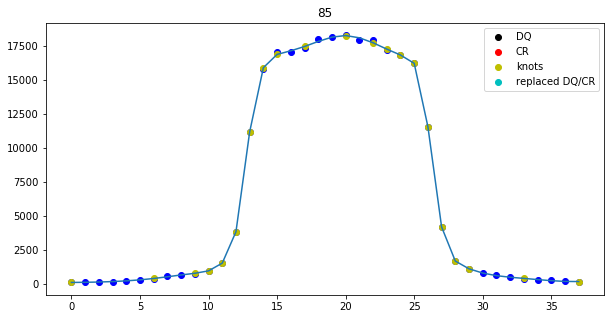

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


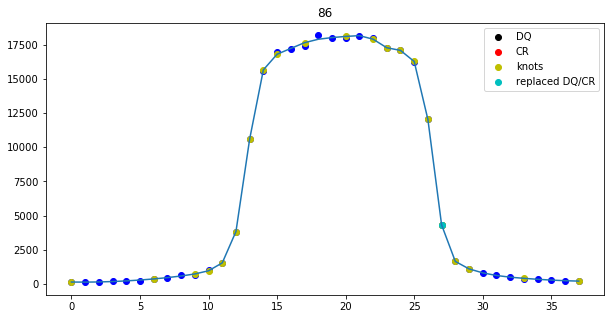

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 9
nr. of CRs 783
Spectrum located at pixel 117 in spatial direction
subexp 62.35202346065098 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 61 for exposure 8
8 12


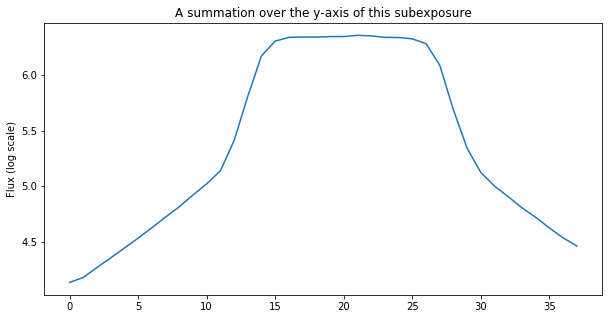

The difference between the two edges (for a 5-pixel bin for all subexps is): 8258.725
This value may not be larger than  2044.8194704341668  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


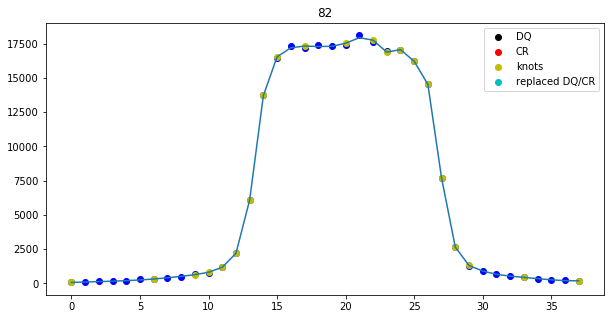

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


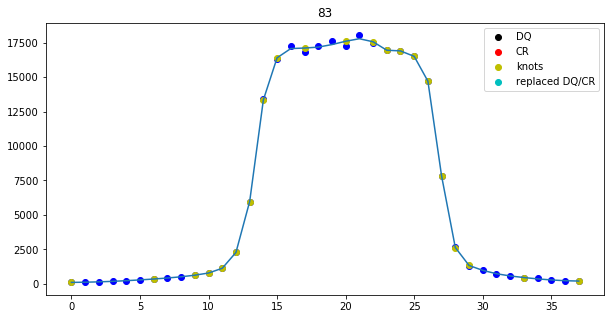

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


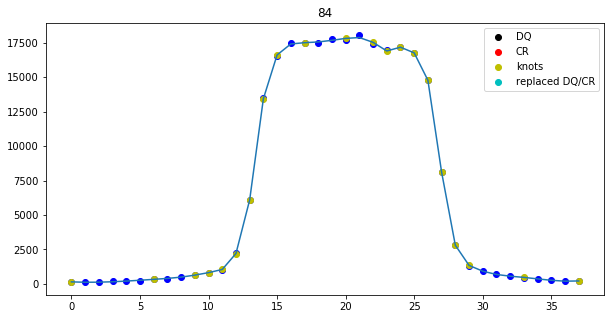

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


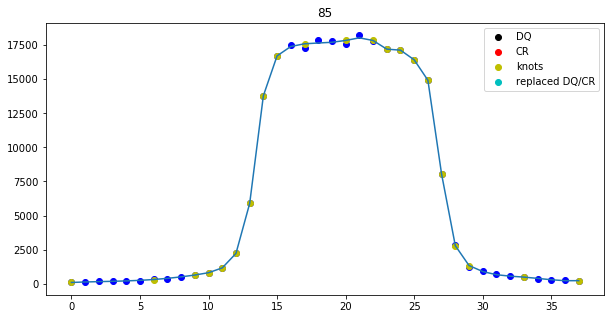

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


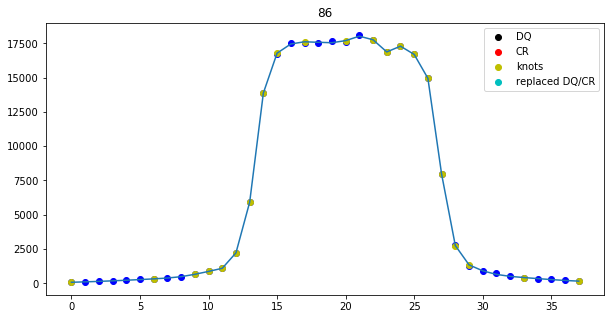

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 10
nr. of CRs 785
Spectrum located at pixel 117 in spatial direction
subexp 48.912135118035955 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 48 for exposure 9
9 12


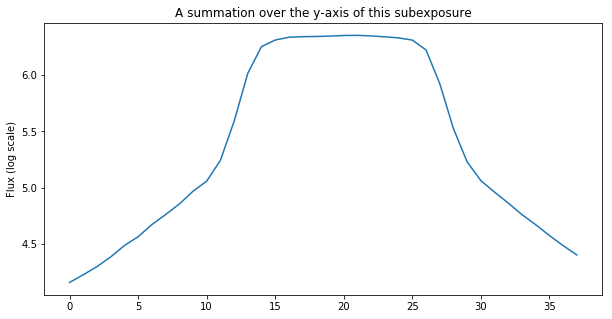

The difference between the two edges (for a 5-pixel bin for all subexps is): 6496.53515625
This value may not be larger than  2044.360959648108  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


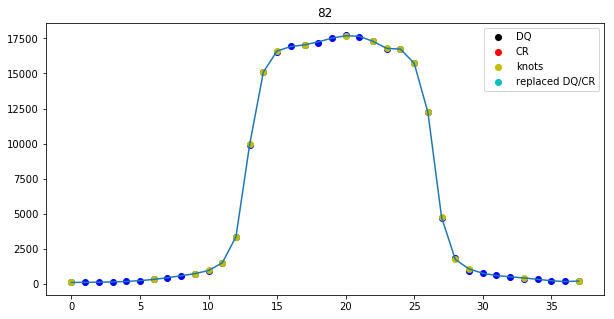

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


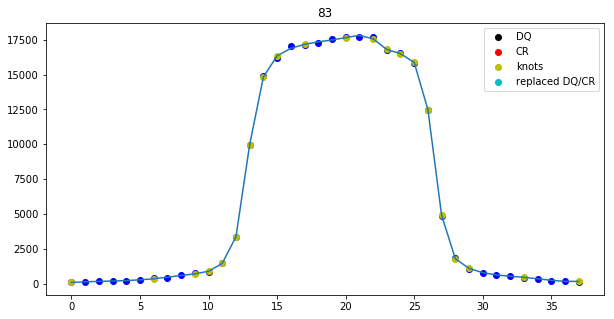

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


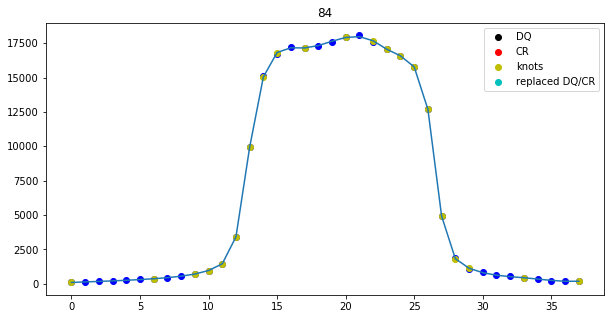

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


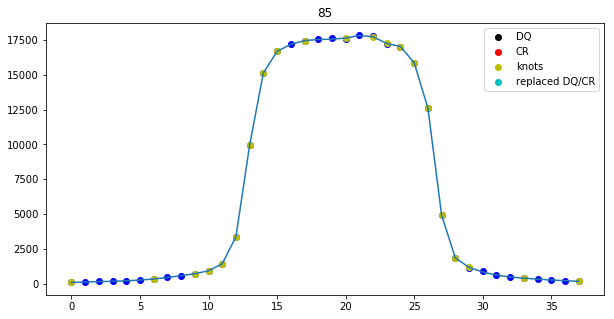

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


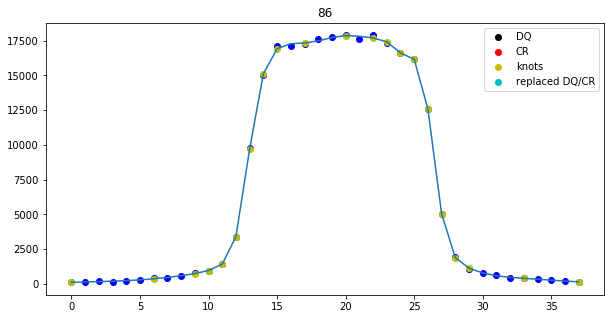

Optimal extraction fitting failed for columns: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 11
nr. of CRs 789
Spectrum located at pixel 117 in spatial direction
subexp 35.46268057761617 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 35 for exposure 10
10 12


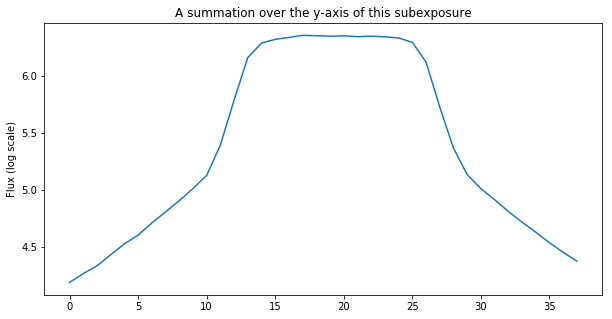

The difference between the two edges (for a 5-pixel bin for all subexps is): 5192.5890625
This value may not be larger than  2043.394365592049  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


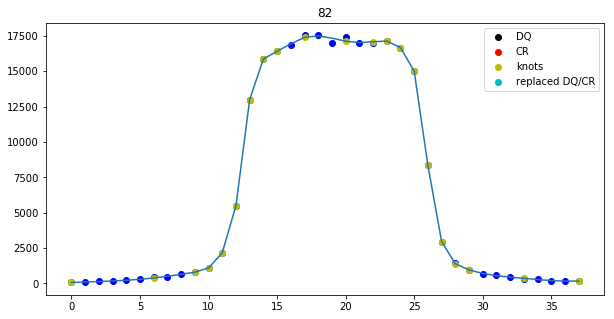

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


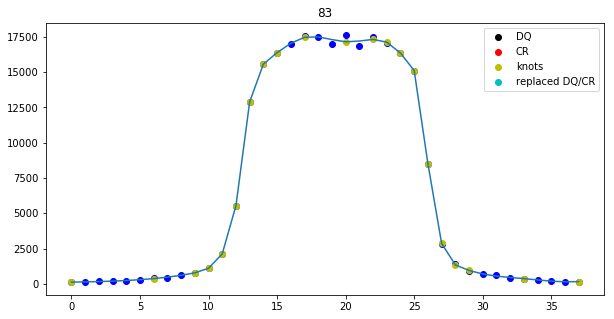

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


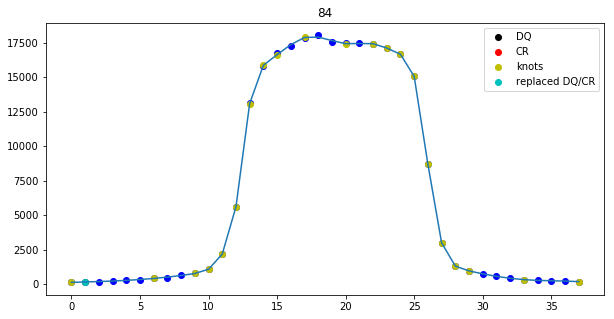

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


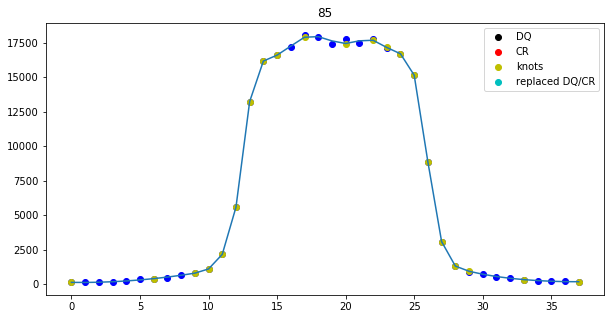

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


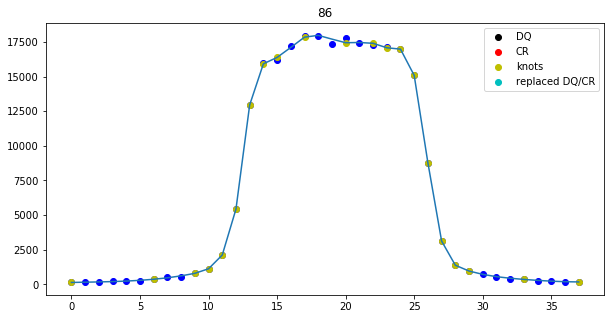

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 5, 6, 7, 8, 9, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 12
nr. of CRs 796
Spectrum located at pixel 117 in spatial direction
subexp 21.99394047840094 [168, 155, 142, 128, 115, 101, 88, 75, 61, 48, 35, 21]
ypix is 21 for exposure 11
11 12


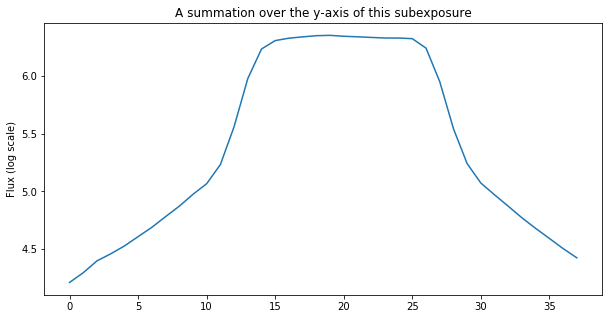

The difference between the two edges (for a 5-pixel bin for all subexps is): 6284.248046875
This value may not be larger than  2043.465031101177  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


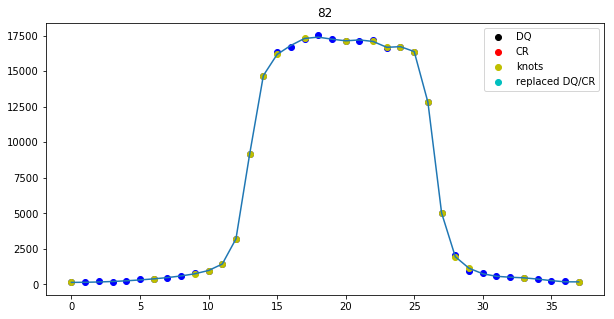

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


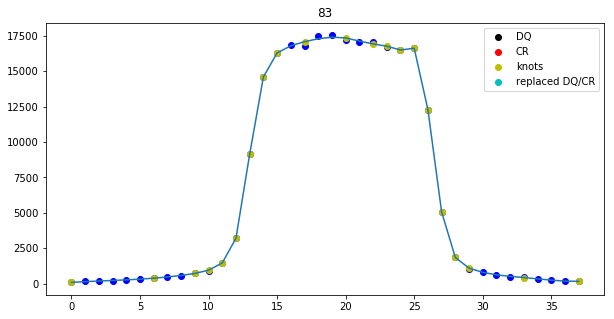

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


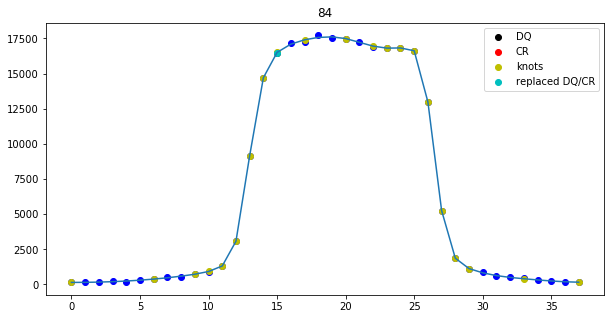

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


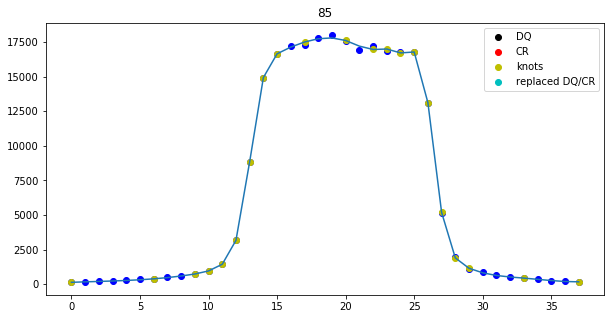

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


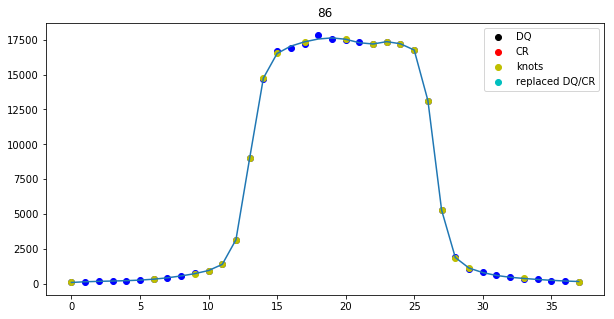

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE


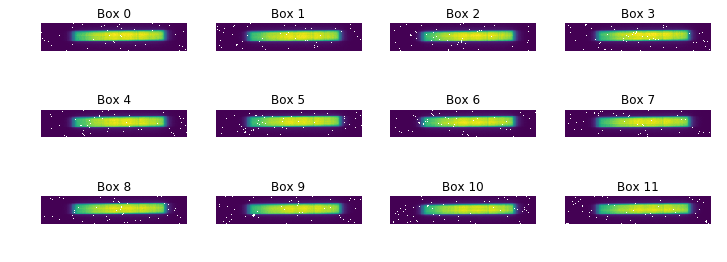

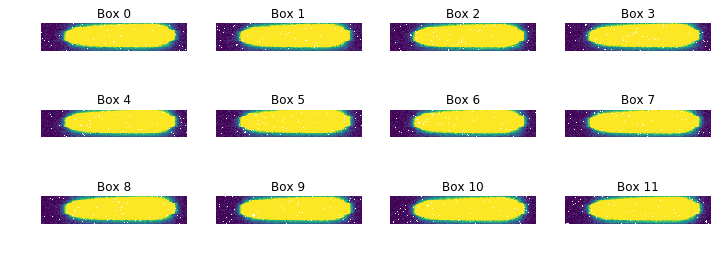

[ 0.00000000e+00  2.22044605e-16  2.22044605e-16  0.00000000e+00
 -1.11022302e-16  1.11022302e-16  3.33066907e-16 -1.11022302e-16
  3.33066907e-16 -1.11022302e-16  0.00000000e+00  2.22044605e-16
  1.11022302e-16  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.22044605e-16  0.00000000e+00 -1.11022302e-16  1.11022302e-16
  0.00000000e+00 -2.22044605e-16  1.11022302e-16  1.11022302e-16
 -2.22044605e-16 -2.22044605e-16  0.00000000e+00  0.00000000e+00
 -2.22044605e-16 -2.22044605e-16  2.22044605e-16 -4.44089210e-16
 -2.22044605e-16  4.44089210e-16  2.22044605e-16 -2.22044605e-16
  2.22044605e-16  2.22044605e-16  2.22044605e-16 -2.22044605e-16
  0.00000000e+00 -4.44089210e-16  2.22044605e-16  0.00000000e+00
 -2.22044605e-16  0.00000000e+00 -2.22044605e-16  0.00000000e+00
  2.22044605e-16  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -4.44089210e-16 -4.44089210e-16  0.00000000e+00 -2.22044605e-16
  0.00000000e+00 -2.22044605e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00  2.22044

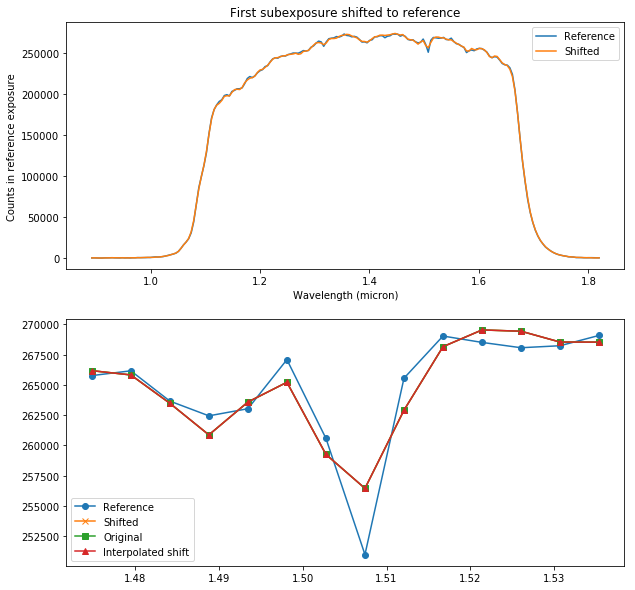

Shifted subexposure nr. 1 with 0.282686152803 pixels and shrunk 0.0933711956825 percent.
Shifted subexposure nr. 2 with 0.163323995699 pixels and shrunk 0.163480251768 percent.
Shifted subexposure nr. 3 with 0.010524309176 pixels and shrunk 0.244858843363 percent.
Shifted subexposure nr. 4 with -0.110224821033 pixels and shrunk 0.307940960354 percent.
Shifted subexposure nr. 5 with -0.271755648056 pixels and shrunk 0.387189568233 percent.
Shifted subexposure nr. 6 with -0.451739763293 pixels and shrunk 0.480794863809 percent.
Shifted subexposure nr. 7 with -0.484482222415 pixels and shrunk 0.528178715048 percent.
Shifted subexposure nr. 8 with -0.546324112963 pixels and shrunk 0.584929908781 percent.
Shifted subexposure nr. 9 with -0.665580386604 pixels and shrunk 0.66091992247 percent.
Shifted subexposure nr. 10 with -0.76112892078 pixels and shrunk 0.730571584171 percent.
Shifted subexposure nr. 11 with -0.88112313692 pixels and shrunk 0.801096980358 percent.


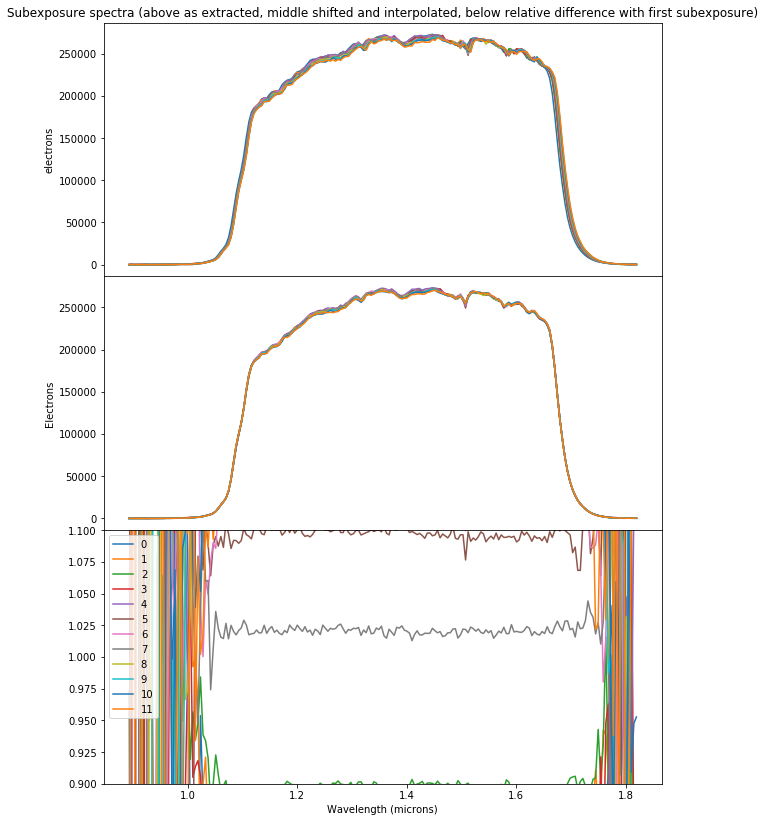

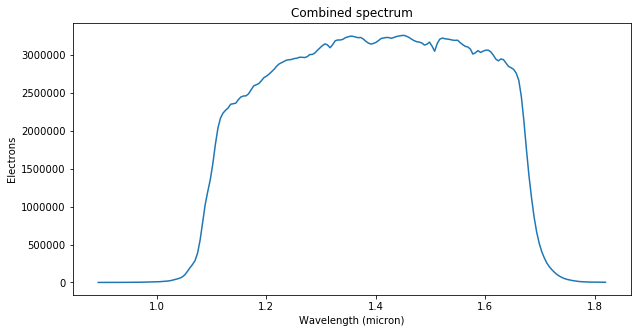

Saving spectrum to /Users/bob/Documents/PhD/WASP-80/output/idn204zyq_spec.txt
reduced 2458670.062360055
Saving subexposure spectra to /Users/bob/Documents/PhD/WASP-80/output/idn204zyq_subs_spec.txt
Extraction took 15.50s
########################################
###########Finished Extraction##########
########################################
########################################
############Started Reduction##########
########################################
Data reduction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn205o6q_ima.fits
For configuration, see pipeline conf file: /Users/bob/Documents/PhD/WASP-80/transmission_reduction.conf
Forward scan
Catalogue used: /Users/bob/Documents/PhD/WASP-80/HSTdata/idn205o5q_flt_1.cat
Direct Image name: idn205o5q
catalogue /Users/bob/Documents/PhD/WASP-80/HSTdata/idn205o5q_flt_1.cat
Catalogue file: idn205o5q_ima.fits
########################
Direct image location of (142.335948034,105.439695945)
FWHM of this subexp

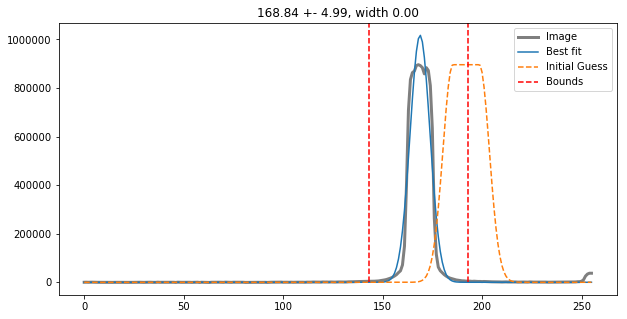

using a PHOENIX stellar model
amplitude and displacement on first order: -15.892903138860992 -121.94594478187165


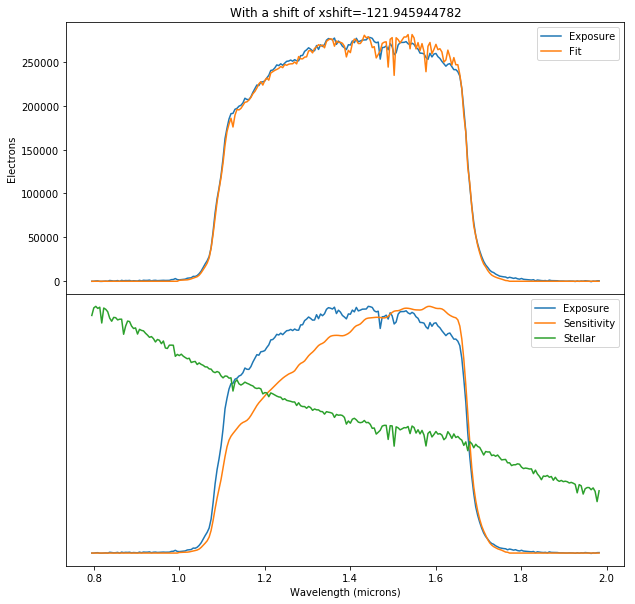

Applied an xshift of -121.945944782 pix from a comparison to a stellar spectrum
Initial xpix is 20 and shift_in_x: -121.945944782
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 62.34 pix
FWHM of this subexposure is  13.38754121340736


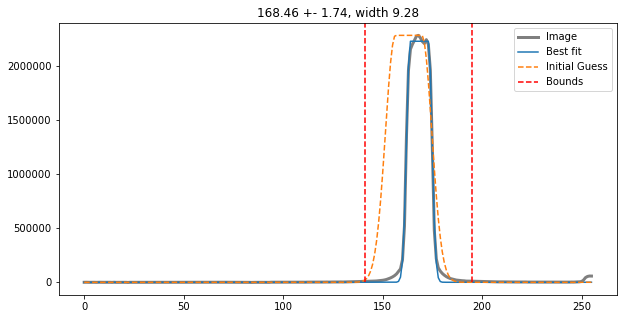

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.30844980429734


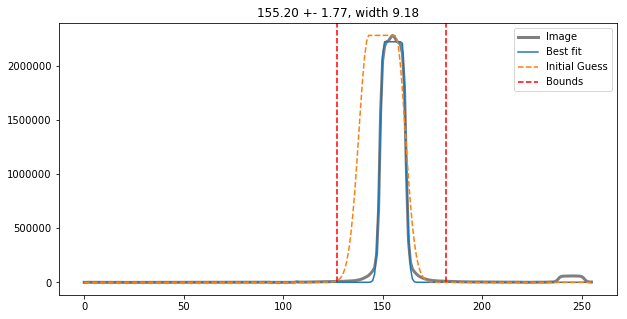

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.32985651196978


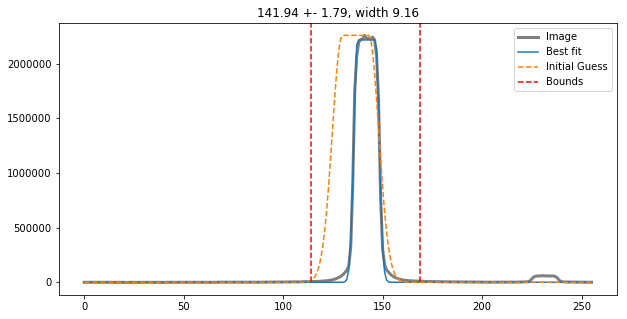

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.420731361375061


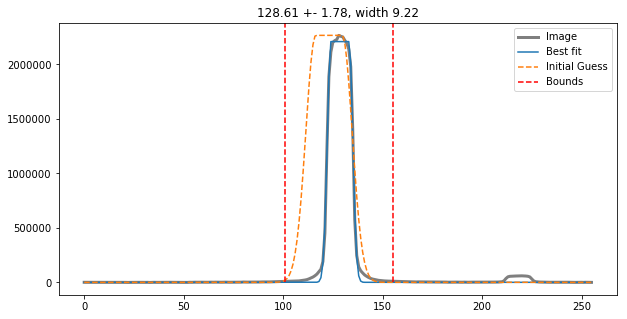

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.481763005161199


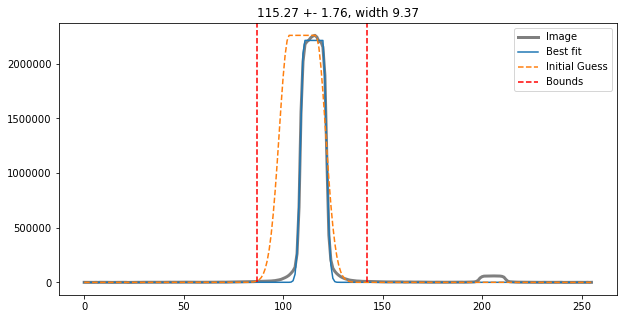

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.477318523452851


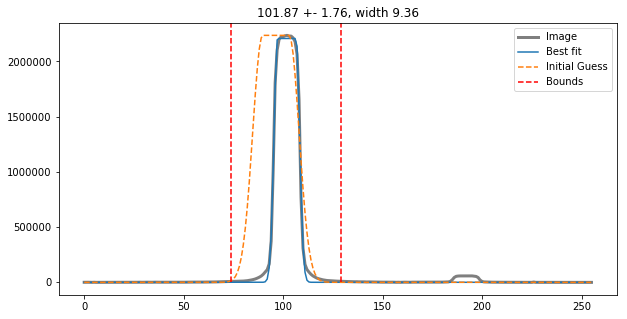

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.556753633310123


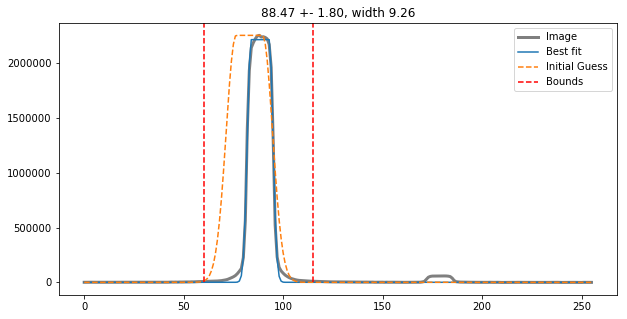

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.439491404505972


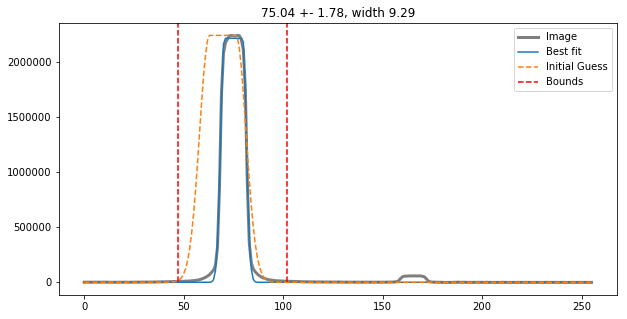

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.58888869088021


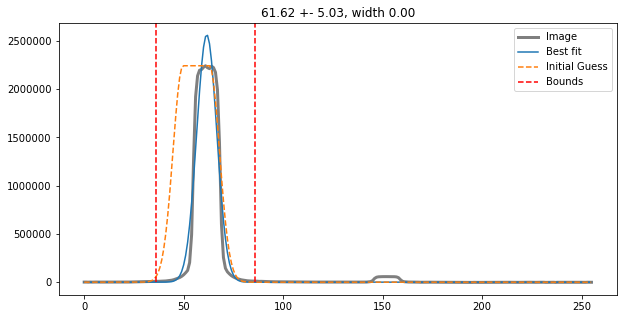

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.504533599706484


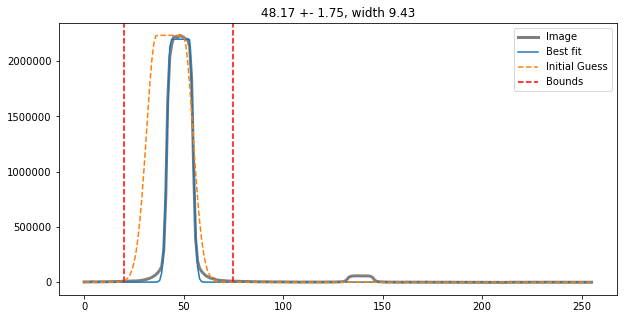

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.578192843031655


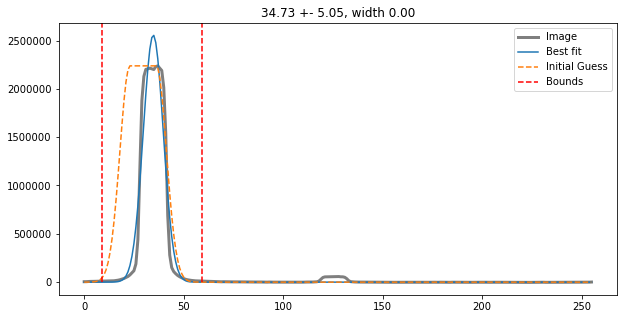

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.591132791944105


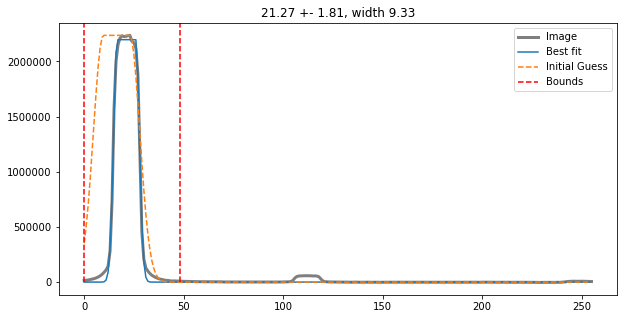

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
The final xpix is 20
120.0 1
default_scan=scan (r). Undo full scan
applying postarg offset to yguess, 62.34 pix
FWHM of this subexposure is  13.38754121340736


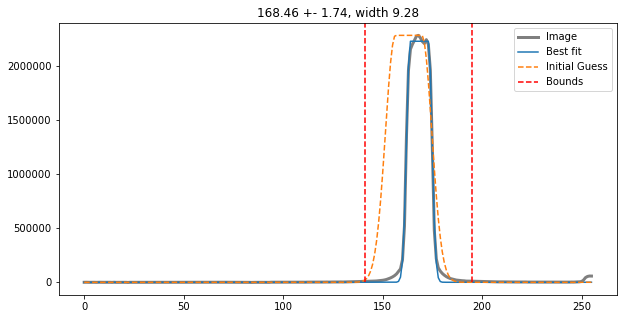

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.30844980429734


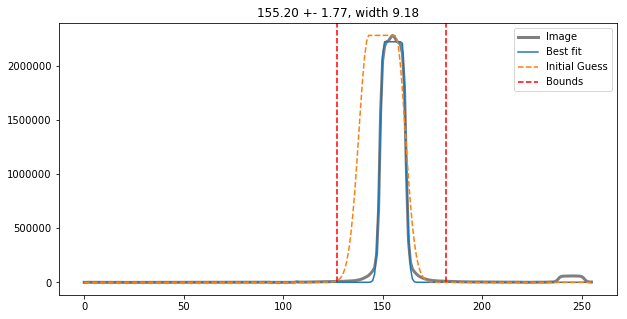

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.32985651196978


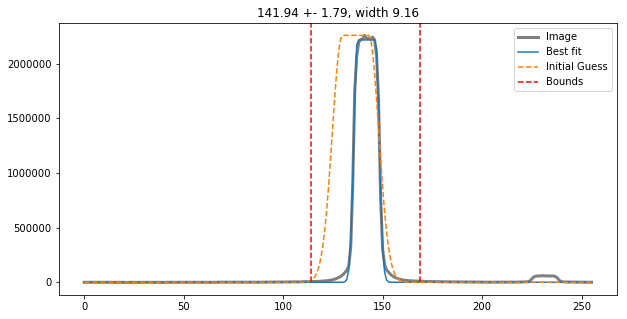

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.420731361375061


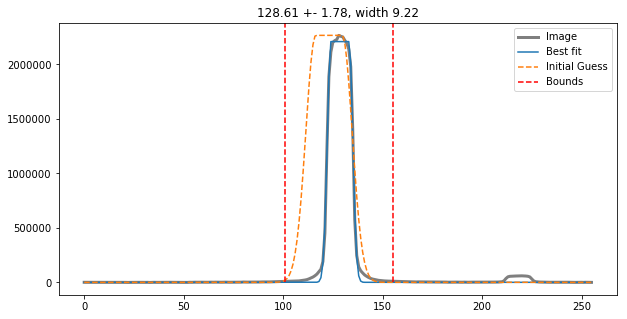

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.481763005161199


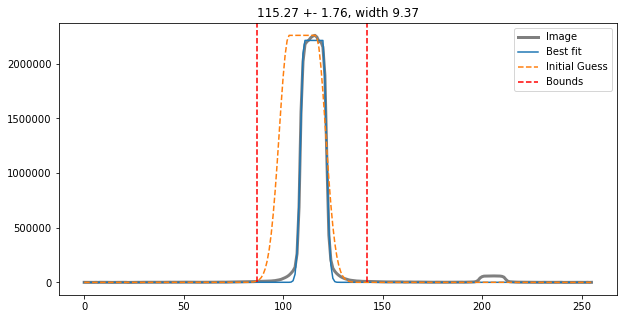

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.477318523452851


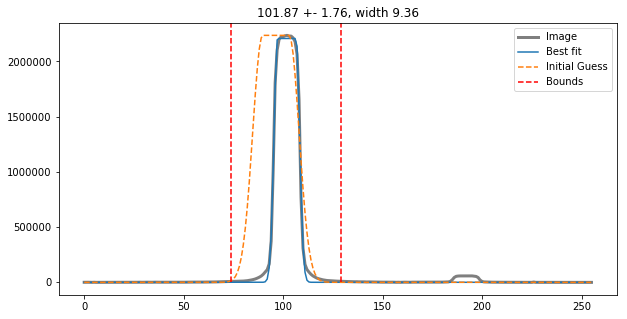

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.556753633310123


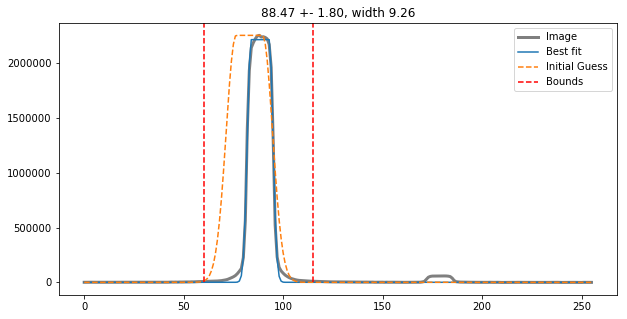

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.439491404505972


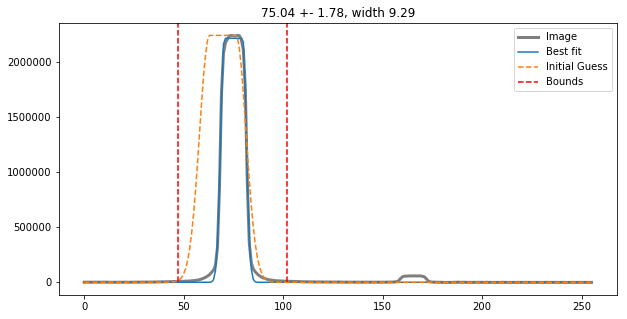

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.58888869088021


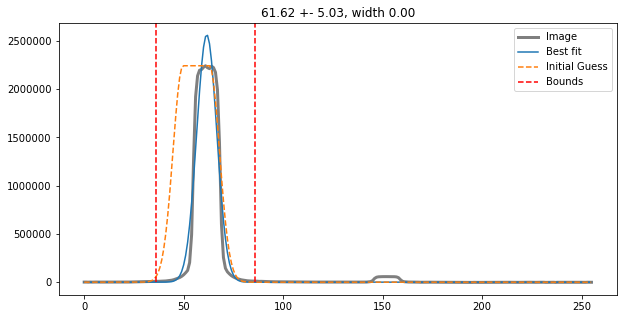

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.504533599706484


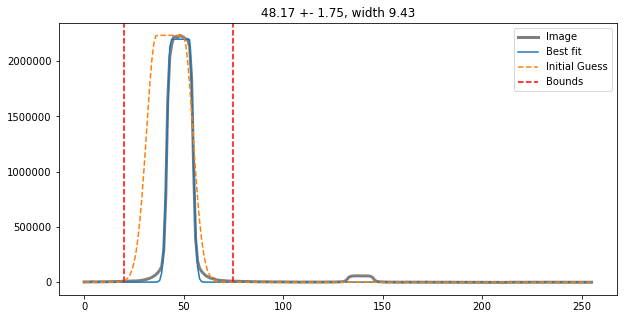

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.578192843031655


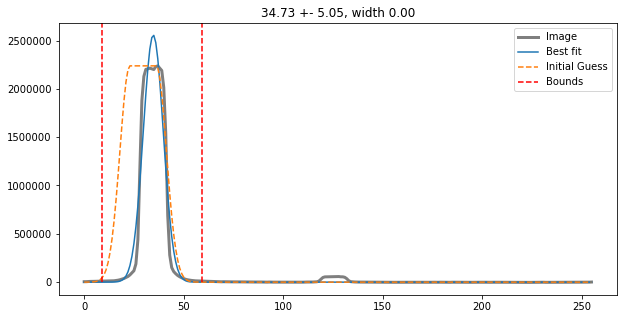

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
120.0 1
FWHM of this subexposure is  13.591132791944105


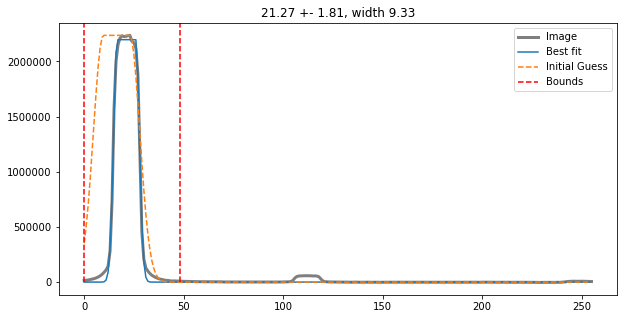

SHIFTINX -121.94594478187165
waveschange [1.3583653  1.36302318 1.36768108 1.37233899]
nr_CRs, Lows 9 0
nr_CRs, Lows 11 1
nr_CRs, Lows 14 0
nr_CRs, Lows 20 1
nr_CRs, Lows 12 0
nr_CRs, Lows 8 0
nr_CRs, Lows 7 0
nr_CRs, Lows 11 1
nr_CRs, Lows 1 0
nr_CRs, Lows 5 0
nr_CRs, Lows 8 0
nr_CRs, Lows 8 0
88.435623
88.435623 88.435623
Saving reduced file to /Users/bob/Documents/PhD/WASP-80/output/
Saving reduced exposure to /Users/bob/Documents/PhD/WASP-80/output/idn205o6q_red.fits...
Reduction took 12.13s
########################################
###########Finished Reduction###########
########################################
########################################
############Started Extraction##########
########################################
Spectral extraction pipeline performed on exposure /Users/bob/Documents/PhD/WASP-80/HSTdata/idn205o6q_ima.fits
For configuration, see conf file: /Users/bob/Documents/PhD/WASP-80/transmission_extraction.conf
Forward scan
Extracting from subexposure 1
Ext

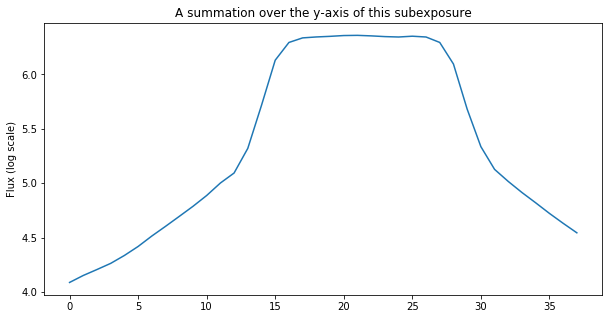

The difference between the two edges (for a 5-pixel bin for all subexps is): 12244.6546875
This value may not be larger than  2045.9798630485102  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Using flux for variance estimate
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


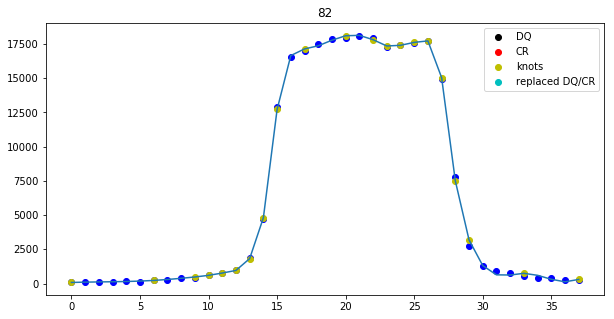

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


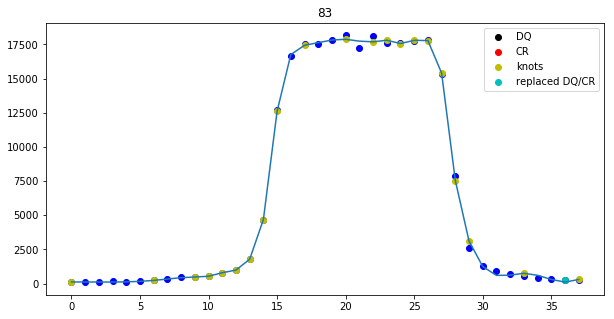

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


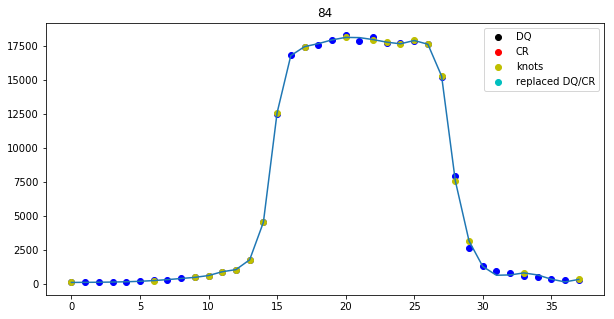

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


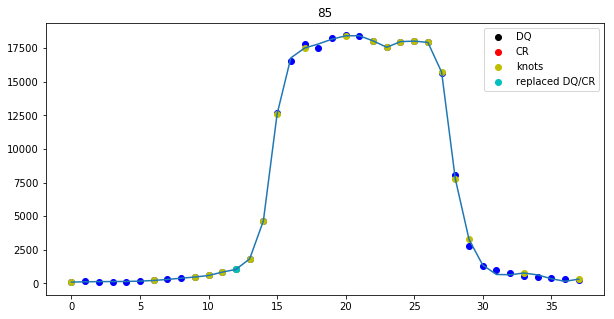

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


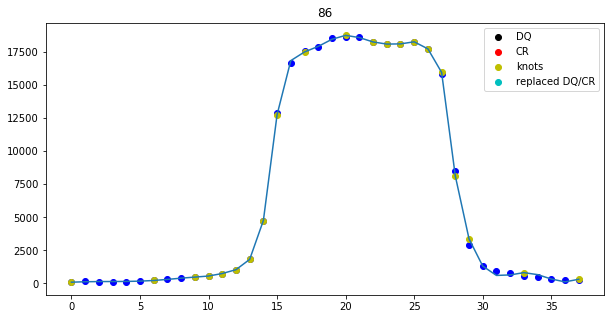

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 189, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 2
nr. of CRs 792
Spectrum located at pixel 120 in spatial direction
subexp 155.19836382524488 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 153 for exposure 1
1 12


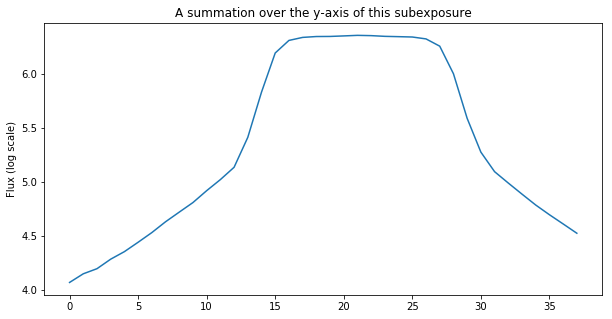

The difference between the two edges (for a 5-pixel bin for all subexps is): 11615.02578125
This value may not be larger than  2046.0236557772248  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


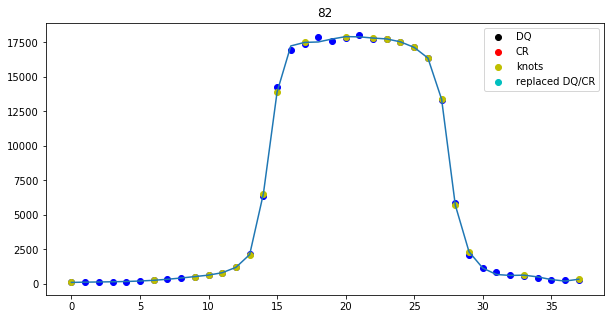

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


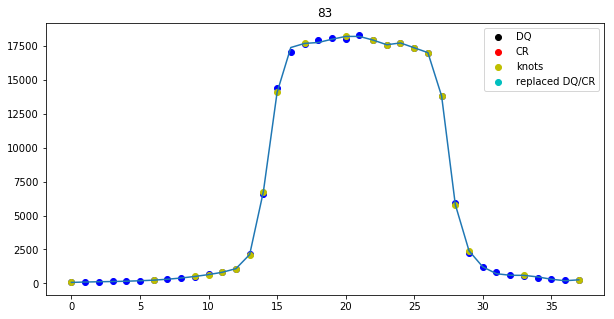

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


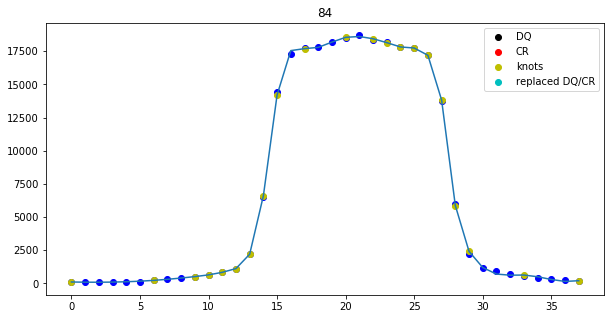

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


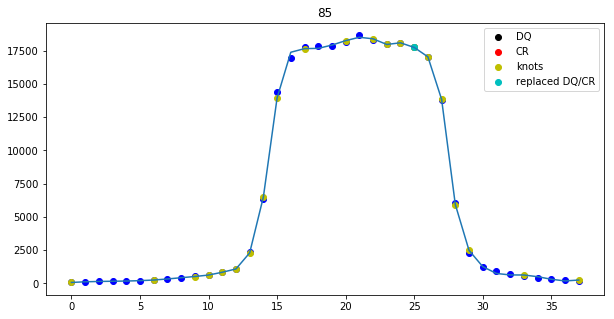

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


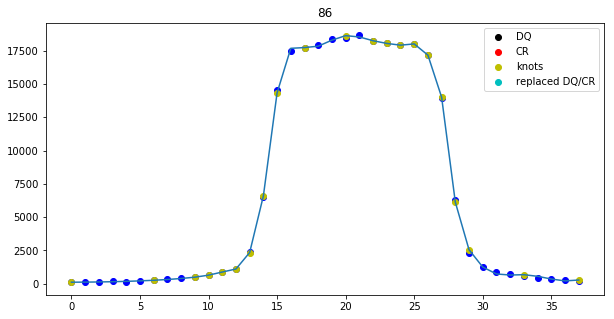

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 3
nr. of CRs 796
Spectrum located at pixel 120 in spatial direction
subexp 141.93501070521242 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 140 for exposure 2
2 12


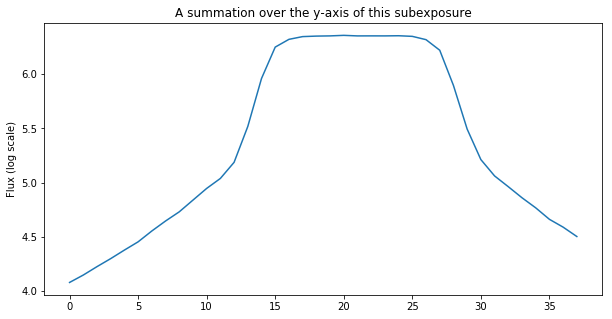

The difference between the two edges (for a 5-pixel bin for all subexps is): 10745.60390625
This value may not be larger than  2045.5338015621578  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


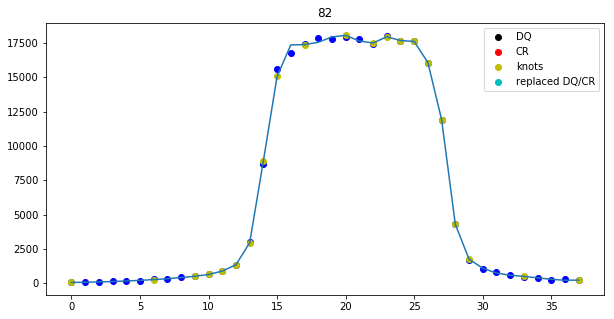

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


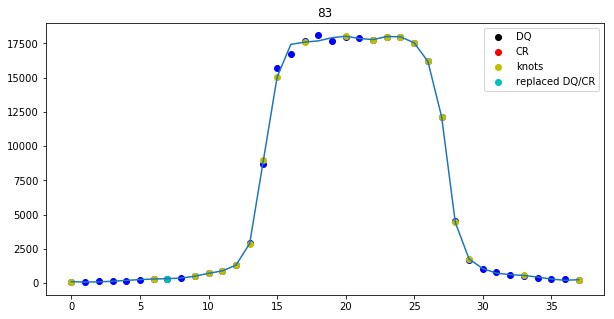

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


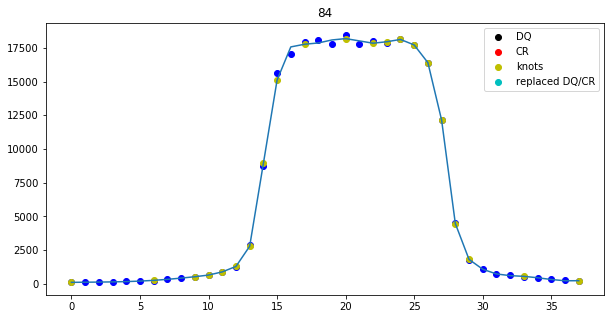

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


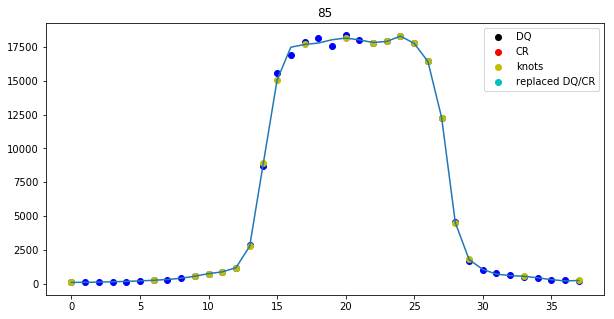

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


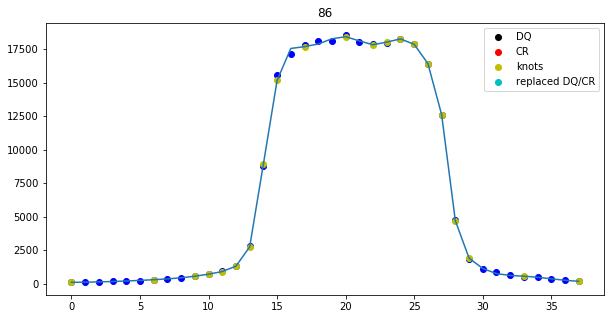

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 4
nr. of CRs 806
Spectrum located at pixel 120 in spatial direction
subexp 128.6137202333283 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 126 for exposure 3
3 12


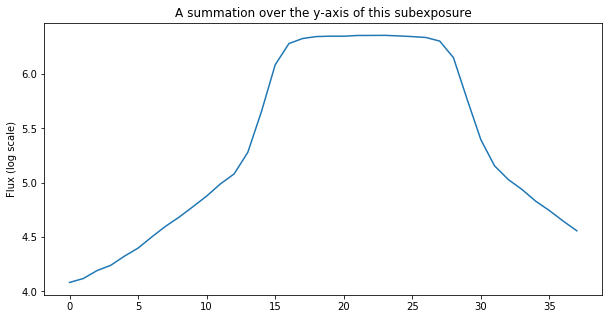

The difference between the two edges (for a 5-pixel bin for all subexps is): 12944.54765625
This value may not be larger than  2045.6146264631568  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


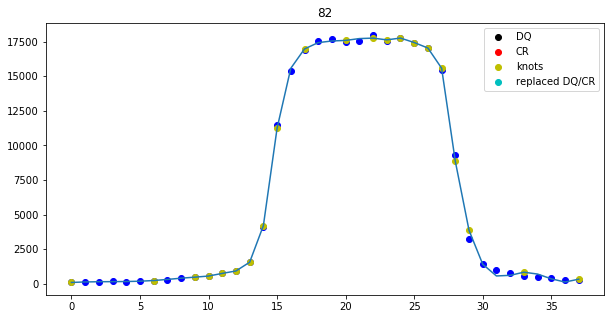

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


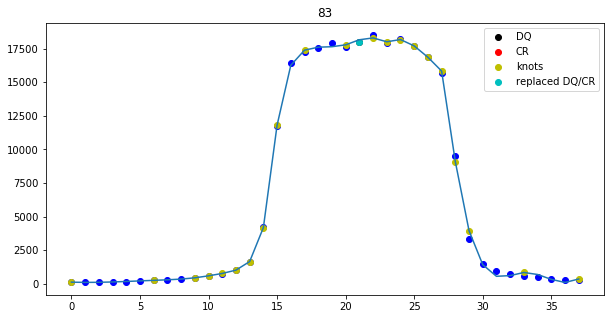

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


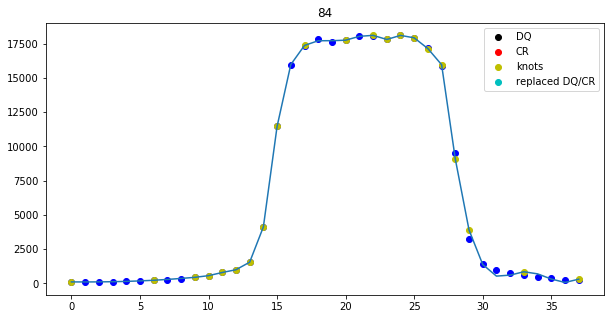

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


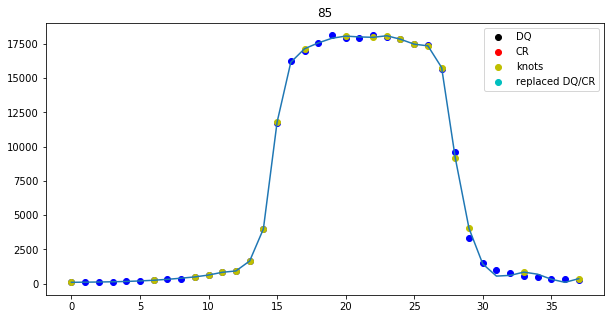

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


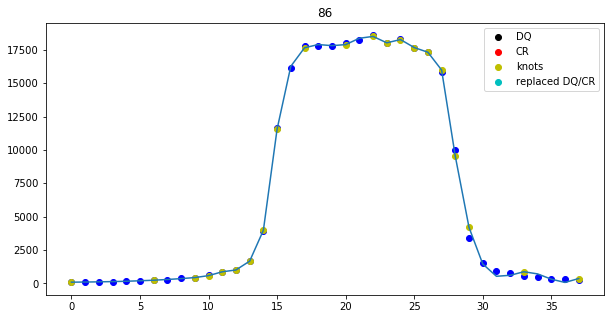

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 5
nr. of CRs 803
Spectrum located at pixel 120 in spatial direction
subexp 115.2724301921178 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 113 for exposure 4
4 12


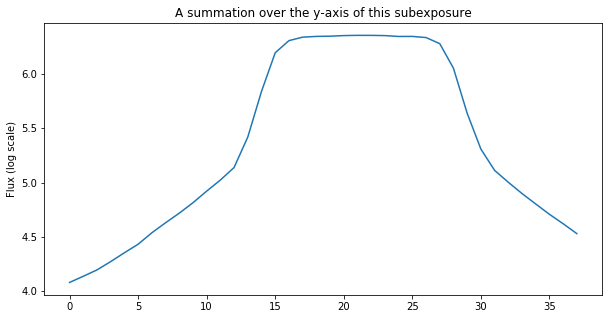

The difference between the two edges (for a 5-pixel bin for all subexps is): 11893.21875
This value may not be larger than  2047.9934244686106  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


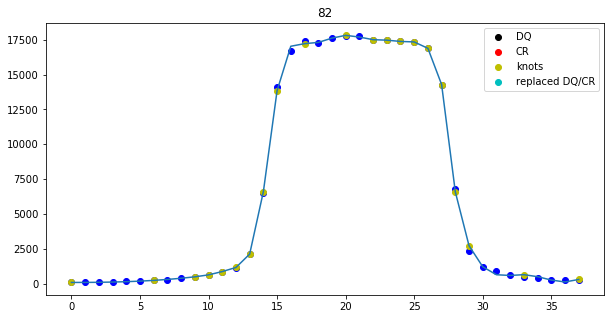

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


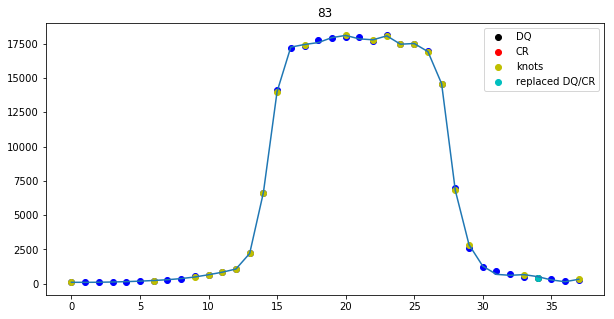

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


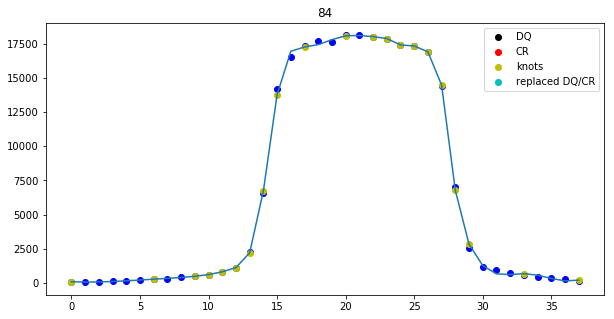

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


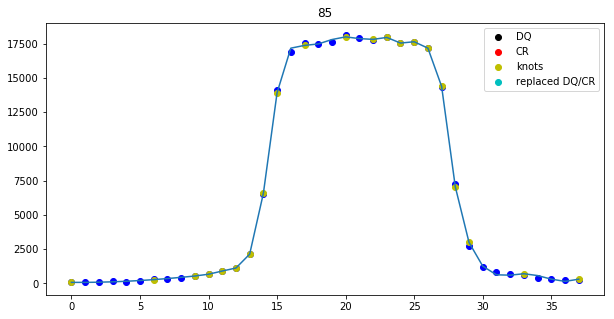

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


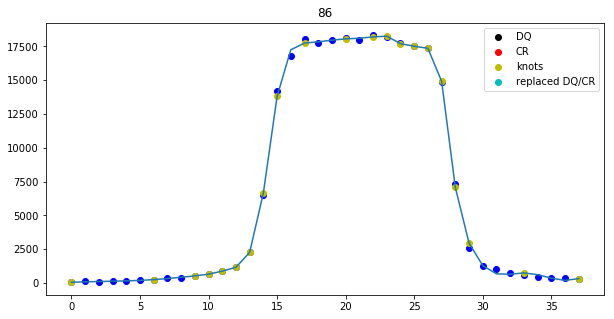

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 6
nr. of CRs 791
Spectrum located at pixel 120 in spatial direction
subexp 101.86760114409289 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 99 for exposure 5
5 12


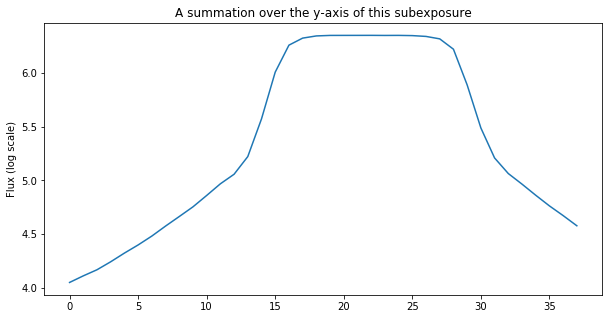

The difference between the two edges (for a 5-pixel bin for all subexps is): 14305.6234375
This value may not be larger than  2044.0509452229087  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


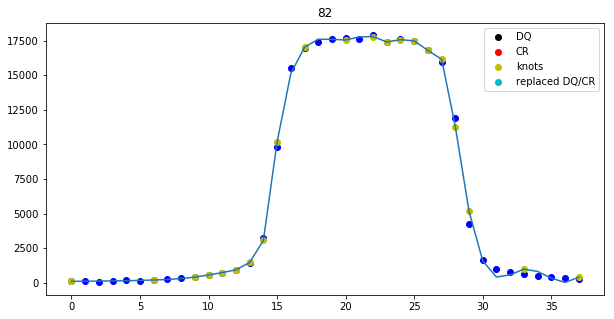

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


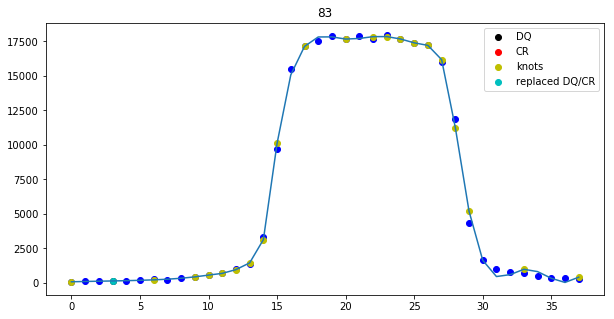

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


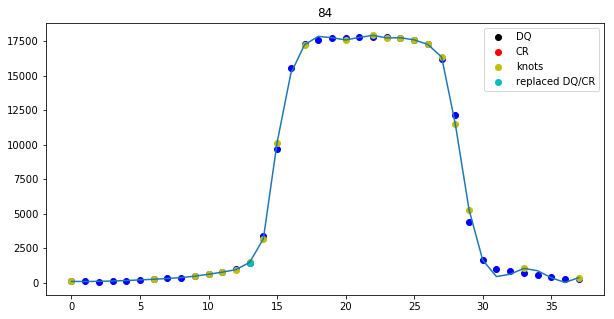

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


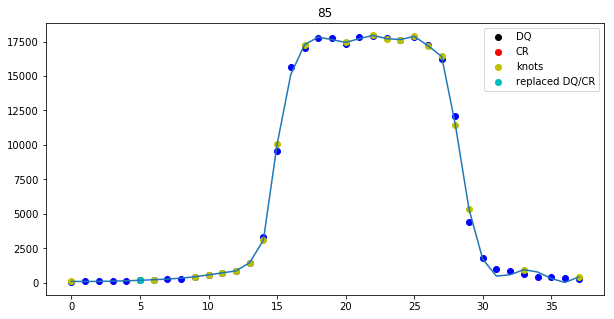

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


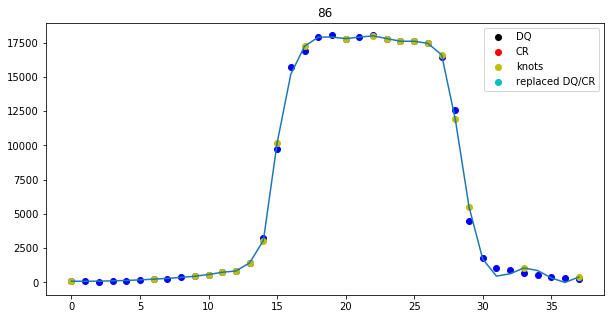

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 7
nr. of CRs 786
Spectrum located at pixel 120 in spatial direction
subexp 88.46807140294254 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 86 for exposure 6
6 12


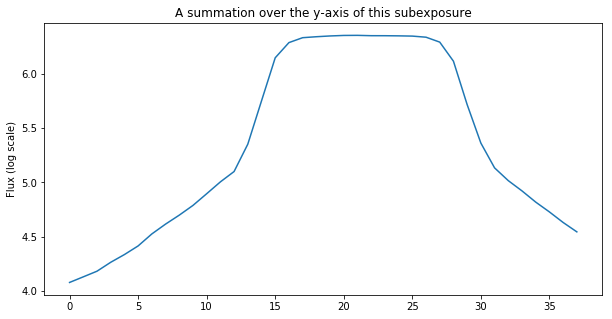

The difference between the two edges (for a 5-pixel bin for all subexps is): 12324.9953125
This value may not be larger than  2046.6997825768194  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


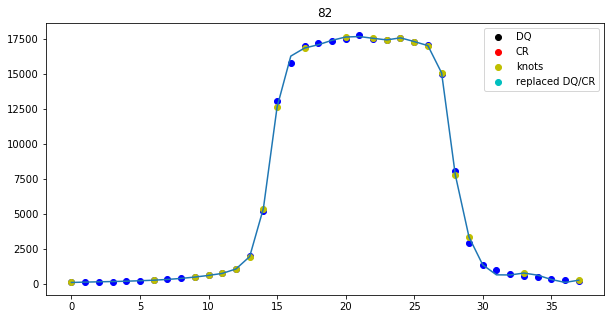

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


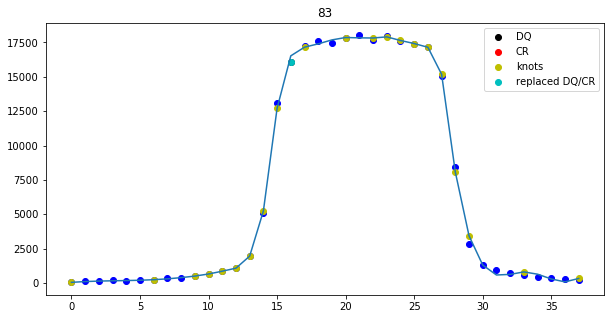

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


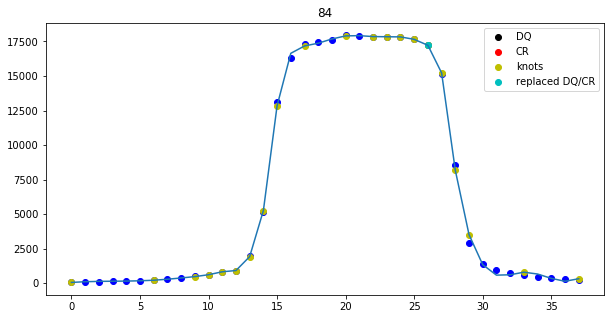

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


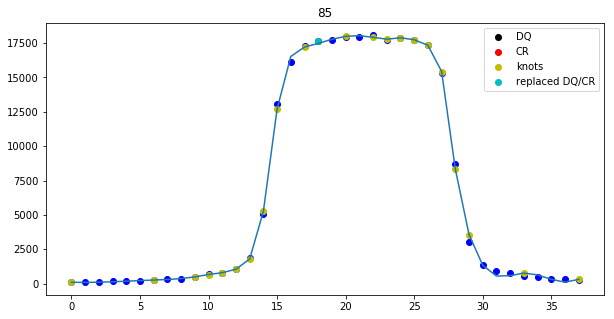

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


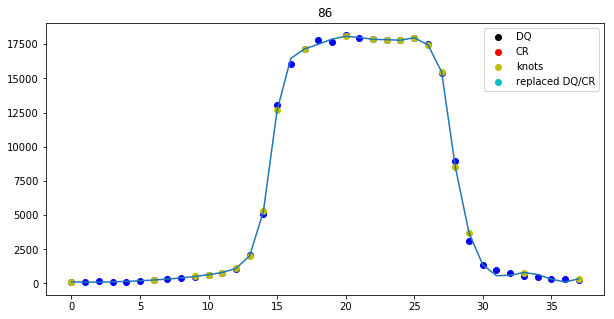

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 8
nr. of CRs 790
Spectrum located at pixel 120 in spatial direction
subexp 75.04168249435907 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 73 for exposure 7
7 12


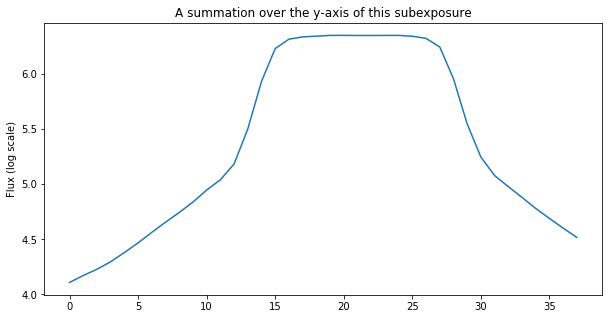

The difference between the two edges (for a 5-pixel bin for all subexps is): 10858.2953125
This value may not be larger than  2045.49312717822  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


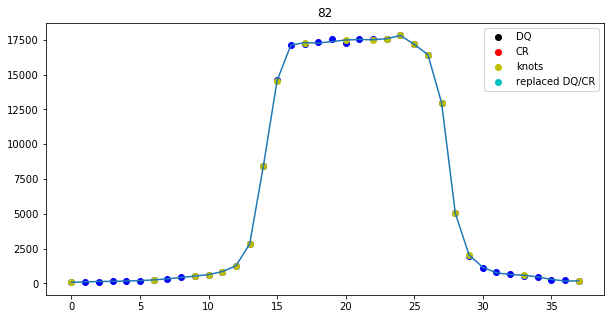

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


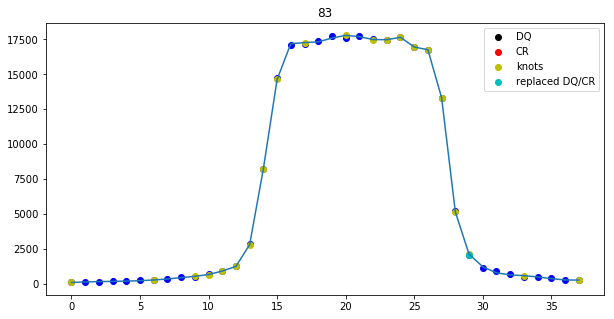

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


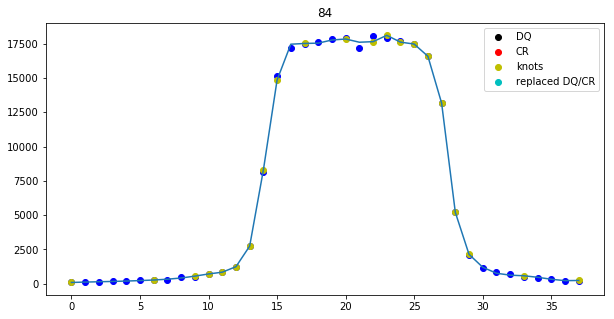

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


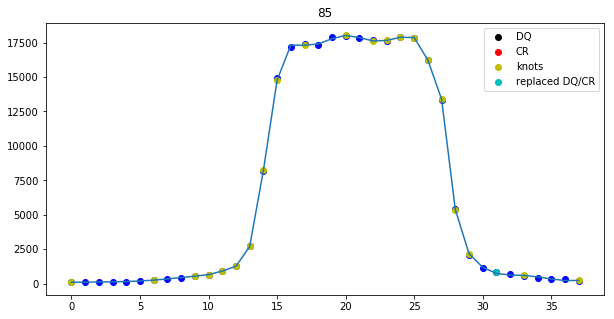

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


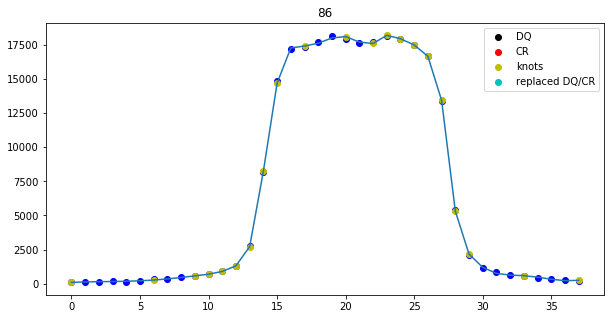

Optimal extraction fitting failed for columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 9
nr. of CRs 783
Spectrum located at pixel 120 in spatial direction
subexp 61.6179800666743 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 59 for exposure 8
8 12


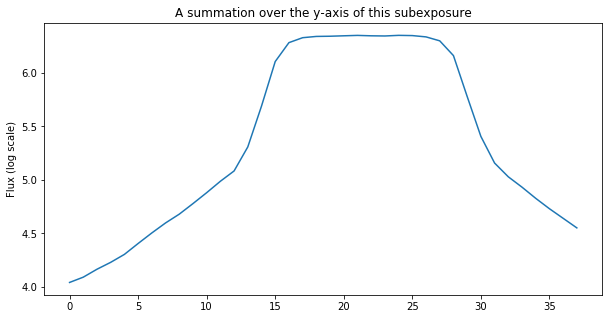

The difference between the two edges (for a 5-pixel bin for all subexps is): 13113.759375
This value may not be larger than  2041.748792906055  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


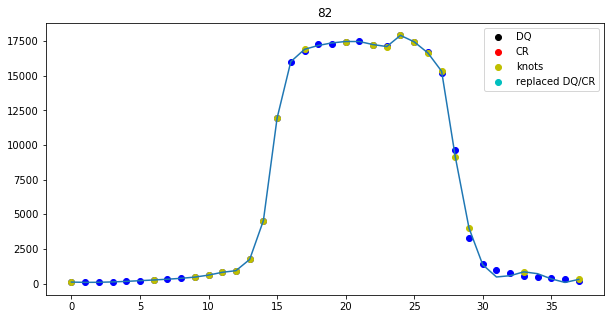

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


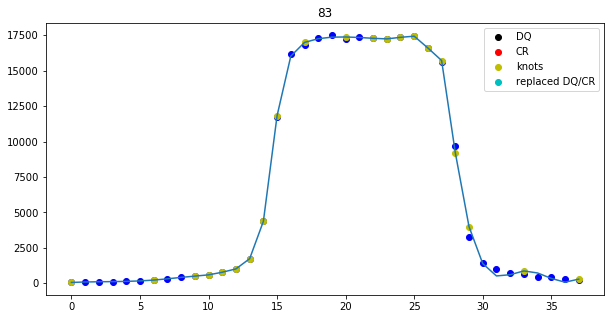

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


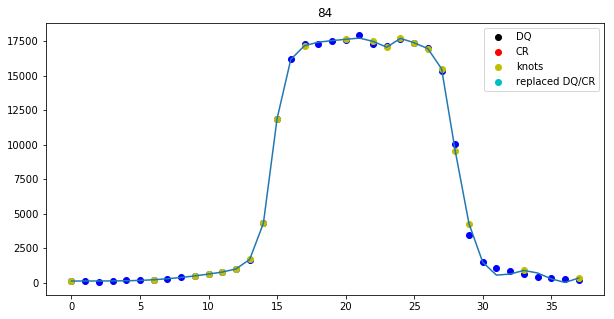

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


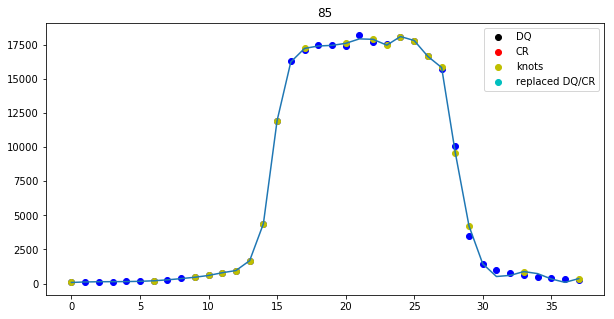

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


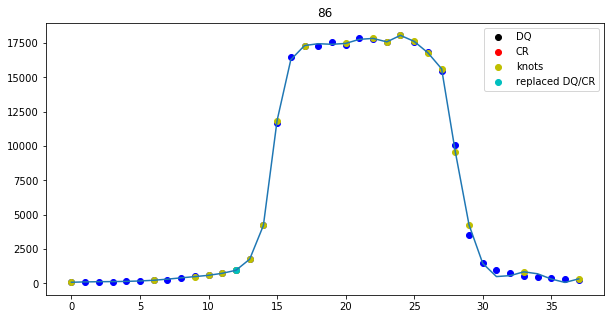

Optimal extraction fitting failed for columns: [0, 1, 3, 5, 6, 7, 9, 10, 11, 12, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 10
nr. of CRs 777
Spectrum located at pixel 120 in spatial direction
subexp 48.1701501923897 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 46 for exposure 9
9 12


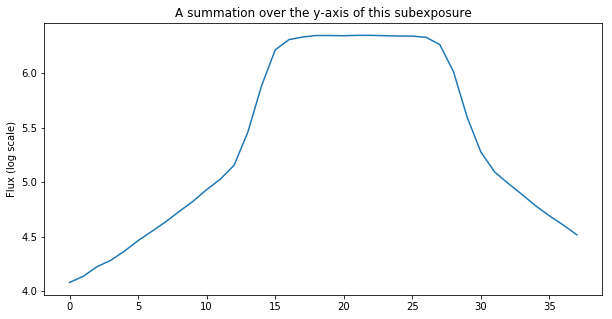

The difference between the two edges (for a 5-pixel bin for all subexps is): 11389.86640625
This value may not be larger than  2041.4698626234972  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


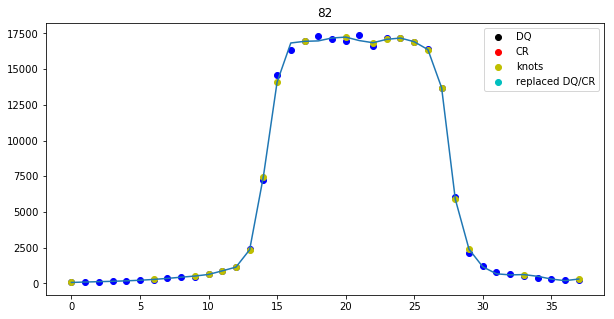

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


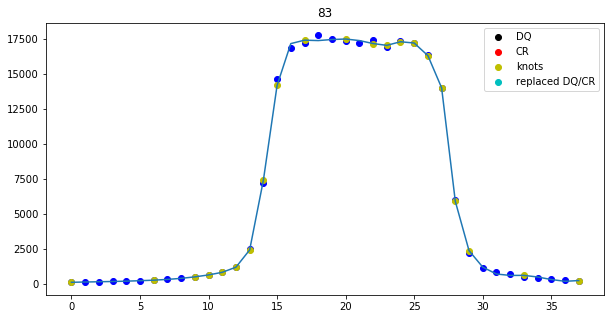

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


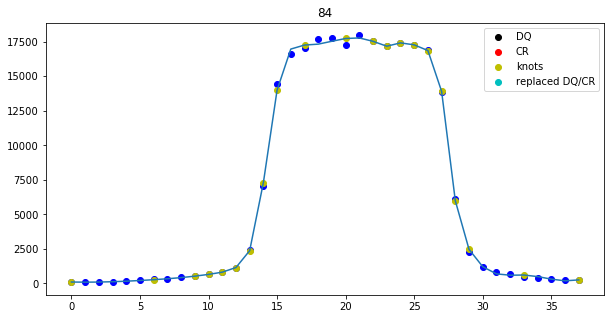

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


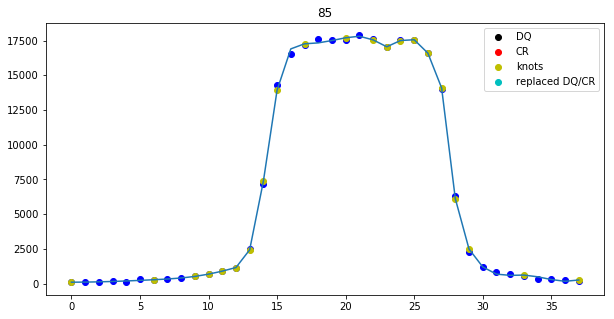

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


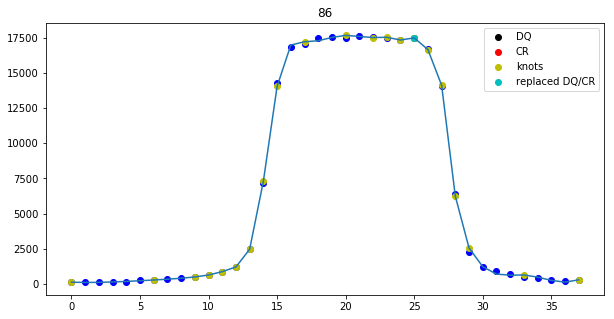

Optimal extraction fitting failed for columns: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 11
nr. of CRs 784
Spectrum located at pixel 120 in spatial direction
subexp 34.728348577689935 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 33 for exposure 10
10 12


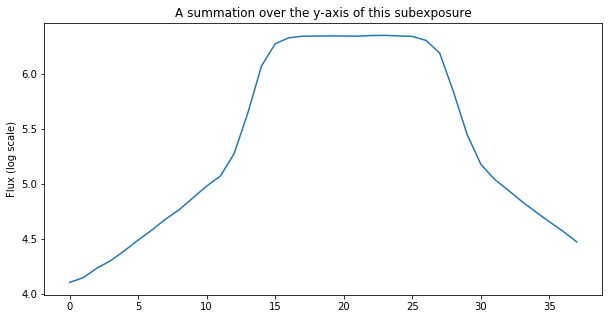

The difference between the two edges (for a 5-pixel bin for all subexps is): 9677.3171875
This value may not be larger than  2040.6465642045905  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


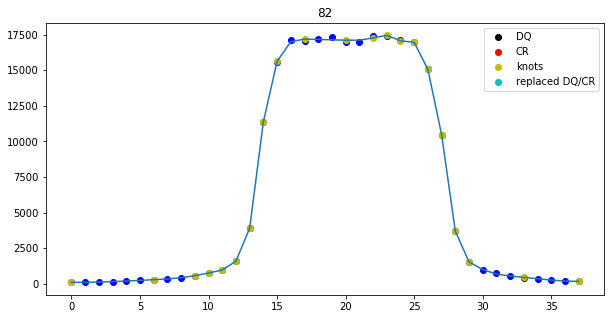

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


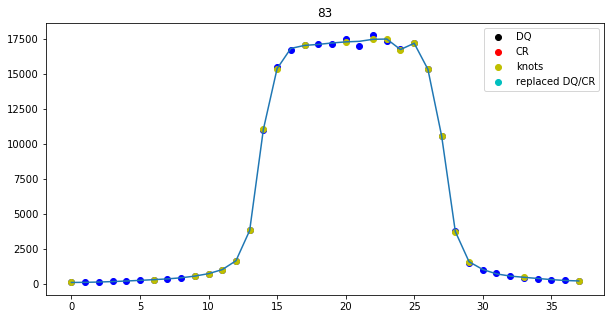

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


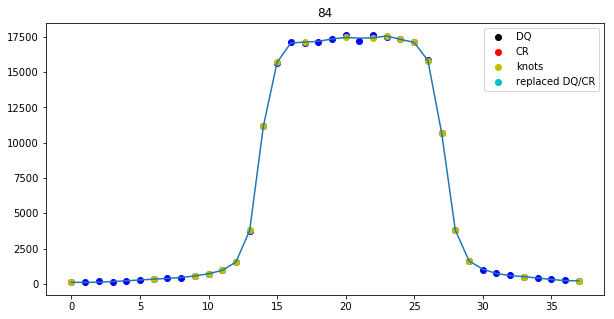

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


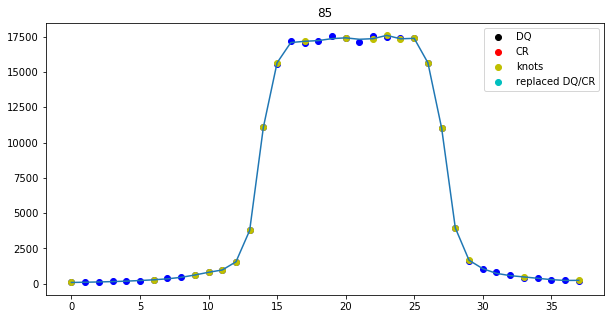

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


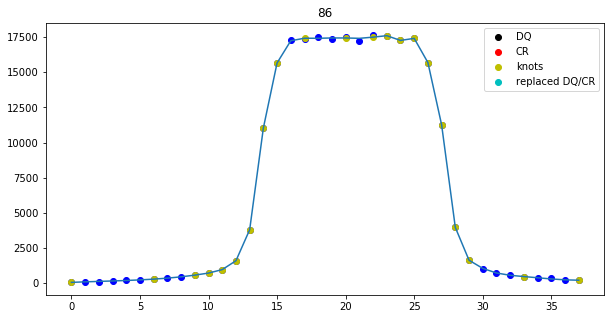

Optimal extraction fitting failed for columns: [3, 4, 9, 11, 13, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 191, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE
Extracting from subexposure 12
nr. of CRs 787
Spectrum located at pixel 120 in spatial direction
subexp 21.268306561189917 [166, 153, 140, 126, 113, 99, 86, 73, 59, 46, 33, 21]
ypix is 21 for exposure 11
11 12


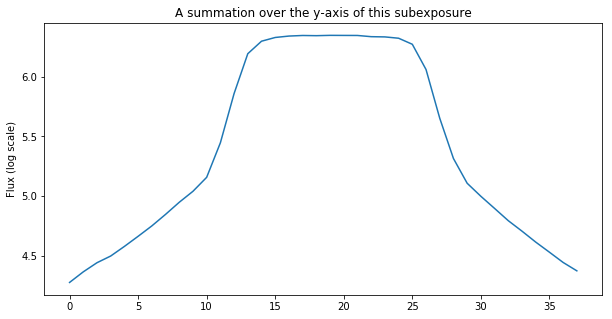

The difference between the two edges (for a 5-pixel bin for all subexps is): 3549.43828125
This value may not be larger than  2042.3495619832893  or else you'll have variations induced by the moving of this subexposure on the y-axis.
Extracting spectrum with optimal extraction...
Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


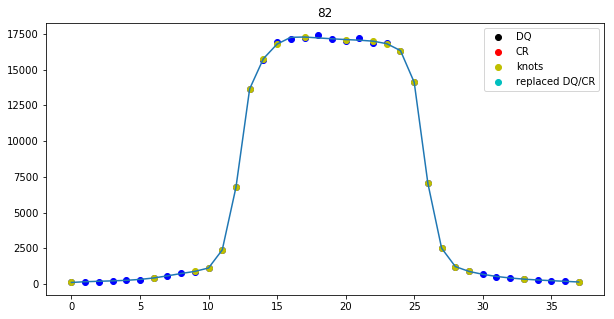

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


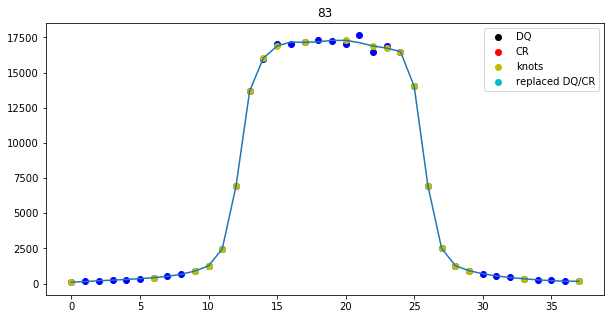

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


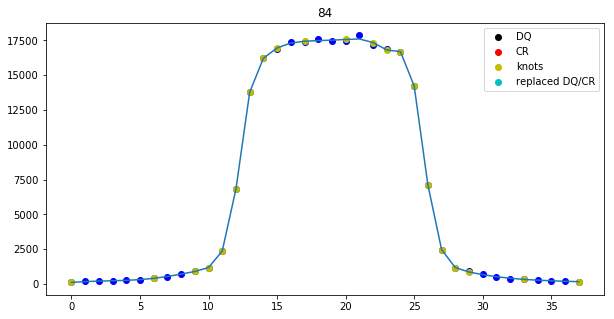

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


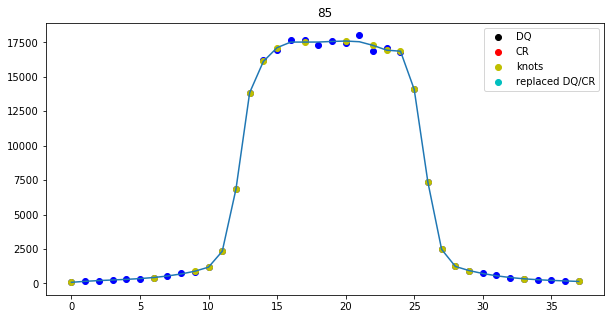

Knots used are: [ 0.  6.  9. 10. 11. 12. 13. 14. 15. 17. 20. 22. 23. 24. 25. 26. 27. 28.
 29. 33. 37.]


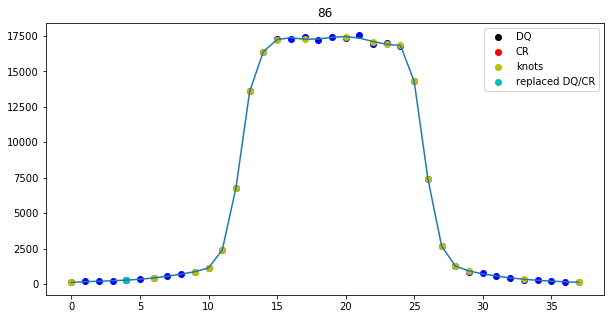

Optimal extraction fitting failed for columns: [1, 2, 3, 4, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 192, 193, 194, 195, 196, 197, 198, 199]
Clipped 0 cosmic rays in OE


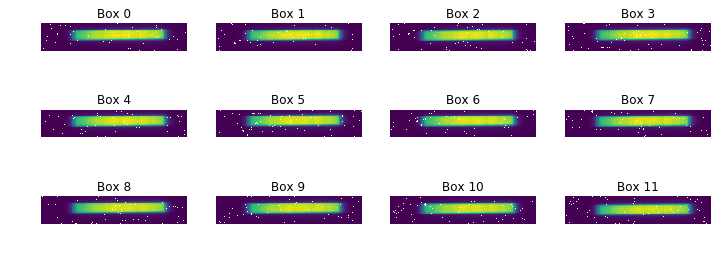

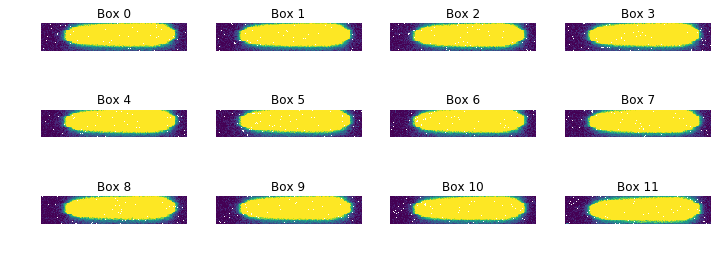

[ 0.00000000e+00  2.22044605e-16  2.22044605e-16  0.00000000e+00
 -1.11022302e-16  1.11022302e-16  3.33066907e-16 -1.11022302e-16
  3.33066907e-16 -1.11022302e-16  0.00000000e+00  2.22044605e-16
  3.33066907e-16  2.22044605e-16  0.00000000e+00  0.00000000e+00
 -2.22044605e-16  2.22044605e-16 -1.11022302e-16  1.11022302e-16
  0.00000000e+00 -2.22044605e-16  1.11022302e-16  1.11022302e-16
 -2.22044605e-16  0.00000000e+00  2.22044605e-16  2.22044605e-16
  0.00000000e+00  0.00000000e+00  2.22044605e-16 -4.44089210e-16
 -2.22044605e-16  4.44089210e-16  2.22044605e-16  0.00000000e+00
  2.22044605e-16  2.22044605e-16  4.44089210e-16  0.00000000e+00
  0.00000000e+00 -4.44089210e-16  2.22044605e-16  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -2.22044605e-16  2.22044605e-16
  4.44089210e-16  2.22044605e-16  0.00000000e+00  0.00000000e+00
 -2.22044605e-16 -2.22044605e-16  2.22044605e-16 -2.22044605e-16
  2.22044605e-16 -2.22044605e-16  4.44089210e-16  2.22044605e-16
  2.22044605e-16  2.22044

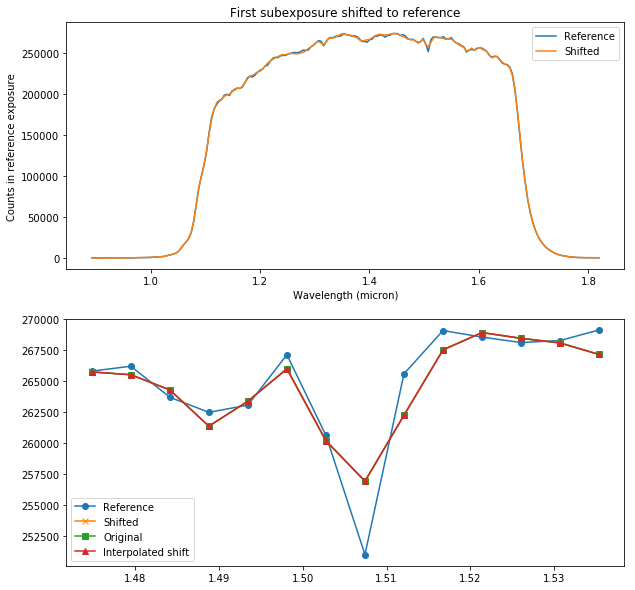

Shifted subexposure nr. 1 with 0.213416299961 pixels and shrunk 0.127957016785 percent.
Shifted subexposure nr. 2 with 0.165889513535 pixels and shrunk 0.178992238223 percent.
Shifted subexposure nr. 3 with 0.0236300728063 pixels and shrunk 0.258568029042 percent.
Shifted subexposure nr. 4 with -0.0973019203912 pixels and shrunk 0.321339169716 percent.
Shifted subexposure nr. 5 with -0.232633472628 pixels and shrunk 0.39980192345 percent.
Shifted subexposure nr. 6 with -0.400961101591 pixels and shrunk 0.481979924026 percent.
Shifted subexposure nr. 7 with -0.433590991515 pixels and shrunk 0.531607029932 percent.
Shifted subexposure nr. 8 with -0.518858579662 pixels and shrunk 0.606759992338 percent.
Shifted subexposure nr. 9 with -0.674981675644 pixels and shrunk 0.684178996915 percent.
Shifted subexposure nr. 10 with -0.721203966072 pixels and shrunk 0.734170022637 percent.
Shifted subexposure nr. 11 with -0.861840913955 pixels and shrunk 0.815375956193 percent.


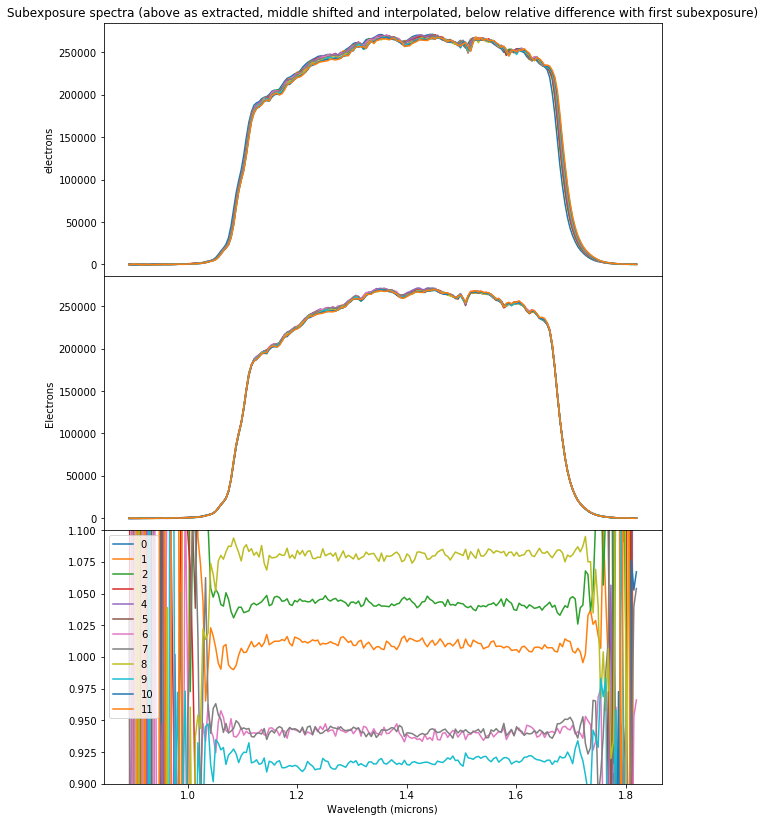

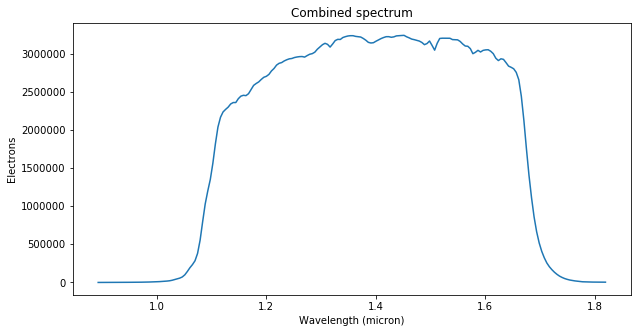

Saving spectrum to /Users/bob/Documents/PhD/WASP-80/output/idn205o6q_spec.txt
reduced 2458676.2196066505
Saving subexposure spectra to /Users/bob/Documents/PhD/WASP-80/output/idn205o6q_subs_spec.txt
Extraction took 14.22s
########################################
###########Finished Extraction##########
########################################


In [11]:
reload(pipe)
it = 0
for fname in ref_Images:
    visit = int(fname.split('idn20')[1][0])
    TestFile = pyfits.open(data_dir + fname)
    if visit == 1:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
        Ref_exp = ref_Images[0].split('_ima.fits')[0]
        ypix_F = ypix_F_1
        ypix_R = ypix_R_1
        custom_knots = custom_knots_long1
    if visit == 2:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 25, 40, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (5, 5, 38, 60)
        Ref_exp = ref_Images[1].split('_ima.fits')[0]
        ypix_F = ypix_F_2
        ypix_R = ypix_R_2
        custom_knots = custom_knots_long2
    if visit == 3:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 25, 40, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (5, 5, 38, 60)
        Ref_exp = ref_Images[2].split('_ima.fits')[0]
        ypix_F = ypix_F_3
        ypix_R = ypix_R_3
        custom_knots = custom_knots_short1
    if visit == 4:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
        Ref_exp = ref_Images[3].split('_ima.fits')[0]
        ypix_F = ypix_F_4
        ypix_R = ypix_R_4
        custom_knots = custom_knots_short2
    if visit == 5:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
        Ref_exp = ref_Images[4].split('_ima.fits')[0]
        ypix_F = ypix_F_5
        ypix_R = ypix_R_5
        custom_knots = custom_knots_short2
        
    
    exp = pipe.reduce_exposure(fname, pdf=False, logger=False, debug=False,
                           skip_start=1,
                           bg_x = Bg_x, bg_y = Bg_y, bg_w = Bg_w, bg_h = Bg_h,
                           ref_exp = Ref_exp,
                           conf_file=conf_file_red, \
                           source_dir=data_dir, write = True)

    if noknots:
        exp_spectrum, variance, interp_spectra, variances = \
                    pipe.extract_spectra(exp, pdf=False, logger=False, debug=True,
                    conf_file=conf_file_ext,
                    save_dir=output_dir, save_sub=True)
    else:
        exp_spectrum, variance, interp_spectra, variances = \
                    pipe.extract_spectra(exp, pdf=False, logger=False, debug=True,
                    conf_file=conf_file_ext,
                    custom_knots_F=custom_knots, custom_knots_R=custom_knots[::-1], ypix_F=ypix_F, ypix_R=ypix_R,
                    save_dir=output_dir, save_sub=True)
    

In [12]:
%%capture

BGs0 = []
BGs2 = []
Ts  = []
reload(pipe)
it = 0
Forward = []
refshifts = []
refshifterrs = []
ypixs = []
ypix_errs = []
scanlengths = []
for fname in Images:
    visit = int(fname.split('idn20')[1][0])
    TestFile = pyfits.open(data_dir + fname)
    if visit == 1:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
        Ref_exp = ref_Images[0].split('_ima.fits')[0]
        ypix_F = ypix_F_1
        ypix_R = ypix_R_1
        custom_knots = custom_knots_long1
    if visit == 2:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 25, 40, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (5, 5, 38, 60)
        Ref_exp = ref_Images[1].split('_ima.fits')[0]
        ypix_F = ypix_F_2
        ypix_R = ypix_R_2
        custom_knots = custom_knots_long2
    if visit == 3:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 25, 40, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (5, 5, 38, 60)
        Ref_exp = ref_Images[2].split('_ima.fits')[0]
        ypix_F = ypix_F_3
        ypix_R = ypix_R_3
        custom_knots = custom_knots_short1
    if visit == 4:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
        Ref_exp = ref_Images[3].split('_ima.fits')[0]
        ypix_F = ypix_F_4
        ypix_R = ypix_R_4
        custom_knots = custom_knots_short2
    if visit == 5:
        #Bg_x, Bg_y, Bg_w, Bg_h = (5, 215, 50, 40)
        Bg_x, Bg_y, Bg_w, Bg_h = (215, 5, 38, 60)
        Ref_exp = ref_Images[4].split('_ima.fits')[0]
        ypix_F = ypix_F_5
        ypix_R = ypix_R_5
        custom_knots = custom_knots_short2
    Save_sub = True
    #if fname == Ref_exp + '_ima.fits':
    #    Save_sub = True
    #else:
    #    Save_sub = False
        
    if it not in [8]:
        exp = pipe.reduce_exposure(fname, pdf=False, logger=False, debug=False,
                           skip_start=1, 
                           bg_x = Bg_x, bg_y = Bg_y, bg_w = Bg_w, bg_h = Bg_h,
                           ref_exp = Ref_exp,
                           conf_file=conf_file_red, \
                           source_dir=data_dir, write = True)

        if noknots:
            exp_spectrum, variance, interp_spectra, variances = \
                    pipe.extract_spectra(exp, pdf=False, logger=False, debug=True,
                    conf_file=conf_file_ext, ref_exp=Ref_exp,
                    save_dir=output_dir, save_sub=Save_sub)
        else:
            exp_spectrum, variance, interp_spectra, variances = \
                    pipe.extract_spectra(exp, pdf=False, logger=False, debug=False,
                    conf_file=conf_file_ext, ref_exp=Ref_exp,
                    custom_knots_F=custom_knots, custom_knots_R=custom_knots[::-1], ypix_F=ypix_F, ypix_R=ypix_R,
                    save_dir=output_dir, save_sub=Save_sub)
    
        BGs0.append(exp.BGs[0][0,0])
        BGs2.append(exp.BGs[2][0,0])
        Ts.append(exp.t)
    if it == 6:
        it = 0
    refshifts.append(exp_spectrum.refshift)
    refshifterrs.append(exp_spectrum.refshifterr)
    scanlengths.append(exp.scanlength)
    Forward.append(exp.POSTARG2)
    ypixs.append([subexp.ypix for subexp in exp.subexposures])
    ypix_errs.append([subexp.ypix_err for subexp in exp.subexposures])
    it +=1
    

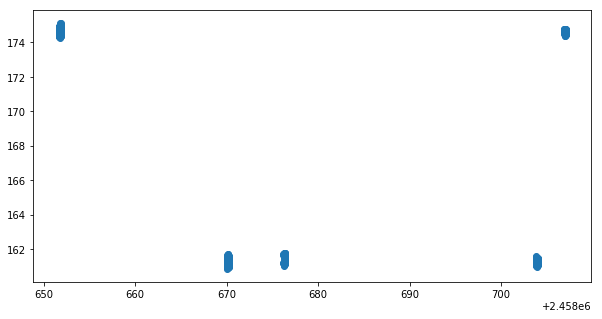

In [14]:
plt.scatter(Ts, scanlengths)
np.savetxt(output_dir + 'WASP-80b-scanlengths.txt', (Ts, scanlengths))

Text(0.5,0,'Time (JD)')

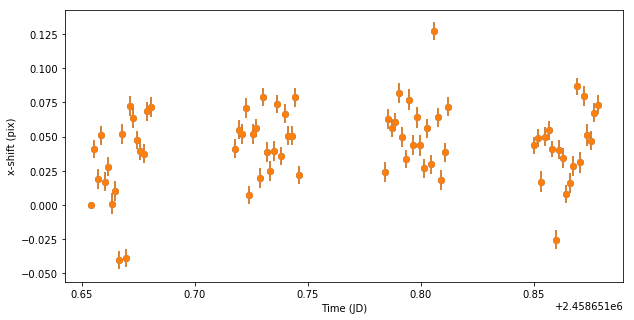

In [29]:
plt.errorbar(Ts, refshifts, yerr=refshifterrs, fmt='o')
plt.errorbar(Ts, refshifts, yerr=refshifterrs, fmt='o')
np.savetxt(output_dir + 'WASP-80b-x-pos1.txt', (Ts, refshifts, refshifterrs))
plt.ylabel('x-shift (pix)')
plt.xlabel('Time (JD)')

Text(0.5,0,'Time (JD)')

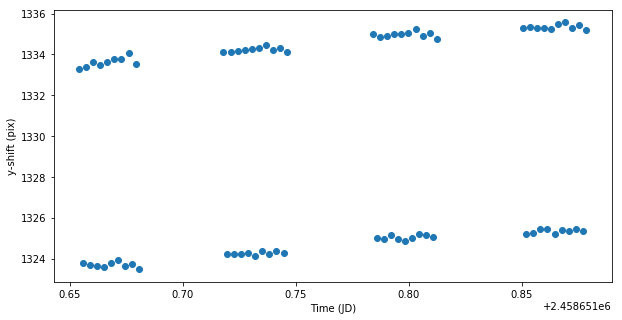

In [30]:
ypix_err_avg = np.sqrt(np.sum(np.array(ypix_errs)**2, axis=1))

plt.errorbar(Ts, np.sum(ypixs, axis=1), yerr= ypix_err_avg, fmt='o')
np.savetxt(output_dir + 'WASP-80b-y-pos1.txt', (Ts, np.sum(ypixs, axis=1), ypix_err_avg))
plt.ylabel('y-shift (pix)')
plt.xlabel('Time (JD)')

Text(0,0.5,'Pixel value')

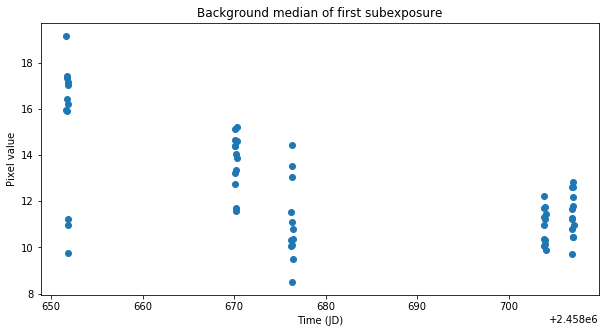

In [13]:
plt.title('Background median of first subexposure')
plt.scatter(Ts, BGs0)
plt.xlabel('Time (JD)')
plt.ylabel('Pixel value')

Text(0,0.5,'Pixel value')

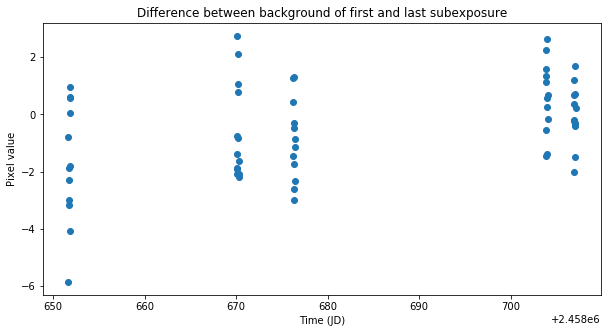

In [14]:
plt.scatter(Ts, np.array(BGs2) - np.array(BGs0))
plt.title('Difference between background of first and last subexposure')
plt.xlabel('Time (JD)')
plt.ylabel('Pixel value')

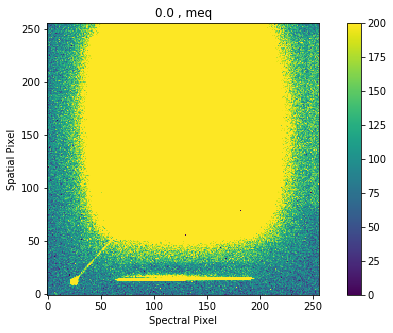

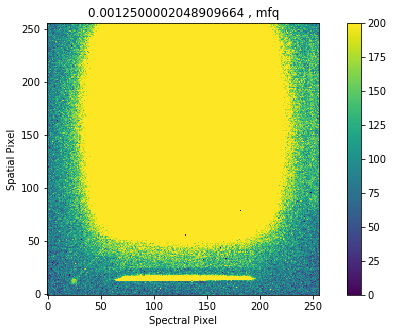

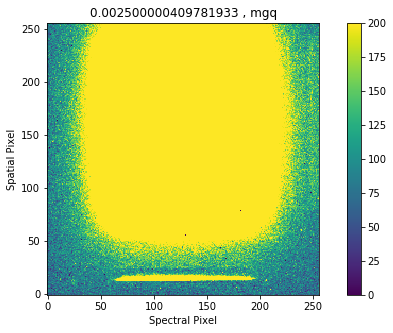

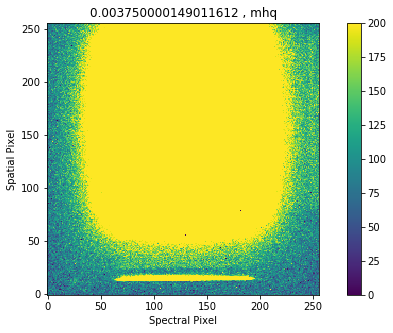

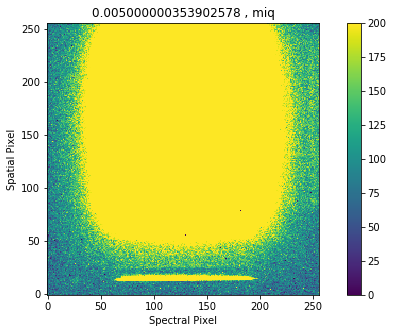

...

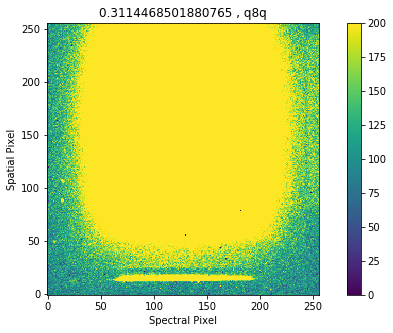

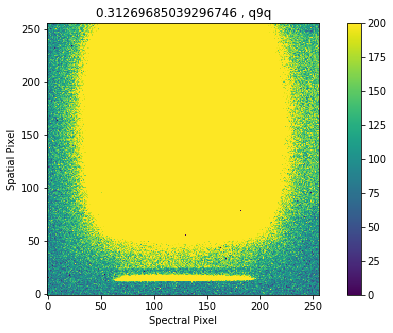

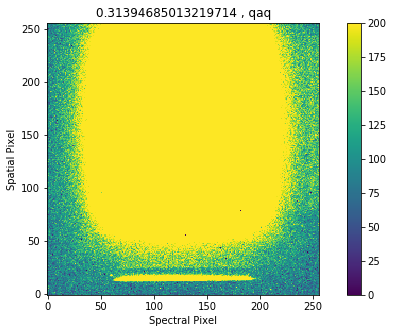

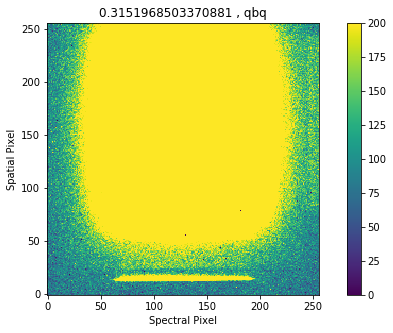

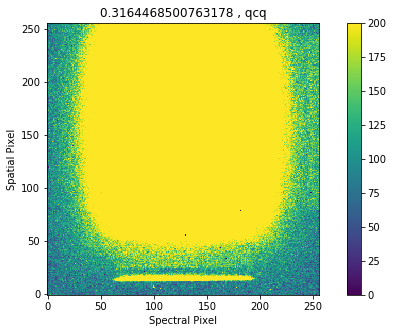

In [51]:
lensubexposures=4
figures = []
Data = []
times = []
shortname = []
for Image in Images:
    exposure = data.load(data_dir + Image, conf_file = conf_file_red, bjd=False)
    times.append(exposure.t)
    Data.append(exposure.reads[0].SCI.data[5:-5,5:-5])
    shortname.append(Image.replace('ibh726', '').replace('_ima.fits',''))
    
times -= min(times)

figures = [x for y, x in sorted(zip(times, figures))]
Data = [x for y, x in sorted(zip(times, Data))]
shortname = [x for y, x in sorted(zip(times, shortname))]
times = sorted(times)

for i,D in enumerate(Data):
    plt.figure()
    data.view_frame_image(D, show=False, vmin=0, vmax=200, title=str(times[i]) + ' , ' + shortname[i])

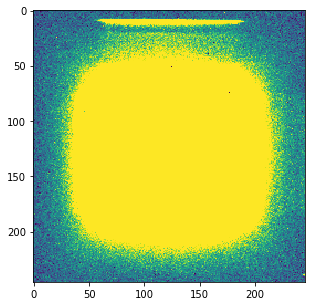

In [31]:
plt.imshow(exp.reads[1].SCI.data[5:-5,5:-5], vmin=0, vmax=200)